# The Homes Dataset: PART 2

A supervised machine-learning regression problem, regarding the home sale prices in the city of Ames, IA.

## 1-4. Previous Cells

In [1]:
%%capture
%run ./03_homes_01.ipynb

In [2]:
columns_encodings.keys()

dict_keys(['cont', 'disc', 'ordinal', 'target', 'ohe', 'bool', 'others'])

### Cleanup

In [3]:
Out.clear()

for name in dir():
    if name.startswith('_') and name[1:].isdigit():
        del globals()[name]

del name

## 5. Preprocessing

### Importing modules

In [4]:
# Train/Test split
from sklearn.model_selection import train_test_split

# Pipeline
from sklearn.pipeline import Pipeline

# to clone pipelines
from sklearn.base import clone

from sklearn.base import BaseEstimator, TransformerMixin
# from sklearn.utils.validation import validate_data

from sklearn.compose import ColumnTransformer, make_column_selector

from sklearn.preprocessing import FunctionTransformer, PowerTransformer, LabelEncoder, OneHotEncoder, OrdinalEncoder, StandardScaler, RobustScaler, MinMaxScaler

# from sklearn.preprocessing import MinMaxScaler
# from scipy.stats import boxcox
# from sklearn.model_selection import cross_val_score

from sklearn.feature_selection import VarianceThreshold, SelectKBest, RFE, RFECV

import scipy.cluster.hierarchy as sch

### Splitting: Features v. Target

Even though there is a test data, that is only for post-production and implementation of the model in the competition, since we do not have target values for it. Thus, to train our models to begin with, we need to split the data for which we *do* have target values into training and validation:

Selecting the features (all columns) and the target:

In [5]:
# features vs. target
X = raw_train.copy() # will pop out the target, then will be split into test and validation
y = X.pop('SalePrice') # target

X_test = raw_test.copy() # test

### Log of Target data

The model testing will be made with the RMSE of the _log_ of the target, so let us take the log now:

In [6]:
y_log = np.log(y)

### Splitting: Training vs. Validation

The data is to be split once, and then used in all models.

In [7]:
# training vs. validation
X_train, X_val, y_train, y_val = train_test_split(X, y_log, test_size=0.25, random_state=1)

In [8]:
# display(X_train)
# display(y_train)

# display(X_val)
# display(y_val)

### Reminder: useful lists, dictionaries, and functions

Let us now recall the different types of features we have:

In [9]:
list(columns_encodings.keys())

['cont', 'disc', 'ordinal', 'target', 'ohe', 'bool', 'others']

The rankings we have:

In [10]:
list(rankings.keys())

['default_mi',
 'default_r',
 'default_omega2',
 'default_useful',
 'new_useful',
 'definitive_yj',
 'definitive_log']

The most useful functions we have devised:

In [11]:
?cramers_v

Signature: cramers_v(x, y)
Docstring:
Computes Cramér's V statistic for measuring the strength of association between two categorical variables.

Parameters
----------
x : array-like
    First categorical variable.
y : array-like
    Second categorical variable.

Returns
-------
float
    Corrected Cramér's V statistic, ranging from 0 (no association) to 1 (perfect association).
File:      /tmp/ipykernel_114512/4169971572.py
Type:      function

In [12]:
?logify

Signature:
logify(
    dataframe,
    columns=<class 'float'>,
    prefix='',
    dexes=None,
    drop_cols=False,
    log_fn=<ufunc 'log1p'>,
)
Docstring:
Applies a logarithmic transformation to specified columns in a DataFrame.

Parameters
----------
dataframe : pd.DataFrame
    Input DataFrame to transform.
columns : list, type, or int, default float
    List of column names or a dtype (float or int) to select columns.
prefix : str, default ''
    Prefix to add to the transformed column names.
dexes : float or None, default None
    If set, filters out columns with insufficient order-of-magnitude variation.
drop_cols : bool, default False
    If True, drops original columns after transformation.
log_fn : callable, default numpy.log1p
    Log function to apply (e.g., np.log, np.log10).

Returns
-------
pd.DataFrame
    DataFrame with log-transformed columns added (and optionally original columns dropped).
File:      /tmp/ipykernel_114512/1561521445.py
Type:      function

In [13]:
?has_cols_fn

Signature:
has_cols_fn(
    dataframe,
    has_cols=['MasVnrArea', 'TotalBsmtSF', '2ndFlrSF', 'GarageArea', 'WoodDeckSF', 'Porch', 'PoolArea'],
)
Docstring:
Creates binary indicator columns for the presence of features (e.g., area > 0) in a DataFrame.

Parameters
----------
dataframe : pd.DataFrame
    Input DataFrame containing the original features.
has_cols : list of str, optional
    List of column names to check for presence.

Returns
-------
pd.DataFrame
    DataFrame containing new binary columns indicating feature presence (1 if present, 0 otherwise).
File:      /tmp/ipykernel_114512/1839177342.py
Type:      function

In [14]:
?new_features

Signature:
new_features(
    dataset,
    has_cols=['MasVnrArea', 'TotalBsmtSF', '2ndFlrSF', 'GarageArea', 'WoodDeckSF', 'Porch', 'PoolArea'],
)
Docstring:
Computes a set of engineered features from the Ames housing dataset, including age, rooms, and area metrics.

Parameters
----------
dataset : pd.DataFrame
    Original Ames housing dataset.
has_cols : list of str, optional
    List of features to create binary 'Has_X' indicators using `has_cols_fn`.

Returns
-------
pd.DataFrame
    DataFrame with new features including engineered numeric and binary indicator columns.
File:      /tmp/ipykernel_114512/3364796558.py
Type:      function

In [15]:
?add_target_encoded_features

Signature:
add_target_encoded_features(
    X: pandas.core.frame.DataFrame,
    y: pandas.core.series.Series,
    cols: list[str],
    new_col_suffix: str = '',
    n_splits: int = 5,
    smoothing: float = 20.0,
    random_state: int = 0,
)
Docstring:
Performs out-of-fold target encoding on specified categorical columns and returns the transformed DataFrame along with fitted encoders.

This function encodes each column in `cols` using K-fold target encoding, ensuring out-of-fold separation to reduce leakage.
It also fits a final encoder on the full data for use at inference time.

Parameters
----------
X : pd.DataFrame
    Input DataFrame containing training features.
y : pd.Series
    Target variable (numeric).
cols : list of str
    List of categorical column names to encode.
new_col_suffix : str, optional
    Suffix to append to the original column name for the encoded column. If empty, the original name is used.
n_splits : int, default 5
    Number of folds to use for out-of-fold 

In [16]:
?optimal_feats

Signature: optimal_feats(df, mi_df, mi_thr_or_no, r_thr)
Docstring:
Selects optimal features based on mutual information and pairwise correlation thresholds.

This function selects features whose mutual information (MI) with the target is either among the top N highest (if `mi_thr_or_no` is an integer), or above a specified threshold (if `mi_thr_or_no` is a float). It then prunes features that are highly correlated (above a given Pearson correlation coefficient threshold) with one another.

Parameters
----------
df : pd.DataFrame
    The input DataFrame containing the feature columns.
mi_df : pd.Series
    A Series with feature names as the index and their mutual information scores as values, sorted in descending order.
mi_thr_or_no : int or float
    If int, selects the top N features by mutual information.
    If float, uses it as a threshold to filter features with MI greater than this value.
r_thr : float
    Maximum allowed absolute Pearson correlation between selected features.



### Preprocessing steps:

#### Cleaning, Imputation, and Uniformization

We now define a new function, that takes care of imputing, cleaning, and uniformizing all features. We will use this in our pipeline.

First, an straightforward imputer (without demanding specific conditions to be satisfied):

In [17]:
class CustomImputer(BaseEstimator, TransformerMixin):
    """
    A custom imputer that applies various imputation strategies to specified columns.

    Supports global strategies ('mean', 'median', 'mode'), constant values, and group-based strategies
    ('group_mean', 'group_median', 'group_mode') using `groupby` columns.

    Parameters
    ----------
    strategies : dict, optional
        Dictionary mapping column names to imputation strategies or constant values.
    groupby_cols : dict, optional
        Dictionary mapping column names to lists of columns to group by (used for group-based strategies).
    """


    
    def __init__(self, strategies=None, groupby_cols=None):
        self.strategies = strategies or {}
        self.groupby_cols = groupby_cols or {}
        self.impute_values_ = {}

    def fit(self, X, y=None):
        X = X.copy()
        for col, val_strat in self.strategies.items():
            if val_strat == 'mean':
                self.impute_values_[col] = X[col].mean()
            elif val_strat == 'median':
                self.impute_values_[col] = X[col].median()
            elif val_strat == 'mode':
                self.impute_values_[col] = X[col].mode()[0]
            elif val_strat == 'group_mean':
                gb_cols = self.groupby_cols.get(col)
                if gb_cols is None:
                    raise ValueError(f"Missing groupby columns for '{col}'")
                self.impute_values_[col] = X.groupby(gb_cols)[col].mean()
            elif val_strat == 'group_median':
                gb_cols = self.groupby_cols.get(col)
                if gb_cols is None:
                    raise ValueError(f"Missing groupby columns for '{col}'")
                self.impute_values_[col] = X.groupby(gb_cols)[col].median()
            elif val_strat == 'group_mode':
                gb_cols = self.groupby_cols.get(col)
                if gb_cols is None:
                    raise ValueError(f"Missing groupby columns for '{col}'")
                self.impute_values_[col] = X.groupby(gb_cols)[col].agg(pd.Series.mode)
            else:
                self.impute_values_[col] = val_strat # it's the constant value to impute!
        return self

    def transform(self, X):
        X = X.copy()
        
        for col, val_strat in self.strategies.items():
            
            if val_strat in ('mean', 'median', 'mode'):
                X[col] = X[col].fillna(self.impute_values_[col])
            elif val_strat in ('group_mean', 'group_median', 'group_mode'):
                gb_cols = self.groupby_cols[col]
                X[col] = X[col].fillna(X[gb_cols].map(self.impute_values_[col]))
            else:
                X[col] = X[col].fillna(self.impute_values_[col])
        
        return X

Next, an imputer that requires some specific rules/conditions:

In [18]:
class RuleBasedImputer(BaseEstimator, TransformerMixin):
    """
    An imputer that fills missing values based on user-defined conditional rules.

    Each rule specifies a condition, target column, and imputation value or strategy (e.g., 'mean', 'median').

    Parameters
    ----------
    rules : list of dict
        Each dict must have keys: 'condition' (a function taking a DataFrame and returning a boolean mask), 'column' (target column), and 'value' (constant or strategy).
    groupby_cols : dict, optional
        Mapping from column names to groupby columns for group-based strategies.
    """

    def __init__(self, rules, groupby_cols=None):
        self.rules = rules
        self.groupby_cols = groupby_cols
        self.impute_values_ = {}

    def fit(self, X, y=None):
        X = X.copy()

        for i, rule in enumerate(self.rules):
            
            cond = rule["condition"](X)            
            col = rule["column"]
            val = rule["value"]

            # mask = cond & X[col].isna()

            if val == 'mean':
                self.impute_values_[i] = X[cond][col].mean()
            elif val == 'median':
                self.impute_values_[i] = X[cond][col].median()
            elif val == 'mode':
                self.impute_values_[i] = X[cond][col].mode()[0]
            elif val == 'group_mean':
                gb_cols = self.groupby_cols.get(col)
                if gb_cols is None:
                    raise ValueError(f"Missing groupby columns for '{col}'")
                self.impute_values_[i] = X[cond].groupby(gb_cols)[col].mean()
            elif val == 'group_median':
                gb_cols = self.groupby_cols.get(col)
                if gb_cols is None:
                    raise ValueError(f"Missing groupby columns for '{col}'")
                self.impute_values_[i] = X[cond].groupby(gb_cols)[col].median()
            elif val == 'group_mode':
                gb_cols = self.groupby_cols.get(col)
                if gb_cols is None:
                    raise ValueError(f"Missing groupby columns for '{col}'")
                self.impute_values_[i] = X[cond].groupby(gb_cols)[col].agg(lambda x: pd.Series.mode(x).iloc[-1])
            else:
                self.impute_values_[i] = val # it's the constant value to impute!
        
        return self

    def transform(self, X):
        X = X.copy()
        
        for i, rule in enumerate(self.rules):
            
            cond = rule["condition"](X)            
            col = rule["column"]
            val = rule["value"]

            # mask = cond & X[col].isna()

            if val in ('mean', 'median', 'mode'):
                X.loc[cond, col] = X.loc[cond, col].fillna(self.impute_values_[i])

            elif val in ('group_mean', 'group_median', 'group_mode'):
                gb_cols = self.groupby_cols[col]
                # X.loc[cond, col] = X.loc[cond, col].fillna(X[gb_cols].map(self.impute_values_[i]))

                # rows where we'll impute
                mask = cond & X[col].isna()

                # keys used to index the imputation series
                keys = X.loc[mask, gb_cols]

                # if gb_cols is a single string, we can use .map()
                if isinstance(gb_cols, str):
                    imputed_vals = keys.map(self.impute_values_[i])
                else:
                    # otherwise, make tuple keys for MultiIndex lookup
                    imputed_vals = keys.apply(lambda row: self.impute_values_[i].get(tuple(row), np.nan), axis=1)

                # set imputed values
                X.loc[mask, col] = imputed_vals
            
            else:
                X.loc[cond, col] = X.loc[cond, col].fillna(self.impute_values_[i])

        return X

Finally, a transformer that uniformizes the column types:

In [19]:
class UniformTypeTransformer(BaseEstimator, TransformerMixin):
    """
    Ensures consistent data types across columns based on a user-defined mapping.

    Can also infer and preserve data types for unspecified columns.

    Parameters
    ----------
    dtype_mapping : dict
        Dictionary mapping column names to target dtypes (e.g., {"col1": "float64"}).
    infer_undefined : bool, default False
        If True, infer data types for columns not specified in `dtype_mapping`.
    """

    def __init__(self, dtype_mapping, infer_undefined=False):
        self.dtype_mapping = dtype_mapping
        self.infer_undefined = infer_undefined

    def fit(self, X, y=None):
        self.columns_ = X.columns.tolist()
        if self.infer_undefined:
            self.inferred_types_ = X.dtypes.astype(str).to_dict()
        else:
            self.inferred_types_ = {}
        return self

    def transform(self, X):
        X = X.copy()
        for col in self.columns_:
            target_type = self.dtype_mapping.get(col, self.inferred_types_.get(col))
            if target_type:
                try:
                    X[col] = X[col].astype(target_type)
                except Exception as e:
                    raise ValueError(f"Failed to convert column '{col}' to '{target_type}': {e}")
        return X

Defining the pipeline:

In [20]:
cleaning_pipeline = Pipeline(steps=[('custom_imputer',
                                     CustomImputer(strategies=column_value_strategy, groupby_cols=groupby_cols)),
                                    ('rules_based_imputer', RuleBasedImputer(imputation_rules, groupby_cols=groupby_cols)),
                                     ('uniform_type_transformer', UniformTypeTransformer(final_column_types))])

Checking that the cleaning transformations work, by comparing with our previous work, done by hand. First, for the training dataset:

In [21]:
train_slice = raw_train.copy()
train_slice = train_slice.drop(columns=['SalePrice'])

test_pipe = clone(cleaning_pipeline)

train_slice = test_pipe.fit_transform(train_slice)
print("Sanity check:", train_slice.equals(data_train.drop(columns='SalePrice')))

Sanity check: True


Now for the test dataset:

In [22]:
test_slice = raw_test.copy()

test_slice = test_pipe.transform(test_slice)
print("Sanity check:", test_slice.equals(data_test))

Sanity check: True


Done!!!!

In [23]:
del train_slice, test_slice, test_pipe

#### Feature Engineering

So let us define our Feature Engineering class to include in our future pipeline:

In [24]:
class FeatureEngineer(BaseEstimator, TransformerMixin):
    """
    Applies a feature engineering function to a DataFrame and concatenates the result.

    This transformer is compatible with scikit-learn pipelines and is useful for injecting custom feature logic into preprocessing flows.

    Parameters
    ----------
    func : callable
        A function that takes a DataFrame and returns a DataFrame of new features (same index).
    kwargs : dict, optional
        Additional keyword arguments to pass to the feature function.
    """

    def __init__(self, func=None, kwargs={}):
        self.func = func
        self.kwargs = kwargs

    def fit(self, X, y=None):

        # No fitting necessary
        
        return self

    def transform(self, X):
        
        # 1. Check we got a DataFrame
        if not isinstance(X, pd.DataFrame):
            raise ValueError("FeatureAdder.transform input must be a pandas DataFrame")

        if self.func == None:
            X_out = X.copy() # just pass through!

        else:
            # 2. Compute new features
            X_new = self.func(X.copy(), **self.kwargs)

            if not isinstance(X_new, pd.DataFrame):
                raise ValueError("func must return a pandas DataFrame")

            # 3. Ensure no name collisions:
            overlap = set(X.columns).intersection(X_new.columns)
            if overlap:
                # raise ValueError(f"Naming collision between original and new features: {overlap}")
                return X

            # 4. Concatenate side by side
            X_out = pd.concat([X, X_new], axis=1)

        return X_out

Checking that it works:

In [25]:
# copying
train_slice = raw_train.copy()
train_slice = train_slice.drop(columns=['SalePrice'])

# cleaning + feature engineering
test_pipe = Pipeline(steps=[('cleaning', cleaning_pipeline),
                            ('fe', FeatureEngineer(func=new_features,
                                                   kwargs={'has_cols':has_cols}))])

train_slice = test_pipe.fit_transform(train_slice)

display(train_slice.head())

print("\nSanity check:", sorted(train_slice.columns.to_list()) == sorted(rankings['definitive_log'].index.to_list()))

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,HouseAge,GarageAge,RemodAge,BathsAbvGr,BsmtBaths,AllBaths,AllRmsAbvGr,AllRooms,TotalSF,1and2FlrSF,OverallQualCond,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
0,1,60,RL,65.0,8450.0,Pave,NA,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706.0,Unf,0.0,150.0,856.0,GasA,Ex,Y,SBrkr,856.0,854.0,0.0,1710.0,1,0,2,1,3,1,Gd,8,Typ,0,NA,Attchd,2003,RFn,2,548.0,TA,TA,Y,0.0,61.0,0.0,0.0,0.0,0.0,NA,NA,NA,0.0,2,2008,WD,Normal,5,5,5,2.5,1.0,3.5,10.5,11.5,2566.0,1710.0,35,1,1,1,1,0,0,0
1,2,20,RL,80.0,9600.0,Pave,NA,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978.0,Unf,0.0,284.0,1262.0,GasA,Ex,Y,SBrkr,1262.0,0.0,0.0,1262.0,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976,RFn,2,460.0,TA,TA,Y,298.0,0.0,0.0,0.0,0.0,0.0,NA,NA,NA,0.0,5,2007,WD,Normal,31,31,31,2.0,0.5,2.5,8.0,8.5,2524.0,1262.0,48,0,1,0,1,1,0,0
2,3,60,RL,68.0,11250.0,Pave,NA,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486.0,Unf,0.0,434.0,920.0,GasA,Ex,Y,SBrkr,920.0,866.0,0.0,1786.0,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001,RFn,2,608.0,TA,TA,Y,0.0,42.0,0.0,0.0,0.0,0.0,NA,NA,NA,0.0,9,2008,WD,Normal,7,7,6,2.5,1.0,3.5,8.5,9.5,2706.0,1786.0,35,1,1,1,1,0,0,0
3,4,70,RL,60.0,9550.0,Pave,NA,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216.0,Unf,0.0,540.0,756.0,GasA,Gd,Y,SBrkr,961.0,756.0,0.0,1717.0,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998,Unf,3,642.0,TA,TA,Y,0.0,35.0,272.0,0.0,0.0,0.0,NA,NA,NA,0.0,2,2006,WD,Abnorml,91,8,36,1.0,1.0,2.0,8.0,9.0,2473.0,1717.0,35,0,1,1,1,0,1,0
4,5,60,RL,84.0,14260.0,Pave,NA,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655.0,Unf,0.0,490.0,1145.0,GasA,Ex,Y,SBrkr,1145.0,1053.0,0.0,2198.0,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000,RFn,3,836.0,TA,TA,Y,192.0,84.0,0.0,0.0,0.0,0.0,NA,NA,NA,0.0,12,2008,WD,Normal,8,8,8,2.5,1.0,3.5,11.5,12.5,3343.0,2198.0,40,1,1,1,1,1,0,0



Sanity check: True


Done!

In [26]:
del train_slice, test_pipe

#### Unsupervised Encoder

We need to encode all categorical columns, except those that need to undergo target encoding.

For that, we first need to write a function that creates an object-selector from a predetermined list of columns.

In [27]:
def object_from_subset(subset, except_list=[]):
    """
    Creates a selector function that filters object-dtype columns from a given subset.

    This function returns another function that, when called with a DataFrame `X`, returns the list of column names from the provided `subset` that exist in `X` and have an object dtype.

    Parameters
    ----------
    subset : list of str
        A list of column names to consider for object-dtype filtering.

    Returns
    -------
    function
        A selector function that takes a DataFrame and returns a list of object-dtype column names from the subset.
    """
    
    def selector(X):
        
        cols_list = []

        for col in subset:
            if col not in X.columns:
                continue
            if col in except_list:
                continue
            if pd.api.types.is_object_dtype(X[col]):
                cols_list.append(col)
        
        return cols_list
    
    return selector

For example, selects the object columns from the boolean encoding list:

In [28]:
def column_encoder(verbose_feature_names_out=False, encodings=columns_encodings):
    """
    Creates a scikit-learn ColumnTransformer for ordinal and boolean encoding of categorical features.

    This function builds a ColumnTransformer that applies ordinal encoders to various subsets of categorical columns. It supports predefined ordinal categories for known features and applies a shared encoding for remaining features based on their classification in the `encodings` dictionary. It also encodes additional "ohe" and "boolean" features as ordinal.

    Parameters
    ----------
    verbose_feature_names_out : bool, default False
        If True, the output feature names will include the transformer name as a prefix.
    encodings : dict
        A dictionary mapping encoding types ('ordinal', 'ohe', 'bool') to lists of column names.

    Returns
    -------
    ColumnTransformer
        A configured ColumnTransformer that applies ordinal encoding to multiple categorical subsets, and passes through all remaining columns.
    """


    # create the list of columns to encode
    ordinal_cols = [['BsmtFinType1', 'BsmtFinType2'],
                    ['Functional'],
                    ['BsmtExposure'],
                    ['GarageFinish'],
                    object_from_subset(columns_encodings['ordinal'],
                                       except_list=['BsmtFinType1',
                                                    'BsmtFinType2',
                                                    'Functional',
                                                    'BsmtExposure',
                                                    'GarageFinish'])]

    # create the ordinal categories
    ordinal_categories = [[["NA", "Unf", "LwQ", "Rec", "BLQ", "ALQ", "GLQ"]]*2, # BsmtFinType1 & BsmtFinType2
                          [["Sal", "Sev", "Maj2", "Maj1", "Mod", "Min2", "Min1", "Typ"]],
                          [["NA", "No", "Mn", "Av", "Gd"]],
                          [["NA", "Unf", "RFn", "Fin"]],
                          [["NA", "Po", "Fa", "TA", "Gd", "Ex"]]*10] # 10 different columns with the same categories

    # create the ordinal transformers
    ordinal_transformers = [('ordinal'+str(i+1),
                             OrdinalEncoder(categories=ordinal_categories[i], dtype=int),
                             ordinal_cols[i]) for i in range(len(ordinal_cols))]

    # for ohe-ordinal encoding:
    ohelabel_pipe = OrdinalEncoder(dtype=int, handle_unknown="use_encoded_value", unknown_value=-1)
    ohelabel_obj_cols = object_from_subset(columns_encodings['ohe'])
    
    # for boolean encoding:
    bool_pipe = OrdinalEncoder(dtype=int, handle_unknown="use_encoded_value", unknown_value=-1)
    bool_obj_cols = object_from_subset(columns_encodings['bool'])

    # final list of transformers:
    transformers = ordinal_transformers+[('ohelabel',
                                          ohelabel_pipe,
                                          ohelabel_obj_cols),
                                         ('boolean',
                                          bool_pipe,
                                          bool_obj_cols)]

    # ColumnTransformer object:
    ct = ColumnTransformer(transformers=transformers,
                           remainder='passthrough',
                           verbose_feature_names_out=verbose_feature_names_out)

    return ct

In [29]:
# copying
train_slice = raw_train.copy()
train_slice = train_slice.drop(columns=['SalePrice'])

# cleaning + feature engineering + encoding
test_pipe = Pipeline(steps=[('cleaning', cleaning_pipeline),
                            ('feature_engineer', FeatureEngineer(func=new_features,
                                                                 kwargs={'has_cols':has_cols})),
                            ('encoder', column_encoder(verbose_feature_names_out=False, encodings=columns_encodings))])

train_slice = test_pipe.fit_transform(train_slice)

display(train_slice.head())

print("\nSanity check:", sorted(train_slice.columns.to_list()) == sorted(rankings['definitive_log'].index.to_list()))

print("Remaining object-type columns:", train_slice.select_dtypes(include='object').columns.to_list())

,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,MSSubClass,LotFrontage,LotArea,Neighborhood,OverallQual,OverallCond,YearBuilt,YearRemodAdd,Exterior1st,Exterior2nd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,HouseAge,GarageAge,RemodAge,BathsAbvGr,BsmtBaths,AllBaths,AllRmsAbvGr,AllRooms,TotalSF,1and2FlrSF,OverallQualCond,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
0,6,1,7,1,2,3,3,0,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,3,2,1,0,1,1,0,1,60,65.0,8450.0,CollgCr,7,5,2003,2003,VinylSd,VinylSd,196.0,706.0,0.0,150.0,856.0,856.0,854.0,0.0,1710.0,1,0,2,1,3,1,8,0,2003,2,548.0,0.0,61.0,0.0,0.0,0.0,0.0,0.0,2,2008,5,5,5,2.5,1.0,3.5,10.5,11.5,2566.0,1710.0,35,1,1,1,1,0,0,0
1,5,1,7,4,2,3,3,3,5,3,4,3,3,3,0,8,1,1,2,2,1,1,1,4,1,4,4,1,3,0,2,2,3,3,2,1,0,1,1,0,2,20,80.0,9600.0,Veenker,6,8,1976,1976,MetalSd,MetalSd,0.0,978.0,0.0,284.0,1262.0,1262.0,0.0,0.0,1262.0,0,1,2,0,3,1,6,1,1976,2,460.0,298.0,0.0,0.0,0.0,0.0,0.0,0.0,5,2007,31,31,31,2.0,0.5,2.5,8.0,8.5,2524.0,1262.0,48,0,1,0,1,1,0,0
2,6,1,7,2,2,3,3,3,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,0,2,1,0,1,1,0,3,60,68.0,11250.0,CollgCr,7,5,2001,2002,VinylSd,VinylSd,162.0,486.0,0.0,434.0,920.0,920.0,866.0,0.0,1786.0,1,0,2,1,3,1,6,1,2001,2,608.0,0.0,42.0,0.0,0.0,0.0,0.0,0.0,9,2008,7,7,6,2.5,1.0,3.5,8.5,9.5,2706.0,1786.0,35,1,1,1,1,0,0,0
3,5,1,7,1,1,3,3,4,4,4,3,3,3,4,0,8,2,1,2,5,5,1,0,0,1,4,4,1,3,0,0,2,3,0,2,1,0,1,1,0,4,70,60.0,9550.0,Crawfor,7,5,1915,1970,Wd Sdng,Wd Shng,0.0,216.0,0.0,540.0,756.0,961.0,756.0,0.0,1717.0,1,0,1,0,3,1,7,1,1998,3,642.0,0.0,35.0,272.0,0.0,0.0,0.0,0.0,2,2006,91,8,36,1.0,1.0,2.0,8.0,9.0,2473.0,1717.0,35,0,1,1,1,0,1,0
4,6,1,7,3,2,3,3,3,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,2,1,3,0,2,1,0,1,1,0,5,60,84.0,14260.0,NoRidge,8,5,2000,2000,VinylSd,VinylSd,350.0,655.0,0.0,490.0,1145.0,1145.0,1053.0,0.0,2198.0,1,0,2,1,4,1,9,1,2000,3,836.0,192.0,84.0,0.0,0.0,0.0,0.0,0.0,12,2008,8,8,8,2.5,1.0,3.5,11.5,12.5,3343.0,2198.0,40,1,1,1,1,1,0,0



Sanity check: True
Remaining object-type columns: ['Neighborhood', 'Exterior1st', 'Exterior2nd']


In [30]:
del train_slice, test_pipe

#### Target Encoder

Let us create a Target Encoder that implements our OOF encoding.

In [31]:
class OOFTargetEncoderTransformer(BaseEstimator, TransformerMixin):
    """
    A scikit-learn compatible transformer that performs out-of-fold target encoding.

    Useful for reducing leakage during training and preparing final encoders for inference.

    Parameters
    ----------
    cols : list of str
        Categorical column names to target encode.
    new_col_suffix : str, default ""
        Suffix to append to the encoded feature names.
    n_splits : int, default 5
        Number of folds for out-of-fold encoding.
    smoothing : float, default 20.0
        Smoothing parameter for balancing category mean and global mean.
    random_state : int, default 0
        Random seed for fold reproducibility.
    """

    def __init__(self, cols, new_col_suffix="", n_splits=5, smoothing=20.0, random_state=0):
        self.cols = cols
        self.new_col_suffix = new_col_suffix
        self.n_splits = n_splits
        self.smoothing = smoothing
        self.random_state = random_state

    def fit(self, X, y):

        self._train_idx = X.index  # Save for later
        self._oof_encoded_ = pd.DataFrame(index=X.index)
        
        # Here we perform OOF target encoding and store the final encoder.
        X_enc, self._final_encoders_ = add_target_encoded_features(X=X, y=y,
            cols=self.cols,
            new_col_suffix=self.new_col_suffix,
            n_splits=self.n_splits,
            smoothing=self.smoothing,
            random_state=self.random_state)

        # storing encoded columns only
        self._oof_encoded_ = X_enc[[col+self.new_col_suffix for col in self.cols]]
        
        # Optionally, you can store the encoded feature into self or drop the original column.
        return self

    def transform(self, X):
        X = X.copy() # shallow copy for safety!
        # X_out = pd.DataFrame(index=X.index)
        X_out = X.copy() # copy we will change and output

        for col in self.cols:
            if X.index.equals(self._train_idx):  # Same data as during .fit()
                new_col = col + self.new_col_suffix # encoded column may have different name
                X_out[col] = self._oof_encoded_[new_col]
            else:
                X_out[col] = self._final_encoders_[col].transform(X[[col]])[col].values

        return X_out

We now test it, make sure it works:

In [32]:
# copying training dataframe
train_slice = raw_train.copy()
train_slice = train_slice.drop(columns=['SalePrice'])

# cleaning + feature engineering + unsupervised encoding + target encoding

oof_te = OOFTargetEncoderTransformer(cols=columns_encodings['target'],
                                     new_col_suffix="",
                                     n_splits=5,
                                     smoothing=20.0,
                                     random_state=42)

test_pipe = Pipeline(steps=[('cleaning', cleaning_pipeline),
                            ('feature_engineer', FeatureEngineer(func=new_features,
                                                                 kwargs={'has_cols':has_cols})),
                            ('encoder', column_encoder(verbose_feature_names_out=False, encodings=columns_encodings)),
                            ('tenc', oof_te)])

train_slice = test_pipe.fit_transform(train_slice, y_log)

display(train_slice.head())

print("\nSanity check:", sorted(train_slice.columns.to_list()) == sorted(rankings['definitive_log'].index.to_list()))

print("Remaining object-type columns:", train_slice.select_dtypes(include='object').columns.to_list())

# now for test dataframe:
test_slice = raw_test.copy()
test_slice = test_pipe.transform(test_slice)

display(test_slice.head())
print("\nSanity check:", sorted(test_slice.columns.to_list()) == sorted(rankings['definitive_log'].index.to_list()))

print("Remaining object-type columns:", test_slice.select_dtypes(include='object').columns.to_list())

,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,MSSubClass,LotFrontage,LotArea,Neighborhood,OverallQual,OverallCond,YearBuilt,YearRemodAdd,Exterior1st,Exterior2nd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,HouseAge,GarageAge,RemodAge,BathsAbvGr,BsmtBaths,AllBaths,AllRmsAbvGr,AllRooms,TotalSF,1and2FlrSF,OverallQualCond,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
0,6,1,7,1,2,3,3,0,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,3,2,1,0,1,1,0,1,12.349499,65.0,8450.0,12.157655,7,5,2003,2003,12.212989,12.220666,196.0,706.0,0.0,150.0,856.0,856.0,854.0,0.0,1710.0,1,0,2,1,3,1,8,0,2003,2,548.0,0.0,61.0,0.0,0.0,0.0,0.0,0.0,2,2008,5,5,5,2.5,1.0,3.5,10.5,11.5,2566.0,1710.0,35,1,1,1,1,0,0,0
1,5,1,7,4,2,3,3,3,5,3,4,3,3,3,0,8,1,1,2,2,1,1,1,4,1,4,4,1,3,0,2,2,3,3,2,1,0,1,1,0,2,12.058297,80.0,9600.0,12.115101,6,8,1976,1976,11.841638,11.844342,0.0,978.0,0.0,284.0,1262.0,1262.0,0.0,0.0,1262.0,0,1,2,0,3,1,6,1,1976,2,460.0,298.0,0.0,0.0,0.0,0.0,0.0,0.0,5,2007,31,31,31,2.0,0.5,2.5,8.0,8.5,2524.0,1262.0,48,0,1,0,1,1,0,0
2,6,1,7,2,2,3,3,3,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,0,2,1,0,1,1,0,3,12.349499,68.0,11250.0,12.157655,7,5,2001,2002,12.212989,12.220666,162.0,486.0,0.0,434.0,920.0,920.0,866.0,0.0,1786.0,1,0,2,1,3,1,6,1,2001,2,608.0,0.0,42.0,0.0,0.0,0.0,0.0,0.0,9,2008,7,7,6,2.5,1.0,3.5,8.5,9.5,2706.0,1786.0,35,1,1,1,1,0,0,0
3,5,1,7,1,1,3,3,4,4,4,3,3,3,4,0,8,2,1,2,5,5,1,0,0,1,4,4,1,3,0,0,2,3,0,2,1,0,1,1,0,4,11.975710,60.0,9550.0,12.181571,7,5,1915,1970,11.809570,11.957456,0.0,216.0,0.0,540.0,756.0,961.0,756.0,0.0,1717.0,1,0,1,0,3,1,7,1,1998,3,642.0,0.0,35.0,272.0,0.0,0.0,0.0,0.0,2,2006,91,8,36,1.0,1.0,2.0,8.0,9.0,2473.0,1717.0,35,0,1,1,1,0,1,0
4,6,1,7,3,2,3,3,3,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,2,1,3,0,2,1,0,1,1,0,5,12.337278,84.0,14260.0,12.472243,8,5,2000,2000,12.208053,12.212578,350.0,655.0,0.0,490.0,1145.0,1145.0,1053.0,0.0,2198.0,1,0,2,1,4,1,9,1,2000,3,836.0,192.0,84.0,0.0,0.0,0.0,0.0,0.0,12,2008,8,8,8,2.5,1.0,3.5,11.5,12.5,3343.0,2198.0,40,1,1,1,1,1,0,0



Sanity check: True
Remaining object-type columns: []


,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,MSSubClass,LotFrontage,LotArea,Neighborhood,OverallQual,OverallCond,YearBuilt,YearRemodAdd,Exterior1st,Exterior2nd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,HouseAge,GarageAge,RemodAge,BathsAbvGr,BsmtBaths,AllBaths,AllRmsAbvGr,AllRooms,TotalSF,1and2FlrSF,OverallQualCond,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
0,3,2,7,1,1,3,3,0,3,3,3,3,3,3,0,8,1,1,2,2,1,1,1,4,1,4,2,1,2,0,4,2,3,3,2,1,0,1,1,0,1461,12.052788,80.0,11622.0,11.868050,5,6,1961,1961,12.205873,12.209631,0.0,468.0,144.0,270.0,882.0,896.0,0.0,0.0,896.0,0,0,1,0,2,1,5,0,1961,1,730.0,140.0,0.0,0.0,0.0,120.0,0.0,0.0,6,2010,49,49,49,1.0,0.0,1.0,6.0,6.0,1778.0,896.0,30,0,1,0,1,1,1,0
1,5,1,7,1,1,3,3,0,3,3,3,3,3,4,0,8,2,1,2,2,1,1,1,4,3,4,4,0,3,0,0,1,3,0,2,1,0,1,1,0,1462,12.052788,81.0,14267.0,11.868050,6,6,1958,1958,11.838523,11.838506,108.0,923.0,0.0,406.0,1329.0,1329.0,0.0,0.0,1329.0,0,0,1,1,3,1,6,0,1958,1,312.0,393.0,36.0,0.0,0.0,0.0,0.0,12500.0,6,2010,52,52,52,1.5,0.0,1.5,7.5,7.5,2658.0,1329.0,36,1,1,0,1,1,0,0
2,6,1,7,1,3,3,3,3,4,3,4,3,3,3,0,8,2,1,2,5,1,1,2,4,1,4,2,1,3,0,4,2,3,0,2,1,0,1,1,0,1463,12.339974,74.0,13830.0,12.149250,5,5,1997,1998,12.205873,12.209631,0.0,791.0,0.0,137.0,928.0,928.0,701.0,0.0,1629.0,0,0,2,1,3,1,6,1,1997,2,482.0,212.0,34.0,0.0,0.0,0.0,0.0,0.0,3,2010,13,13,12,2.5,0.0,2.5,8.5,8.5,2557.0,1629.0,25,0,1,1,1,1,0,0
3,6,1,7,1,3,3,3,4,5,3,3,3,3,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,0,2,1,0,1,1,0,1464,12.339974,78.0,9978.0,12.149250,6,6,1998,1998,12.205873,12.209631,20.0,602.0,0.0,324.0,926.0,926.0,678.0,0.0,1604.0,0,0,2,1,3,1,7,1,1998,2,470.0,360.0,36.0,0.0,0.0,0.0,0.0,0.0,6,2010,12,12,12,2.5,0.0,2.5,9.5,9.5,2530.0,1604.0,36,1,1,1,1,1,0,0
4,5,1,7,1,2,3,3,0,5,3,4,3,4,4,0,8,2,1,2,2,1,1,2,4,1,4,4,1,3,4,4,2,1,0,2,1,0,1,1,0,1465,12.166555,43.0,5005.0,12.339677,8,5,1992,1992,11.951901,11.974937,0.0,263.0,0.0,1017.0,1280.0,1280.0,0.0,0.0,1280.0,0,0,2,0,2,1,5,0,1992,2,506.0,0.0,82.0,0.0,0.0,144.0,0.0,0.0,1,2010,18,18,18,2.0,0.0,2.0,7.0,7.0,2560.0,1280.0,40,0,1,0,1,0,1,0



Sanity check: True
Remaining object-type columns: []


In [33]:
del train_slice, test_slice, oof_te, test_pipe

#### Function Transformer

After encoding and imputation, we must transform the data.

In [34]:
class SelectorFunctionTransformer(BaseEstimator, TransformerMixin):
    """
    A transformer that selects columns based on spread and skewness thresholds and applies a transformation only to them.

    This transformer computes log-scale spread (in decades) and skewness for continuous columns, selects those exceeding the specified thresholds, and applies a transformation (log or Yeo-Johnson). All other columns are passed through unchanged.

    Compatible with scikit-learn pipelines.

    Parameters
    ----------
    dex_threshold : float, default 2.0
        Minimum log-scale spread (in decades) required to select a column for transformation.
    skew_threshold : float, default 1.0
        Minimum absolute skewness required to select a column for transformation.
    trans_method : {'log', 'yeo-johnson'}, default 'log'
        Transformation method to apply to selected columns.
    cont_cols : list of str
        List of candidate continuous column names to evaluate.
    verbose_feature_names_out : bool, default False
        If True, feature names are prefixed with the transformer name in the output.

    Attributes
    ----------
    selected_columns_ : list of str
        Columns selected for transformation based on spread and skewness thresholds.
    column_transformer_ : ColumnTransformer
        Internal ColumnTransformer used to apply the transformation.
    """

    def __init__(self, dex_threshold=2.0, skew_threshold=1.0, trans_method='log', cont_cols=pruned_cont_cols, verbose_feature_names_out=False):

        # storing input quantities
        self.dex_threshold = dex_threshold
        self.skew_threshold = skew_threshold
        self.trans_method = trans_method
        self.cont_cols = cont_cols
        
        if self.trans_method not in ['log', 'yeo-johnson']:
            raise ValueError(f"{self.trans_method} must be either 'log' or 'yeo-johnson'.")

        # defining the transformation function
        if self.trans_method == 'log':
            transformer = FunctionTransformer(func=np.log1p, inverse_func=np.expm1)
        elif self.trans_method == 'yeo-johnson':
            transformer = PowerTransformer(method="yeo-johnson", standardize=False)
        
        self.transformer = transformer

        self.verbose_feature_names_out = verbose_feature_names_out
    

    def fit(self, X, y=None):
        # Compute spread and skewness on numeric columns
        
        df = X.copy() # shallow copy

        # selecting the columns to slice the data
        slice_cols = [col for col in self.cont_cols if col in df.columns]

        # Series w/ decades per column
        decades = (np.log10((df[slice_cols].max()+1)/(df[slice_cols].min()+1)))
        # columns w/ spread above decades threshold
        col_decades = decades[decades >= self.dex_threshold].index.to_list()

        # Series w/ skewness per column
        skewness = df[slice_cols].skew()
        # columns w/ skewness above decades threshold
        col_skew = skewness[skewness.abs() > self.skew_threshold].index.to_list()

        # Determine which columns to transform
        self.selected_columns_ = list(set(col_decades+col_skew))

        # Build internal ColumnTransformer
        self.column_transformer_ = ColumnTransformer(
            transformers=[('fn_trans', self.transformer, self.selected_columns_)],
            remainder='passthrough',
            verbose_feature_names_out=self.verbose_feature_names_out)
        
        # Fit the ColumnTransformer
        self.column_transformer_.fit(X)
        
        return self
    

    def transform(self, X):
        
        # Transform data: large spread & skewed columns transformed, others passed through
        return self.column_transformer_.transform(X)

We can now check that this works:

In [35]:
# copying training dataframe
train_slice = raw_train.copy()
train_slice = train_slice.drop(columns=['SalePrice'])

# cleaning + feature engineering + unsupervised encoding + target encoding + function transformer

oof_te = OOFTargetEncoderTransformer(cols=columns_encodings['target'],
                                     new_col_suffix="",
                                     n_splits=5,
                                     smoothing=20.0,
                                     random_state=42)

# ft = function_transformer(verbose_feature_names_out=False,
#                           trans_method='log',
#                           dexes_skew=(2, 1),
#                           dexes_skew_series=(col_decades, col_skew))

ft = SelectorFunctionTransformer(dex_threshold=2.0,
                                 skew_threshold=1.0,
                                 trans_method='log',
                                 cont_cols=pruned_cont_cols,
                                 verbose_feature_names_out=False)

test_pipe = Pipeline(steps=[('cleaning', cleaning_pipeline),
                            ('feature_engineer', FeatureEngineer(func=new_features,
                                                                 kwargs={'has_cols':has_cols})),
                            ('encoder', column_encoder(verbose_feature_names_out=False, encodings=columns_encodings)),
                            ('tenc', oof_te),
                            ('transf1', ft)])

train_slice = test_pipe.fit_transform(train_slice, y_log)

display(train_slice.head())

print("\nSanity check:", sorted(train_slice.columns.to_list()) == sorted(rankings['definitive_log'].index.to_list()))

print("Remaining object-type columns:", train_slice.select_dtypes(include='object').columns.to_list())

display(train_slice.describe())

# now for test dataframe:
test_slice = raw_test.copy()
test_slice = test_pipe.transform(test_slice)

display(test_slice.head())
print("\nSanity check:", sorted(test_slice.columns.to_list()) == sorted(rankings['definitive_log'].index.to_list()))

print("Remaining object-type columns:", test_slice.select_dtypes(include='object').columns.to_list())

display(test_slice.describe())

,ScreenPorch,LotFrontage,BsmtFinSF2,3SsnPorch,OpenPorchSF,GrLivArea,1stFlrSF,TotalBsmtSF,GarageAge,BsmtUnfSF,BsmtFinSF1,MiscVal,PoolArea,EnclosedPorch,GarageArea,HouseAge,1and2FlrSF,2ndFlrSF,MasVnrArea,LotArea,GarageYrBlt,TotalSF,WoodDeckSF,LowQualFinSF,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,MSSubClass,Neighborhood,OverallQual,OverallCond,YearBuilt,YearRemodAdd,Exterior1st,Exterior2nd,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageCars,MoSold,YrSold,RemodAge,BathsAbvGr,BsmtBaths,AllBaths,AllRmsAbvGr,AllRooms,OverallQualCond,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
0,0.0,4.189655,0.0,0.0,4.127134,7.444833,6.753438,6.753438,1.791759,5.017280,6.561031,0.0,0.0,0.000000,6.308098,1.791759,7.444833,6.751101,5.283204,9.042040,7.602900,7.850493,0.000000,0.0,6,1,7,1,2,3,3,0,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,3,2,1,0,1,1,0,1,12.349499,12.157655,7,5,2003,2003,12.212989,12.220666,1,0,2,1,3,1,8,0,2,2,2008,5,2.5,1.0,3.5,10.5,11.5,35,1,1,1,1,0,0,0
1,0.0,4.394449,0.0,0.0,0.000000,7.141245,7.141245,7.141245,3.465736,5.652489,6.886532,0.0,0.0,0.000000,6.133398,3.465736,7.141245,0.000000,0.000000,9.169623,7.589336,7.833996,5.700444,0.0,5,1,7,4,2,3,3,3,5,3,4,3,3,3,0,8,1,1,2,2,1,1,1,4,1,4,4,1,3,0,2,2,3,3,2,1,0,1,1,0,2,12.058297,12.115101,6,8,1976,1976,11.841638,11.844342,0,1,2,0,3,1,6,1,2,5,2007,31,2.0,0.5,2.5,8.0,8.5,48,0,1,0,1,1,0,0
2,0.0,4.234107,0.0,0.0,3.761200,7.488294,6.825460,6.825460,2.079442,6.075346,6.188264,0.0,0.0,0.000000,6.411818,2.079442,7.488294,6.765039,5.093750,9.328212,7.601902,7.903596,0.000000,0.0,6,1,7,2,2,3,3,3,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,0,2,1,0,1,1,0,3,12.349499,12.157655,7,5,2001,2002,12.212989,12.220666,1,0,2,1,3,1,6,1,2,9,2008,6,2.5,1.0,3.5,8.5,9.5,35,1,1,1,1,0,0,0
3,0.0,4.110874,0.0,0.0,3.583519,7.448916,6.869014,6.629363,2.197225,6.293419,5.379897,0.0,0.0,5.609472,6.466145,4.521789,7.448916,6.629363,0.000000,9.164401,7.600402,7.813592,0.000000,0.0,5,1,7,1,1,3,3,4,4,4,3,3,3,4,0,8,2,1,2,5,5,1,0,0,1,4,4,1,3,0,0,2,3,0,2,1,0,1,1,0,4,11.975710,12.181571,7,5,1915,1970,11.809570,11.957456,1,0,1,0,3,1,7,1,3,2,2006,36,1.0,1.0,2.0,8.0,9.0,35,0,1,1,1,0,1,0
4,0.0,4.442651,0.0,0.0,4.442651,7.695758,7.044033,7.044033,2.197225,6.196444,6.486161,0.0,0.0,0.000000,6.729824,2.197225,7.695758,6.960348,5.860786,9.565284,7.601402,8.114923,5.262690,0.0,6,1,7,3,2,3,3,3,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,2,1,3,0,2,1,0,1,1,0,5,12.337278,12.472243,8,5,2000,2000,12.208053,12.212578,1,0,2,1,4,1,9,1,3,12,2008,8,2.5,1.0,3.5,11.5,12.5,40,1,1,1,1,1,0,0



Sanity check: True
Remaining object-type columns: []


,ScreenPorch,LotFrontage,BsmtFinSF2,3SsnPorch,OpenPorchSF,GrLivArea,1stFlrSF,TotalBsmtSF,GarageAge,BsmtUnfSF,BsmtFinSF1,MiscVal,PoolArea,EnclosedPorch,GarageArea,HouseAge,1and2FlrSF,2ndFlrSF,MasVnrArea,LotArea,GarageYrBlt,TotalSF,WoodDeckSF,LowQualFinSF,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,MSSubClass,Neighborhood,OverallQual,OverallCond,YearBuilt,YearRemodAdd,Exterior1st,Exterior2nd,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageCars,MoSold,YrSold,RemodAge,BathsAbvGr,BsmtBaths,AllBaths,AllRmsAbvGr,AllRooms,OverallQualCond,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
count,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.00000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,0.410671,4.216797,0.655398,0.085679,2.308541,7.268512,7.008452,6.750560,3.112827,5.648378,4.229731,0.233456,0.030431,0.698019,5.808156,3.050047,7.264729,2.864586,2.120264,9.110966,7.169406,7.805225,2.457206,0.099814,3.545890,1.247945,6.841781,1.630822,1.715753,2.810274,2.808904,1.825342,4.145205,2.934932,3.489041,3.083562,3.39589,3.511644,0.017808,7.513014,2.031507,1.075342,2.008219,3.038356,2.485616,1.036301,1.396575,3.770548,1.410274,3.682192,3.504795,1.069178,3.028767,0.493151,3.019178,1.762329,2.777397,1.942466,1.856164,0.993836,0.062329,0.934932,0.995890,0.000685,730.500000,12.040894,12.017925,6.099315,5.575342,1971.267808,1984.865753,12.029216,12.029421,0.425342,0.057534,1.565068,0.382877,2.866438,1.046575,6.517808,0.613014,1.767123,6.321918,2007.815753,22.950685,1.756507,0.454110,2.210616,8.274315,8.728425,33.864384,0.404795,0.974658,0.432192,0.944521,0.478767,0.233562,0.004795
std,1.403194,0.323806,1.845045,0.666876,2.152387,0.333303,0.317431,1.145712,1.655180,1.854020,2.992052,1.226030,0.438685,1.727317,1.455118,1.316619,0.333612,3.293311,2.628759,0.517369,1.738213,0.313094,2.596435,0.747354,2.107776,0.891758,0.667698,1.066665,0.892831,0.722898,0.719685,1.810877,0.959501,0.552159,0.876478,0.351054,0.57428,0.663760,0.268952,1.552100,0.868515,0.599127,0.259040,1.911305,1.933206,0.295124,0.722394,1.100854,0.834998,1.051301,1.082912,0.372102,0.632017,1.198277,1.622634,0.614274,0.707666,1.409156,0.496592,0.249667,0.276232,0.246731,0.063996,0.026171,421.610009,0.202801,0.237736,1.382997,1.112799,30.202904,20.645407,0.153862,0.151642,0.518911,0.238753,0.550916,0.502885,0.815778,0.220338,1.625393,0.644666,0.747315,2.703626,1.328095,20.639875,0.636015,0.514975,0.785399,2.078627,2.105684,9.219624,0.491020,0.157217,0.495550,0.228992,0.499720,0.423241,0

,ScreenPorch,LotFrontage,BsmtFinSF2,3SsnPorch,OpenPorchSF,GrLivArea,1stFlrSF,TotalBsmtSF,GarageAge,BsmtUnfSF,BsmtFinSF1,MiscVal,PoolArea,EnclosedPorch,GarageArea,HouseAge,1and2FlrSF,2ndFlrSF,MasVnrArea,LotArea,GarageYrBlt,TotalSF,WoodDeckSF,LowQualFinSF,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,MSSubClass,Neighborhood,OverallQual,OverallCond,YearBuilt,YearRemodAdd,Exterior1st,Exterior2nd,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageCars,MoSold,YrSold,RemodAge,BathsAbvGr,BsmtBaths,AllBaths,AllRmsAbvGr,AllRooms,OverallQualCond,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
0,4.795791,4.394449,4.976734,0.0,0.000000,6.799056,6.799056,6.783325,3.912023,5.602119,6.150603,0.000000,0.0,0.0,6.594413,3.912023,6.799056,0.000000,0.000000,9.360741,7.581720,7.483807,4.948760,0.0,3,2,7,1,1,3,3,0,3,3,3,3,3,3,0,8,1,1,2,2,1,1,1,4,1,4,2,1,2,0,4,2,3,3,2,1,0,1,1,0,1461,12.052788,11.868050,5,6,1961,1961,12.205873,12.209631,0,0,1,0,2,1,5,0,1,6,2010,49,1.0,0.0,1.0,6.0,6.0,30,0,1,0,1,1,1,0
1,0.000000,4.406719,0.000000,0.0,3.610918,7.192934,7.192934,7.192934,3.970292,6.008813,6.828712,9.433564,0.0,0.0,5.746203,3.970292,7.192934,0.000000,4.691348,9.565775,7.580189,7.885705,5.976351,0.0,5,1,7,1,1,3,3,0,3,3,3,3,3,4,0,8,2,1,2,2,1,1,1,4,3,4,4,0,3,0,0,1,3,0,2,1,0,1,1,0,1462,12.052788,11.868050,6,6,1958,1958,11.838523,11.838506,0,0,1,1,3,1,6,0,1,6,2010,52,1.5,0.0,1.5,7.5,7.5,36,1,1,0,1,1,0,0
2,0.000000,4.317488,0.000000,0.0,3.555348,7.396335,6.834109,6.834109,2.639057,4.927254,6.674561,0.000000,0.0,0.0,6.180017,2.639057,7.396335,6.553933,0.000000,9.534668,7.599902,7.846981,5.361292,0.0,6,1,7,1,3,3,3,3,4,3,4,3,3,3,0,8,2,1,2,5,1,1,2,4,1,4,2,1,3,0,4,2,3,0,2,1,0,1,1,0,1463,12.339974,12.149250,5,5,1997,1998,12.205873,12.209631,0,0,2,1,3,1,6,1,2,3,2010,12,2.5,0.0,2.5,8.5,8.5,25,0,1,1,1,1,0,0
3,0.000000,4.369448,0.000000,0.0,3.610918,7.380879,6.831954,6.831954,2.564949,5.783825,6.401917,0.000000,0.0,0.0,6.154858,2.564949,7.380879,6.520621,3.044522,9.208238,7.600402,7.836370,5.888878,0.0,6,1,7,1,3,3,3,4,5,3,3,3,3,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,0,2,1,0,1,1,0,1464,12.339974,12.149250,6,6,1998,1998,12.205873,12.209631,0,0,2,1,3,1,7,1,2,6,2010,12,2.5,0.0,2.5,9.5,9.5,36,1,1,1,1,1,0,0
4,4.976734,3.784190,0.000000,0.0,4.418841,7.155396,7.155396,7.155396,2.944439,6.925595,5.575949,0.000000,0.0,0.0,6.228511,2.944439,7.155396,0.000000,0.000000,8.518392,7.597396,7.848153,0.000000,0.0,5,1,7,1,2,3,3,0,5,3,4,3,4,4,0,8,2,1,2,2,1,1,2,4,1,4,4,1,3,4,4,2,1,0,2,1,0,1,1,0,1465,12.166555,12.339677,8,5,1992,1992,11.951901,11.974937,0,0,2,0,2,1,5,0,2,1,2010,18,2.0,0.0,2.0,7.0,7.0,40,0,1,0,1,0,1,0



Sanity check: True
Remaining object-type columns: []


,ScreenPorch,LotFrontage,BsmtFinSF2,3SsnPorch,OpenPorchSF,GrLivArea,1stFlrSF,TotalBsmtSF,GarageAge,BsmtUnfSF,BsmtFinSF1,MiscVal,PoolArea,EnclosedPorch,GarageArea,HouseAge,1and2FlrSF,2ndFlrSF,MasVnrArea,LotArea,GarageYrBlt,TotalSF,WoodDeckSF,LowQualFinSF,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,MSSubClass,Neighborhood,OverallQual,OverallCond,YearBuilt,YearRemodAdd,Exterior1st,Exterior2nd,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageCars,MoSold,YrSold,RemodAge,BathsAbvGr,BsmtBaths,AllBaths,AllRmsAbvGr,AllRooms,OverallQualCond,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
count,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.0,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.00000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000
mean,0.491784,4.197382,0.706567,0.046702,2.357489,7.254488,6.999917,6.711094,3.117749,5.602043,4.220176,0.236078,0.024288,0.816893,5.820901,3.036434,7.252010,2.794559,2.038185,9.078854,7.194716,7.789615,2.442117,0.054371,3.537354,1.300206,6.854695,1.618917,1.717615,2.795751,2.812886,1.710761,4.158328,2.908156,3.470185,3.087731,3.397533,3.509938,0.017820,7.469500,2.049349,1.050720,1.995888,3.015079,2.481837,1.014393,1.389993,3.787526,1.382454,3.688143,3.482522,1.063742,3.028787,0.518163,3.092529,1.771076,2.776559,1.952707,1.805346,0.977382,0.045236,0.930775,0.995888,0.0,2190.000000,12.031414,12.012382,6.078821,5.553804,1971.357779,1983.662783,12.026652,12.028625,0.433859,0.065113,1.570939,0.377656,2.854010,1.042495,6.385195,0.58122,1.765593,6.104181,2007.769705,24.108979,1.759767,0.466415,2.226182,8.144962,8.611378,33.607265,0.388622,0.971213,0.424949,0.947910,0.477724,0.262509,0.004112
std,1.513738,0.334147,1.911742,0.493994,2.156551,0.315917,0.327842,1.218197,1.635773,1.884929,2.972605,1.254650,0.379828,1.814052,1.416321,1.321196,0.316076,3.261396,2.613299,0.501942,1.687218,0.312445,2.589094,0.557179,2.120627,1.013797,0.610379,1.071554,0.900258,0.701328,0.697791,1.801147,0.956684,0.581902,0.924982,0.392637,0.586444,0.660780,0.279055,1.634125,0.879755,0.471584,0.143385,1.915153,1.933083,0.182758,0.731936,1.055436,0.806605,1.043993,1.100039,0.358200,0.685331,1.214981,1.585797,0.596940,0.701340,1.410751,0.574204,0.269956,0.217566,0.253924,0.064018,0.0,421.321334,0.208411,0.259782,1.436812,1.113740,30.390071,21.130467,0.155595,0.153457,0.530527,0.252307,0.555190,0.503017,0.829788,0.208472,1.508895,0.64742,0.775938,2.722432,1.301740,21.129454,0.649495,0.526626,0.831834,1.949744,2.001226,9.153993,0.487604,0.167264,0.494505,0.222286,0.499675,0.440148,0.064018
min,0.

In [36]:
del train_slice, test_slice, oof_te, ft, test_pipe

#### Scaling Transformer

After transforming the data, we now must rescale it.

In [37]:
class SelectorScalerTransformer(BaseEstimator, TransformerMixin):
    """
    Scales selected columns based on continuity, target-encoding, and cardinality thresholds.

    This transformer identifies columns to scale by including:
    - Continuous columns (`cont_cols`)
    - Target-encoded columns (`encodings['target']`)
    - Discrete/ordinal columns with a number of unique values above a threshold

    Applies the specified scaling method (standard, robust, or minmax) to those columns, while leaving all others unchanged.

    Parameters
    ----------
    unique_counts_threshold : int, default 10
        Minimum number of unique values required for a discrete/ordinal column to be scaled.
    scaling_method : {'standard', 'robust', 'minmax'}, default 'robust'
        Scaling method to apply to selected columns.
    cont_cols : list of str
        List of continuous feature names to scale.
    encodings : dict
        Dictionary categorizing columns (e.g., 'disc', 'ordinal', 'target').
    verbose_feature_names_out : bool, default False
        If True, output feature names will include the transformer name as a prefix.

    Attributes
    ----------
    selected_columns_ : list of str
        List of columns selected for scaling.
    column_transformer_ : ColumnTransformer
        Internal transformer that performs the actual scaling.
    """

    def __init__(self, unique_counts_threshold=10, scaling_method='robust', cont_cols=pruned_cont_cols, encodings=columns_encodings, verbose_feature_names_out=False):

        # storing input quantities
        self.unique_counts_threshold = unique_counts_threshold
        self.scaling_method = scaling_method
        self.cont_cols = cont_cols
        self.encodings = encodings
        
        # the scaler to use:
        if self.scaling_method == 'standard':
            scaler = StandardScaler()
        elif self.scaling_method == 'robust':
            scaler = RobustScaler()
        elif self.scaling_method == 'minmax':
            scaler = MinMaxScaler()
        else:
            raise ValueError(f"{self.scaling_method} must be either 'standard', 'robust', or 'minmax'.")
        
        self.scaler = scaler

        self.verbose_feature_names_out = verbose_feature_names_out
    

    def fit(self, X, y=None):
        # Compute spread and skewness on numeric columns
        
        df = X.copy() # shallow copy

        encs = self.encodings.copy() # copying encodings

        # selecting the columns to slice the data
        slice_cols = [col for col in (encs['disc']+encs['ordinal']) if col in df.columns]

        # Series w/ unique counts per column
        unique_counts = pd.Series({col:len(df[col].unique()) for col in slice_cols})
        # columns w/ unique counts above threshold
        col_unique_counts = unique_counts[unique_counts > self.unique_counts_threshold].index.to_list()

        # the names of the columns to scale
        scale_cols = [col for col in (self.cont_cols + encs['target']) if col in df.columns] # first, all the continuous ones, and also the target-encoded ones
        # then, those with a large enough number of unique values (they are broad!)
        scale_cols += col_unique_counts

        # Determine which columns to transform
        self.selected_columns_ = scale_cols

        # Build internal ColumnTransformer
        self.column_transformer_ = ColumnTransformer(
            transformers=[('scale_trans', self.scaler, self.selected_columns_)],
            remainder='passthrough',
            verbose_feature_names_out=self.verbose_feature_names_out)
        
        # Fit the ColumnTransformer
        self.column_transformer_.fit(X)
        
        return self
    

    def transform(self, X):
        
        # Scale data: continuous, target-encoded, and discrete w/ enough unique values, others passed through
        return self.column_transformer_.transform(X)

Checking that it works:

In [38]:
# copying training dataframe
train_slice = raw_train.copy()
train_slice = train_slice.drop(columns=['SalePrice'])

# cleaning + feature engineering + unsupervised encoding + target encoding + function transformer + scaler transformer

oof_te = OOFTargetEncoderTransformer(cols=columns_encodings['target'],
                                     new_col_suffix="",
                                     n_splits=5,
                                     smoothing=20.0,
                                     random_state=42)

ft = SelectorFunctionTransformer(dex_threshold=2.0,
                                 skew_threshold=1.0,
                                 trans_method='log',
                                 cont_cols=pruned_cont_cols,
                                 verbose_feature_names_out=False)

sc = SelectorScalerTransformer(unique_counts_threshold=10,
                               scaling_method='robust',
                               cont_cols=pruned_cont_cols,
                               encodings=columns_encodings,
                               verbose_feature_names_out=False)

# sc = scaling_transformer(verbose_feature_names_out=False,
#                          encodings=columns_encodings,
#                          scaling_method='robust',
#                          value_counts=10,
#                          counts_series=col_valuecounts)

test_pipe = Pipeline(steps=[('cleaning', cleaning_pipeline),
                            ('feature_engineer', FeatureEngineer(func=new_features,
                                                                 kwargs={'has_cols':has_cols})),
                            ('encoder', column_encoder(verbose_feature_names_out=False, encodings=columns_encodings)),
                            ('tenc', oof_te),
                            ('transf1', ft),
                            ('transf2', sc)])

train_slice = test_pipe.fit_transform(train_slice, y_log)

display(train_slice.head())

print("\nSanity check:", sorted(train_slice.columns.to_list()) == sorted(rankings['definitive_log'].index.to_list()))

print("Remaining object-type columns:", train_slice.select_dtypes(include='object').columns.to_list())

display(train_slice.describe())

# now for test dataframe:
test_slice = raw_test.copy()
test_slice = test_pipe.transform(test_slice)

display(test_slice.head())
print("\nSanity check:", sorted(test_slice.columns.to_list()) == sorted(rankings['definitive_log'].index.to_list()))

print("Remaining object-type columns:", test_slice.select_dtypes(include='object').columns.to_list())

display(test_slice.describe())

,LotFrontage,LotArea,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,TotalSF,1and2FlrSF,YearBuilt,YearRemodAdd,GarageYrBlt,YrSold,HouseAge,GarageAge,RemodAge,MSSubClass,Neighborhood,Exterior2nd,Exterior1st,AllRmsAbvGr,AllRooms,TotRmsAbvGrd,OverallQualCond,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,OverallQual,OverallCond,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,Fireplaces,GarageCars,MoSold,BathsAbvGr,BsmtBaths,AllBaths,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
0,-0.257516,-0.267660,1.034410,0.092710,0.0,-0.898157,-0.300181,-0.524119,1.024186,0.0,0.342891,0.243856,0.000000,0.205247,0.000000,0.0,0.0,0.0,0.0,0.085950,0.348679,0.652174,0.243243,0.601447,0.0,-0.989863,-0.886548,-0.243243,1.080997,0.335546,0.710153,0.572442,1.0,1.000000,1.0,0.0,6,1,7,1,2,3,3,0,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,3,2,1,0,1,1,0,1,7,5,1,0,2,1,3,1,0,2,2,2.5,1.0,3.5,1,1,1,1,0,0,0
1,0.464671,0.029682,0.000000,0.142255,0.0,-0.403505,0.492878,0.327547,0.000000,0.0,-0.327743,-0.078320,1.111220,-0.769489,0.000000,0.0,0.0,0.0,0.0,0.044827,-0.315709,0.065217,-0.486486,-0.023290,-0.5,-0.065070,0.017139,0.459459,0.033362,0.203601,-0.409508,-0.529050,0.0,0.000000,0.0,1.3,5,1,7,4,2,3,3,3,5,3,4,3,3,3,0,8,1,1,2,2,1,1,1,4,1,4,4,1,3,0,2,2,3,3,2,1,0,1,1,0,2,6,8,0,1,2,0,3,1,1,2,5,2.0,0.5,2.5,0,1,0,1,1,0,0
2,-0.100761,0.399288,0.997317,0.035971,0.0,-0.074216,-0.152897,-0.365950,1.026301,0.0,0.438896,0.435133,0.000000,0.118822,0.000000,0.0,0.0,0.0,0.0,0.218326,0.443790,0.608696,0.216216,0.555460,0.0,-0.830932,-0.731244,-0.216216,1.080997,0.335546,0.710153,0.572442,0.2,0.333333,0.0,0.0,6,1,7,2,2,3,3,3,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,0,2,1,0,1,1,0,3,7,5,1,0,2,1,3,1,1,2,9,2.5,1.0,3.5,1,1,1,1,0,0,0
3,-0.535329,0.017513,0.000000,-0.087072,0.0,0.095602,-0.553912,-0.270300,1.005718,0.0,0.351910,0.535320,0.000000,0.076857,5.609472,0.0,0.0,0.0,0.0,-0.006038,0.357614,-1.260870,-0.648649,0.486393,-1.0,0.518350,-0.667660,0.594595,-0.263752,0.409701,-0.072964,-0.624170,0.0,0.166667,0.5,0.0,5,1,7,1,1,3,3,4,4,4,3,3,3,4,0,8,2,1,2,5,5,1,0,0,1,4,4,1,3,0,0,2,3,0,2,1,0,1,1,0,4,7,5,1,0,1,0,3,1,1,3,2,1.0,1.0,2.0,0,1,1,1,0,1,0
4,0.634651,0.951802,1.147496,0.081314,0.0,0.020085,0.294081,0.114059,1.055930,0.0,0.897190,1.021588,1.025886,0.279765,0.000000,0.0,0.0,0.0,0.0,0.745122,0.897816,0.586957,0.162162,0.532449,0.0,-0.765863,-0.667660,-0.162162,1.037030,1.310980,0.686089,0.557802,1.4,1.333333,1.5,0.5,6,1,7,3,2,3,3,3,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,2,1,3,0,2,1,0,1,1,0,5,8,5,1,0,2,1,4,1,1,3,12,2.5,1.0,3.5,1,1,1,1,1,0,0



Sanity check: True
Remaining object-type columns: []


,LotFrontage,LotArea,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,TotalSF,1and2FlrSF,YearBuilt,YearRemodAdd,GarageYrBlt,YrSold,HouseAge,GarageAge,RemodAge,MSSubClass,Neighborhood,Exterior2nd,Exterior1st,AllRmsAbvGr,AllRooms,TotRmsAbvGrd,OverallQualCond,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,OverallQual,OverallCond,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,Fireplaces,GarageCars,MoSold,BathsAbvGr,BsmtBaths,AllBaths,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
count,1460.000000,1460.000000,1460.000000,1.460000e+03,1460.000000,1460.000000,1.460000e+03,1.460000e+03,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1.460000e+03,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.00000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,-0.161801,-0.107021,0.415131,-2.621394e-01,0.655398,-0.406707,-3.060665e-01,3.592060e-02,0.434576,0.099814,-0.046608,-0.678121,0.478997,-0.224264,0.698019,0.085679,0.410671,0.030431,0.233456,-2.689395e-02,-0.045470,-0.037656,-0.246872,-19.363699,-0.092123,-0.294718,-0.173377,0.241910,-0.029247,-0.097711,0.141149,0.027339,0.109726,0.076142,0.258904,-0.113562,3.545890,1.247945,6.841781,1.630822,1.715753,2.810274,2.808904,1.825342,4.145205,2.934932,3.489041,3.083562,3.39589,3.511644,0.017808,7.513014,2.031507,1.075342,2.008219,3.038356,2.485616,1.036301,1.396575,3.770548,1.410274,3.682192,3.504795,1.069178,3.028767,0.493151,3.019178,1.762329,2.777397,1.942466,1.856164,0.993836,0.062329,0.934932,0.995890,0.000685,730.500000,6.099315,5.575342,0.425342,0.057534,1.565068,0.382877,2.866438,1.046575,0.613014,1.767123,6.321918,1.756507,0.454110,2.210616,0.404795,0.974658,0.432192,0.944521,0.478767,0.233562,0.004795
std,1.141871,1.205770,0.514691,4.554230e-01,1.845045,1.443769,2.342963e+00,6.971128e-01,0.499617,0.747354,0.736274,2.683480,0.506138,0.508345,1.727317,0.666876,1.403194,0.438685,1.226030,7.804819e-01,0.730095,0.656585,0.557984,80.055714,0.664048,0.727370,0.893541,0.557834,0.729602,0.737141,0.451174,0.456382,0.831451,0.701895,0.812697,0.921962,2.107776,0.891758,0.667698,1.066665,0.892831,0.722898,0.719685,1.810877,0.959501,0.552159,0.876478,0.351054,0.57428,0.663760,0.268952,1.552100,0.868515,0.599127,0.259040,1.911305,1.933206,0.295124,0.722394,1.100854,0.834998,1.051301,1.082912,0.372102,0.632017,1.198277,1.622634,0.614274,0.707666,1.409156,0.496592,0.249667,0.276232,0.246731,0.063996,0.026171,421.610009,1.382997,1.112799,0.518911,0.238753,0.550916,0.502885,0.815778,0.220338,0.644666,0.747315,2.703626,0.636015,0.514975,0.785399,0.491020,0.15721

,LotFrontage,LotArea,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,TotalSF,1and2FlrSF,YearBuilt,YearRemodAdd,GarageYrBlt,YrSold,HouseAge,GarageAge,RemodAge,MSSubClass,Neighborhood,Exterior2nd,Exterior1st,AllRmsAbvGr,AllRooms,TotRmsAbvGrd,OverallQualCond,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,OverallQual,OverallCond,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,Fireplaces,GarageCars,MoSold,BathsAbvGr,BsmtBaths,AllBaths,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
0,0.464671,0.475099,0.000000,0.030238,4.976734,-0.442730,-0.239062,-0.423937,0.000000,0.0,-1.083647,0.771869,0.964690,-0.769489,0.0,0.0,4.795791,0.0,0.000000,-0.828127,-1.064575,-0.260870,-0.891892,-0.374064,1.0,0.181483,0.258065,0.945946,0.013542,-0.562422,0.677321,0.551335,-0.8,-0.833333,-0.5,-0.5,3,2,7,1,1,3,3,0,3,3,3,3,3,3,0,8,1,1,2,2,1,1,1,4,1,4,2,1,2,0,4,2,3,3,2,1,0,1,1,0,1461,5,6,0,0,1,0,2,1,0,1,6,1.0,0.0,1.0,0,1,0,1,1,1,0
1,0.507940,0.952946,0.918529,0.133454,0.000000,-0.126027,0.598582,0.441062,0.000000,0.0,-0.213560,-0.792372,1.165004,0.083328,0.0,0.0,0.000000,0.0,9.433564,0.173728,-0.202590,-0.326087,-0.972973,-0.444540,1.0,0.213674,0.289521,1.027027,0.013542,-0.562422,-0.426872,-0.538290,-0.2,-0.333333,0.0,0.1,5,1,7,1,1,3,3,0,3,3,3,3,3,4,0,8,2,1,2,2,1,1,1,4,3,4,4,0,3,0,0,1,3,0,2,1,0,1,1,0,1462,6,6,0,0,1,1,3,1,0,1,6,1.5,0.0,1.5,1,1,0,1,1,0,0
2,0.193276,0.880449,0.000000,0.109990,0.000000,-0.968263,-0.135210,-0.346957,0.994275,0.0,0.235758,0.007652,1.045107,0.070204,0.0,0.0,0.000000,0.0,0.000000,0.077195,0.242544,0.521739,0.108108,0.463347,1.0,-0.521771,-0.429139,-0.054054,1.046730,0.309486,0.677321,0.551335,0.2,0.000000,0.0,-1.0,6,1,7,1,3,3,3,3,4,3,4,3,3,3,0,8,2,1,2,5,1,1,2,4,1,4,2,1,3,0,4,2,3,0,2,1,0,1,1,0,1463,5,5,0,0,2,1,3,1,1,2,3,2.5,0.0,2.5,0,1,1,1,1,0,0
3,0.376507,0.119678,0.596094,0.068491,0.000000,-0.301231,-0.139618,-0.351690,0.989221,0.0,0.201614,-0.038744,1.147952,0.083328,0.0,0.0,0.000000,0.0,0.000000,0.050744,0.208718,0.543478,0.108108,0.486393,1.0,-0.562712,-0.469146,-0.054054,1.046730,0.309486,0.677321,0.551335,0.6,0.333333,0.5,0.1,6,1,7,1,3,3,3,4,5,3,3,3,3,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,0,2,1,0,1,1,0,1464,6,6,0,0,2,1,3,1,1,2,6,2.5,0.0,2.5,1,1,1,1,1,0,0
4,-1.687348,-1.488062,0.000000,-0.057230,0.000000,0.587893,0.521817,0.358625,0.000000,0.0,-0.296482,0.097084,0.000000,0.274141,0.0,0.0,4.976734,0.0,0.000000,0.080117,-0.284740,0.413043,-0.054054,0.347947,1.0,-0.353062,-0.264280,0.108108,0.422832,0.899934,-0.020955,-0.201989,-0.4,-0.500000,-0.5,0.5,5,1,7,1,2,3,3,0,5,3,4,3,4,4,0,8,2,1,2,2,1,1,2,4,1,4,4,1,3,4,4,2,1,0,2,1,0,1,1,0,1465,8,5,0,0,2,0,2,1,0,2,1,2.0,0.0,2.0,0,1,0,1,0,1,0



Sanity check: True
Remaining object-type columns: []


,LotFrontage,LotArea,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,TotalSF,1and2FlrSF,YearBuilt,YearRemodAdd,GarageYrBlt,YrSold,HouseAge,GarageAge,RemodAge,MSSubClass,Neighborhood,Exterior2nd,Exterior1st,AllRmsAbvGr,AllRooms,TotRmsAbvGrd,OverallQualCond,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,OverallQual,OverallCond,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,Fireplaces,GarageCars,MoSold,BathsAbvGr,BsmtBaths,AllBaths,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
count,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.0,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.00000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000
mean,-0.230266,-0.181863,0.399061,-0.263594,0.706567,-0.442789,-0.386775,0.017175,0.423953,0.054371,-0.077586,-0.654618,0.476056,-0.212703,0.816893,0.046702,0.491784,0.024288,0.236078,-0.065807,-0.073306,-0.035700,-0.279384,-18.198019,-0.115147,-0.302239,-0.170719,0.273216,-0.063353,-0.114898,0.138781,0.019735,0.057985,0.037126,0.192598,-0.139273,3.537354,1.300206,6.854695,1.618917,1.717615,2.795751,2.812886,1.710761,4.158328,2.908156,3.470185,3.087731,3.397533,3.509938,0.017820,7.469500,2.049349,1.050720,1.995888,3.015079,2.481837,1.014393,1.389993,3.787526,1.382454,3.688143,3.482522,1.063742,3.028787,0.518163,3.092529,1.771076,2.776559,1.952707,1.805346,0.977382,0.045236,0.930775,0.995888,0.0,2190.000000,6.078821,5.553804,0.433859,0.065113,1.570939,0.377656,2.854010,1.042495,0.58122,1.765593,6.104181,1.759767,0.466415,2.226182,0.388622,0.971213,0.424949,0.947910,0.477724,0.262509,0.004112
std,1.178337,1.169816,0.511664,0.452463,1.911742,1.467838,2.491193,0.719975,0.494775,0.557179,0.697869,2.611931,0.504707,0.509328,1.814052,0.493994,1.513738,0.379828,1.254650,0.778865,0.691718,0.660654,0.571094,77.707075,0.650870,0.729899,0.883064,0.571066,0.749784,0.805498,0.456575,0.461522,0.779898,0.667075,0.754447,0.915399,2.120627,1.013797,0.610379,1.071554,0.900258,0.701328,0.697791,1.801147,0.956684,0.581902,0.924982,0.392637,0.586444,0.660780,0.279055,1.634125,0.879755,0.471584,0.143385,1.915153,1.933083,0.182758,0.731936,1.055436,0.806605,1.043993,1.100039,0.358200,0.685331,1.214981,1.585797,0.596940,0.701340,1.410751,0.574204,0.269956,0.217566,0.253924,0.064018,0.0,421.321334,1.436812,1.113740,0.530527,0.252307,0.555190,0.503017,0.829788,0.208472,0.64742,0.775938,2.722432,0.649495,0.526626,0.831834,0.487604,0.167264,0.494505,0.222286,0.499675,0.440148,0.064018
min

In [39]:
del train_slice, test_slice, oof_te, ft, sc, test_pipe

#### Selector

Adding so many engineered features, while useful, leads to a much higher dimensionality space, which may be detrimental to a model's performace. In order to avoid this, we must select the most promising features.

We do this with our own selector, which _i._ drops features w/ very low variance, _ii._ selects the k-best features, ranked according to some score (e.g. MI), and then _iii._ decorrelates them with hierarchical clustering.

In [40]:
class FeatureSelector(BaseEstimator, TransformerMixin):
    """
    Selects features based on variance, mutual information with the target, and correlation-aware clustering for continuous variables.

    This transformer performs a structured feature selection in the following steps:

    1. **Variance Thresholding**: Removes low-variance features.
    2. **Mutual Information Filtering**: Selects the top-k features most informative with respect to the target.
    3. **Type-Aware Decorrelation (Optional)**: 
       - Discrete features are retained without decorrelation.
       - Continuous features are grouped via hierarchical clustering on 1 - |Pearson's r| and pruned by selecting the top MI scorer in each cluster.
    4. **Boolean Feature Augmentation**: Adds 'Has_' boolean indicators corresponding to selected features when applicable.

    Compatible with scikit-learn pipelines.

    Parameters
    ----------
    var_thr : float, default 0.0
        Minimum variance required for a feature to be retained.
    best_k : int or "all", default "all"
        Number of top features to select based on mutual information. If "all", retains all after variance filtering.
    t_thr : float or None, default None
        Threshold for the clustering distance. If provided, used to decorrelate continuous features using hierarchical clustering.
    encodings : dict
        Dictionary categorizing features. Used for identifying boolean 'Has_' features to add.
    random_state : int or None, default None
        Random seed used during mutual information estimation.

    Attributes
    ----------
    feature_names_ : list of str
        Names of all features seen during fitting.
    selected_features_ : list of str
        Final list of selected features in descending order of mutual information score.
    selected_cont_features_ : list of str
        Final list of selected continuous features in descending order of mutual information score.
    pipe_selector : Pipeline
        Internal pipeline applying variance threshold and mutual information filtering.
    pearsons_corr : pd.DataFrame
        Pearson correlation matrix of the final selected continuous features.
    mi_scores : pd.Series
        Mutual information scores for selected features (sorted descending).
    """
    
    def __init__(self, var_thr=0., best_k="all", t_thr=None, encodings=columns_encodings, random_state=None):

        self.var_thr = var_thr
        self.best_k = best_k
        self.t_thr = t_thr
        self.encodings = encodings
        self.random_state = random_state
        
    def fit(self, X, y):

        X = X.copy() # a shallow copy
        self.feature_names_ = X.columns.to_list() # names of all features

        encs = self.encodings.copy() # a copy of encodings

        # Step 1: VarianceThreshold
        self.var_selector = VarianceThreshold(threshold=self.var_thr)

        # Step 2: Best-K MI
        self.mi_selector = SelectKBest(mutual_info_regression, k=self.best_k)

        # Constructing the selector pipeline
        if (self.best_k == "all") and (self.t_thr == None):
            self.pipe_selector = Pipeline(steps=[('var_sel', self.var_selector)])
        else:
            self.pipe_selector = Pipeline(steps=[('var_sel', self.var_selector),
                                                 ('mi_sel', self.mi_selector)])

        # Fitting the selector pipeline and transforming the dataset
        X_filt = self.pipe_selector.fit_transform(X, y)

        # Step 3: Decorrelator
        
        # (a) separating the continuous columns (which we will decorrelate),
        #     from the discrete columns (which we will pass through)
        
        # discrete columns:
        # first, they're integers
        disc_cols = X_filt.select_dtypes(include=int).columns.to_list()
        # adding "baths" (half-baths are counted as 0.5, and thus are floats, although they should be included in the list of discrete columns)
        disc_cols += [col for col in X_filt.columns if ('ath' in col) and (col not in disc_cols)]
        # their corresponding indices
        disc_cols_idxs = X_filt.columns.get_indexer(disc_cols)

        # the remaining columns are treated as continuous
        cont_cols = [col for col in X_filt.columns if (col not in disc_cols)]
        # their corresponding indices
        cont_cols_idxs = X_filt.columns.get_indexer(cont_cols)
        
        if self.t_thr == None:
            selected_idxs = slice(None)
        
        else:
            
            # (b) building the distance = 1–|corr|, only on the continuous columns
            dist = 1 - X_filt[cont_cols].corr().abs()
            dist = dist.to_numpy()

            # (c) hierarchical clustering
            linkage = sch.linkage(sch.distance.squareform(dist), method="average")
            clusters = sch.fcluster(linkage, t=self.t_thr, criterion="distance")

            # (d) extracting the SelectKBest processor
            skb = self.pipe_selector.named_steps['mi_sel']

            # (f) selecting the MI scores of the features we used in the hierarchical clustering
            mi_scores = skb.scores_[skb.get_support()] # first, from all the scores, pick the filtered ones
            
            mi_scores = mi_scores[cont_cols_idxs] # next, select only the scores of the continuous variables used in the hierarchical clustering

            # (g) for each cluster, pick the feature with highest MI score
            selected_idxs = []
            for cl in np.unique(clusters):
                idxs = np.where(clusters == cl)[0]
                best = idxs[np.argmax(mi_scores[idxs])]
                selected_idxs.append(best)

        # Step 4: Extracting selected continuous columns
        X_decor = X_filt[cont_cols].iloc[:, selected_idxs]
        decor_cont_cols = X_decor.columns.to_list()

        # Step 5: saving Pearson's correlation on those continuous variables
        self.pearsons_corr = X_decor.corr()

        # Step 6: making sure booleans are added in case they are needed
        has_X = [col for col in encs['bool'] if ('Has_' in col) and (col in X.columns.to_list())]

        # sublist of has_X whose elements have counterparts in self.selected_features_
        has_update = [hasx for hasx in has_X if any([hasx.removeprefix('Has_') in col for col in decor_cont_cols+disc_cols])]

        # Step 7: all selected features, unsorted
        unsorted_features = decor_cont_cols + disc_cols + has_update

        # Now we save the selected features
        if (self.best_k == "all") and (self.t_thr == None):
            self.selected_features_ = unsorted_features

        else:
            # Step 8: saving MI scores
            # of the full list (well, after VarianceThreshold)
            self.mi_scores = pd.Series(dict(zip(skb.feature_names_in_,
                                                skb.scores_)),
                    name='selected_mi_scores').sort_values(ascending=False)
            # of the selected features
            self.mi_scores = self.mi_scores[unsorted_features].sort_values(ascending=False)
            
            # Step 9: finally, the selected features, ordered according to MI score
            self.selected_features_ = self.mi_scores.index.to_list()

        # Step 10: we now reorder the Pearson's correlation dataframe
        ordered_pearsons_names = [name for name in self.selected_features_ if name in self.pearsons_corr.columns]
        self.pearsons_corr = self.pearsons_corr.loc[ordered_pearsons_names, ordered_pearsons_names]

        # Step 11: the list of selected continuous features
        self.selected_cont_features_ = ordered_pearsons_names

        return self
    
    def transform(self, X):
        
        X = X.copy()
        
        return X[self.selected_features_]
    
    def get_support(self):
        """Mask of selected features (boolean array)."""
        mask = [f in self.selected_features_ for f in self.feature_names_]
        return np.array(mask)
    
    def get_feature_names_out(self, input_features=None):
        """Names of the selected features."""
        return np.array(self.selected_features_)

Checking that it works:

In [41]:
# copying training dataframe
train_slice = raw_train.copy()
train_slice = train_slice.drop(columns=['SalePrice'])

# cleaning + feature engineering + unsupervised encoding + target encoding + function transformer + scaler transformer + feature selector

oof_te = OOFTargetEncoderTransformer(cols=columns_encodings['target'],
                                     new_col_suffix="",
                                     n_splits=5,
                                     smoothing=20.0,
                                     random_state=42)

ft = SelectorFunctionTransformer(dex_threshold=2.0,
                                 skew_threshold=1.0,
                                 trans_method='log',
                                 cont_cols=pruned_cont_cols,
                                 verbose_feature_names_out=False)

sc = SelectorScalerTransformer(unique_counts_threshold=10,
                               scaling_method='robust',
                               cont_cols=pruned_cont_cols,
                               encodings=columns_encodings,
                               verbose_feature_names_out=False)

# CHECK 1: default values: selects all entries!
# fs = FeatureSelector(var_thr=0.,
#                      best_k="all",
#                      t_thr=None,
#                      encodings=columns_encodings,
#                      random_state=None)

# CHECK 2: stricter thresholds
fs = FeatureSelector(var_thr=0.01,
                     best_k=20,
                     t_thr=0.3,
                     encodings=columns_encodings,
                     random_state=None)

test_pipe = Pipeline(steps=[('cleaning', cleaning_pipeline),
                            ('feature_engineer', FeatureEngineer(func=new_features,
                                                                 kwargs={'has_cols':has_cols})),
                            ('encoder', column_encoder(verbose_feature_names_out=False, encodings=columns_encodings)),
                            ('tenc', oof_te),
                            ('transf1', ft),
                            ('transf2', sc),
                            ('selector', fs)])

train_slice = test_pipe.fit_transform(train_slice, y_log)

display(train_slice.head())

# display(train_slice.describe())

# now for test dataframe:
test_slice = raw_test.copy()
test_slice = test_pipe.transform(test_slice)

display(test_slice.head())

# display(test_slice.describe())

print(f"Selected {len(test_pipe.named_steps['selector'].selected_features_)} columns:", test_pipe.named_steps['selector'].selected_features_)
print("\nTraining Sanity Check:", set(test_pipe.named_steps['selector'].selected_features_) == set(train_slice.columns.to_list()), "\n")
print("Test Sanity Check:", set(test_pipe.named_steps['selector'].selected_features_) == set(test_slice.columns.to_list()), "\n")

display(test_pipe.named_steps['selector'].mi_scores)
display(test_pipe.named_steps['selector'].pearsons_corr)

,TotalSF,OverallQual,Neighborhood,OverallQualCond,GarageCars,YearBuilt,BathsAbvGr,TotalBsmtSF,AllBaths,ExterQual,GarageArea,KitchenQual,BsmtQual,1stFlrSF,Has_Garage,Has_Bsmt
0,0.085950,7,0.335546,0.0,2,0.652174,2.5,-0.300181,3.5,4,0.243856,4,4,-0.524119,1,1
1,0.044827,6,0.203601,1.3,2,0.065217,2.0,0.492878,2.5,3,-0.078320,3,4,0.327547,1,1
2,0.218326,7,0.335546,0.0,2,0.608696,2.5,-0.152897,3.5,4,0.435133,4,4,-0.365950,1,1
3,-0.006038,7,0.409701,0.0,3,-1.260870,1.0,-0.553912,2.0,3,0.535320,4,3,-0.270300,1,1
4,0.745122,8,1.310980,0.5,3,0.586957,2.5,0.294081,3.5,4,1.021588,4,4,0.114059,1,1


,TotalSF,OverallQual,Neighborhood,OverallQualCond,GarageCars,YearBuilt,BathsAbvGr,TotalBsmtSF,AllBaths,ExterQual,GarageArea,KitchenQual,BsmtQual,1stFlrSF,Has_Garage,Has_Bsmt
0,-0.828127,5,-0.562422,-0.5,1,-0.260870,1.0,-0.239062,1.0,3,0.771869,3,3,-0.423937,1,1
1,0.173728,6,-0.562422,0.1,1,-0.326087,1.5,0.598582,1.5,3,-0.792372,4,3,0.441062,1,1
2,0.077195,5,0.309486,-1.0,2,0.521739,2.5,-0.135210,2.5,3,0.007652,3,4,-0.346957,1,1
3,0.050744,6,0.309486,0.1,2,0.543478,2.5,-0.139618,2.5,3,-0.038744,4,3,-0.351690,1,1
4,0.080117,8,0.899934,0.5,2,0.413043,2.0,0.521817,2.0,4,0.097084,4,4,0.358625,1,1


Selected 16 columns: ['TotalSF', 'OverallQual', 'Neighborhood', 'OverallQualCond', 'GarageCars', 'YearBuilt', 'BathsAbvGr', 'TotalBsmtSF', 'AllBaths', 'ExterQual', 'GarageArea', 'KitchenQual', 'BsmtQual', '1stFlrSF', 'Has_Garage', 'Has_Bsmt']

Training Sanity Check: True 

Test Sanity Check: True 



TotalSF            0.664951
OverallQual        0.577147
Neighborhood       0.491816
OverallQualCond    0.437311
GarageCars         0.365940
YearBuilt          0.360047
BathsAbvGr         0.348617
TotalBsmtSF        0.346115
AllBaths           0.340850
ExterQual          0.337776
GarageArea         0.334932
KitchenQual        0.328841
BsmtQual           0.328280
1stFlrSF           0.302126
Has_Garage         0.055092
Has_Bsmt           0.025442
Name: selected_mi_scores, dtype: float64

,TotalSF,Neighborhood,OverallQualCond,YearBuilt,TotalBsmtSF,GarageArea,1stFlrSF
TotalSF,1.000000,0.509208,0.437467,0.356243,0.565003,0.348461,0.747355
Neighborhood,0.509208,1.000000,0.346990,0.715308,0.244992,0.344588,0.365177
OverallQualCond,0.437467,0.346990,1.000000,0.158738,0.260280,0.256163,0.262452
YearBuilt,0.356243,0.715308,0.158738,1.000000,0.199087,0.341207,0.277496
TotalBsmtSF,0.565003,0.244992,0.260280,0.199087,1.000000,0.177109,0.288227
GarageArea,0.348461,0.344588,0.256163,0.341207,0.177109,1.000000,0.286678
1stFlrSF,0.747355,0.365177,0.262452,0.277496,0.288227,0.286678,1.000000


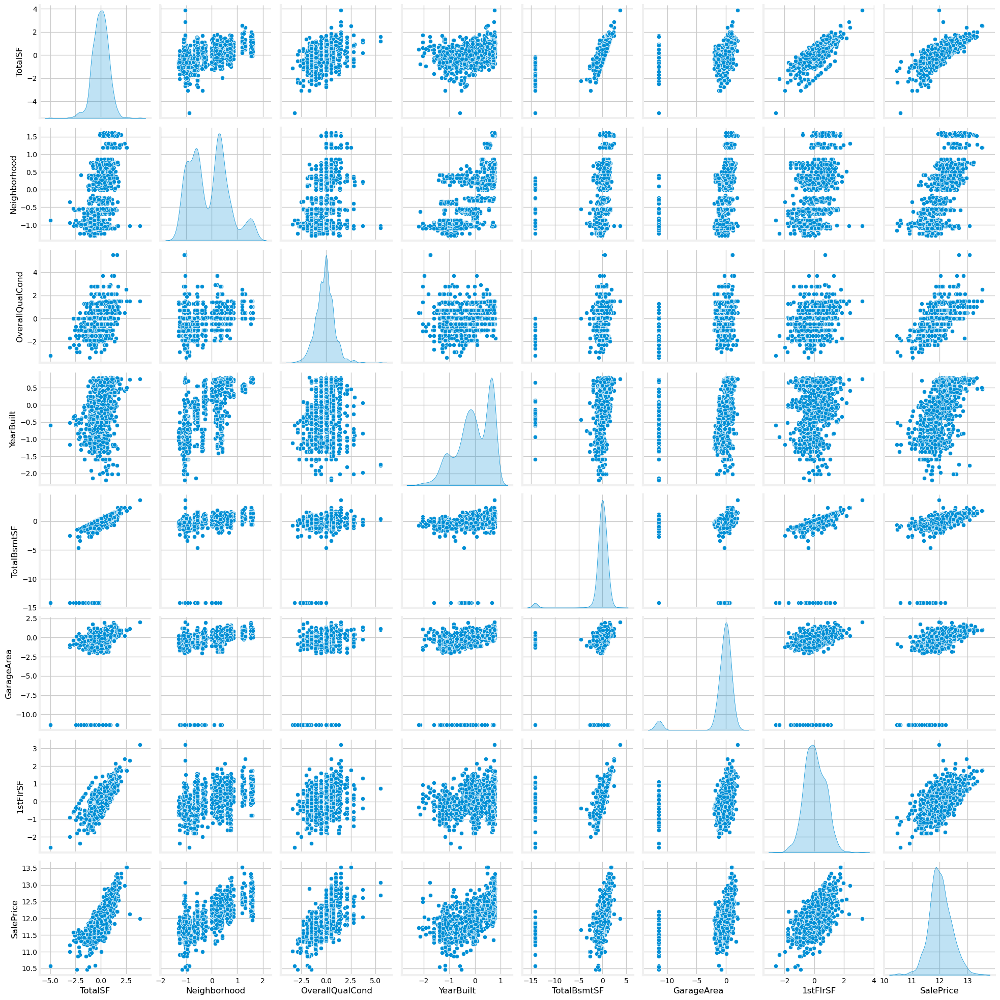

In [42]:
sel_cont_fts = test_pipe.named_steps['selector'].selected_cont_features_

sns.pairplot(data=pd.concat([train_slice[sel_cont_fts], y_log], axis=1), diag_kind='kde')

In [43]:
del train_slice, test_slice, oof_te, ft, sc, fs, test_pipe, sel_cont_fts

#### PCA

We now focus on performing a PCA on the continuous variables, with the hopes of further decorrelating the data features, and makeing analysis easier.

In [44]:
class PCAFeature(TransformerMixin, BaseEstimator):
    """
    A transformer that applies PCA to continuous features, optionally conditioned on boolean indicator variables.

    This transformer:
    - Identifies continuous features (i.e., not integers or known discrete columns),
    - Optionally restricts PCA fitting to rows where all indicator features (e.g., 'Has_X') are 1,
    - Demeans the continuous features before PCA,
    - Projects the data onto principal components,
    - Optionally drops original continuous features from the output.

    Compatible with scikit-learn pipelines.

    Parameters
    ----------
    n_pcs : int or None, default None
        Number of principal components to keep. If None, all components are kept.
    fit_feat_subset : bool, default False
        If True, PCA is fitted only on the subset of rows where all 'Has_X' indicator features are 1.
    keep_original_feats : bool, default True
        If False, original continuous features are dropped from the transformed output.
    random_state : int, default 0
        Random seed used for PCA reproducibility.

    Attributes
    ----------
    feature_names_ : list of str
        All column names in the input DataFrame at fit time.
    discrete_features_ : list of str
        Columns identified as discrete features (including integer-typed and 'bath'-like names).
    continuous_features_ : list of str
        Columns identified as continuous features (i.e., not discrete).
    indicator_features_ : list of str
        Subset of discrete features with names containing 'Has_'.
    continuous_boolean_indicators_ : dict
        Mapping from continuous columns to their corresponding boolean indicator feature (if any).
    continuous_wo_booleans_ : list of str
        Continuous features not associated with any 'Has_X' indicator.
    trained_means_ : pd.Series
        Means of continuous features used for centering prior to PCA.
    demeaned_cols_ : list of str
        Names of columns created by demeaning continuous features.
    pca_ : sklearn.decomposition.PCA
        Fitted PCA object.
    pca_columns_ : list of str
        Names of generated principal component features.
    loadings_ : pd.DataFrame
        PCA loadings (component weights), with original (demeaned) feature names as index.
    """


    def __init__(self, n_pcs=None, fit_feat_subset=False, keep_original_feats=True, random_state=0):
        
        self.n_pcs = n_pcs
        self.fit_feat_subset = fit_feat_subset
        self.keep_original_feats = keep_original_feats
        self.random_state = random_state

    def fit(self, X, y=None):

        X = X.copy() # shallow copy

        #......................................
        # Separating different kinds of columns:

        # First, saving all columns
        self.feature_names_ = X.columns.to_list() # names of all features
        
        # Discrete columns:
        # First, they're integers
        disc_cols = X.select_dtypes(include=int).columns.to_list()
        # Adding "baths" (half-baths are counted as 0.5, and thus are floats, although they should be included in the list of discrete columns)
        disc_cols += [col for col in X.columns if ('ath' in col) and (col not in disc_cols)]
        # Storing them
        self.discrete_features_ = disc_cols

        # Of those, selecting the 'has_X' indicator features:
        has_X_list = [hasx for hasx in self.discrete_features_ if 'Has_' in hasx]
        self.indicator_features_ = has_X_list

        # Continuous columns:
        # = to the remaining columns
        cont_cols = [col for col in X.columns if (col not in disc_cols)]
        # Storing them
        self.continuous_features_ = cont_cols

        # Of those, selecting those columns X that have an indicator feature has_X:
        cont_hasX = {}
        for col in self.continuous_features_:
            
            if not any([hasx.removeprefix('Has_') in col for hasx in has_X_list]):
                continue

            else:
                cont_hasX[col] = [hasx for hasx in has_X_list if hasx.removeprefix('Has_') in col][0]
        
        # Storing them
        self.continuous_boolean_indicators_ = cont_hasX

        # The rest:
        self.continuous_wo_booleans_ = [col for col in self.continuous_features_ if col not in self.continuous_boolean_indicators_.keys()]

        #......................................
        # Creating the de-meaned feature names
        self.demeaned_cols_ = ['demean_'+col for col in self.continuous_features_]

        #......................................
        # Creating the mask of features and the new DataFrame (whose indices and columns are a subset of the original X

        if self.fit_feat_subset:
            # The mask
            mask = (X[self.indicator_features_] == 1).all(axis=1)

            # The new DataFrame
            X_new = pd.DataFrame(index=mask[mask].index, columns=self.demeaned_cols_)

        else:
            # The mask
            mask = slice(None)

            # The new DataFrame
            X_new = pd.DataFrame(index=X.index, columns=self.demeaned_cols_)

        #......................................
        # Finding the means and filling in the values
        self.trained_means_ = X.loc[mask, self.continuous_features_].mean()

        # Filling in the values
        X_new[self.demeaned_cols_] = X.loc[mask, self.continuous_features_] - self.trained_means_

        #......................................
        # Performing PCA on the demeaned features

        # PCA object
        pca = PCA(random_state=self.random_state)

        # Fitting the PCA object
        pca.fit(X_new)

        # Saving PCA object
        self.pca_ = pca

        # Defining PC names
        self.pca_columns_ = ['pca'+str(i) for i in range(pca.n_components_)]

        # Finding and storing the PCA loadings
        loadings = pd.DataFrame(pca.components_.T, columns=self.pca_columns_, index=self.demeaned_cols_)
        self.loadings_ = loadings

        return self

    def transform(self, X):

        X_pca = X.copy() # shallow copy, where we shall store the PCs

        #......................................
        # De-meaning the features
        X_pca[self.demeaned_cols_] = X_pca[self.continuous_features_] - self.trained_means_

        # Performing transformation on the demeaned features
        X_pca[self.pca_columns_] = self.pca_.transform(X_pca[self.demeaned_cols_])

        # Defining outgoing columns
        out_cols = (X.columns.to_list() + self.pca_columns_)

        # Dropping originals if necessary
        if not self.keep_original_feats:
            out_cols = [col for col in out_cols if col not in self.continuous_features_]

        # Dropping last PCs
        if (type(self.n_pcs) == int) and (self.n_pcs < len(self.pca_columns_)):
            out_cols = [col for col in out_cols if col not in self.pca_columns_[self.n_pcs:]]

        # Returning the transformed DataFrame
        return X_pca[out_cols]

Checking that it works. First, with the default arguments for PCA:

In [45]:
# copying training dataframe
train_slice1 = raw_train.copy()
train_slice1 = train_slice1.drop(columns=['SalePrice'])
train_slice2 = train_slice1.copy()

# cleaning + feature engineering + unsupervised encoding + target encoding + function transformer + scaler transformerk + feature selector + PCA

oof_te = OOFTargetEncoderTransformer(cols=columns_encodings['target'],
                                     new_col_suffix="",
                                     n_splits=5,
                                     smoothing=20.0,
                                     random_state=42)

ft = SelectorFunctionTransformer(dex_threshold=2.0,
                                 skew_threshold=1.0,
                                 trans_method='log',
                                 cont_cols=pruned_cont_cols,
                                 verbose_feature_names_out=False)

sc = SelectorScalerTransformer(unique_counts_threshold=10,
                               scaling_method='robust',
                               cont_cols=pruned_cont_cols,
                               encodings=columns_encodings,
                               verbose_feature_names_out=False)

# selector w/ strict thresholds
fs = FeatureSelector(var_thr=0.01,
                     best_k=20,
                     t_thr=0.3,
                     encodings=columns_encodings,
                     random_state=None)

# default PCA
pc1 = PCAFeature(n_pcs=None,
                 fit_feat_subset=False,
                 keep_original_feats=True,
                 random_state=0)

test_pipe1 = Pipeline(steps=[('cleaning', cleaning_pipeline),
                             ('feature_engineer', FeatureEngineer(func=new_features,
                                                                 kwargs={'has_cols':has_cols})),
                             ('encoder', column_encoder(verbose_feature_names_out=False, encodings=columns_encodings)),
                             ('tenc', oof_te),
                             ('transf1', ft),
                             ('transf2', sc),
                             ('selector', fs),
                             ('pca', pc1)])

train_slice1 = test_pipe1.fit_transform(train_slice1, y_log)

print("Train")
display(train_slice1.head())

# now for test dataframe:
test_slice1 = raw_test.copy()

test_slice1 = test_pipe1.transform(test_slice1)

print("Test")
display(test_slice1.head())

print("Loadings")
display(test_pipe1.named_steps['pca'].loadings_)

Train


,TotalSF,OverallQual,Neighborhood,OverallQualCond,GarageCars,YearBuilt,AllBaths,TotalBsmtSF,BathsAbvGr,GarageArea,ExterQual,KitchenQual,BsmtQual,1stFlrSF,Has_Garage,Has_Bsmt,pca0,pca1,pca2,pca3,pca4,pca5,pca6
0,0.085950,7,0.335546,0.0,2,0.652174,3.5,-0.300181,2.5,0.243856,4,4,4,-0.524119,1,1,0.870129,-0.461398,0.137749,-0.249461,-0.795985,0.024555,0.409286
1,0.044827,6,0.203601,1.3,2,0.065217,2.5,0.492878,2.0,-0.078320,3,3,4,0.327547,1,1,1.134896,0.469345,0.840928,0.877492,-0.276706,0.168379,-0.312167
2,0.218326,7,0.335546,0.0,2,0.608696,3.5,-0.152897,2.5,0.435133,4,4,4,-0.365950,1,1,1.133039,-0.410400,0.169768,-0.272747,-0.625976,0.007421,0.394319
3,-0.006038,7,0.409701,0.0,3,-1.260870,2.0,-0.553912,1.0,0.535320,3,4,3,-0.270300,1,1,0.835755,-0.821754,-0.307317,0.558037,0.135526,-1.236521,-0.260228
4,0.745122,8,1.310980,0.5,3,0.586957,3.5,0.294081,2.5,1.021588,4,4,4,0.114059,1,1,2.140444,-0.204076,1.083042,-0.398463,-0.601806,-0.517934,0.130319


Test


,TotalSF,OverallQual,Neighborhood,OverallQualCond,GarageCars,YearBuilt,AllBaths,TotalBsmtSF,BathsAbvGr,GarageArea,ExterQual,KitchenQual,BsmtQual,1stFlrSF,Has_Garage,Has_Bsmt,pca0,pca1,pca2,pca3,pca4,pca5,pca6
0,-0.828127,5,-0.562422,-0.5,1,-0.260870,1.0,-0.239062,1.0,0.771869,3,3,3,-0.423937,1,1,0.955669,-0.822535,-1.259114,0.247212,-0.271740,0.129200,-0.220532
1,0.173728,6,-0.562422,0.1,1,-0.326087,1.5,0.598582,1.5,-0.792372,3,4,3,0.441062,1,1,0.343193,0.872401,-0.122119,0.363420,0.555813,0.199779,-0.076789
2,0.077195,5,0.309486,-1.0,2,0.521739,2.5,-0.135210,2.5,0.007652,3,3,4,-0.346957,1,1,0.628006,-0.244187,-0.428061,-0.986706,-0.436602,-0.134771,0.319034
3,0.050744,6,0.309486,0.1,2,0.543478,2.5,-0.139618,2.5,-0.038744,3,4,3,-0.351690,1,1,0.717571,-0.173905,0.215538,-0.155165,-0.677508,0.045812,0.255172
4,0.080117,8,0.899934,0.5,2,0.413043,2.0,0.521817,2.0,0.097084,4,4,4,0.358625,1,1,1.321884,0.381342,0.778276,-0.159165,-0.518597,-0.132805,-0.407894


Loadings


,pca0,pca1,pca2,pca3,pca4,pca5,pca6
demean_TotalSF,0.160114,0.122942,0.404070,-0.134531,0.437437,-0.255486,0.721979
demean_Neighborhood,0.116269,0.015235,0.455537,-0.378752,-0.410978,-0.604024,-0.318644
demean_OverallQualCond,0.121235,0.049048,0.582496,0.762420,-0.197073,0.145384,-0.048327
demean_YearBuilt,0.094768,-0.001559,0.281495,-0.455574,-0.427626,0.681971,0.237235
demean_TotalBsmtSF,0.466101,0.850129,-0.222264,0.014619,-0.069936,0.019753,-0.071650
demean_GarageArea,0.842383,-0.507743,-0.175715,0.037683,0.011295,-0.011394,-0.005867
demean_1stFlrSF,0.101521,0.041501,0.361103,-0.219048,0.642670,0.288341,-0.559846


In [46]:
# copying training dataframe
train_slice2 = raw_train.copy()
train_slice2 = train_slice2.drop(columns=['SalePrice'])

# cleaning + feature engineering + unsupervised encoding + target encoding + function transformer + scaler transformer + feature selector + PCA

oof_te = OOFTargetEncoderTransformer(cols=columns_encodings['target'],
                                     new_col_suffix="",
                                     n_splits=5,
                                     smoothing=20.0,
                                     random_state=42)

ft = SelectorFunctionTransformer(dex_threshold=2.0,
                                 skew_threshold=1.0,
                                 trans_method='log',
                                 cont_cols=pruned_cont_cols,
                                 verbose_feature_names_out=False)

sc = SelectorScalerTransformer(unique_counts_threshold=10,
                               scaling_method='robust',
                               cont_cols=pruned_cont_cols,
                               encodings=columns_encodings,
                               verbose_feature_names_out=False)

# selector w/ strict thresholds
fs = FeatureSelector(var_thr=0.01,
                     best_k=20,
                     t_thr=0.3,
                     encodings=columns_encodings,
                     random_state=None)

# advanced PCA
pc2 = PCAFeature(n_pcs=None, # selecting all PCs
                 fit_feat_subset=True, # fitting PCA object to subset with has_X = True
                 keep_original_feats=False, # dropping the original features
                 random_state=0)

test_pipe2 = Pipeline(steps=[('cleaning', cleaning_pipeline),
                             ('feature_engineer', FeatureEngineer(func=new_features,
                                                                 kwargs={'has_cols':has_cols})),
                             ('encoder', column_encoder(verbose_feature_names_out=False, encodings=columns_encodings)),
                             ('tenc', oof_te),
                             ('transf1', ft),
                             ('transf2', sc),
                             ('selector', fs),
                             ('pca', pc2)])

train_slice2 = test_pipe2.fit_transform(train_slice2, y_log)

print("Train")
display(train_slice2.head())

# now for test dataframe:
test_slice2 = raw_test.copy()

test_slice2 = test_pipe2.transform(test_slice2)

print("Test")
display(test_slice2.head())

print("Loadings")
display(test_pipe2.named_steps['pca'].loadings_)

Train


,OverallQual,GarageCars,AllBaths,BsmtQual,BathsAbvGr,ExterQual,KitchenQual,Has_Garage,Has_Bsmt,pca0,pca1,pca2,pca3,pca4,pca5,pca6
0,7,2,3.5,4,2.5,4,4,1,1,0.057832,0.173426,0.973890,0.150604,0.033976,0.357826,-0.098799
1,6,2,2.5,4,2.0,3,3,1,1,0.815993,1.053090,-0.229411,-0.268268,0.308171,-0.323522,-0.082260
2,7,2,3.5,4,2.5,4,4,1,1,0.300230,0.076275,0.846212,0.278599,0.004821,0.328749,-0.110420
3,7,3,2.0,3,1.0,3,4,1,1,-0.387486,0.430032,-0.006335,0.736919,-1.239491,-0.473407,-0.176420
4,8,3,3.5,4,2.5,4,4,1,1,1.658119,0.242241,0.974969,0.303460,-0.504559,0.009849,-0.172202


Test


,OverallQual,GarageCars,AllBaths,BsmtQual,BathsAbvGr,ExterQual,KitchenQual,Has_Garage,Has_Bsmt,pca0,pca1,pca2,pca3,pca4,pca5,pca6
0,5,1,1.0,3,1.0,3,3,1,1,-0.845540,-0.211216,0.291427,1.095286,0.247288,-0.444042,-0.184809
1,6,1,1.5,3,1.5,3,4,1,1,-0.089165,-0.016273,-0.977713,-0.587907,0.255859,-0.004286,-0.053408
2,5,2,2.5,4,2.5,3,3,1,1,-0.264199,-0.789908,0.846752,-0.058865,-0.153889,0.299358,-0.057649
3,6,2,2.5,3,2.5,3,4,1,1,0.069928,0.221828,0.720813,-0.125431,0.079244,0.241688,-0.069835
4,8,2,2.0,4,2.0,4,4,1,1,1.019220,0.261974,0.462268,-0.400780,-0.015892,-0.414462,-0.025275


Loadings


,pca0,pca1,pca2,pca3,pca4,pca5,pca6
demean_TotalSF,0.441236,-0.069433,-0.247702,-0.030392,-0.405360,0.752606,-0.086473
demean_Neighborhood,0.379782,0.027675,0.560949,-0.344979,-0.547395,-0.347605,-0.029250
demean_OverallQualCond,0.327666,0.914888,-0.126199,-0.021710,0.190619,-0.049756,-0.020147
demean_YearBuilt,0.277831,-0.130933,0.562269,-0.160956,0.621937,0.362964,0.212284
demean_TotalBsmtSF,0.429296,-0.299168,-0.300204,-0.233353,0.333359,-0.279917,-0.626215
demean_GarageArea,0.364035,-0.087665,0.196796,0.891247,-0.018486,-0.140154,-0.082208
demean_1stFlrSF,0.399631,-0.207515,-0.403802,-0.070086,0.037827,-0.283797,0.739792


Defining a indicator feature, how many of the "Has_X" features is True.

In [47]:
train_slice1['Has_Many'] = sum([train_slice1[col] for col in train_slice1.columns if 'Has_' in col])

train_slice2['Has_Many'] = sum([train_slice2[col] for col in train_slice2.columns if 'Has_' in col])

The pairplot for the default PCA:

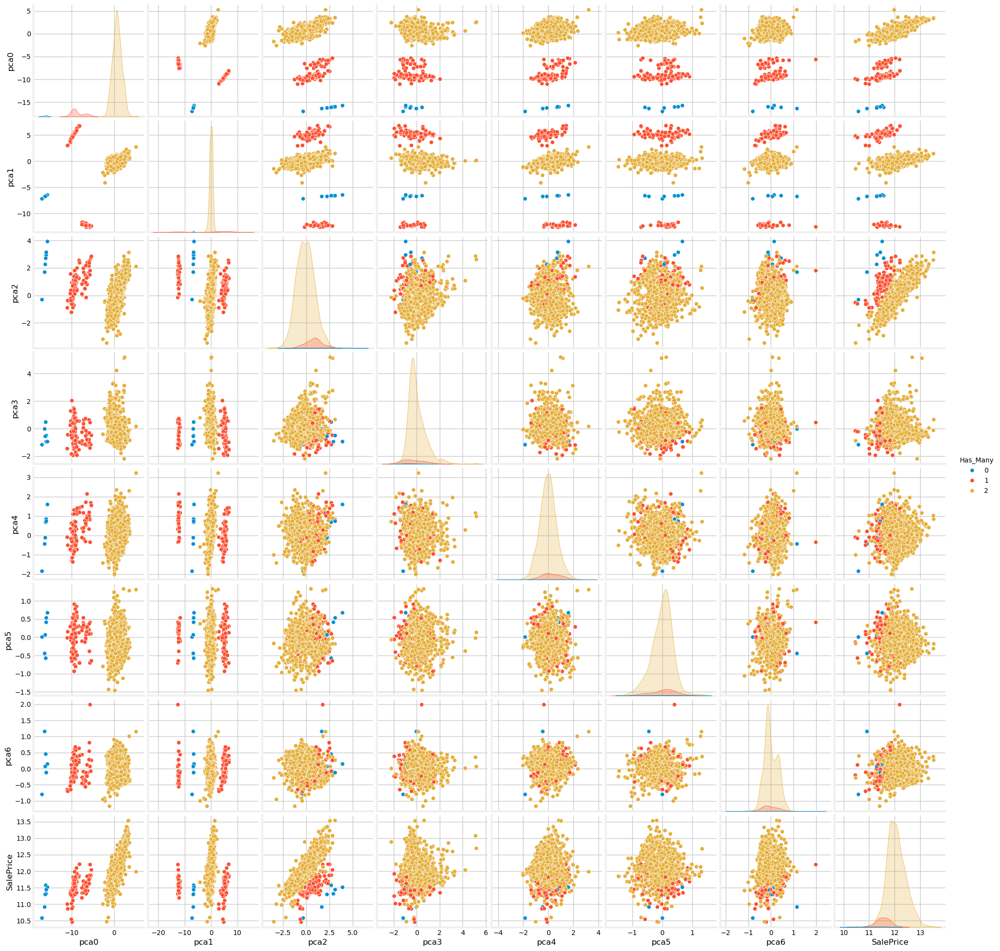

In [48]:
sns.pairplot(data=pd.concat([train_slice1[test_pipe1.named_steps['pca'].pca_columns_+['Has_Many']], y_log], axis=1), diag_kind='kde', hue='Has_Many', palette=palette_538)

The pairplot for the advanced PCA:

In [49]:
train_slice2[train_slice2['Has_Many'] == 0]

,OverallQual,GarageCars,AllBaths,BsmtQual,BathsAbvGr,ExterQual,KitchenQual,Has_Garage,Has_Bsmt,pca0,pca1,pca2,pca3,pca4,pca5,pca6,Has_Many
39,4,0,2.0,0,2.0,3,2,0,0,-11.984984,4.057761,1.958656,-6.345268,-3.767866,4.300734,10.006028,0
520,4,0,2.0,0,2.0,3,3,0,0,-12.438883,5.151906,1.463169,-6.039919,-4.421369,4.421961,8.893820,0
533,1,0,1.0,0,1.0,2,2,0,0,-15.021993,3.306627,3.949939,-6.009899,-3.094159,2.748755,8.255671,0
705,4,0,2.0,0,2.0,2,2,0,0,-13.308461,4.643494,2.504807,-5.968082,-3.967973,4.819385,8.078164,0
1011,5,0,2.0,0,2.0,3,3,0,0,-11.059461,4.253832,1.427556,-6.452461,-3.841563,4.838355,10.561843,0
1179,5,0,1.0,0,1.0,3,3,0,0,-11.915740,4.530601,1.861333,-6.310704,-3.605720,4.273714,9.959773,0
1218,4,0,1.0,0,1.0,3,3,0,0,-12.740494,4.367883,2.514921,-6.236723,-3.716646,4.115149,9.143041,0


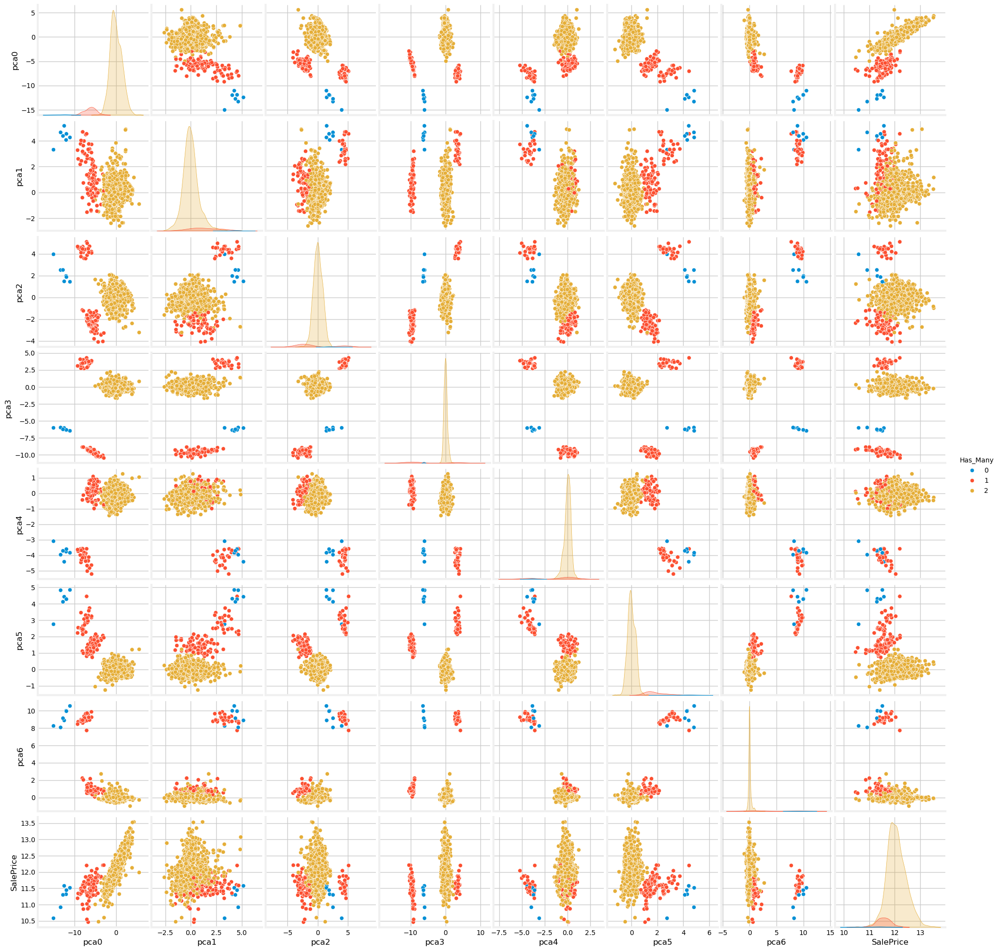

In [50]:
if test_pipe2.named_steps['pca'].n_pcs == None:
    sns.pairplot(data=pd.concat([train_slice2[test_pipe2.named_steps['pca'].pca_columns_ +['Has_Many']], y_log], axis=1), diag_kind='kde', hue='Has_Many', palette=palette_538)

else:
    sns.pairplot(data=pd.concat([train_slice2[test_pipe2.named_steps['pca'].pca_columns_[:test_pipe2.named_steps['pca'].n_pcs]+['Has_Many']], y_log], axis=1), diag_kind='kde', hue='Has_Many', palette=palette_538)

In [51]:
del train_slice1, train_slice2, test_slice1, test_slice2, oof_te, ft, sc, fs, pc1, pc2, test_pipe1, test_pipe2

#### K-means Cluster Feature Creator

First, we create a subclass in charge of creating a `cluster` feature with KMeans. Note that if `n_clusters=0`, then we will not do anything!

In [52]:
class KMeansFeature(TransformerMixin, BaseEstimator):
    """
    Adds a KMeans cluster label as a new feature, with optional scaling of PCA features.

    This transformer fits a KMeans clustering model on the input features and appends a `'cluster'` column to the dataset containing the predicted cluster labels. Optionally, PCA features can be scaled before clustering using a specified method.

    If `n_clusters` is None, the transformer behaves as a passthrough and returns the original DataFrame unchanged.

    Compatible with scikit-learn pipelines.

    Parameters
    ----------
    n_clusters : int or None, default None
        Number of clusters for KMeans. If None, clustering is skipped.
    max_iter : int, default 300
        Maximum number of iterations for a single KMeans run.
    n_init : int, default 10
        Number of times the KMeans algorithm is run with different centroid seeds.
    scaling_method : {'standard', 'robust', 'minmax'} or None, default None
        Optional method for scaling PCA features prior to clustering. If None, no scaling is applied.
    verbose_feature_names_out : bool, default False
        If True, output feature names from transformers include the step name as a prefix.
    random_state : int, default 0
        Seed for reproducibility.

    Attributes
    ----------
    cluster_pipe_ : sklearn.pipeline.Pipeline
        Pipeline combining optional scaling and the fitted KMeans model.
    pca_columns_ : list of str
        List of PCA column names used for scaling (only set if `scaling_method` is used).
    distances_ : np.ndarray
        Distances from each sample to each cluster center (available after `transform`).
    """
    
    def __init__(self, n_clusters=None, max_iter=300, n_init=10, scaling_method=None, verbose_feature_names_out=False, random_state=0):
        
        self.n_clusters   = n_clusters
        self.max_iter     = max_iter
        self.n_init       = n_init
        self.verbose_feature_names_out = verbose_feature_names_out
        self.random_state = random_state

        # the scaler to use:
        self.scaling_method = scaling_method

        if scaling_method == None:
            self.scaler = None
        elif scaling_method == 'standard':
            self.scaler = StandardScaler()
        elif scaling_method == 'robust':
            self.scaler = RobustScaler()
        elif scaling_method == 'minmax':
            self.scaler = MinMaxScaler()
        else:
            raise ValueError(f"{scaler} must be either 'standard', 'robust', or 'minmax'.")

    def fit(self, X, y=None):

        if self.n_clusters == None:
            pass # override: no need to fit KMeans!
        
        else: # will cluster, but first decide whether PCs need to be scaled
            
            if self.scaling_method == None: # no scaling of PCs, apply KMeans directly

                # defining the clustering pipeline
                self.cluster_pipe_ = Pipeline(steps=[("kmeans", KMeans(n_clusters=self.n_clusters,
                                                                       random_state=self.random_state))])
            else: # scaling of PCs needed

                # finding the PCA columns
                self.pca_columns_ = [col for col in X.columns if 'pca' in col]

                # defining the scaler
                pca_scaler = ColumnTransformer(transformers=[('scaler',
                                                              self.scaler,
                                                              self.pca_columns_)],
                                               remainder='passthrough',
                                               verbose_feature_names_out=self.verbose_feature_names_out)

                # defining the KMeans object
                kmeans = KMeans(n_clusters=self.n_clusters,
                                max_iter=self.max_iter,
                                n_init=self.n_init,
                                random_state=self.random_state)

                # defining the clustering pipeline
                self.cluster_pipe_ = Pipeline(steps=[('pca_scaler', pca_scaler),
                                                     ("kmeans", kmeans)])
            
            # fitting the clustering pipeline
            self.cluster_pipe_.fit(X)
            
        return self

    def transform(self, X):

        # Check we got a DataFrame
        if not isinstance(X, pd.DataFrame):
            raise ValueError("FeatureAdder.transform input must be a pandas DataFrame")

        X_out = X.copy() # shallow copy

        if self.n_clusters == None:
            pass

        else:
            
            # distances to centroids
            self.distances_ = self.cluster_pipe_.transform(X_out)

            # column of cluster‐labels (as integers)
            X_clusters = self.cluster_pipe_.predict(X_out)
            
            X_out['cluster'] = X_clusters # adding clusters column!
        
        return X_out

Putting this into pipelines and checking that it all works:

In [53]:
# copying training dataframe
train_slice = raw_train.copy()
train_slice = train_slice.drop(columns=['SalePrice'])

# cleaning + feature engineering + unsupervised encoding + target encoding + function transformer + scaler transformer + feature selector + PCA + clustering

oof_te = OOFTargetEncoderTransformer(cols=columns_encodings['target'],
                                     new_col_suffix="",
                                     n_splits=5,
                                     smoothing=20.0,
                                     random_state=42)

ft = SelectorFunctionTransformer(dex_threshold=2.0,
                                 skew_threshold=1.0,
                                 trans_method='log',
                                 cont_cols=pruned_cont_cols,
                                 verbose_feature_names_out=False)

sc = SelectorScalerTransformer(unique_counts_threshold=10,
                               scaling_method='robust',
                               cont_cols=pruned_cont_cols,
                               encodings=columns_encodings,
                               verbose_feature_names_out=False)

# selector w/ strict thresholds
fs = FeatureSelector(var_thr=0.01,
                     best_k=20,
                     t_thr=0.3,
                     encodings=columns_encodings,
                     random_state=None)

# advanced PCA
pc = PCAFeature(n_pcs=None, # selecting all PCs
                fit_feat_subset=True, # fitting PCA object to subset with has_X = True
                keep_original_feats=False, # dropping the original features
                random_state=0)

km = KMeansFeature(n_clusters=4,
                   max_iter=300,
                   n_init=10,
                   scaling_method='robust',
                   verbose_feature_names_out=False,
                   random_state=0)

test_pipe = Pipeline(steps=[('cleaning', cleaning_pipeline),
                            ('feature_engineer', FeatureEngineer(func=new_features,
                                                                 kwargs={'has_cols':has_cols})),
                            ('encoder', column_encoder(verbose_feature_names_out=False, encodings=columns_encodings)),
                            ('tenc', oof_te),
                            ('transf1', ft),
                            ('transf2', sc),
                            ('selector', fs),
                            ('pca', pc),
                            ('km', km)])

train_slice = test_pipe.fit_transform(train_slice, y_log)

print("Train")
display(train_slice.head())

# now for test dataframe:
test_slice = raw_test.copy()

test_slice = test_pipe.transform(test_slice)

print("Test")
display(test_slice.head())

print("Training distances")
display(test_pipe.named_steps["km"].distances_)

Train


,OverallQual,GarageCars,AllBaths,BathsAbvGr,ExterQual,BsmtQual,KitchenQual,Has_Garage,Has_Bsmt,pca0,pca1,pca2,pca3,pca4,pca5,pca6,cluster
0,7,2,3.5,2.5,4,4,4,1,1,0.057832,0.173426,0.973890,0.150604,0.033976,0.357826,-0.098799,3
1,6,2,2.5,2.0,3,4,3,1,1,0.815993,1.053090,-0.229411,-0.268268,0.308171,-0.323522,-0.082260,0
2,7,2,3.5,2.5,4,4,4,1,1,0.300230,0.076275,0.846212,0.278599,0.004821,0.328749,-0.110420,3
3,7,3,2.0,1.0,3,3,4,1,1,-0.387486,0.430032,-0.006335,0.736919,-1.239491,-0.473407,-0.176420,3
4,8,3,3.5,2.5,4,4,4,1,1,1.658119,0.242241,0.974969,0.303460,-0.504559,0.009849,-0.172202,3


Test


,OverallQual,GarageCars,AllBaths,BathsAbvGr,ExterQual,BsmtQual,KitchenQual,Has_Garage,Has_Bsmt,pca0,pca1,pca2,pca3,pca4,pca5,pca6,cluster
0,5,1,1.0,1.0,3,3,3,1,1,-0.845540,-0.211216,0.291427,1.095286,0.247288,-0.444042,-0.184809,0
1,6,1,1.5,1.5,3,3,4,1,1,-0.089165,-0.016273,-0.977713,-0.587907,0.255859,-0.004286,-0.053408,0
2,5,2,2.5,2.5,3,4,3,1,1,-0.264199,-0.789908,0.846752,-0.058865,-0.153889,0.299358,-0.057649,0
3,6,2,2.5,2.5,3,3,4,1,1,0.069928,0.221828,0.720813,-0.125431,0.079244,0.241688,-0.069835,3
4,8,2,2.0,2.0,4,4,4,1,1,1.019220,0.261974,0.462268,-0.400780,-0.015892,-0.414462,-0.025275,3


Training distances


,kmeans0,kmeans1,kmeans2,kmeans3
0,2.316073,48.222461,16.867464,4.529324
1,1.812416,47.694221,14.315226,3.187227
2,2.294255,47.432381,15.250277,3.049514
3,2.229560,47.485283,15.192030,2.130798
4,3.558324,47.681949,15.430575,1.634762
...,...,...,...,...
1454,14.875150,46.170605,1.969617,15.475493
1455,2.380884,47.697852,15.001259,4.779646
1456,1.348671,48.071813,15.905850,3.582682
1457,15.798886,45.303489,2.002411,16.204360


The pairplot:

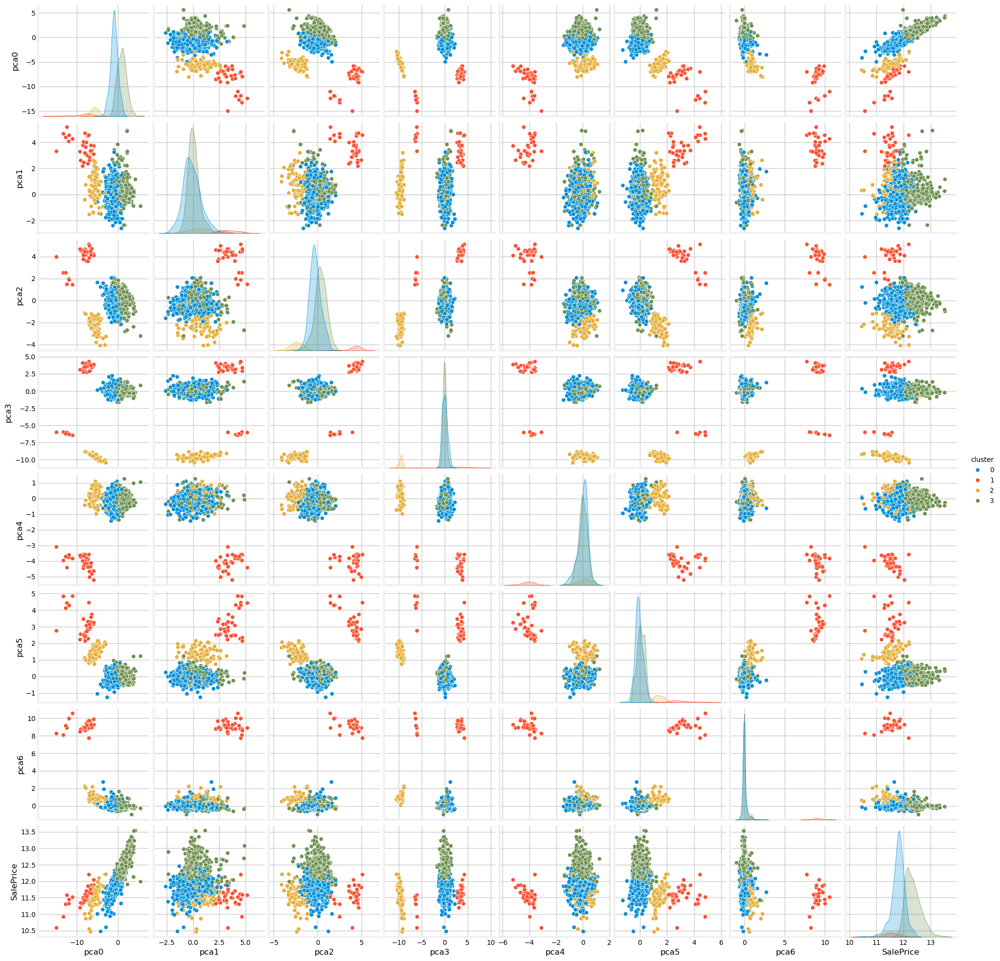

In [54]:
sns.pairplot(data=pd.concat([train_slice[test_pipe.named_steps['pca'].pca_columns_+['cluster']], y_log], axis=1), diag_kind='kde', hue='cluster', palette=palette_538)

In [55]:
del train_slice, test_slice, oof_te, ft, sc, fs, pc, km, test_pipe

#### One-Hot Encoding

Finally, we go over all OHE features, and perform OHE.

In [56]:
def ohe_from_subset(subset=(columns_encodings['ohe']+['cluster']), except_list=[]):
    """
    Creates a selector function that filters object-dtype columns from a given subset.

    This function returns another function that, when called with a DataFrame `X`, returns the list of column names from the provided `subset` that exist in `X` and have an object dtype.

    Parameters
    ----------
    subset : list of str
        A list of column names to consider for object-dtype filtering.

    Returns
    -------
    function
        A selector function that takes a DataFrame and returns a list of object-dtype column names from the subset.
    """
    
    def selector(X):
        
        cols_list = []

        for col in subset:
            if col not in X.columns:
                continue
            if col in except_list:
                continue
            # if pd.api.types.is_integer_dtype(X[col]):
            #     cols_list.append(col)
            else:
                cols_list.append(col)
        
        return cols_list
    
    return selector

Having created that, we define the OHE preprocessor:

In [57]:
def ohe_preprocessor(verbose_feature_names_out=False, subset=(columns_encodings['ohe']+['cluster'])):

    # defining the column selector
    selector = ohe_from_subset(subset=subset, except_list=[])

    # OHE transformer
    ohe_ct = ColumnTransformer(transformers=[('ohe',
                                              OneHotEncoder(handle_unknown='ignore', sparse_output=False, dtype=int),
                                              selector)],
                               remainder='passthrough',
                               verbose_feature_names_out=verbose_feature_names_out)

    # Pipeline
    post_pipe = Pipeline([('ohe', ohe_ct)])

    return post_pipe

Checking it all works:

In [58]:
# copying training dataframe
train_slice = raw_train.copy()
train_slice = train_slice.drop(columns=['SalePrice'])

# cleaning + feature engineering + unsupervised encoding + target encoding + function transformer + scaler transformer + feature selector + PCA + clustering + OHE

oof_te = OOFTargetEncoderTransformer(cols=columns_encodings['target'],
                                     new_col_suffix="",
                                     n_splits=5,
                                     smoothing=20.0,
                                     random_state=42)

ft = SelectorFunctionTransformer(dex_threshold=2.0,
                                 skew_threshold=1.0,
                                 trans_method='log',
                                 cont_cols=pruned_cont_cols,
                                 verbose_feature_names_out=False)

sc = SelectorScalerTransformer(unique_counts_threshold=10,
                               scaling_method='robust',
                               cont_cols=pruned_cont_cols,
                               encodings=columns_encodings,
                               verbose_feature_names_out=False)

# selector w/ strict thresholds
fs = FeatureSelector(var_thr=0.01,
                     best_k=20,
                     t_thr=0.3,
                     encodings=columns_encodings,
                     random_state=None)

# advanced PCA
pc = PCAFeature(n_pcs=None, # selecting all PCs
                fit_feat_subset=True, # fitting PCA object to subset with has_X = True
                keep_original_feats=False, # dropping the original features
                random_state=0)

km = KMeansFeature(n_clusters=4,
                   max_iter=300,
                   n_init=10,
                   scaling_method='robust',
                   verbose_feature_names_out=False,
                   random_state=0)

test_pipe = Pipeline(steps=[('cleaning', cleaning_pipeline),
                            ('feature_engineer', FeatureEngineer(func=new_features,
                                                                 kwargs={'has_cols':has_cols})),
                            ('encoder', column_encoder(verbose_feature_names_out=False, encodings=columns_encodings)),
                            ('tenc', oof_te),
                            ('transf1', ft),
                            ('transf2', sc),
                            ('selector', fs),
                            ('pca', pc),
                            ('km', km),
                            ('ohe', ohe_preprocessor(verbose_feature_names_out=False))])

train_slice = test_pipe.fit_transform(train_slice, y_log)

print("Train")
display(train_slice.head())

# now for test dataframe:
test_slice = raw_test.copy()

test_slice = test_pipe.transform(test_slice)

print("Test")
display(test_slice.head())

Train


,cluster_0,cluster_1,cluster_2,cluster_3,OverallQual,GarageCars,AllBaths,ExterQual,BathsAbvGr,BsmtQual,KitchenQual,Has_Garage,Has_Bsmt,pca0,pca1,pca2,pca3,pca4,pca5,pca6
0,0,0,0,1,7,2,3.5,4,2.5,4,4,1,1,0.057832,0.173426,0.973890,0.150604,0.033976,0.357826,-0.098799
1,1,0,0,0,6,2,2.5,3,2.0,4,3,1,1,0.815993,1.053090,-0.229411,-0.268268,0.308171,-0.323522,-0.082260
2,0,0,0,1,7,2,3.5,4,2.5,4,4,1,1,0.300230,0.076275,0.846212,0.278599,0.004821,0.328749,-0.110420
3,0,0,0,1,7,3,2.0,3,1.0,3,4,1,1,-0.387486,0.430032,-0.006335,0.736919,-1.239491,-0.473407,-0.176420
4,0,0,0,1,8,3,3.5,4,2.5,4,4,1,1,1.658119,0.242241,0.974969,0.303460,-0.504559,0.009849,-0.172202


Test


,cluster_0,cluster_1,cluster_2,cluster_3,OverallQual,GarageCars,AllBaths,ExterQual,BathsAbvGr,BsmtQual,KitchenQual,Has_Garage,Has_Bsmt,pca0,pca1,pca2,pca3,pca4,pca5,pca6
0,1,0,0,0,5,1,1.0,3,1.0,3,3,1,1,-0.845540,-0.211216,0.291427,1.095286,0.247288,-0.444042,-0.184809
1,1,0,0,0,6,1,1.5,3,1.5,3,4,1,1,-0.089165,-0.016273,-0.977713,-0.587907,0.255859,-0.004286,-0.053408
2,1,0,0,0,5,2,2.5,3,2.5,4,3,1,1,-0.264199,-0.789908,0.846752,-0.058865,-0.153889,0.299358,-0.057649
3,0,0,0,1,6,2,2.5,3,2.5,3,4,1,1,0.069928,0.221828,0.720813,-0.125431,0.079244,0.241688,-0.069835
4,0,0,0,1,8,2,2.0,4,2.0,4,4,1,1,1.019220,0.261974,0.462268,-0.400780,-0.015892,-0.414462,-0.025275


In [59]:
del train_slice, test_slice, oof_te, ft, sc, fs, pc, km, test_pipe

#### Final Preprocessing Pipelines

In [60]:
from sklearn.base import clone

First, we define the steps:

In [61]:
# cleaning
cln = cleaning_pipeline

# feature engineering
fe = FeatureEngineer(func=new_features,
                     kwargs={'has_cols':has_cols})

# unsupervised encoding
uenc = column_encoder(verbose_feature_names_out=False,
                      encodings=columns_encodings)

# supervised (target) encoding
senc = OOFTargetEncoderTransformer(cols=columns_encodings['target'],
                                   new_col_suffix="",
                                   n_splits=5, # ???
                                   smoothing=20.0, # hyperparam
                                   random_state=42)

# function transformer (log/yeo-johnson)
ft = SelectorFunctionTransformer(dex_threshold=2.0, # ???
                                 skew_threshold=1.0, # ???
                                 trans_method='log', # ???
                                 cont_cols=pruned_cont_cols,
                                 verbose_feature_names_out=False)

# scaler transformer
sc = SelectorScalerTransformer(unique_counts_threshold=10, # ???
                               scaling_method='robust', # ???
                               cont_cols=pruned_cont_cols,
                               encodings=columns_encodings,
                               verbose_feature_names_out=False)

# feature selector (w/ strict thresholds)
fs = FeatureSelector(var_thr=0.01,# ???
                     best_k=20, # hyperparam
                     t_thr=0.3, # hyperparam
                     encodings=columns_encodings,
                     random_state=None)

fs0 = FeatureSelector(var_thr=0.,
                      best_k='all',
                      t_thr=None,
                      encodings=columns_encodings,
                      random_state=None)

# advanced PCA
pc = PCAFeature(n_pcs=None, # ???
                fit_feat_subset=True, # hyperparam
                keep_original_feats=False, # ???
                random_state=0)

# K-Means clustering
km = KMeansFeature(n_clusters=4, # hyperparam
                   max_iter=300, # ???
                   n_init=10, # ???
                   scaling_method='robust', # ???
                   verbose_feature_names_out=False,
                   random_state=0)

# ohe
ohe = ohe_preprocessor(verbose_feature_names_out=False,
                       subset=(columns_encodings['ohe']+['cluster']))

pipeline_hyperparameter_names = ['target_encoder__smoothing', 'selector__best_k', 'selector__t_thr', 'pca__fit_feat_subset', 'pca__keep_original_feats', 'cluster__n_clusters']

Putting together the preprocessing steps into a single pipeline:

In [62]:
raw_pipe = Pipeline(steps=[('cleaning', cln),
                           ('encoder', uenc),
                           ('target_encoder', senc),
                           ('selector', fs0),
                           ('ohe', ohe)])

eng_pipe = Pipeline(steps=[('cleaning', cln),
                           ('feature_engineer', fe),
                           ('encoder', uenc),
                           ('target_encoder', senc),
                           ('transformer', ft),
                           ('scaler', sc),
                           ('selector', fs),
                           ('ohe', ohe)])

clus_pipe = Pipeline(steps=(eng_pipe.steps[:-1] + 
                            [('pca', pc),
                             ('cluster', km),
                             ('ohe', ohe)]))

final_preproc = {'raw':raw_pipe, 'eng':eng_pipe, 'clus':clus_pipe}

In [63]:
preproc = clone(final_preproc['raw'])

proc_data = preproc.fit_transform(X_train, y_train)

display(proc_data.head())

display(preproc.transform(X_val).head())

del preproc, proc_data

,SaleType_0,SaleType_1,SaleType_2,SaleType_3,SaleType_4,SaleType_5,SaleType_6,SaleType_7,SaleType_8,Condition1_0,Condition1_1,Condition1_2,Condition1_3,Condition1_4,Condition1_5,Condition1_6,Condition1_7,Condition1_8,RoofMatl_0,RoofMatl_1,RoofMatl_2,RoofMatl_3,RoofMatl_4,RoofMatl_5,RoofMatl_6,Condition2_0,Condition2_1,Condition2_2,Condition2_3,Condition2_4,Condition2_5,Condition2_6,HouseStyle_0,HouseStyle_1,HouseStyle_2,HouseStyle_3,HouseStyle_4,HouseStyle_5,HouseStyle_6,HouseStyle_7,GarageType_0,GarageType_1,GarageType_2,GarageType_3,GarageType_4,GarageType_5,GarageType_6,Heating_0,Heating_1,Heating_2,Heating_3,Heating_4,Heating_5,Foundation_0,Foundation_1,Foundation_2,Foundation_3,Foundation_4,Foundation_5,SaleCondition_0,SaleCondition_1,SaleCondition_2,SaleCondition_3,SaleCondition_4,SaleCondition_5,RoofStyle_0,RoofStyle_1,RoofStyle_2,RoofStyle_3,RoofStyle_4,RoofStyle_5,Electrical_0,Electrical_1,Electrical_2,Electrical_3,Electrical_4,Fence_0,Fence_1,Fence_2,Fence_3,Fence_4,MiscFeature_0,MiscFeature_1,MiscFeature_2,MiscFeature_3,MiscFeature_4,MSZoning_0,MSZoning_1,MSZoning_2,MSZoning_3,MSZoning_4,BldgType_0,BldgType_1,BldgType_2,BldgType_3,BldgType_4,LotConfig_0,LotConfig_1,LotConfig_2,LotConfig_3,LotConfig_4,MasVnrType_0,MasVnrType_1,MasVnrType_2,MasVnrType_3,LandContour_0,LandContour_1,LandContour_2,LandContour_3,LotShape_0,LotShape_1,LotShape_2,LotShape_3,PavedDrive_0,PavedDrive_1,PavedDrive_2,Alley_0,Alley_1,Alley_2,LandSlope_0,LandSlope_1,LandSlope_2,MSSubClass,LotFrontage,LotArea,Neighborhood,Exterior1st,Exterior2nd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,CentralAir,Street,Utilities,Id,OverallQual,OverallCond,YearBuilt,YearRemodAdd,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,MoSold,YrSold
6,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,1,0,0,1,0,1,0,1,0,0,12.064393,75.0,10084.0,12.246209,12.193288,12.197069,186.0,1369.0,0.0,317.0,1686.0,1694.0,0.0,0.0,1694.0,636.0,255.0,57.0,0.0,0.0,0.0,0.0,0.0,6,1,7,3,2,3,3,4,5,3,5,3,4,4,0,1,1,0,7,8,5,2004,2005,1,0,2,0,3,1,7,1,2004,2,8,2007
807,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,1,0,0,11.982330,144.0,21384.0,11.778892,11.834613,11.850676,0.0,1309.0,0.0,15.0,1324.0,1072.0,504.0,0.0,1576.0,528.0,0.0,312.0,0.0,0.0,0.0,0.0,0.0,6,1,7,4,2,3,3,3,5,3,3,3,3,4,0,1,1,0,808,5,6,1923,2004,2,0,1,1,3,1,6,1,1923,2,5,2009
955,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,1,0,0,0,0,0,1,0,1,0,1,0,0,11.890326,82.0,7136.0,12.176971,11.876455,11.878811,423.0,484.0,0.0,495.0,979.0,979.0,979.0,0.0,1958.0,492.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3,1,7,1,1,3,3,0,3,3,4,3,3,3,0,0,1,0,956,6,6,1946,1950,0,0,2,0,4,2,8,0,1946,2,8,2007
1040,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,1,0,0,12.080472,88.0,13125.0,11.866946,11.860104,11.870375,67.0,168.0,682.0,284.0,1134.0,1803.0,0.0,0.0,1803.0,484.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3,4,3,1,2,3,3,3,5,3,3,3,3,3,0,1,1,0,1041,5,4,1957,2000,1,0,2,0,3,1,8,1,1957,2,1,2006
701,1,0,0

,SaleType_0,SaleType_1,SaleType_2,SaleType_3,SaleType_4,SaleType_5,SaleType_6,SaleType_7,SaleType_8,Condition1_0,Condition1_1,Condition1_2,Condition1_3,Condition1_4,Condition1_5,Condition1_6,Condition1_7,Condition1_8,RoofMatl_0,RoofMatl_1,RoofMatl_2,RoofMatl_3,RoofMatl_4,RoofMatl_5,RoofMatl_6,Condition2_0,Condition2_1,Condition2_2,Condition2_3,Condition2_4,Condition2_5,Condition2_6,HouseStyle_0,HouseStyle_1,HouseStyle_2,HouseStyle_3,HouseStyle_4,HouseStyle_5,HouseStyle_6,HouseStyle_7,GarageType_0,GarageType_1,GarageType_2,GarageType_3,GarageType_4,GarageType_5,GarageType_6,Heating_0,Heating_1,Heating_2,Heating_3,Heating_4,Heating_5,Foundation_0,Foundation_1,Foundation_2,Foundation_3,Foundation_4,Foundation_5,SaleCondition_0,SaleCondition_1,SaleCondition_2,SaleCondition_3,SaleCondition_4,SaleCondition_5,RoofStyle_0,RoofStyle_1,RoofStyle_2,RoofStyle_3,RoofStyle_4,RoofStyle_5,Electrical_0,Electrical_1,Electrical_2,Electrical_3,Electrical_4,Fence_0,Fence_1,Fence_2,Fence_3,Fence_4,MiscFeature_0,MiscFeature_1,MiscFeature_2,MiscFeature_3,MiscFeature_4,MSZoning_0,MSZoning_1,MSZoning_2,MSZoning_3,MSZoning_4,BldgType_0,BldgType_1,BldgType_2,BldgType_3,BldgType_4,LotConfig_0,LotConfig_1,LotConfig_2,LotConfig_3,LotConfig_4,MasVnrType_0,MasVnrType_1,MasVnrType_2,MasVnrType_3,LandContour_0,LandContour_1,LandContour_2,LandContour_3,LotShape_0,LotShape_1,LotShape_2,LotShape_3,PavedDrive_0,PavedDrive_1,PavedDrive_2,Alley_0,Alley_1,Alley_2,LandSlope_0,LandSlope_1,LandSlope_2,MSSubClass,LotFrontage,LotArea,Neighborhood,Exterior1st,Exterior2nd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,CentralAir,Street,Utilities,Id,OverallQual,OverallCond,YearBuilt,YearRemodAdd,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,MoSold,YrSold
258,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,1,0,0,12.328216,80.0,12435.0,12.156620,12.197532,12.202515,172.0,361.0,0.0,602.0,963.0,963.0,829.0,0.0,1792.0,564.0,0.0,96.0,0.0,245.0,0.0,0.0,0.0,6,1,7,1,2,3,3,3,5,3,4,3,4,4,0,1,1,0,259,7,5,2001,2001,0,0,2,1,3,1,7,1,2001,2,5,2008
267,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,1,0,0,1,0,1,0,0,1,0,12.066730,60.0,8400.0,11.922453,11.860564,11.864238,0.0,378.0,0.0,342.0,720.0,1052.0,720.0,420.0,2192.0,240.0,262.0,24.0,0.0,0.0,0.0,0.0,0.0,2,1,7,1,1,3,3,4,5,3,3,3,3,4,0,1,1,0,268,5,8,1939,1997,0,0,2,1,4,1,8,1,1939,1,7,2008
288,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,1,0,0,0,0,0,1,0,1,0,1,0,0,12.073189,71.0,9819.0,11.849816,11.854382,11.858986,31.0,450.0,0.0,432.0,882.0,900.0,0.0,0.0,900.0,280.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4,1,7,1,1,3,3,0,3,3,3,4,3,3,0,1,1,0,289,5,5,1967,1967,0,0,1,0,3,1,5,0,1970,1,2,2010
649,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,1,0,0,11.855874,21.0,1936.0,11.785141,12.178446,12.173958,0.0,131.0,499.0,0.0,630.0,630.0,0.0,0.0,630.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4,6,7,3,0,0,0,0,4,3,4,3,3,3,0,1,1,0,650,4,6,1970,1970,1,0,1,0,1,1,3,0,0,0,12,2007
1233,1,0,0,0,0,0,0,0,0,

In [64]:
preproc = clone(final_preproc['clus'])
preproc.set_params(selector__best_k = 15)
preproc.set_params(cluster__n_clusters = 4)

proc_data = preproc.fit_transform(X_train, y_train)

display(proc_data.head())

del preproc, proc_data

,cluster_0,cluster_1,cluster_2,cluster_3,OverallQual,GarageCars,BathsAbvGr,AllBaths,Has_Garage,Has_Bsmt,pca0,pca1,pca2,pca3,pca4,pca5
6,0,0,0,1,8,2,2.0,3.0,1,1,1.772756,-0.171764,0.015144,-0.161851,-0.185245,0.043679
807,1,0,0,0,5,2,1.5,3.5,1,1,-0.105555,-0.668343,-0.668265,0.521360,0.058333,-0.539902
955,0,0,0,1,6,2,2.0,2.0,1,1,0.225812,0.188284,0.460564,-0.119785,0.353618,-0.207015
1040,1,0,0,0,5,2,2.0,3.0,1,1,-0.074082,-1.711240,-0.580741,0.237531,0.276241,0.556976
701,0,0,0,1,7,2,1.5,1.5,1,1,0.222658,-0.060077,0.291987,-0.024480,-0.339605,0.014676


In [65]:
del cln, fe, uenc, senc, ft, sc, fs, fs0, pc, km, ohe

### Cleanup

In [66]:
Out.clear()

for name in dir():
    if name.startswith('_') and name[1:].isdigit():
        del globals()[name]

## 6. Pipelines

### Importing Modules

In [67]:
# cross-validation
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, RepeatedKFold

# scoring and evaluation
from sklearn.metrics import root_mean_squared_error as RMSE

from sklearn.metrics import (explained_variance_score,
                             r2_score,
                             mean_absolute_error,
                             mean_squared_error,
                             median_absolute_error,
                             mean_absolute_percentage_error)
# confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, classification_report

# checking if model is fitted
from sklearn.utils.validation import check_is_fitted
from sklearn.exceptions import NotFittedError

# ML explainability
import shap
from sklearn.inspection import permutation_importance, partial_dependence
from scipy.stats import gaussian_kde
from sklearn.tree import plot_tree
from xgboost import plot_tree as xgb_plot_tree

# MODELS
# tree-based
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
# need scaling, or at least it doesn't hurt
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.neighbors import KNeighborsRegressor, NearestNeighbors
from sklearn.svm import SVR, LinearSVR
from sklearn.neural_network import MLPRegressor

# quieting SHAP
import io
import contextlib
import logging

Shut off, SHAP!

In [68]:
logging.getLogger('shap').setLevel(logging.ERROR)

### Useful Definitions

We begin by defining a verbosity function:

In [69]:
# verbosity function
def verbosity(verbose, message):
    """
    A function that helps us print a message only when asked.
    """
    if verbose:
        print(message)
    else:
        pass

Now, some important dictionaries that we will fill during model evaluation:

In [70]:
# defining some important dictionaries, whose keys are the models we will study

pipe = {} # dictionary of model pipelines

# for cross-validation (CV):
param_grid = {} # dictionary of model hyperparameter grids

vol_grid = {} # volume of the CV grid

search = {} # dictionary of model CV searches

best_cv = {} # dictionary of model with best CV performance

Next, creating my own "Regression Report" function:

In [71]:
def regression_report(y_true, y_pred):
    """
    Compute a suite of common regression metrics and return them in a summary DataFrame.

    This function calculates several standard regression evaluation metrics including explained variance, R², MAE, MSE, RMSE, MedAE, and MAPE, and returns them as a pandas DataFrame for easy inspection.

    Parameters
    ----------
    y_true : array-like of shape (n_samples,)
        Ground truth (actual) target values.
    y_pred : array-like of shape (n_samples,)
        Estimated target values predicted by a regression model.

    Returns
    -------
    pd.DataFrame
        A DataFrame with metric names as the index and their corresponding values in a "Value" column.
    """

    metrics = {
        "Explained Variance": explained_variance_score,
        "R2": r2_score,
        "MAE": mean_absolute_error,
        "MSE": mean_squared_error,
        "RMSE": RMSE, # lambda a, b: np.sqrt(mean_squared_error(a, b)),
        "MedAE": median_absolute_error,
        "MAPE": mean_absolute_percentage_error,
    }
    
    results = {name: fn(y_true, y_pred) for name, fn in metrics.items()}
    
    df = pd.DataFrame.from_dict(results, orient="index", columns=["Value"])
    
    return df

Finally, the score dataframe which we will fill up:

In [72]:
# Create a score dataframe
scorecard = pd.DataFrame(index = ['R2 Score Train', 'R2 Score Validation',
                                  'RMSE Train', 'RMSE Validation'])

### Evaluation

We will do cross-validation, and also perform some basic hyperparameter optimization. For that, we need to define a function that defines the pipeline, evaluates the model with cross-validation, computes the metrics, spits out some plots (_e.g._, the confussion matrix), and allocates results to a dictionary. Must take a model/pipeline for argument, the hyperparameter grid, and the CV arguments and such. Also flags for if we want plots, SHAP, permutation importance, etc.

In [73]:
def model_evaluation(model_name, Xytv, perform_cv_randomized=(False,False), scoring='neg_root_mean_squared_error', verbose=False, plots=False, random_state=0, n_jobs=safe_cpus, **kwargs):
    """
    Evaluates a regression model using standard validation or cross-validation, with optional plots and verbosity.

    This function orchestrates a full model evaluation process. It:
    - Retrieves and fits the appropriate pipeline (with or without CV),
    - Evaluates performance using regression metrics (RMSE, R², etc.),
    - Optionally performs grid/randomized search cross-validation,
    - Optionally visualizes predictions and residuals,
    - Stores scores in a shared `scorecard` dictionary.

    Parameters
    ----------
    model_name : str
        The key name of the model in the global pipeline dictionary (`pipe`).
    Xytv : tuple
        A tuple containing (X_train, X_val, y_train, y_val) as separate arrays or DataFrames.
    perform_cv_randomized : tuple of bools, default (False, False)
        Tuple indicating whether to perform cross-validation and whether to use randomized search instead of grid search.
    scoring : str, default 'neg_root_mean_squared_error'
        Scoring function to use for model selection during cross-validation.
    verbose : bool, default False
        If True, prints step-by-step output of the evaluation process.
    plots : bool, default False
        If True, shows prediction vs. target and residual plots.
    random_state : int, default 0
        Seed for all random number generators used (KFold, RandomizedSearchCV, etc.).
    n_jobs : int, default safe_cpus
        Number of parallel jobs to use for grid/randomized search.
    **kwargs : dict
        Additional keyword arguments to be passed to the cross-validation splitter (`RepeatedKFold`) or the CV search (`GridSearchCV` or `RandomizedSearchCV`).

    Returns
    -------
    list of float
        A list containing: [R² on train, R² on validation, RMSE on train, RMSE on validation].

    Side Effects
    ------------
    - Updates the global `scorecard` with the current model’s scores.
    - Optionally updates the global `search` and `best_cv` dictionaries if cross-validation is used.
    - Displays regression metric tables and scatter plots if `verbose` or `plots` are True.
    """


    # splitting the datasets
    Xt, Xv, yt, yv = Xytv

    # splitting the CV and randomized flags
    perform_cv, randomized = perform_cv_randomized

    # the validation key
    val_key = '_cv' if perform_cv else '_no_cv'

    #-------------------------------------------
    # no cross-validation
    if not perform_cv:
        verbosity(verbose, (":"*70) + f"\nWe will evaluate model={model_name} with standard validation.\n" + ":"*70)

        # checking if model is fitted:
        try:
            check_is_fitted(pipe[model_name+'_no_cv'].steps[-1][-1])
            verbosity(verbose, "\n -> Model is already fitted!")

        # if not, fit:
        except NotFittedError:
            verbosity(verbose, "\n -> Fitting the model")
            pipe[model_name+'_no_cv'].fit(Xt, yt)
            verbosity(verbose, "......Done!")

        # predictions
        verbosity(verbose, " -> Making predictions")
        
        yt_pred = pipe[model_name+'_no_cv'].predict(Xt)
        yv_pred = pipe[model_name+'_no_cv'].predict(Xv)
        
        verbosity(verbose, "......Done!")

    #-------------------------------------------
    # cross-validation
    else:
        verbosity(verbose, f"We will evaluate {model_name} with cross-validation.")

        # RSKF
        verbosity(verbose, "\n -> Creating instance of `RepeatedKFold`")

        sig = inspect.signature(RepeatedKFold)
        default_rkf_kwargs = [k for k, v in sig.parameters.items() if v.default is not inspect._empty] # keyword arguments of RepeatedKFold
        rkf_kwargs = {k:v for k, v in kwargs.items() if k in default_rkf_kwargs} # picking arguments in kwargs that are meant for RepeatedKFold
        rkf = RepeatedKFold(random_state=random_state, **rkf_kwargs)
        
        verbosity(verbose, "......Done!")

        # creating the CV search
        verbosity(verbose, " -> Creating the CV search")
        
        # randomized search
        if randomized:
            sig = inspect.signature(RandomizedSearchCV)
            default_cv_search_kwargs = [k for k, v in sig.parameters.items() if v.default is not inspect._empty] # keyword arguments of RandomizedSearchCV
            cvsearch_kwargs = {k:v for k, v in kwargs.items() if k in default_cv_search_kwargs} # picking arguments in kwargs that are meant for RandomizedSearchCV

            searcher = RandomizedSearchCV(pipe[model_name],
                                          param_distributions=param_grid[model_name],
                                          cv=rkf,
                                          scoring=scoring,
                                          n_jobs=n_jobs,
                                          random_state=random_state,
                                          # error_score="raise",
                                          **cvsearch_kwargs)

        # grid search
        else:
            searcher = GridSearchCV(pipe[model_name],
                                    param_grid=param_grid[model_name],
                                    cv=rkf,
                                    scoring=scoring,
                                    # error_score="raise",
                                    n_jobs=n_jobs)

        verbosity(verbose, "......Done!")

        # checking if model is fitted:
        # first, check that the model_name is in the 'search' dictionary, and that it has attribute "best_estimator_" (which indicates it is fitted)
        if (model_name in search.keys()) and hasattr(search[model_name], "best_estimator_"):
            verbosity(verbose, "\n -> Model is already fitted!")
        else:
            # then it is either not in the 'search' dictionary, or it is but it is not fit:
            search[model_name] = searcher
            verbosity(verbose, "\n -> Fitting the model")
            search[model_name].fit(Xt, yt)
            verbosity(verbose, "......Done!")

        # picking the best from CV
        best_cv[model_name] = {}
        best_cv[model_name]['pipe'] = search[model_name].best_estimator_
        best_cv[model_name]['model'] = best_cv[model_name]['pipe'].named_steps['model']
        best_cv[model_name]['score'] = search[model_name].best_score_
        best_cv[model_name]['params'] = search[model_name].best_params_

        if verbose:
            print(" -> CV Results:")
            print(f"\t\tbest {scoring}: {best_cv[model_name]['score']}")
            print(f"\t\tbest params: {best_cv[model_name]['params']}")
            # print("\n")
            # print("."*100)
            # for score, std, params in zip(search[model_name].cv_results_['mean_test_score'], search[model_name].cv_results_['std_test_score'], search[model_name].cv_results_['params']):
            #     print(f"mean CV {scoring} score: {score:.4f} +- {std:.4e} --> {params}")
            verbosity(verbose, "......Done!")

        # predictions
        verbosity(verbose, " -> Making predictions")
        
        yt_pred = best_cv[model_name]['pipe'].predict(Xt)
        yv_pred = best_cv[model_name]['pipe'].predict(Xv)
        
        verbosity(verbose, "......Done!")


    #-------------------------------------------
    # classification report
    verbosity(verbose, " -> Creating Regression Reports")
    
    rr_train = regression_report(y_true=yt, y_pred=yt_pred)
    rr_val = regression_report(y_true=yv, y_pred=yv_pred)
    
    verbosity(verbose, "......Done!")

    # printing classification reports
    if verbose:
        print("\n")
        print("Regression Report: Training\n"+"."*50)
        display(rr_train)
        print("\n")
        print("Regression Report: Validation\n"+"."*50)
        display(rr_val)

    #-------------------------------------------
    # computing scores:
    verbosity(verbose, "\n -> Computing Scores")

    # ['R2 Score Train', 'R2 Score Validation', 'RMSE Train', 'RMSE Validation']

    r2t = rr_train.loc["RMSE", "Value"]
    r2v = rr_val.loc["R2", "Value"]
    rmset = rr_train.loc["RMSE", "Value"]
    rmsev = rr_val.loc["RMSE", "Value"]

    model_score = [r2t, r2v, rmset, rmsev]
        
    verbosity(verbose, "......Done!")

    #-------------------------------------------
    if plots:

        fig, ax = plt.subplots(1, 2, figsize=(11,4))

        print("*"*50 + "\nPrediction and Residual Plots:")

        # Prediction vs. Target Plot
        # Training
        ax[0].scatter(yt_pred, yt,
                      color=palette_538[0],
                      label=f"Training (RMSE={rmset:0.3f})",
                      alpha=0.7)

        # Validation
        ax[0].scatter(yv_pred, yv,
                      color=palette_538[1],
                      label=f"Validation (RMSE={rmsev:0.3f})",
                      alpha=0.7)

        # diagonal line
        smallest = min([min(lst) for lst in [yt_pred, yt, yv_pred, yv]])
        largest = max([max(lst) for lst in [yt_pred, yt, yv_pred, yv]])      
        diag = np.linspace(smallest*0.99, largest*1.01)
        
        ax[0].plot(diag, diag, color='k', alpha=0.5)
        
        ax[0].set_xlabel("Prediction")
        ax[0].set_ylabel("Target")
        ax[0].set_title("Prediction vs. Target")
        ax[0].legend()

        # Residuals Plot
        # Training
        ax[1].scatter(yt_pred, yt-yt_pred,
                      color=palette_538[0],
                      label=f"Training (RMSE={rmset:0.3f})",
                      alpha=0.7)

        # Vertical dashed lines to x-axis
        for ypred, ytrue in zip(yt_pred, yt):
            error = ytrue-ypred
            ax[1].plot([ypred, ypred], [0, error],
                       lw=1,
                       color=palette_538[0],
                       alpha=0.3)

        # Validation
        ax[1].scatter(yv_pred, yv-yv_pred,
                      color=palette_538[1],
                      label=f"Validation (RMSE={rmsev:0.3f})",
                      alpha=0.7)

        # Vertical dashed lines to x-axis
        for ypred, ytrue in zip(yv_pred, yv):
            error = ytrue-ypred
            ax[1].plot([ypred, ypred], [0, error],
                       lw=1,
                       color=palette_538[1],
                       alpha=0.3)

        # horizontal line
        ax[1].plot(diag, np.zeros_like(diag), color='k', alpha=0.5)

        ax[1].set_xlabel("Prediction")
        ax[1].set_ylabel("Residual")
        ax[1].set_title("Prediction vs. Residuals")
        ax[1].legend()

        plt.tight_layout()
        plt.show()

    #-------------------------------------------
    # updating scorecard
    scorecard[model_name+val_key] = model_score

    #-------------------------------------------
    # returning the model's score

    return scorecard[model_name+val_key]

### Explanation

We begin by defining a function that helps us visualize a model, by plotting some useful figures:

In [74]:
def model_visualization(fitted_pipeline, Xytv,
                        feature_names,
                        selected_features=None, tree_idx=0):
    """
    Visualizes diagnostic plots for a trained regression model and its preprocessing pipeline.

    Depending on the model type, this function generates relevant visualizations such as:
    - Decision trees (for tree-based models),
    - Coefficient heatmaps (for linear models),
    - Support vectors (for SVMs),
    - Distance histograms (for KNN),
    - Architecture summaries (for MLPs),
    - Partial dependence plots (PDPs) for selected features.

    Parameters
    ----------
    fitted_pipeline : sklearn.pipeline.Pipeline
        A trained pipeline object containing preprocessing steps followed by the final model.
    Xytv : tuple
        A tuple containing (X_train, X_val, y_train, y_val), where Xs are DataFrames and ys are Series.
    feature_names : list or pd.Index
        Names of the features after preprocessing (used in plotting and interpretation).
    selected_features : tuple of str, optional
        Tuple of two feature names to use for 2D visualizations (e.g., SVM, PDP).
    tree_idx : int, default 0
        Index of the tree to plot from tree-based models like RandomForest or XGBoost.

    Raises
    ------
ValueError
        If input `X` is not a pandas DataFrame or if required plot types cannot be generated.

    Notes
    -----
    - This function currently supports models like `DecisionTreeRegressor`, `RandomForestRegressor`, `XGBRegressor`, `LinearRegression`, `SVR`, `LinearSVR`, `KNeighborsRegressor`, `MLPRegressor`, `Lasso`, and `Ridge`.
    - Feature names must match those after preprocessing, especially if transformers modify names.
    - Partial dependence plots (`pdp`) are only shown for the first feature in `selected_features`.

    Displays
    --------
    A matplotlib figure with relevant subplots for the model type.
    """


    # splitting the pipeline into preprocessing steps and the actual model
    preproc = fitted_pipeline[:-1] # all preprocessing steps
    model = fitted_pipeline[-1] # model

    # splitting the datasets
    Xt, Xv, yt, yv = Xytv

    # processing the features with the fitted pipeline
    Xt = preproc.transform(Xt)
    Xv = preproc.transform(Xv)
    
    # Ensure feature_names is a list
    if isinstance(feature_names, (pd.Index, np.ndarray)):
        feature_names = list(feature_names)

    # finding the numerical names of the first two selected columns/features
    first_feat_idx = Xt.columns.get_loc(selected_features[0])
    second_feat_idx = Xt.columns.get_loc(selected_features[1])

    # Determine which plots apply
    plots = []
    if isinstance(model, DecisionTreeRegressor):
        plots += ['tree', 'pdp']
    elif isinstance(model, RandomForestRegressor):
        plots += ['rf_tree', 'pdp']
    elif isinstance(model, XGBRegressor):
        plots += ['xgb_tree', 'pdp']
    elif isinstance(model, LinearRegression):
        plots += ['linreg', 'pdp']
    elif isinstance(model, SVR) or isinstance(model, LinearSVR):
        plots += ['svm_sv', 'pdp']
    elif isinstance(model, KNeighborsRegressor):
        plots += ['knn_dist', 'pdp']
    elif isinstance(model, MLPRegressor):
        plots += ['mlp_arch', 'pdp']
    elif isinstance(model, Lasso):
        plots += ['lasso', 'pdp']
    elif isinstance(model, Ridge):
        plots += ['ridge', 'pdp']

    # Setup plot grid
    nplots = len(plots)
    ncols = 2
    nrows = int(np.ceil(nplots / ncols))
    fig, axes = plt.subplots(nrows, ncols, figsize=(6*ncols, 5*nrows))
    axes = axes.flatten()

    # setup palette
    palette = palette_538

    # Plot loop
    for ax, ptype in zip(axes, plots):
        if ptype == 'tree':
            # decision tree plot for DT
            plot_tree(model, filled=True, feature_names=feature_names, ax=ax)
            ax.set_title('Decision Tree')

        elif ptype == 'rf_tree':
            # decision tree plot for one of the RF trees
            plot_tree(model.estimators_[tree_idx], filled=True,
                      feature_names=feature_names,
                      ax=ax)
            ax.set_title('RandomForest First Tree')

        elif ptype == 'xgb_tree':
            # decision tree plot for one of the XGB trees
            xgb_plot_tree(model, tree_idx=tree_idx, ax=ax)
            ax.set_title('XGBoost First Tree')

        elif (ptype == 'linreg') or (ptype == 'lasso') or (ptype == 'ridge'):
            # Heatmap of the lin-regression/lasso/ridge coefficients
            
            if ptype == 'linreg':
                title_name = "LinReg"
                post = ''
            elif ptype == 'lasso':
                title_name = "Lasso"
                post = ' (sparse)'
            elif ptype == 'ridge':
                title_name = "Ridge"
                post = ' (shrunk)'

            coef_mat = pd.DataFrame([model.coef_], columns=feature_names)
            
            sns.heatmap(coef_mat,
                        cmap="vlag",
                        xticklabels=feature_names,
                        yticklabels=[title_name],
                        annot=True,
                        fmt=".2f",
                        ax=ax)
            ax.set_title(title_name+' Coefficients Heatmap'+post)

        elif ptype == 'knn_dist':
            # neighbors of KNN model
            nbrs = NearestNeighbors(n_neighbors=model.n_neighbors).fit(Xt)
            # distances
            dists, _ = nbrs.kneighbors(Xt)
            kth = dists[:, -1]
            # histogram of distances
            sns.histplot(kth, bins=20, ax=ax)
            ax.set_title(f'KNN Distances (k={model.n_neighbors})')
            ax.set_xlabel('Distance to k-th neighbor')

        elif ptype == 'mlp_arch':
            # MLP architecture (very simple)
            ax.axis('off')
            
            output_dim = 1  # For single-target regression (or modify if multi-target)
            arch = [Xt.shape[1]] + list([model.hidden_layer_sizes]) + [output_dim]
            txt = '\n'.join(f'Layer {i}: {n} neurons' for i, n in enumerate(arch))
            ax.text(0.1, 0.5, txt, fontsize=12)
            ax.set_title('MLP Architecture')

        elif ptype == 'svm_sv':

            # concatenating the training data, for easier color identification based on target
            Xyt = pd.concat([Xt, yt], axis=1)

            # scatterplot of training data
            sns.scatterplot(data=Xyt, x=selected_features[0], y=selected_features[1], ax=ax)

            # support vectors (SVs) from SVM model
            sv = model.support_vectors_        

            # selecting the indices of those rows in the training data corresponding to the SVs
            idxs = model.support_

            # locating SVs (and their target values) in the training data
            sv_ys = Xyt.iloc[idxs]
            # selecting the target names
            sv_ys = sv_ys[[yt.name]]
            # turning SVs arrays into pd.DataFrame
            sv = pd.DataFrame(sv, index=idxs)
            # plugging their target values
            svy = pd.concat([sv, sv_ys], axis=1)
            # defining the SVs' column names
            svy.columns=Xyt.columns
            
            # scatterplot of the SVs, superimposed on previous scatterplot
            sns.scatterplot(data=svy, x=selected_features[0], y=selected_features[1], marker='s', s=50, ax=ax)
            ax.set_xlabel(selected_features[0])
            ax.set_ylabel(selected_features[1])
            ax.set_title('SVM Support Vectors')

        elif ptype == 'pdp': # partial dependence plots

            # selecting the feature whose PDP we want to study
            feature_name = selected_features[0] # pick only the most important feature

            # computing partial dependences
            pdp_results = partial_dependence(model, Xv, [feature_name],
                                             feature_names=[feature_name],
                                             kind='average', grid_resolution=100)
            
            # extracting the data from the above results
            grid_values   = pdp_results['grid_values'][0] # pick 1D array of feature values
            averages = pdp_results['average'] # shape = (n_classes, len(grid))

            # PDP curve
            ax.plot(grid_values, averages[0], color=palette[0])

            ax.set_title(f'PDP of "{feature_name}"')
            ax.set_xlabel(feature_name)
            ax.set_ylabel('Partial dependence')

    # Remove unused axes
    for j in range(len(plots), len(axes)):
        axes[j].axis('off')

    fig.tight_layout()
    plt.show()

Now, defining a function to explain the model

In [75]:
def explain_model(model_name, fitted_pipeline, Xytv, selected_features=None, tree_idx=0, random_state=0):
    """
    A function that performs ML explainability on a given model.
    - model_name: name of the model in question
    - fitted_pipeline: complete pipeline, trained
    - Xytv: training and validation feature and target data arrays (X_train, X_val, y_train, y_val)
    - selected_features: optional tuple of two feature names for 2D plots
    - tree_idx: index denoting the tree to plot, in tree-based, forest models
    """

    # splitting the pipeline into preprocessing steps and the actual model
    preproc = fitted_pipeline[:-1] # preprocessing
    model = fitted_pipeline[-1] # model

    # splitting the datasets
    Xt, Xv, yt, yv = Xytv

    # processing the features with the fitted pipeline
    Xt_processed = preproc.transform(Xt)
    # Xt = Xt_processed
    Xv_processed = preproc.transform(Xv)

    # Permutation Importance
    print("*"*100 + "\nPerforming Permutation Importance:\n" + "."*50)

    # computing importances
    perm_import = permutation_importance(model, Xv_processed, yv, random_state=random_state)

    # zipping feature names and the means and stds of the importances
    feat_import = zip(Xv_processed.columns, perm_import['importances_mean'], perm_import['importances_std'])

    # sorting from highest to lowest means
    feat_import = sorted(feat_import, key=itemgetter(1), reverse=True)

    # printing
    print("The model's features are:\n")
    print([feat for feat, _, _ in feat_import])
    print("The most important features are:\n")
    for feat, mean, std in feat_import:
        print("\t"+feat+":", mean, "+-", std)
    print("\n" + ("*"*100) + "\n")

    # preparing for the explanatory plots
    # selecting the two most important features
    important_features = [column for column, importance, _ in feat_import][:2]

    # the featuresto plot: if selected_features == None pick the two most important ones
    feats_to_plot = important_features if selected_features == None else selected_features

    # plots from model_visualization function
    model_visualization(fitted_pipeline, Xytv,
                        Xv_processed.columns,
                        selected_features=feats_to_plot, tree_idx=tree_idx)
    

    # SHAP
    tree_model = any([isinstance(model, DecisionTreeRegressor), isinstance(model, RandomForestRegressor), isinstance(model, XGBRegressor)])

    with contextlib.redirect_stdout(io.StringIO()):

        smaller_Xv = shap.sample(Xv_processed, 50)
        smaller_Xt = shap.sample(Xt_processed, 50)

        # shap.sample(X_train, 100)
        
        if tree_model:
            explainer = shap.TreeExplainer(model)
            shap_values = explainer.shap_values(smaller_Xv)
        elif ('linreg' in model_name) or ('lasso' in model_name) or ('ridge' in model_name):
            explainer = shap.LinearExplainer(model, smaller_Xt)
            shap_values = explainer.shap_values(smaller_Xv)
        elif any([('svr' in model_name), ('knn' in model_name), ('mlp' in model_name)]):
            explainer = shap.KernelExplainer(model.predict, smaller_Xt)
            shap_values = explainer.shap_values(smaller_Xv)
        else:
            pass

        plt.figure()
        shap.summary_plot(shap_values, smaller_Xv, show=False)
        plt.title('Target SHAPs')
        plt.tight_layout()
        plt.show()

    pass

### Cleanup

In [76]:
Out.clear()

for name in dir():
    if name.startswith('_') and name[1:].isdigit():
        del globals()[name]

## 7. Models

### Importing Modules

In [77]:
import contextlib, io
from contextlib import contextmanager

from scipy.stats import uniform, loguniform

### Model 0: Baseline (`RandomForestRegressor`)

In [78]:
model = 'rfr'

model_name = model+'_base' # full model name

preproc_pipe = clone(final_preproc['raw'])

pipe[model_name+'_no_cv'] = Pipeline(steps=[('preprocessor', preproc_pipe),
                                            ('model', RandomForestRegressor(random_state=0))])

***************************************************************************
rfr_base 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=rfr_base with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.979879
R2,0.979878
MAE,0.037077
MSE,0.003146
RMSE,0.056091
MedAE,0.025217
MAPE,0.003094




Regression Report: Validation
..................................................


,Value
Explained Variance,0.891662
R2,0.891477
MAE,0.094334
MSE,0.018188
RMSE,0.134864
MedAE,0.068203
MAPE,0.007934



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


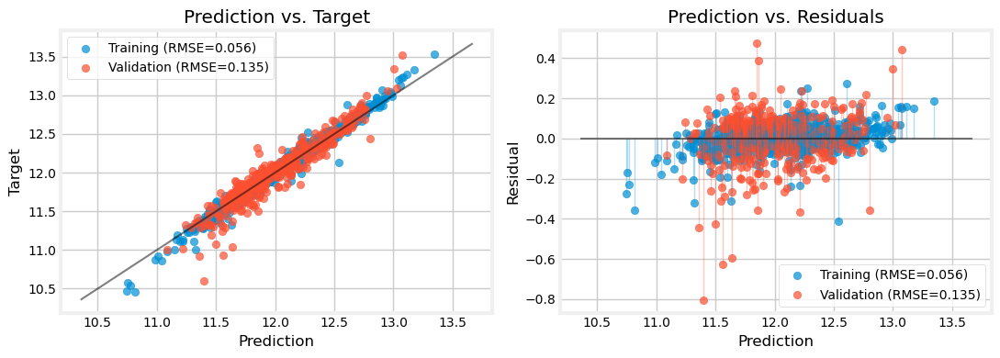

R2 Score Train         0.056091
R2 Score Validation    0.891477
RMSE Train             0.056091
RMSE Validation        0.134864
Name: rfr_base_no_cv, dtype: float64

In [79]:
print("*"*75)
print(model_name, "\n")
print("*"*75)

model_evaluation(model_name, (X_train, X_val, y_train, y_val),
                 perform_cv_randomized=(False, False),
                 verbose=True, plots=True)

In [80]:
scorecard

,rfr_base_no_cv
R2 Score Train,0.056091
R2 Score Validation,0.891477
RMSE Train,0.056091
RMSE Validation,0.134864


### Model 1: `DecisionTreeRegressor`

Defining the pipelines and hyperparameter grids:

In [81]:
model = 'dtr'

for pp in ['raw', 'eng', 'clus']:

    model_name = model+'_'+pp # full model name

    preproc_pipe = final_preproc[pp] # preprocessing  pipeline

    pipe[model_name] = Pipeline(steps=[('preprocessor',
                                        preproc_pipe),
                                       ('model',
                                        DecisionTreeRegressor(random_state=0))])

    pipe[model_name+'_no_cv'] = Pipeline(steps=[('preprocessor',
                                                 preproc_pipe),
                                                ('model',
                                                 DecisionTreeRegressor(random_state=0))])

    # defining the hyperparameter grid
    # basic:
    param_grid[model_name] = {'preprocessor__target_encoder__smoothing':
                                  list(np.arange(10., 60., 10.)),
                              'preprocessor__selector__best_k':
                                  list(range(10, 40, 10)),
                              'preprocessor__selector__t_thr':
                                  uniform(loc=0.1, scale=0.8)
                             }
    # if clustering:
    if pp == 'clus':
        param_grid[model_name]['preprocessor__pca__fit_feat_subset'] =\
            [True]
        param_grid[model_name]['preprocessor__pca__keep_original_feats'] =\
            [False]
        param_grid[model_name]['preprocessor__cluster__n_clusters'] =\
            list(range(3,7))

    # proper to the model:
    param_grid[model_name]['model__max_leaf_nodes'] =\
        list(range(2,11))
    param_grid[model_name]['model__max_depth'] =\
        list(range(1,11))

Performing the evaluation and explanation of the model:

Time: 18:36:38
***************************************************************************
dtr_raw , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=dtr_raw with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,1.000000e+00
R2,1.000000e+00
MAE,4.866731e-18
MSE,8.645051e-33
RMSE,9.297877e-17
MedAE,0.000000e+00
MAPE,4.008333e-19




Regression Report: Validation
..................................................


,Value
Explained Variance,0.751384
R2,0.751352
MAE,0.139219
MSE,0.041673
RMSE,0.204140
MedAE,0.091731
MAPE,0.011718



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


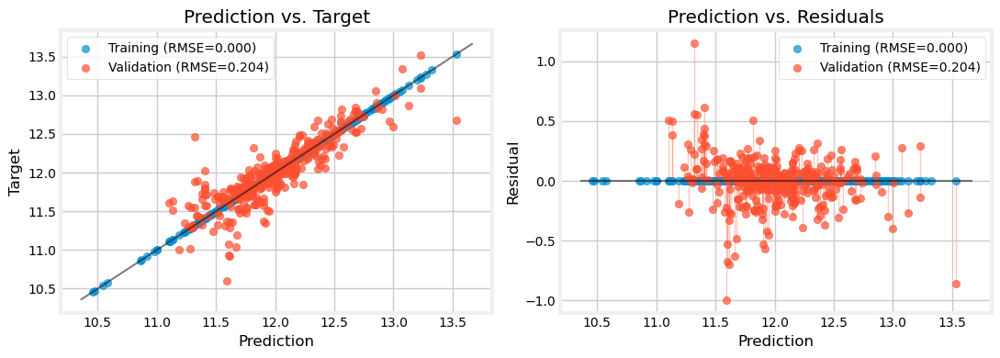



..................................................

Elapsed time: 0.02 minutes
..................................................



Time: 18:36:39
***************************************************************************
dtr_raw , 	CV: True 

***************************************************************************
We will evaluate dtr_raw with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.2189357970026705
		best params: {'model__max_depth': 9, 'model__max_leaf_nodes': 10, 'preprocessor__selector__best_k': 10, 'preprocessor__selector__t_thr': 0.5320592646289726, 'preprocessor__target_encoder__smoothing': 50.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.740858
R2,0.740858
MAE,0.147427
MSE,0.040520
RMSE,0.201295
MedAE,0.109091
MAPE,0.012285




Regression Report: Validation
..................................................


,Value
Explained Variance,0.748206
R2,0.745161
MAE,0.151827
MSE,0.042711
RMSE,0.206666
MedAE,0.117393
MAPE,0.012727



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


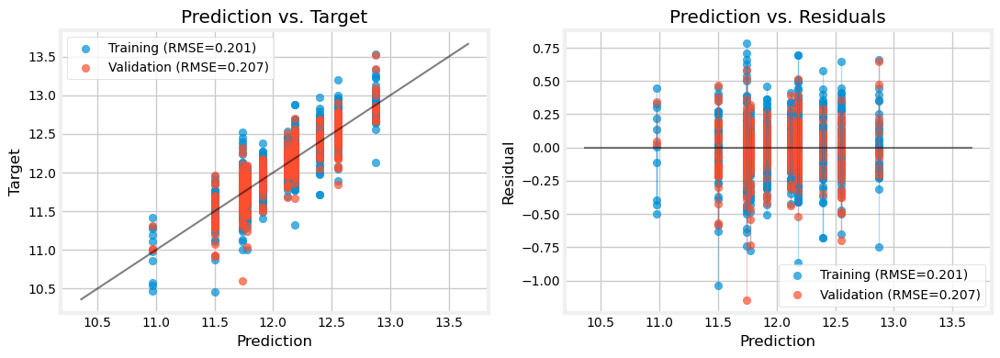



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['OverallQual', 'Neighborhood', 'GrLivArea', 'GarageCars', 'YearBuilt', 'BsmtQual', 'KitchenQual']
The most important features are:

	OverallQual: 0.5026493301026804 +- 0.04563430219739594
	Neighborhood: 0.1915671915824989 +- 0.026792696573364957
	GrLivArea: 0.12717318181808618 +- 0.01016771250746233
	GarageCars: 0.10538037830024385 +- 0.004548904491605934
	YearBuilt: 0.0 +- 0.0
	BsmtQual: 0.0 +- 0.0
	KitchenQual: 0.0 +- 0.0

****************************************************************************************************



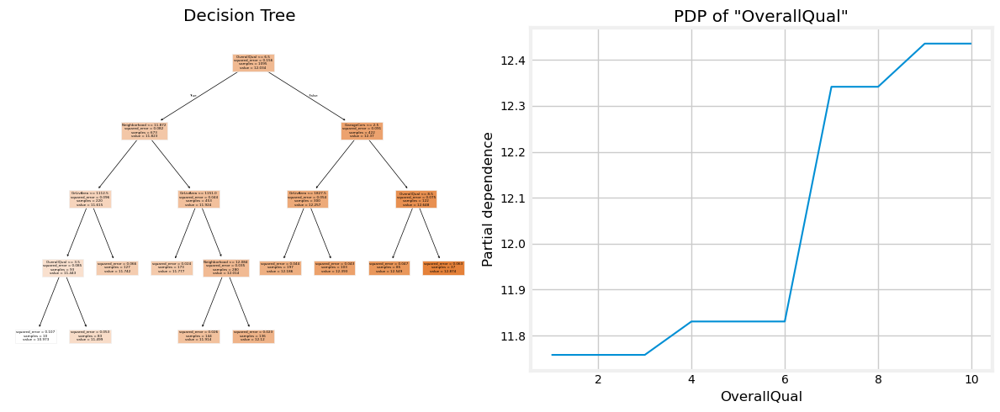

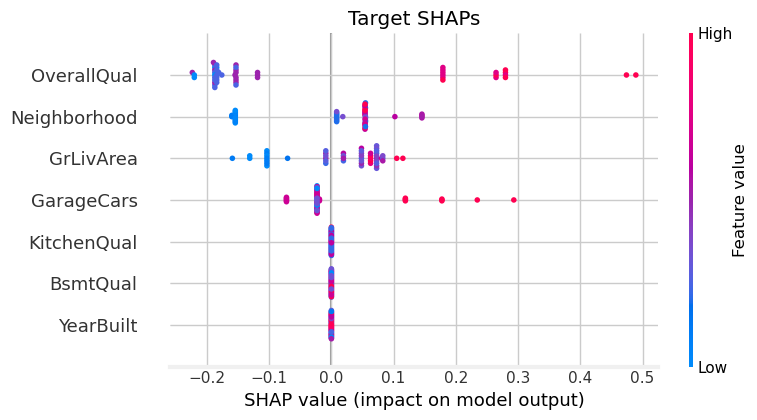

..................................................

Elapsed time: 14.79 minutes
..................................................



Time: 18:51:26
***************************************************************************
dtr_eng , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=dtr_eng with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.999963
R2,0.999963
MAE,0.000156
MSE,0.000006
RMSE,0.002394
MedAE,0.000000
MAPE,0.000013




Regression Report: Validation
..................................................


,Value
Explained Variance,0.756899
R2,0.756836
MAE,0.141037
MSE,0.040754
RMSE,0.201877
MedAE,0.095882
MAPE,0.011865



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


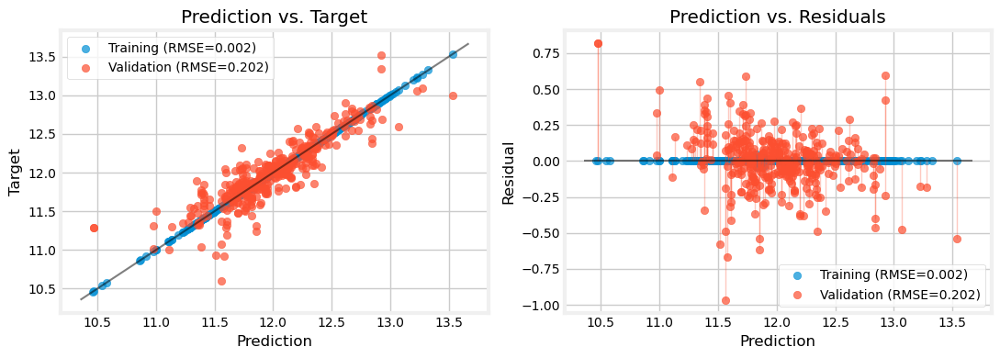



..................................................

Elapsed time: 0.03 minutes
..................................................



Time: 18:51:28
***************************************************************************
dtr_eng , 	CV: True 

***************************************************************************
We will evaluate dtr_eng with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.20285589726710113
		best params: {'model__max_depth': 9, 'model__max_leaf_nodes': 10, 'preprocessor__selector__best_k': 10, 'preprocessor__selector__t_thr': 0.3796462206138461, 'preprocessor__target_encoder__smoothing': 40.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.776923
R2,0.776923
MAE,0.136713
MSE,0.034881
RMSE,0.186764
MedAE,0.101829
MAPE,0.011414




Regression Report: Validation
..................................................


,Value
Explained Variance,0.794609
R2,0.793272
MAE,0.141015
MSE,0.034648
RMSE,0.186139
MedAE,0.107460
MAPE,0.011825



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


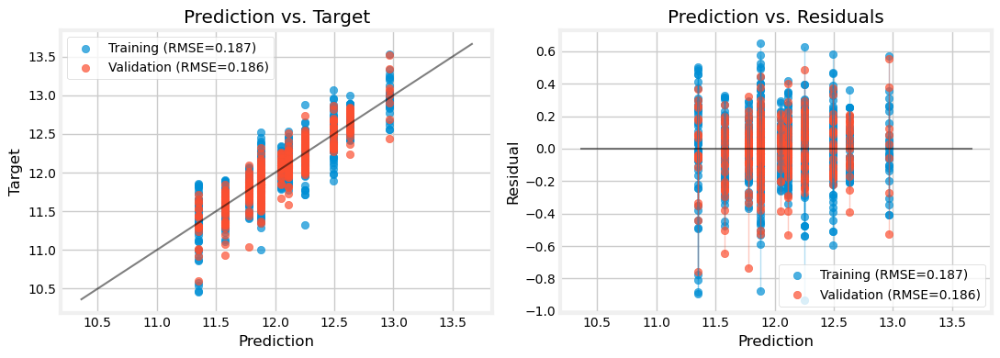



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['TotalSF', 'OverallQual', 'Neighborhood', 'OverallQualCond', 'GarageCars', 'GarageArea', 'Has_Garage']
The most important features are:

	TotalSF: 0.4564003383694068 +- 0.03706857659046194
	OverallQual: 0.41868000615439155 +- 0.03877895941482734
	Neighborhood: 0.14593131984631763 +- 0.012970293261787042
	OverallQualCond: 0.0348834868263501 +- 0.007437108563938323
	GarageCars: 0.0 +- 0.0
	GarageArea: 0.0 +- 0.0
	Has_Garage: 0.0 +- 0.0

****************************************************************************************************



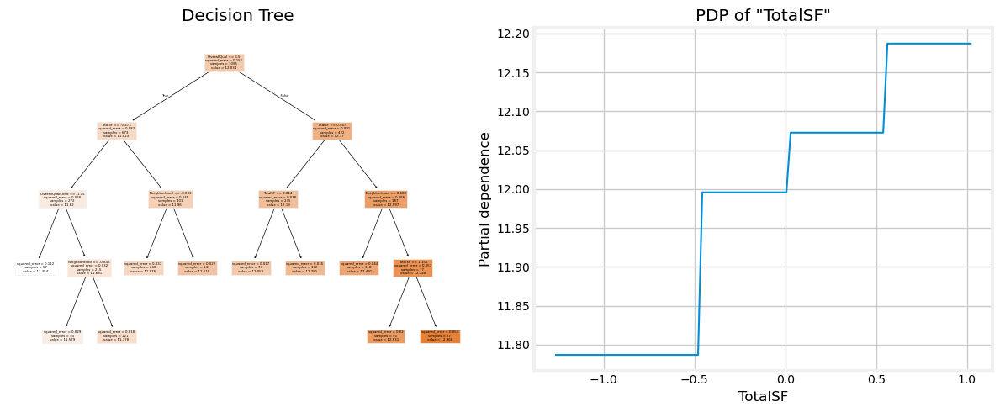

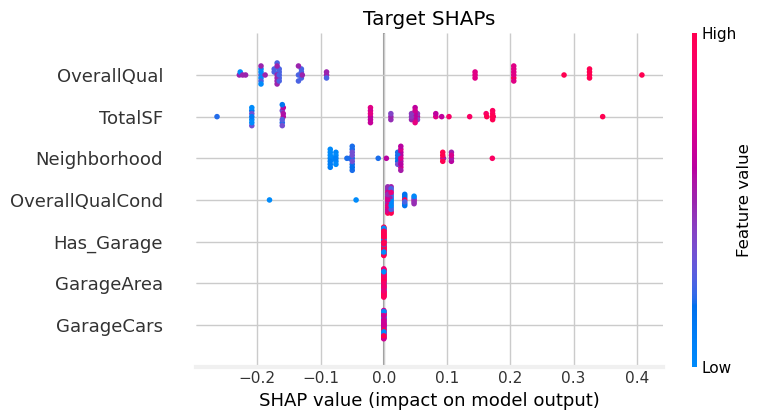

..................................................

Elapsed time: 16.89 minutes
..................................................



Time: 19:08:22
***************************************************************************
dtr_clus , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=dtr_clus with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.999963
R2,0.999963
MAE,0.000156
MSE,0.000006
RMSE,0.002394
MedAE,0.000000
MAPE,0.000013




Regression Report: Validation
..................................................


,Value
Explained Variance,0.783475
R2,0.783426
MAE,0.136457
MSE,0.036298
RMSE,0.190520
MedAE,0.095310
MAPE,0.011447



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


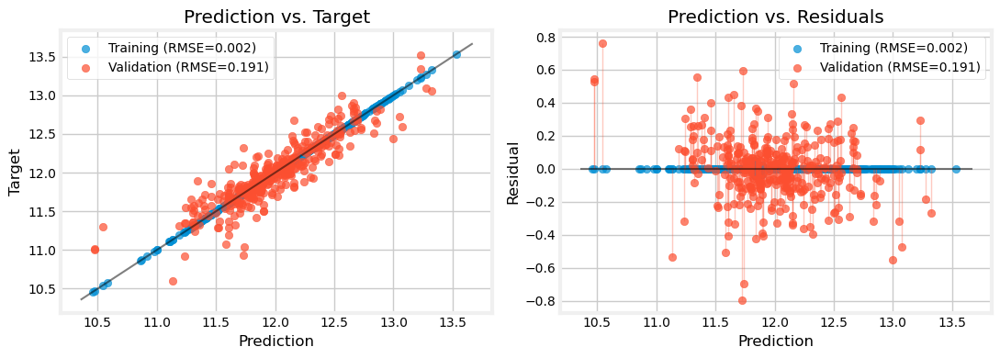



..................................................

Elapsed time: 0.03 minutes
..................................................



Time: 19:08:23
***************************************************************************
dtr_clus , 	CV: True 

***************************************************************************
We will evaluate dtr_clus with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.1879099131062857
		best params: {'model__max_depth': 3, 'model__max_leaf_nodes': 8, 'preprocessor__cluster__n_clusters': 5, 'preprocessor__pca__fit_feat_subset': True, 'preprocessor__pca__keep_original_feats': False, 'preprocessor__selector__best_k': 20, 'preprocessor__selector__t_thr': 0.11065289059717386, 'preprocessor__target_encoder__smoothing': 30.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......

,Value
Explained Variance,0.804901
R2,0.804901
MAE,0.125775
MSE,0.030506
RMSE,0.174660
MedAE,0.093625
MAPE,0.010500




Regression Report: Validation
..................................................


,Value
Explained Variance,0.775377
R2,0.774561
MAE,0.139951
MSE,0.037784
RMSE,0.194380
MedAE,0.099087
MAPE,0.011752



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


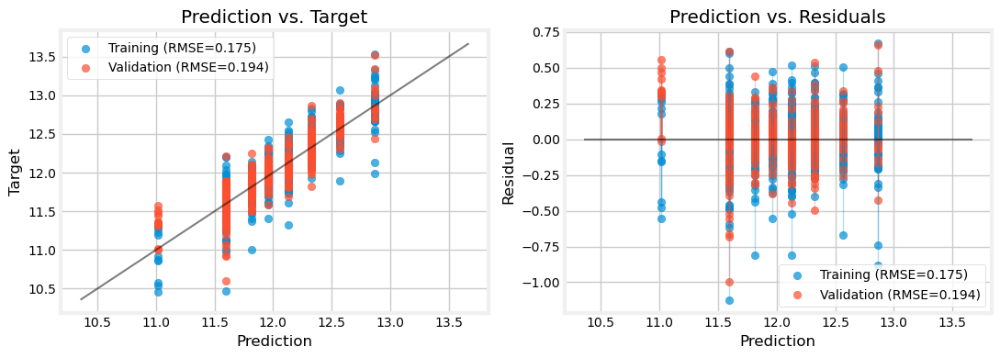



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['pca0', 'cluster_0', 'cluster_1', 'cluster_2', 'cluster_3', 'cluster_4', 'OverallQual', 'GarageCars', 'BathsAbvGr', 'AllBaths', 'KitchenQual', 'ExterQual', 'BsmtQual', 'Has_Garage', 'Has_Bsmt', 'pca1', 'pca2', 'pca3', 'pca4', 'pca5', 'pca6', 'pca7', 'pca8', 'pca9', 'pca10']
The most important features are:

	pca0: 1.6609770297695292 +- 0.054955777074533876
	cluster_0: 0.0 +- 0.0
	cluster_1: 0.0 +- 0.0
	cluster_2: 0.0 +- 0.0
	cluster_3: 0.0 +- 0.0
	cluster_4: 0.0 +- 0.0
	OverallQual: 0.0 +- 0.0
	GarageCars: 0.0 +- 0.0
	BathsAbvGr: 0.0 +- 0.0
	AllBaths: 0.0 +- 0.0
	KitchenQual: 0.0 +- 0.0
	ExterQual: 0.0 +- 0.0
	BsmtQual: 0.0 +- 0.0
	Has_Garage: 0.0 +- 0.0
	Has_Bsmt: 0.0 +- 0.0
	pca1: 0.0 +- 0.0
	pca2: 0.0 +- 0.0
	pca3: 0.0 +- 0.0
	pca4: 0.0 +- 0.0
	pca5: 0.0 +- 0.0
	pca6: 0

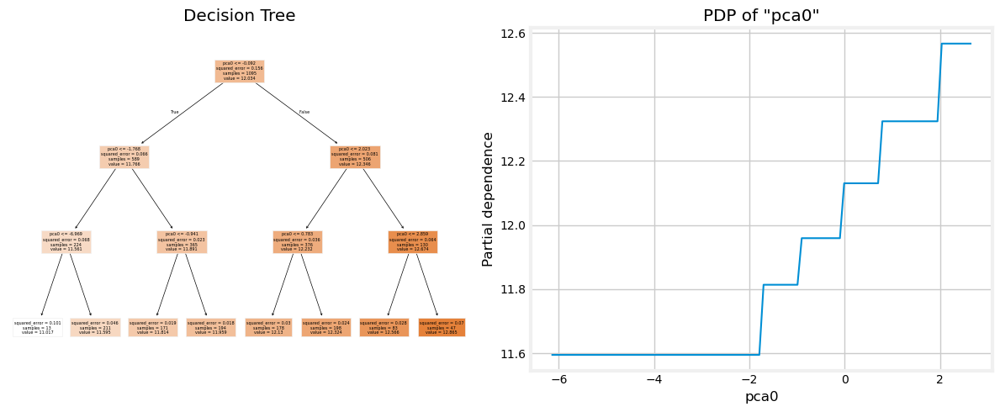

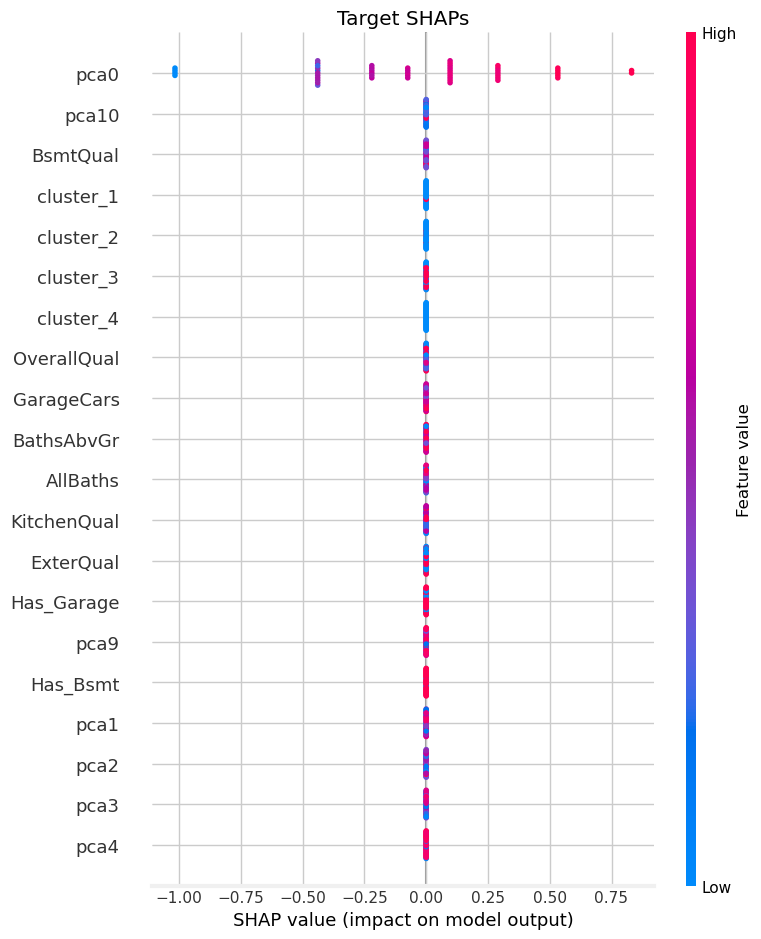

..................................................

Elapsed time: 17.98 minutes
..................................................





In [82]:
model = 'dtr'
redoQ = False

for pp in ['raw', 'eng', 'clus']:
    for cvQ in [False, True]:

        print(time.strftime("Time: %H:%M:%S"))
        start = time.time()

        model_name = model+'_'+pp # full model name

        if redoQ and (model_name in search.keys()):
            del search[model_name]

        print("*"*75)
        print(model_name, ", \tCV:", cvQ, "\n")
        print("*"*75)

        # # GridSearchCV
        # model_evaluation(model_name, (X_train, X_val, y_train, y_val),
        #                  perform_cv_randomized=(cvQ, False),
        #                  n_splits=5, n_repeats=3,
        #                  verbose=True, plots=True)

        # RandomizedSearchCV
        model_evaluation(model_name, (X_train, X_val, y_train, y_val),
                         perform_cv_randomized=(cvQ, True),
                         n_splits=5, n_repeats=3,
                         n_iter=1000,
                         verbose=True, plots=True)

        print("\n")

        if cvQ:
            explain_model(model_name, best_cv[model_name]['pipe'], (X_train, X_val, y_train, y_val), tree_idx=0, random_state=0)

        end = time.time()

        print("."*50)
        print(f"\nElapsed time: {(end-start)/60:.2f} minutes")
        print("."*50)

        print("\n\n")

In [83]:
scorecard

,rfr_base_no_cv,dtr_raw_no_cv,dtr_raw_cv,dtr_eng_no_cv,dtr_eng_cv,dtr_clus_no_cv,dtr_clus_cv
R2 Score Train,0.056091,9.297877e-17,0.201295,0.002394,0.186764,0.002394,0.174660
R2 Score Validation,0.891477,7.513521e-01,0.745161,0.756836,0.793272,0.783426,0.774561
RMSE Train,0.056091,9.297877e-17,0.201295,0.002394,0.186764,0.002394,0.174660
RMSE Validation,0.134864,2.041404e-01,0.206666,0.201877,0.186139,0.190520,0.194380


#### Engineered Cluster Model: exploration

In the cluster model, checking selected engineering features (from which PCA and clusters are built)

In [84]:
best_cv[model+'_clus']

{'pipe': Pipeline(steps=[('preprocessor',
                  Pipeline(steps=[('cleaning',
                                   Pipeline(steps=[('custom_imputer',
                                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                                             'BsmtQual'],
                                                                                'BsmtExposure': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtFinType2': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtQual': ['BsmtCond',
                                                                                   

In [85]:
best_cv[model+'_clus']['params']

{'model__max_depth': 3,
 'model__max_leaf_nodes': 8,
 'preprocessor__cluster__n_clusters': 5,
 'preprocessor__pca__fit_feat_subset': True,
 'preprocessor__pca__keep_original_feats': False,
 'preprocessor__selector__best_k': 20,
 'preprocessor__selector__t_thr': 0.11065289059717386,
 'preprocessor__target_encoder__smoothing': 30.0}

In [86]:
best_cv[model+'_clus']['pipe'].steps

[('preprocessor',
  Pipeline(steps=[('cleaning',
                   Pipeline(steps=[('custom_imputer',
                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                             'BsmtQual'],
                                                                'BsmtExposure': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtFinType2': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtQual': ['BsmtCond',
                                                                             'BsmtExposure'],
                                                                'Exterior1st': 'Foundation',
                                                                

In [87]:
best_preproc = best_cv[model+'_clus']['pipe'].steps[0][1] # the best preprocessor
best_feats = best_preproc[:-3] # all the preprocessor steps, except for PCA, KMeans clustering, and OHE
best_feats.transform(X_train)

,TotalSF,OverallQual,1and2FlrSF,Neighborhood,AllRooms,OverallQualCond,GarageCars,GarageArea,TotalBsmtSF,YearBuilt,BathsAbvGr,AllBaths,1stFlrSF,HouseAge,KitchenQual,ExterQual,BsmtQual,GarageAge,Has_Garage,Has_Bsmt
6,0.742068,8,0.312092,0.511543,0.500000,0.5,2,0.502730,1.052674,0.659574,2.0,3.0,0.919677,-1.125091,4,4,5,-1.066979,1,1
807,0.367177,5,0.156204,-1.068155,0.333333,-0.5,2,0.170238,0.569246,-1.063830,1.5,3.5,-0.048785,0.472309,4,3,3,0.537697,1,1
955,0.398207,6,0.624807,0.294400,0.500000,0.1,2,0.044102,-0.034421,-0.574468,2.0,2.0,-0.240817,0.296586,3,3,4,0.361174,1,1
1040,0.398207,5,0.446734,-0.753181,0.833333,-1.5,2,0.014822,0.259462,-0.340426,2.0,3.0,1.051686,0.185008,3,3,3,0.249087,1,1
701,-0.170534,7,-0.497959,0.127694,-0.333333,0.0,2,0.170238,0.311677,-0.085106,1.5,1.5,0.125459,0.042657,3,3,3,0.106088,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,-0.081754,6,-0.177958,0.127694,0.166667,-0.5,2,-0.007457,0.132054,0.021277,2.0,2.0,0.439205,0.014612,3,3,4,0.077916,1,1
905,-0.400741,5,-0.693872,-0.771817,-0.166667,-1.0,1,-0.961984,0.116963,-0.404255,1.0,2.0,-0.066626,0.252972,3,3,3,0.317361,1,1
1096,-0.494922,6,-0.169978,-1.292879,0.000000,0.7,0,-11.052923,-0.751207,-1.255319,1.5,1.5,-0.740655,0.512449,4,3,3,2.173310,0,1
235,-1.295571,6,-0.853972,-0.961599,-0.666667,-1.7,1,-1.066905,-1.446378,-0.042553,1.5,1.5,-1.735090,0.042657,3,3,3,0.106088,1,1


In [88]:
best_preproc

Pipeline(steps=[('cleaning',
                 Pipeline(steps=[('custom_imputer',
                                  CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                           'BsmtQual'],
                                                              'BsmtExposure': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtFinType2': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtQual': ['BsmtCond',
                                                                           'BsmtExposure'],
                                                              'Exterior1st': 'Foundation',
                                                              'Exterior2nd': 'Foundation',
                                                              'GarageArea': ['GarageCars',
                                                                             'GarageQual'],
                                                              'GarageCa...
                 PCAFeature(fit_feat_subset=True, keep_original_feats=False)),
                ('cluster',
                 KMeansFeature(n_clusters=5, scaling_method='robust')),
                ('ohe',
                 Pipeline(steps=[('ohe',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('ohe',
                                                                   OneHotEncoder(dtype=<class 'int'>,
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False),
                                                                   <function ohe_from_subset.<locals>.selector at 0x7b1eeceb1f80>)],
                                                    verbose_feature_names_out=False))]))])

In [89]:
del best_preproc, best_feats

### Model 2: `RandomForestRegressor`

In [90]:
model = 'rfr'

for pp in ['raw', 'eng', 'clus']:

    model_name = model+'_'+pp # full model name

    preproc_pipe = final_preproc[pp] # preprocessing  pipeline

    pipe[model_name] = Pipeline(steps=[('preprocessor', preproc_pipe),
                                       ('model', RandomForestRegressor(random_state=0))])

    pipe[model_name+'_no_cv'] = Pipeline(steps=[('preprocessor', preproc_pipe),
                                                ('model', RandomForestRegressor(random_state=0))])

    # defining the hyperparameter grid
    # basic:
    param_grid[model_name] = {'preprocessor__target_encoder__smoothing':
                                  list(np.arange(10., 60., 10.)),
                              'preprocessor__selector__best_k':
                                  list(range(10, 40, 10)),
                              'preprocessor__selector__t_thr':
                                  uniform(loc=0.1, scale=0.8)
                             }
    # if clustering:
    if pp == 'clus':
        param_grid[model_name]['preprocessor__pca__fit_feat_subset'] =\
                        [True]
        param_grid[model_name]['preprocessor__pca__keep_original_feats'] =\
            [False]
        param_grid[model_name]['preprocessor__cluster__n_clusters'] =\
            list(range(3,7))

    # proper to the model:
    param_grid[model_name]['model__n_estimators'] =\
        [100*i for i in range(1,11)]
    param_grid[model_name]['model__max_depth'] =\
        list(range(1,11))

Time: 19:26:23
***************************************************************************
rfr_raw , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=rfr_raw with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.979879
R2,0.979878
MAE,0.037077
MSE,0.003146
RMSE,0.056091
MedAE,0.025217
MAPE,0.003094




Regression Report: Validation
..................................................


,Value
Explained Variance,0.891662
R2,0.891477
MAE,0.094334
MSE,0.018188
RMSE,0.134864
MedAE,0.068203
MAPE,0.007934



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


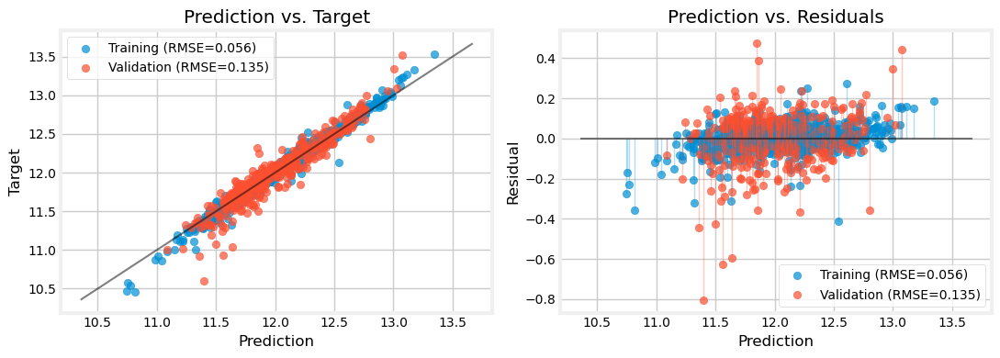



..................................................

Elapsed time: 0.06 minutes
..................................................



Time: 19:26:26
***************************************************************************
rfr_raw , 	CV: True 

***************************************************************************
We will evaluate rfr_raw with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.14856509071370053
		best params: {'model__max_depth': 10, 'model__n_estimators': 500, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.42762146521461286, 'preprocessor__target_encoder__smoothing': 30.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.977371
R2,0.977370
MAE,0.042936
MSE,0.003539
RMSE,0.059486
MedAE,0.032268
MAPE,0.003585




Regression Report: Validation
..................................................


,Value
Explained Variance,0.890582
R2,0.890179
MAE,0.091817
MSE,0.018406
RMSE,0.135668
MedAE,0.064947
MAPE,0.007722



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


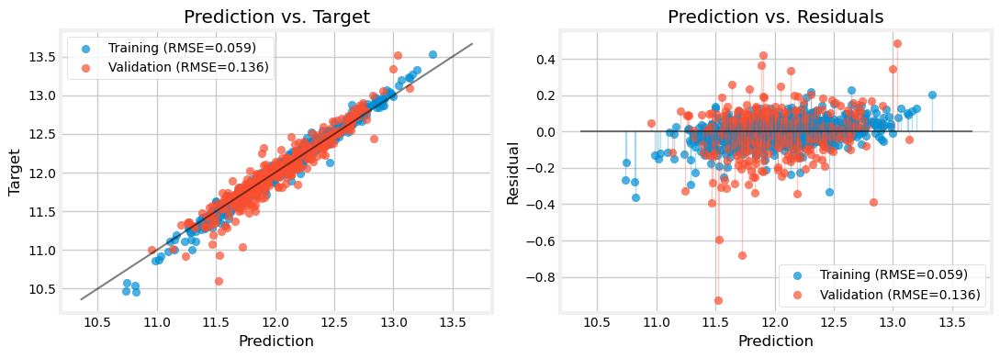



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['OverallQual', 'GrLivArea', 'Neighborhood', 'TotalBsmtSF', 'BsmtFinSF1', 'GarageCars', 'OverallCond', 'YearRemodAdd', 'LotArea', 'GarageArea', 'YearBuilt', 'BsmtFinType1', 'GarageYrBlt', 'MSSubClass', 'TotRmsAbvGrd', 'FireplaceQu', 'KitchenQual', 'HeatingQC', 'BsmtUnfSF', 'BsmtQual', 'FullBath', 'Fireplaces', 'GarageFinish', 'ExterQual', 'Foundation_2', 'Foundation_0', 'GarageType_4', 'OpenPorchSF', 'GarageType_1', 'Foundation_3', 'Foundation_5', 'GarageType_0', 'Foundation_4', 'GarageType_6', 'GarageType_3', 'GarageType_2', 'Foundation_1', 'GarageType_5', 'LotFrontage']
The most important features are:

	OverallQual: 0.3054550257659585 +- 0.025455295593739446
	GrLivArea: 0.14129410165037173 +- 0.006979161871441003
	Neighborhood: 0.0671788219378231 +- 0.007426882503236722


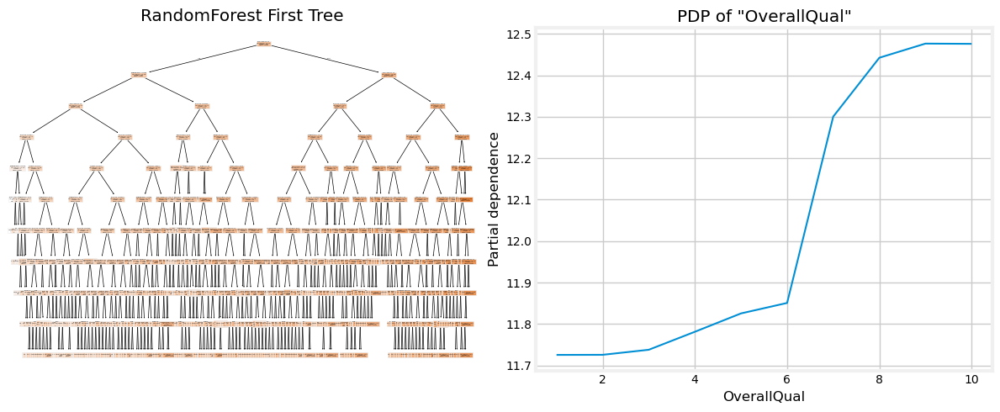

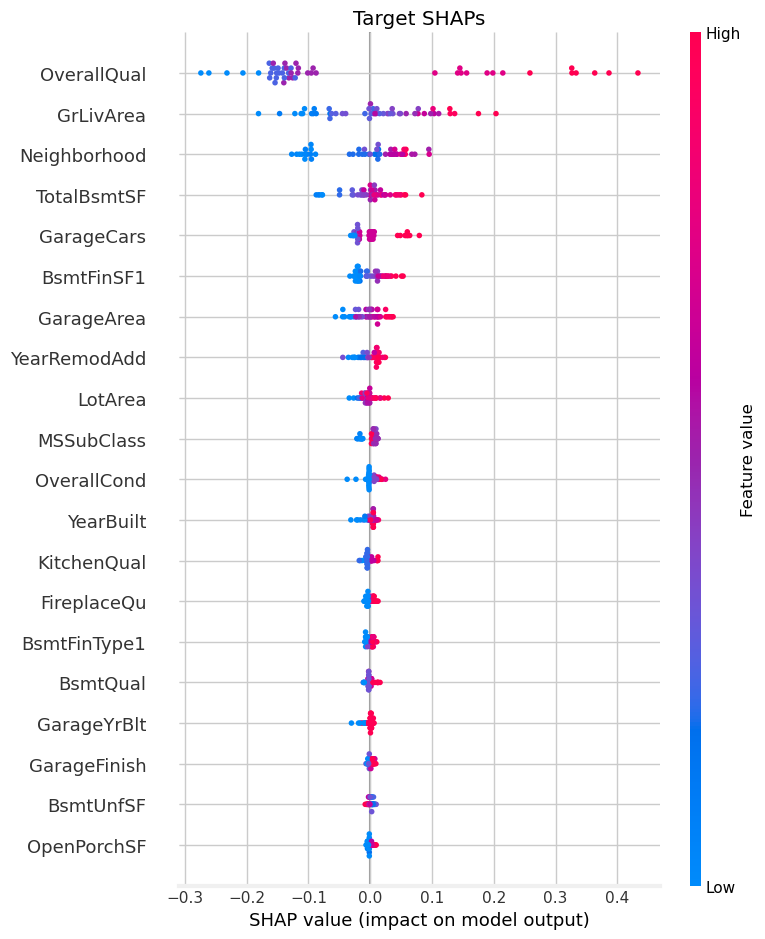

..................................................

Elapsed time: 42.36 minutes
..................................................



Time: 20:08:48
***************************************************************************
rfr_eng , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=rfr_eng with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.980651
R2,0.980624
MAE,0.037410
MSE,0.003030
RMSE,0.055042
MedAE,0.025427
MAPE,0.003119




Regression Report: Validation
..................................................


,Value
Explained Variance,0.888997
R2,0.888852
MAE,0.097026
MSE,0.018628
RMSE,0.136486
MedAE,0.072827
MAPE,0.008158



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


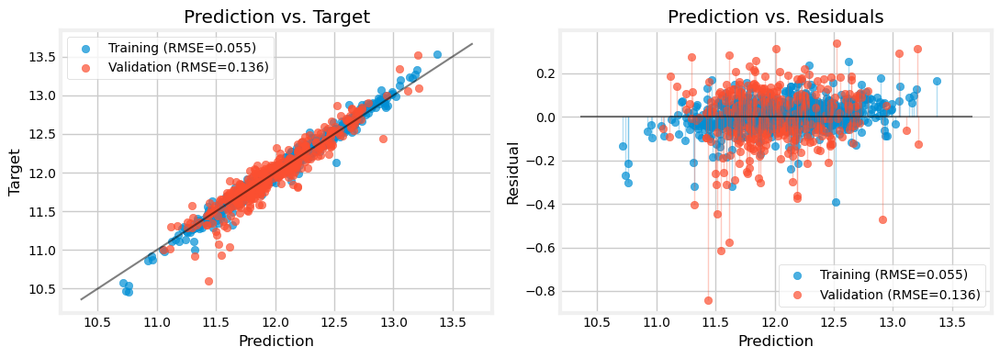



..................................................

Elapsed time: 0.04 minutes
..................................................



Time: 20:08:50
***************************************************************************
rfr_eng , 	CV: True 

***************************************************************************
We will evaluate rfr_eng with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.14260006168484132
		best params: {'model__max_depth': 10, 'model__n_estimators': 400, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.14826827496905504, 'preprocessor__target_encoder__smoothing': 40.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.977182
R2,0.977177
MAE,0.043498
MSE,0.003569
RMSE,0.059738
MedAE,0.033074
MAPE,0.003632




Regression Report: Validation
..................................................


,Value
Explained Variance,0.890823
R2,0.890617
MAE,0.095005
MSE,0.018332
RMSE,0.135398
MedAE,0.069375
MAPE,0.007979



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


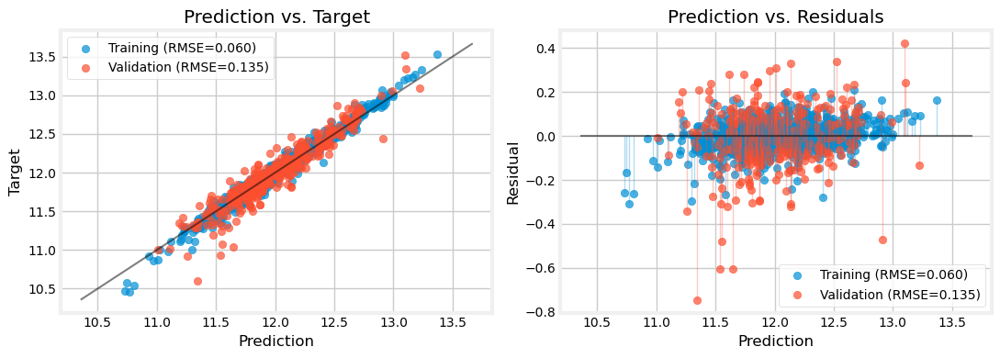



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['TotalSF', 'OverallQual', 'Neighborhood', 'OverallQualCond', 'AllBaths', 'YearRemodAdd', 'AllRooms', 'GarageAge', 'YearBuilt', 'GarageArea', 'MSSubClass', '1stFlrSF', 'FireplaceQu', 'GarageCars', 'BathsAbvGr', 'BsmtQual', 'KitchenQual', 'ExterQual', 'FullBath', 'TotalBsmtSF', 'GarageType_1', 'GarageFinish', 'GarageType_3', 'Has_Bsmt', 'GarageType_0', 'GarageType_4', 'GarageType_6', 'Has_Garage', 'GarageType_2', 'GarageType_5', 'LotFrontage']
The most important features are:

	TotalSF: 0.34576335395309377 +- 0.017215480175737097
	OverallQual: 0.15550242662681324 +- 0.012096993571773589
	Neighborhood: 0.07720255352412353 +- 0.005860190613296558
	OverallQualCond: 0.03422211055873432 +- 0.002939045127968433
	AllBaths: 0.013861465856875444 +- 0.0015121192667122143
	YearRemodAdd

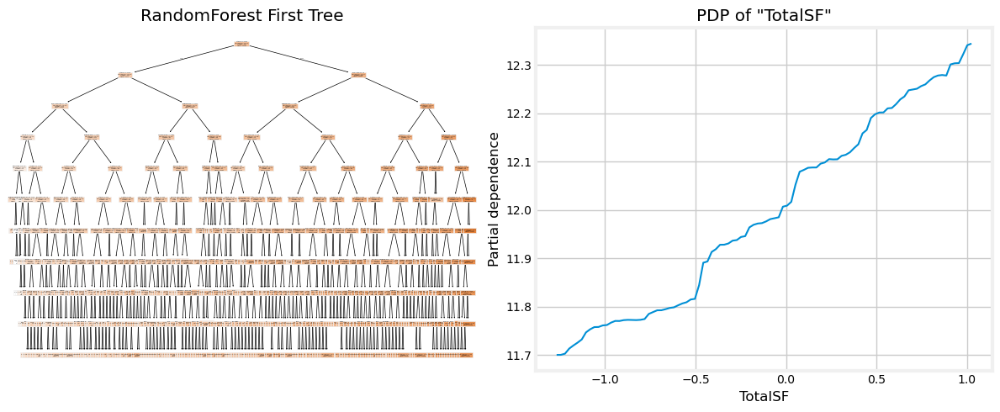

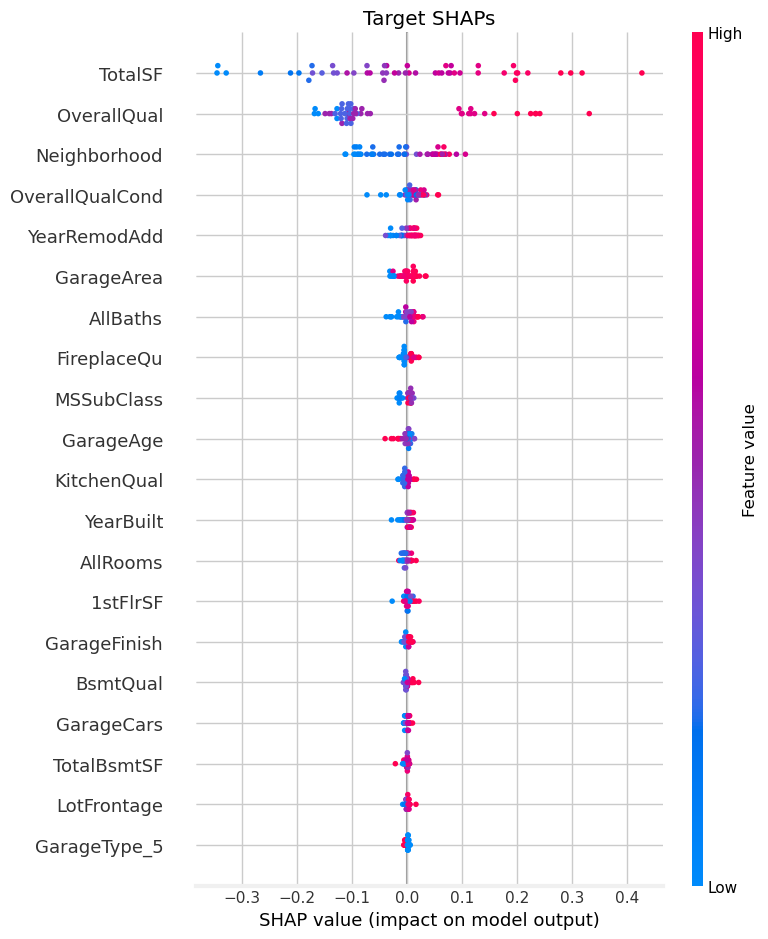

..................................................

Elapsed time: 39.78 minutes
..................................................



Time: 20:48:37
***************************************************************************
rfr_clus , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=rfr_clus with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.979415
R2,0.979396
MAE,0.037994
MSE,0.003222
RMSE,0.056760
MedAE,0.025715
MAPE,0.003168




Regression Report: Validation
..................................................


,Value
Explained Variance,0.881283
R2,0.881278
MAE,0.098968
MSE,0.019898
RMSE,0.141059
MedAE,0.068153
MAPE,0.008323



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


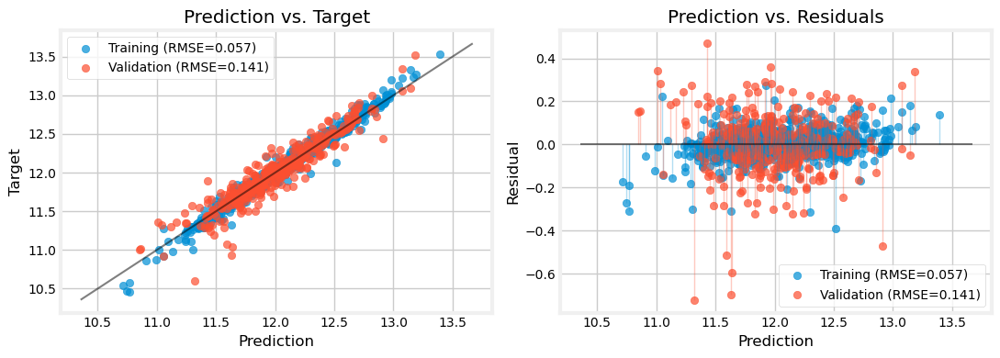



..................................................

Elapsed time: 0.04 minutes
..................................................



Time: 20:48:39
***************************************************************************
rfr_clus , 	CV: True 

***************************************************************************
We will evaluate rfr_clus with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.14779449397974823
		best params: {'model__max_depth': 10, 'model__n_estimators': 400, 'preprocessor__cluster__n_clusters': 5, 'preprocessor__pca__fit_feat_subset': True, 'preprocessor__pca__keep_original_feats': False, 'preprocessor__selector__best_k': 20, 'preprocessor__selector__t_thr': 0.11098083626110383, 'preprocessor__target_encoder__smoothing': 50.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
....

,Value
Explained Variance,0.971776
R2,0.971775
MAE,0.049739
MSE,0.004413
RMSE,0.066433
MedAE,0.037756
MAPE,0.004162




Regression Report: Validation
..................................................


,Value
Explained Variance,0.880652
R2,0.880512
MAE,0.098770
MSE,0.020026
RMSE,0.141514
MedAE,0.068049
MAPE,0.008315



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


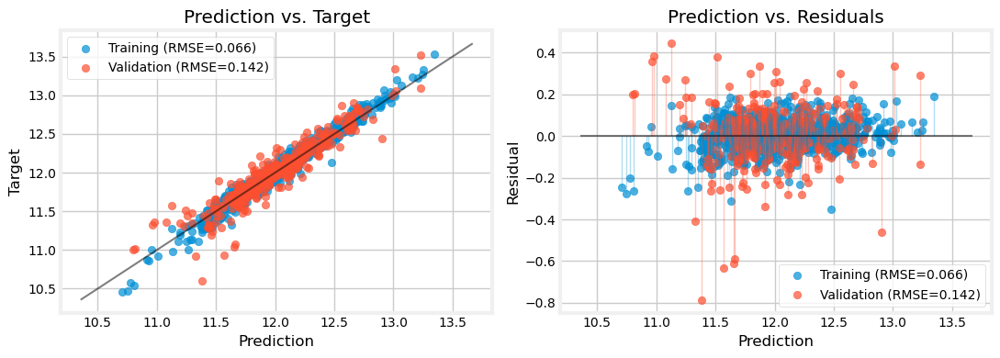



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['pca0', 'pca2', 'AllBaths', 'BathsAbvGr', 'pca8', 'pca1', 'pca10', 'pca4', 'pca7', 'pca9', 'pca6', 'pca5', 'pca3', 'ExterQual', 'BsmtQual', 'cluster_0', 'cluster_4', 'Has_Bsmt', 'cluster_2', 'Has_Garage', 'cluster_3', 'GarageCars', 'KitchenQual', 'cluster_1', 'OverallQual']
The most important features are:

	pca0: 1.6121102491807235 +- 0.04921226458245771
	pca2: 0.02076258947929186 +- 0.0011672049808368677
	AllBaths: 0.015882160215840945 +- 0.000620858312515946
	BathsAbvGr: 0.015173572421798598 +- 0.004275881265468795
	pca8: 0.013278299309548935 +- 0.00231909615017806
	pca1: 0.00800266851486604 +- 0.0025642289017816415
	pca10: 0.0049840602540419665 +- 0.0008044149978249056
	pca4: 0.004241854038686465 +- 0.0017714957462299
	pca7: 0.004000425907327232 +- 0.000578740830139353

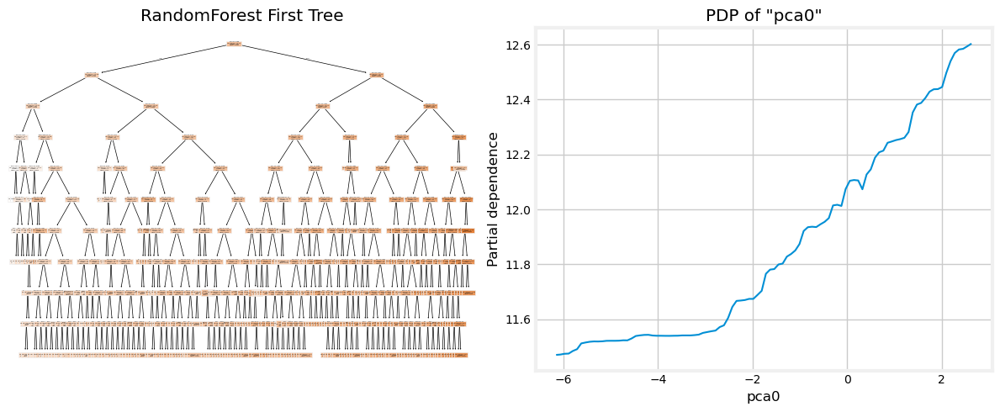

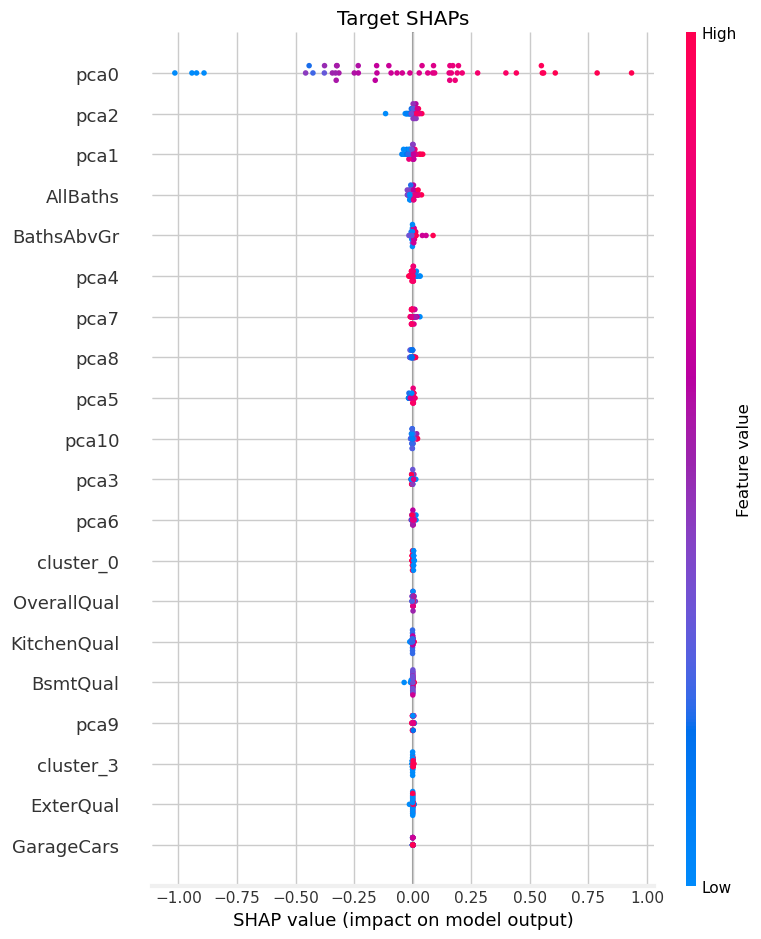

..................................................

Elapsed time: 45.41 minutes
..................................................





In [91]:
model = 'rfr'
redoQ = False

for pp in ['raw', 'eng', 'clus']:
    for cvQ in [False, True]:

        print(time.strftime("Time: %H:%M:%S"))
        start = time.time()

        model_name = model+'_'+pp # full model name

        if redoQ and (model_name in search.keys()):
            del search[model_name]

        print("*"*75)
        print(model_name, ", \tCV:", cvQ, "\n")
        print("*"*75)
        
        # # GridSearchCV
        # model_evaluation(model_name, (X_train, X_val, y_train, y_val),
        #                  perform_cv_randomized=(cvQ, False),
        #                  n_splits=5, n_repeats=3,
        #                  verbose=True, plots=True)

        # RandomizedSearchCV
        model_evaluation(model_name, (X_train, X_val, y_train, y_val),
                         perform_cv_randomized=(cvQ, True),
                         n_splits=5, n_repeats=3,
                         n_iter=1000,
                         verbose=True, plots=True)

        print("\n")

        if cvQ:
            explain_model(model_name, best_cv[model_name]['pipe'], (X_train, X_val, y_train, y_val), tree_idx=0, random_state=0)

        end = time.time()

        print("."*50)
        print(f"\nElapsed time: {(end-start)/60:.2f} minutes")
        print("."*50)

        print("\n\n")

In [92]:
scorecard

,rfr_base_no_cv,dtr_raw_no_cv,dtr_raw_cv,dtr_eng_no_cv,dtr_eng_cv,dtr_clus_no_cv,dtr_clus_cv,rfr_raw_no_cv,rfr_raw_cv,rfr_eng_no_cv,rfr_eng_cv,rfr_clus_no_cv,rfr_clus_cv
R2 Score Train,0.056091,9.297877e-17,0.201295,0.002394,0.186764,0.002394,0.174660,0.056091,0.059486,0.055042,0.059738,0.056760,0.066433
R2 Score Validation,0.891477,7.513521e-01,0.745161,0.756836,0.793272,0.783426,0.774561,0.891477,0.890179,0.888852,0.890617,0.881278,0.880512
RMSE Train,0.056091,9.297877e-17,0.201295,0.002394,0.186764,0.002394,0.174660,0.056091,0.059486,0.055042,0.059738,0.056760,0.066433
RMSE Validation,0.134864,2.041404e-01,0.206666,0.201877,0.186139,0.190520,0.194380,0.134864,0.135668,0.136486,0.135398,0.141059,0.141514


#### Engineered Cluster Model: exploration

In the cluster model, checking selected engineering features (from which PCA and clusters are built)

In [93]:
best_cv[model+'_clus']

{'pipe': Pipeline(steps=[('preprocessor',
                  Pipeline(steps=[('cleaning',
                                   Pipeline(steps=[('custom_imputer',
                                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                                             'BsmtQual'],
                                                                                'BsmtExposure': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtFinType2': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtQual': ['BsmtCond',
                                                                                   

In [94]:
best_cv[model+'_clus']['params']

{'model__max_depth': 10,
 'model__n_estimators': 400,
 'preprocessor__cluster__n_clusters': 5,
 'preprocessor__pca__fit_feat_subset': True,
 'preprocessor__pca__keep_original_feats': False,
 'preprocessor__selector__best_k': 20,
 'preprocessor__selector__t_thr': 0.11098083626110383,
 'preprocessor__target_encoder__smoothing': 50.0}

In [95]:
best_cv[model+'_clus']['pipe'].steps

[('preprocessor',
  Pipeline(steps=[('cleaning',
                   Pipeline(steps=[('custom_imputer',
                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                             'BsmtQual'],
                                                                'BsmtExposure': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtFinType2': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtQual': ['BsmtCond',
                                                                             'BsmtExposure'],
                                                                'Exterior1st': 'Foundation',
                                                                

In [96]:
best_preproc = best_cv[model+'_clus']['pipe'].steps[0][1] # the best preprocessor
best_feats = best_preproc[:-3] # all the preprocessor steps, except for PCA, KMeans clustering, and OHE
best_feats.transform(X_train)

,TotalSF,OverallQual,1and2FlrSF,Neighborhood,AllRooms,OverallQualCond,GarageCars,GarageArea,TotalBsmtSF,YearBuilt,BathsAbvGr,1stFlrSF,HouseAge,AllBaths,ExterQual,KitchenQual,BsmtQual,GarageAge,Has_Garage,Has_Bsmt
6,0.742068,8,0.312092,0.472509,0.500000,0.5,2,0.502730,1.052674,0.659574,2.0,0.919677,-1.125091,3.0,4,4,5,-1.066979,1,1
807,0.367177,5,0.156204,-1.069603,0.333333,-0.5,2,0.170238,0.569246,-1.063830,1.5,-0.048785,0.472309,3.5,3,4,3,0.537697,1,1
955,0.398207,6,0.624807,0.288295,0.500000,0.1,2,0.044102,-0.034421,-0.574468,2.0,-0.240817,0.296586,2.0,3,3,4,0.361174,1,1
1040,0.398207,5,0.446734,-0.738474,0.833333,-1.5,2,0.014822,0.259462,-0.340426,2.0,1.051686,0.185008,3.0,3,3,3,0.249087,1,1
701,-0.170534,7,-0.497959,0.108607,-0.333333,0.0,2,0.170238,0.311677,-0.085106,1.5,0.125459,0.042657,1.5,3,3,3,0.106088,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,-0.081754,6,-0.177958,0.108607,0.166667,-0.5,2,-0.007457,0.132054,0.021277,2.0,0.439205,0.014612,2.0,3,3,4,0.077916,1,1
905,-0.400741,5,-0.693872,-0.774909,-0.166667,-1.0,1,-0.961984,0.116963,-0.404255,1.0,-0.066626,0.252972,2.0,3,3,3,0.317361,1,1
1096,-0.494922,6,-0.169978,-1.399037,0.000000,0.7,0,-11.052923,-0.751207,-1.255319,1.5,-0.740655,0.512449,1.5,3,4,3,2.173310,0,1
235,-1.295571,6,-0.853972,-1.118567,-0.666667,-1.7,1,-1.066905,-1.446378,-0.042553,1.5,-1.735090,0.042657,1.5,3,3,3,0.106088,1,1


In [97]:
best_preproc

Pipeline(steps=[('cleaning',
                 Pipeline(steps=[('custom_imputer',
                                  CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                           'BsmtQual'],
                                                              'BsmtExposure': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtFinType2': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtQual': ['BsmtCond',
                                                                           'BsmtExposure'],
                                                              'Exterior1st': 'Foundation',
                                                              'Exterior2nd': 'Foundation',
                                                              'GarageArea': ['GarageCars',
                                                                             'GarageQual'],
                                                              'GarageCa...
                 PCAFeature(fit_feat_subset=True, keep_original_feats=False)),
                ('cluster',
                 KMeansFeature(n_clusters=5, scaling_method='robust')),
                ('ohe',
                 Pipeline(steps=[('ohe',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('ohe',
                                                                   OneHotEncoder(dtype=<class 'int'>,
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False),
                                                                   <function ohe_from_subset.<locals>.selector at 0x7b1eeceb1f80>)],
                                                    verbose_feature_names_out=False))]))])

In [98]:
del best_preproc, best_feats

### Model 3: `XGBRegressor`

In [99]:
model = 'xgbr'

for pp in ['raw', 'eng', 'clus']:

    model_name = model+'_'+pp # full model name

    preproc_pipe = final_preproc[pp] # preprocessing  pipeline

    pipe[model_name] =\
        Pipeline(steps=[('preprocessor', preproc_pipe),
                        ('model', XGBRegressor(random_state=0))])

    pipe[model_name+'_no_cv'] =\
        Pipeline(steps=[('preprocessor', preproc_pipe),
                        ('model', XGBRegressor(random_state=0))])

    
    # defining the hyperparameter grid
    # basic:
    param_grid[model_name] = {'preprocessor__target_encoder__smoothing':
                                  list(np.arange(10., 60., 10.)),
                              'preprocessor__selector__best_k':
                                  list(range(10, 40, 10)),
                              'preprocessor__selector__t_thr':
                                  uniform(loc=0.1, scale=0.8)
                             }
    # if clustering:
    if pp == 'clus':
        param_grid[model_name]['preprocessor__pca__fit_feat_subset'] =\
                        [True]
        param_grid[model_name]['preprocessor__pca__keep_original_feats'] =\
            [False]
        param_grid[model_name]['preprocessor__cluster__n_clusters'] =\
            list(range(3,7))

    # proper to the model:
    param_grid[model_name]['model__n_estimators'] =\
        [100*i for i in range(1, 11)]
    param_grid[model_name]['model__learning_rate'] =\
        uniform(loc=0.01, scale=0.49)
    param_grid[model_name]['model__max_depth'] =\
        list(range(2,11))

Time: 21:34:04
***************************************************************************
xgbr_raw , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=xgbr_raw with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.999854
R2,0.999854
MAE,0.003373
MSE,0.000023
RMSE,0.004774
MedAE,0.002313
MAPE,0.000281




Regression Report: Validation
..................................................


,Value
Explained Variance,0.894830
R2,0.894659
MAE,0.094849
MSE,0.017655
RMSE,0.132873
MedAE,0.068493
MAPE,0.007968



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


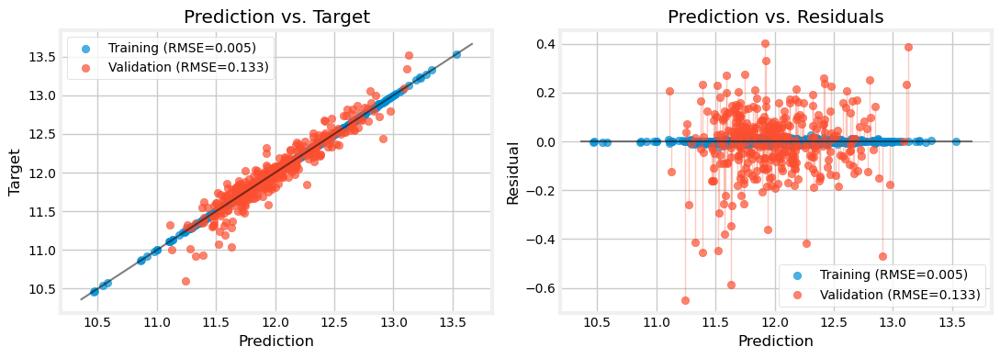



..................................................

Elapsed time: 0.04 minutes
..................................................



Time: 21:34:07
***************************************************************************
xgbr_raw , 	CV: True 

***************************************************************************
We will evaluate xgbr_raw with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.1399100005871471
		best params: {'model__learning_rate': 0.020633887663534405, 'model__max_depth': 3, 'model__n_estimators': 400, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.33327734354032845, 'preprocessor__target_encoder__smoothing': 30.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.942428
R2,0.942428
MAE,0.068037
MSE,0.009002
RMSE,0.094879
MedAE,0.050954
MAPE,0.005679




Regression Report: Validation
..................................................


,Value
Explained Variance,0.876897
R2,0.876820
MAE,0.095005
MSE,0.020645
RMSE,0.143683
MedAE,0.062012
MAPE,0.007991



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


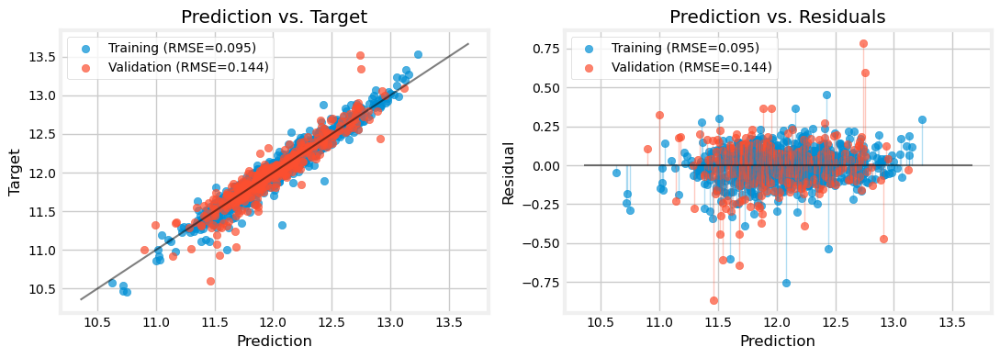



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['OverallQual', 'GrLivArea', 'Neighborhood', 'TotalBsmtSF', 'BsmtFinSF1', 'YearRemodAdd', 'LotArea', 'GarageCars', 'FireplaceQu', 'KitchenQual', 'HeatingQC', 'YearBuilt', 'GarageArea', 'GarageYrBlt', 'BsmtUnfSF', 'Fireplaces', 'OpenPorchSF', 'BsmtFinType1', 'GarageFinish', 'BsmtQual', 'GarageType_4', 'GarageType_6', 'Foundation_1', 'TotRmsAbvGrd', 'ExterQual', 'Foundation_2', 'GarageType_3', 'GarageType_0', 'GarageType_1', 'GarageType_2', 'Foundation_3', 'Foundation_4', 'Foundation_5', 'Foundation_0', 'GarageType_5', 'MSSubClass', 'Exterior1st', 'FullBath', 'LotFrontage']
The most important features are:

	OverallQual: 0.1620351452079989 +- 0.008826948989737819
	GrLivArea: 0.14189845028132617 +- 0.004701221461175953
	Neighborhood: 0.07397050670607863 +- 0.006613887188550243

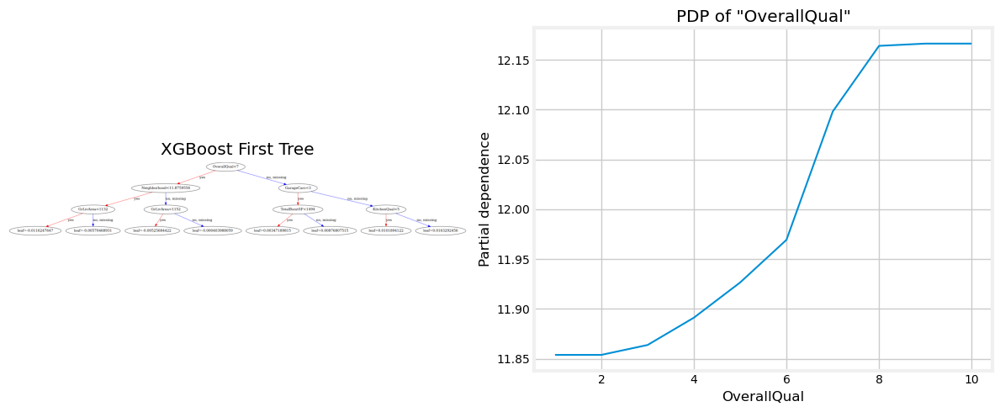

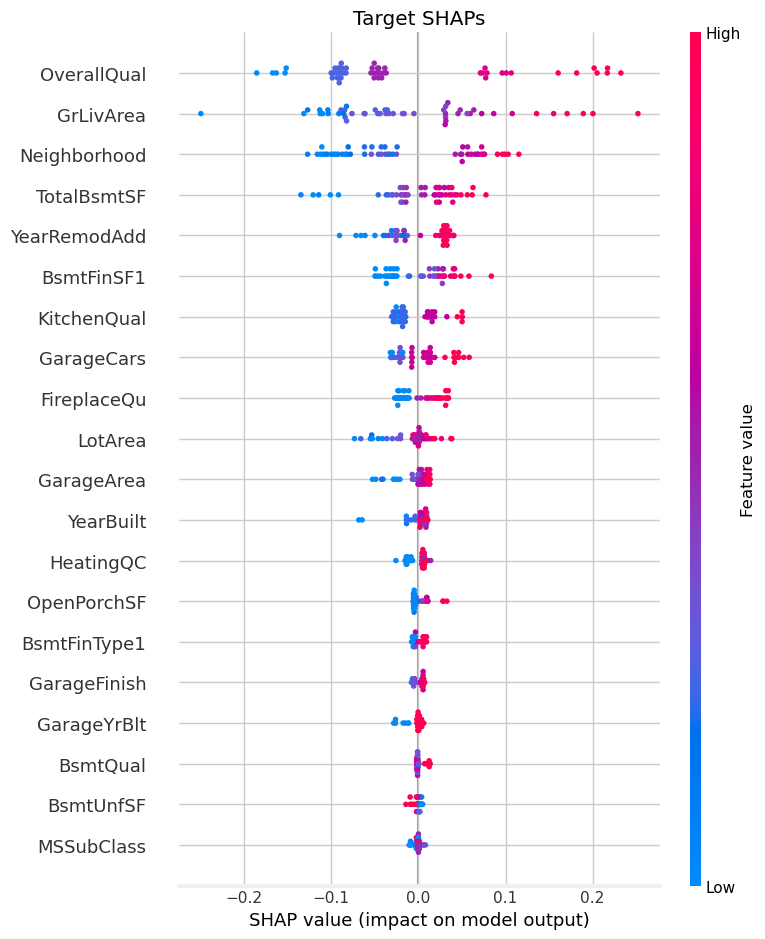

..................................................

Elapsed time: 19.79 minutes
..................................................



Time: 21:53:54
***************************************************************************
xgbr_eng , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=xgbr_eng with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.999380
R2,0.999380
MAE,0.007048
MSE,0.000097
RMSE,0.009846
MedAE,0.004898
MAPE,0.000588




Regression Report: Validation
..................................................


,Value
Explained Variance,0.876627
R2,0.876607
MAE,0.096674
MSE,0.020681
RMSE,0.143808
MedAE,0.066472
MAPE,0.008131



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


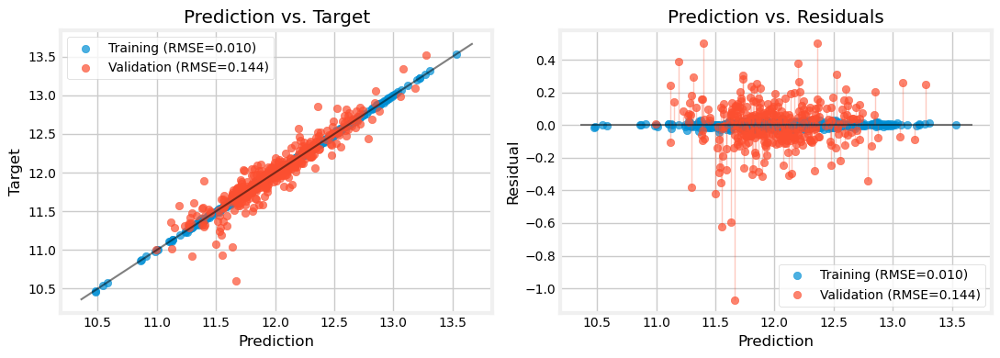



..................................................

Elapsed time: 0.04 minutes
..................................................



Time: 21:53:56
***************************************************************************
xgbr_eng , 	CV: True 

***************************************************************************
We will evaluate xgbr_eng with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.13544715910728125
		best params: {'model__learning_rate': 0.1111227758102357, 'model__max_depth': 2, 'model__n_estimators': 300, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.24360013511890424, 'preprocessor__target_encoder__smoothing': 20.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.949665
R2,0.949665
MAE,0.064219
MSE,0.007871
RMSE,0.088716
MedAE,0.047625
MAPE,0.005358




Regression Report: Validation
..................................................


,Value
Explained Variance,0.892425
R2,0.892419
MAE,0.092124
MSE,0.018031
RMSE,0.134278
MedAE,0.065447
MAPE,0.007766



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


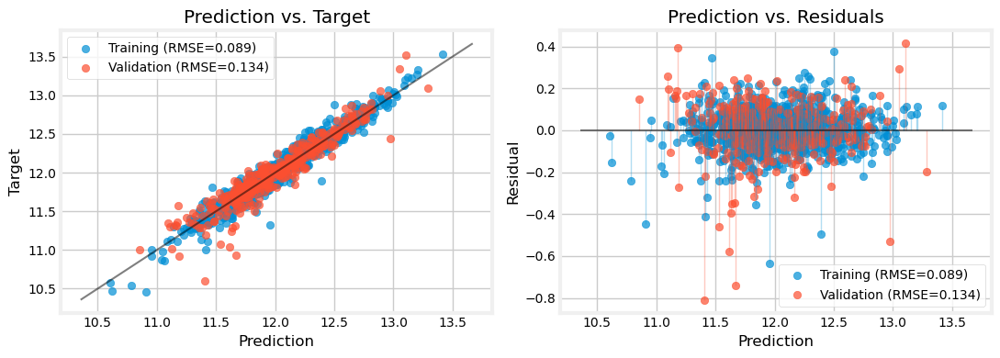



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['TotalSF', 'Neighborhood', 'OverallQual', 'OverallQualCond', 'AllBaths', 'TotalBsmtSF', 'YearRemodAdd', 'FireplaceQu', 'KitchenQual', 'GarageCars', 'YearBuilt', 'GarageFinish', 'BsmtQual', 'MSSubClass', 'GarageArea', '1stFlrSF', 'GarageType_1', 'GarageType_5', 'GarageType_3', 'FullBath', 'GarageType_0', 'Has_Garage', 'Has_Bsmt', 'ExterQual', 'GarageType_4', 'BathsAbvGr', 'GarageType_2', 'GarageType_6', 'LotFrontage']
The most important features are:

	TotalSF: 0.32431975966015436 +- 0.017078892753711578
	Neighborhood: 0.06293849004098136 +- 0.004938287528136205
	OverallQual: 0.049467262096050305 +- 0.005080650020547799
	OverallQualCond: 0.04236925248412833 +- 0.0037156164027331517
	AllBaths: 0.03114440929664859 +- 0.0033467459051188596
	TotalBsmtSF: 0.022498357885361853 +-

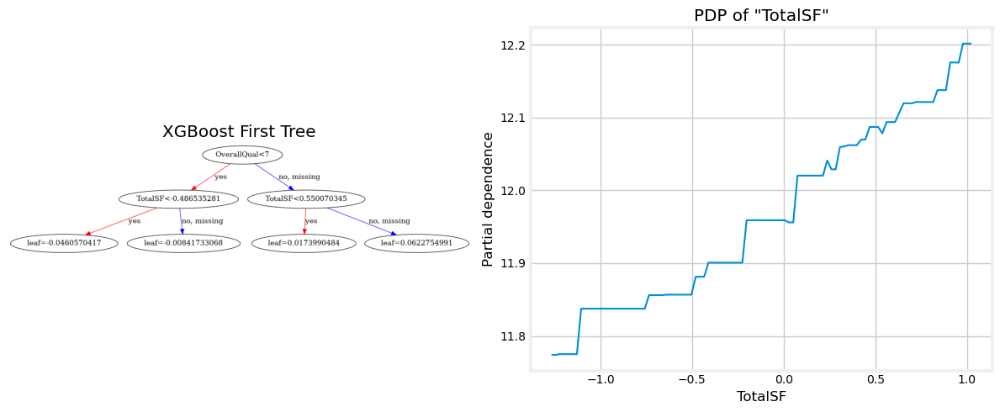

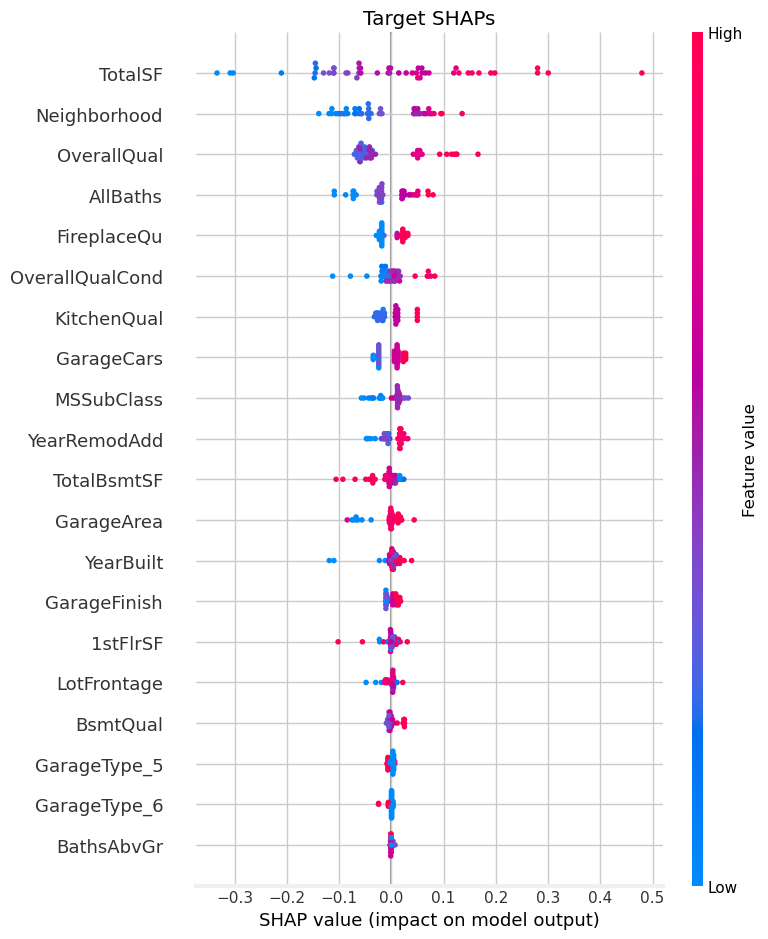

..................................................

Elapsed time: 21.08 minutes
..................................................



Time: 22:15:01
***************************************************************************
xgbr_clus , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=xgbr_clus with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.999583
R2,0.999583
MAE,0.005745
MSE,0.000065
RMSE,0.008072
MedAE,0.004133
MAPE,0.000478




Regression Report: Validation
..................................................


,Value
Explained Variance,0.862083
R2,0.861901
MAE,0.108004
MSE,0.023145
RMSE,0.152136
MedAE,0.074474
MAPE,0.009084



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


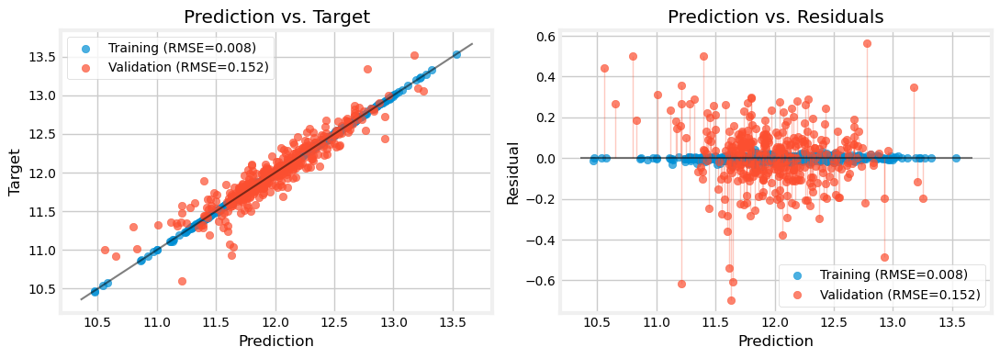



..................................................

Elapsed time: 0.04 minutes
..................................................



Time: 22:15:04
***************************************************************************
xgbr_clus , 	CV: True 

***************************************************************************
We will evaluate xgbr_clus with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.13957167699411513
		best params: {'model__learning_rate': 0.06175227135671973, 'model__max_depth': 2, 'model__n_estimators': 600, 'preprocessor__cluster__n_clusters': 3, 'preprocessor__pca__fit_feat_subset': True, 'preprocessor__pca__keep_original_feats': False, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.1918022878867719, 'preprocessor__target_encoder__smoothing': 50.0}
......Done!
 -> Making predictions
...

,Value
Explained Variance,0.951419
R2,0.951419
MAE,0.063789
MSE,0.007596
RMSE,0.087156
MedAE,0.049976
MAPE,0.005317




Regression Report: Validation
..................................................


,Value
Explained Variance,0.876651
R2,0.876020
MAE,0.098360
MSE,0.020779
RMSE,0.144149
MedAE,0.070560
MAPE,0.008294



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


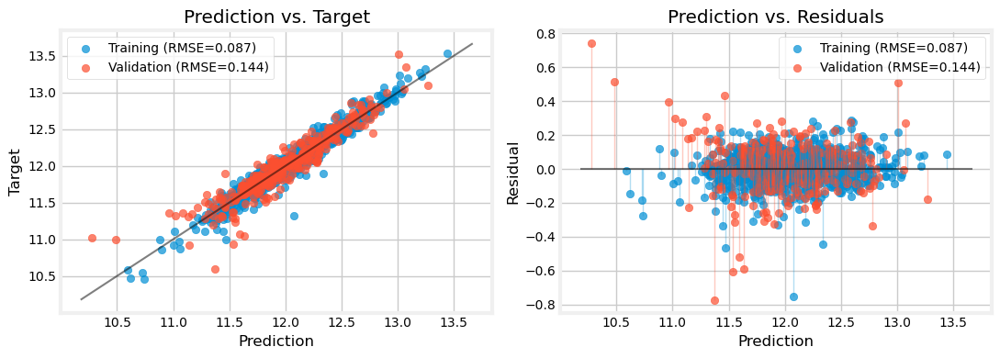



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['pca0', 'OverallQual', 'AllBaths', 'pca2', 'pca10', 'pca11', 'pca8', 'pca6', 'FireplaceQu', 'pca5', 'pca4', 'pca3', 'pca7', 'KitchenQual', 'GarageFinish', 'GarageType_4', 'BathsAbvGr', 'ExterQual', 'GarageCars', 'GarageType_3', 'BsmtQual', 'FullBath', 'GarageType_0', 'GarageType_1', 'GarageType_5', 'cluster_0', 'cluster_1', 'cluster_2', 'Has_Garage', 'Has_Bsmt', 'pca9', 'GarageType_2', 'GarageType_6', 'pca1']
The most important features are:

	pca0: 0.8908826165316581 +- 0.045255575063315887
	OverallQual: 0.03589544031439862 +- 0.006037946148290942
	AllBaths: 0.029450386761009285 +- 0.002695365132686959
	pca2: 0.025689070886048392 +- 0.0021268397963202035
	pca10: 0.015493370438391763 +- 0.0024713086069729205
	pca11: 0.01044107437290418 +- 0.0019339601797701423
	pca8: 0.010

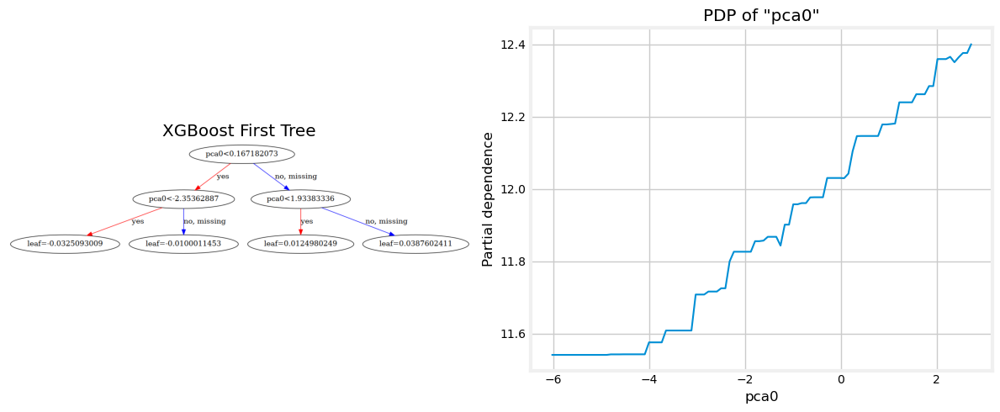

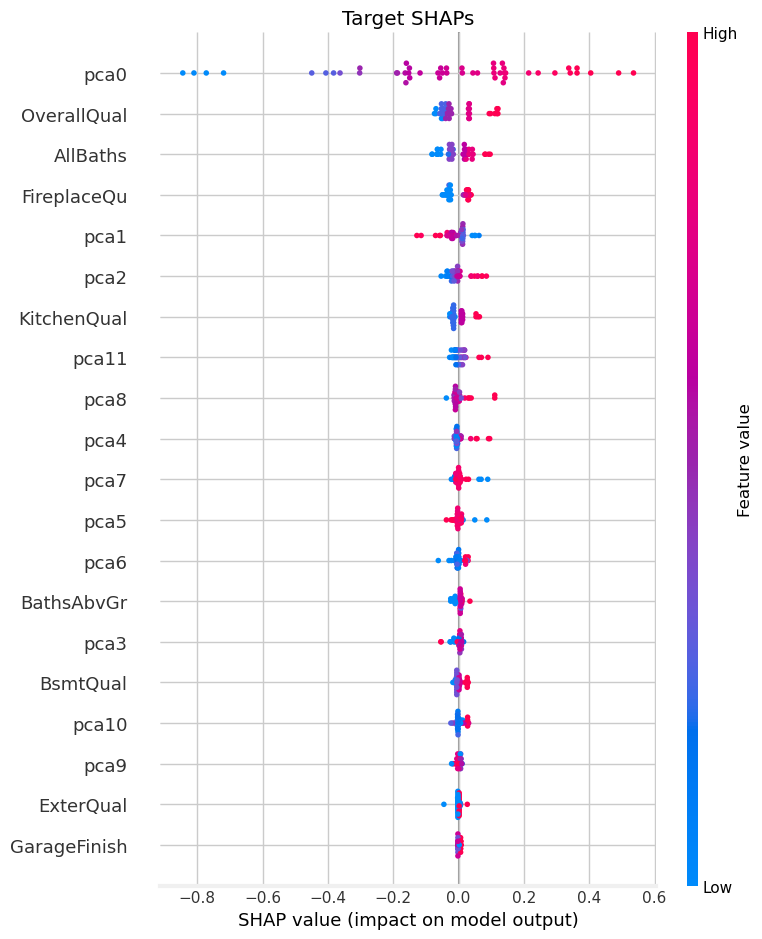

..................................................

Elapsed time: 23.96 minutes
..................................................





In [100]:
model = 'xgbr'
redoQ = True

for pp in ['raw', 'eng', 'clus']:
    for cvQ in [False, True]:

        print(time.strftime("Time: %H:%M:%S"))
        start = time.time()

        model_name = model+'_'+pp # full model name

        if redoQ and (model_name in search.keys()):
            del search[model_name]

        print("*"*75)
        print(model_name, ", \tCV:", cvQ, "\n")
        print("*"*75)
        
        # # GridSearchCV
        # model_evaluation(model_name, (X_train, X_val, y_train, y_val),
        #                  perform_cv_randomized=(cvQ, False),
        #                  n_splits=5, n_repeats=3,
        #                  verbose=True, plots=True)

        # create a dummy buffer
        # f = io.StringIO()
        # with contextlib.redirect_stderr(f): # redirect stderr into it
        # with suppress_c_stderr():
        # RandomizedSearchCV
        model_evaluation(model_name, (X_train, X_val, y_train, y_val),
                         perform_cv_randomized=(cvQ, True),
                         n_splits=5, n_repeats=3,
                         n_iter=1000,
                         verbose=True, plots=True)

        print("\n")

        if cvQ:
            explain_model(model_name, best_cv[model_name]['pipe'], (X_train, X_val, y_train, y_val), tree_idx=0, random_state=0)

        end = time.time()

        print("."*50)
        print(f"\nElapsed time: {(end-start)/60:.2f} minutes")
        print("."*50)

        print("\n\n")

In [101]:
scorecard

,rfr_base_no_cv,dtr_raw_no_cv,dtr_raw_cv,dtr_eng_no_cv,dtr_eng_cv,dtr_clus_no_cv,dtr_clus_cv,rfr_raw_no_cv,rfr_raw_cv,rfr_eng_no_cv,rfr_eng_cv,rfr_clus_no_cv,rfr_clus_cv,xgbr_raw_no_cv,xgbr_raw_cv,xgbr_eng_no_cv,xgbr_eng_cv,xgbr_clus_no_cv,xgbr_clus_cv
R2 Score Train,0.056091,9.297877e-17,0.201295,0.002394,0.186764,0.002394,0.174660,0.056091,0.059486,0.055042,0.059738,0.056760,0.066433,0.004774,0.094879,0.009846,0.088716,0.008072,0.087156
R2 Score Validation,0.891477,7.513521e-01,0.745161,0.756836,0.793272,0.783426,0.774561,0.891477,0.890179,0.888852,0.890617,0.881278,0.880512,0.894659,0.876820,0.876607,0.892419,0.861901,0.876020
RMSE Train,0.056091,9.297877e-17,0.201295,0.002394,0.186764,0.002394,0.174660,0.056091,0.059486,0.055042,0.059738,0.056760,0.066433,0.004774,0.094879,0.009846,0.088716,0.008072,0.087156
RMSE Validation,0.134864,2.041404e-01,0.206666,0.201877,0.186139,0.190520,0.194380,0.134864,0.135668,0.136486,0.135398,0.141059,0.141514,0.132873,0.143683,0.143808,0.134278,0.152136,0.144149


#### Engineered Cluster Model: exploration

In the cluster model, checking selected engineering features (from which PCA and clusters are built)

In [102]:
best_cv[model+'_clus']

{'pipe': Pipeline(steps=[('preprocessor',
                  Pipeline(steps=[('cleaning',
                                   Pipeline(steps=[('custom_imputer',
                                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                                             'BsmtQual'],
                                                                                'BsmtExposure': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtFinType2': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtQual': ['BsmtCond',
                                                                                   

In [103]:
best_cv[model+'_clus']['params']

{'model__learning_rate': 0.06175227135671973,
 'model__max_depth': 2,
 'model__n_estimators': 600,
 'preprocessor__cluster__n_clusters': 3,
 'preprocessor__pca__fit_feat_subset': True,
 'preprocessor__pca__keep_original_feats': False,
 'preprocessor__selector__best_k': 30,
 'preprocessor__selector__t_thr': 0.1918022878867719,
 'preprocessor__target_encoder__smoothing': 50.0}

In [104]:
best_cv[model+'_clus']['pipe'].steps

[('preprocessor',
  Pipeline(steps=[('cleaning',
                   Pipeline(steps=[('custom_imputer',
                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                             'BsmtQual'],
                                                                'BsmtExposure': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtFinType2': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtQual': ['BsmtCond',
                                                                             'BsmtExposure'],
                                                                'Exterior1st': 'Foundation',
                                                                

In [105]:
best_preproc = best_cv[model+'_clus']['pipe'].steps[0][1] # the best preprocessor
best_feats = best_preproc[:-3] # all the preprocessor steps, except for PCA, KMeans clustering, and OHE
best_feats.transform(X_train)

,TotalSF,OverallQual,Neighborhood,AllRooms,GarageCars,OverallQualCond,GarageArea,YearBuilt,TotalBsmtSF,BathsAbvGr,1stFlrSF,AllBaths,BsmtQual,KitchenQual,ExterQual,GarageAge,YearRemodAdd,FullBath,GarageFinish,MSSubClass,GarageType,FireplaceQu,LotFrontage,Has_Garage,Has_Bsmt
6,0.742068,8,0.472509,0.500000,2,0.5,0.502730,0.659574,1.052674,2.0,0.919677,3.0,5,4,4,-1.066979,0.305556,2,2,0.000000,1,4,0.239984,1,1
807,0.367177,5,-1.069603,0.333333,2,-0.5,0.170238,-1.063830,0.569246,1.5,-0.048785,3.5,3,4,3,0.537697,0.277778,1,2,-0.340399,1,3,2.518040,1,1
955,0.398207,6,0.288295,0.500000,2,0.1,0.044102,-0.574468,-0.034421,2.0,-0.240817,2.0,4,3,3,0.361174,-1.222222,2,1,-0.746899,1,0,0.550685,1,1
1040,0.398207,5,-0.738474,0.833333,2,-1.5,0.014822,-0.340426,0.259462,2.0,1.051686,3.0,3,3,3,0.249087,0.166667,2,2,0.073230,1,3,0.796813,1,1
701,-0.170534,7,0.108607,-0.333333,2,0.0,0.170238,-0.085106,0.311677,1.5,0.125459,1.5,3,3,3,0.106088,-0.694444,1,1,0.023096,1,0,0.464671,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,-0.081754,6,0.108607,0.166667,2,-0.5,-0.007457,0.021277,0.132054,2.0,0.439205,2.0,4,3,3,0.077916,-0.555556,2,2,0.023096,1,3,0.376507,1,1
905,-0.400741,5,-0.774909,-0.166667,1,-1.0,-0.961984,-0.404255,0.116963,1.0,-0.066626,2.0,3,3,3,0.317361,-1.111111,1,2,0.073230,1,0,0.464671,1,1
1096,-0.494922,6,-1.399037,0.000000,0,0.7,-11.052923,-1.255319,-0.751207,1.5,-0.740655,1.5,3,4,3,2.173310,0.333333,1,0,-0.182551,6,0,-0.535329,0,1
235,-1.295571,6,-1.118567,-0.666667,1,-1.7,-1.066905,-0.042553,-1.446378,1.5,-1.735090,1.5,3,3,3,0.106088,-0.638889,1,1,-0.777253,5,0,-4.131663,1,1


In [106]:
best_preproc

Pipeline(steps=[('cleaning',
                 Pipeline(steps=[('custom_imputer',
                                  CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                           'BsmtQual'],
                                                              'BsmtExposure': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtFinType2': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtQual': ['BsmtCond',
                                                                           'BsmtExposure'],
                                                              'Exterior1st': 'Foundation',
                                                              'Exterior2nd': 'Foundation',
                                                              'GarageArea': ['GarageCars',
                                                                             'GarageQual'],
                                                              'GarageCa...
                 PCAFeature(fit_feat_subset=True, keep_original_feats=False)),
                ('cluster',
                 KMeansFeature(n_clusters=3, scaling_method='robust')),
                ('ohe',
                 Pipeline(steps=[('ohe',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('ohe',
                                                                   OneHotEncoder(dtype=<class 'int'>,
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False),
                                                                   <function ohe_from_subset.<locals>.selector at 0x7b1eeceb1f80>)],
                                                    verbose_feature_names_out=False))]))])

In [107]:
del best_preproc, best_feats

### Model 4: `LinearRegression`

In [108]:
model = 'linreg'

for pp in ['raw', 'eng', 'clus']:

    model_name = model+'_'+pp # full model name

    preproc_pipe = final_preproc[pp] # preprocessing  pipeline

    pipe[model_name] = Pipeline(steps=[('preprocessor', preproc_pipe),
                                       ('model', LinearRegression(fit_intercept=True))])

    pipe[model_name+'_no_cv'] = Pipeline(steps=[('preprocessor', preproc_pipe),
                                       ('model', LinearRegression(fit_intercept=True))])


    # defining the hyperparameter grid
    # basic:
    param_grid[model_name] = {'preprocessor__target_encoder__smoothing':
                                  list(np.arange(10., 60., 10.)),
                              'preprocessor__selector__best_k':
                                  list(range(10, 40, 10)),#+["all"]
                              # 'preprocessor__selector__t_thr':
                              #     list(np.arange(0.1, 0.7, 0.1))#+[None]
                              'preprocessor__selector__t_thr':
                                  uniform(loc=0.1, scale=0.8)
                             }
    # if clustering:
    if pp == 'clus':
        param_grid[model_name]['preprocessor__pca__fit_feat_subset'] =\
                        [True]
        param_grid[model_name]['preprocessor__pca__keep_original_feats'] =\
            [False]
        param_grid[model_name]['preprocessor__cluster__n_clusters'] =\
            list(range(3,7))

***************************************************************************
linreg_raw , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=linreg_raw with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.936632
R2,0.936632
MAE,0.070729
MSE,0.009908
RMSE,0.099541
MedAE,0.054578
MAPE,0.005904




Regression Report: Validation
..................................................


,Value
Explained Variance,0.895132
R2,0.895123
MAE,0.094215
MSE,0.017577
RMSE,0.132579
MedAE,0.069316
MAPE,0.007939



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


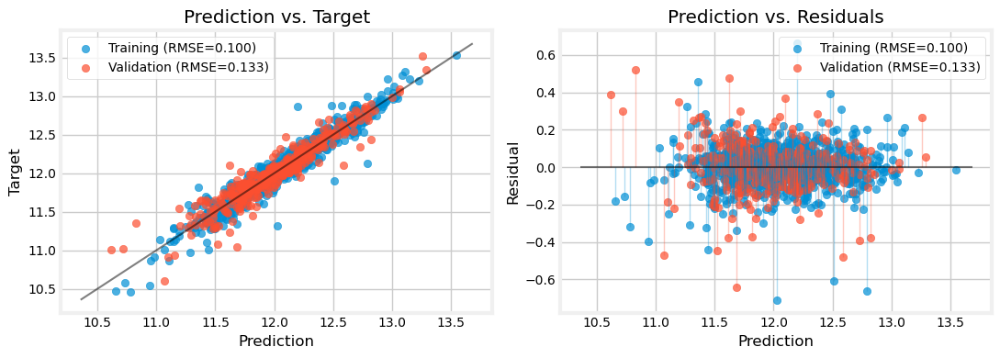



..................................................

Elapsed time: 0.05 minutes
..................................................



***************************************************************************
linreg_raw , 	CV: True 

***************************************************************************
We will evaluate linreg_raw with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.15642160823543436
		best params: {'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.6776444795762784, 'preprocessor__target_encoder__smoothing': 50.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.855174
R2,0.855174
MAE,0.105741
MSE,0.022645
RMSE,0.150483
MedAE,0.079671
MAPE,0.008836




Regression Report: Validation
..................................................


,Value
Explained Variance,0.878694
R2,0.878597
MAE,0.103444
MSE,0.020347
RMSE,0.142643
MedAE,0.082032
MAPE,0.008700



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


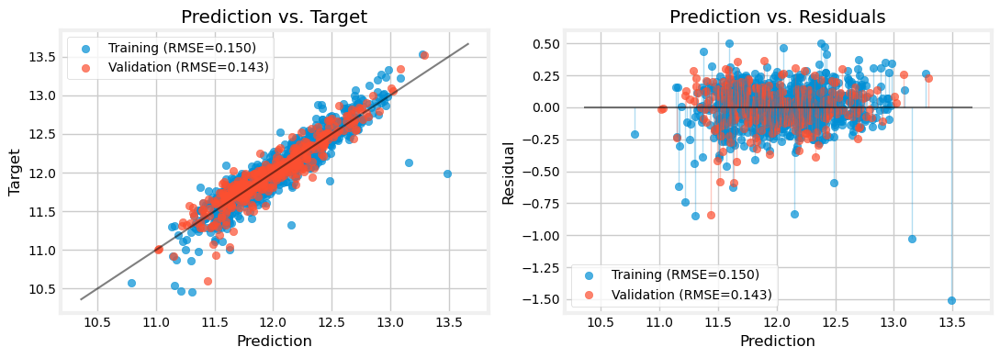



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['GarageYrBlt', 'GarageType_6', 'GarageType_1', 'GarageType_5', 'OverallQual', 'Neighborhood', 'GarageType_3', 'GrLivArea', 'GarageCars', 'BsmtFinType1', 'YearRemodAdd', 'TotalBsmtSF', 'TotRmsAbvGrd', 'Foundation_1', 'HeatingQC', 'KitchenQual', 'Fireplaces', 'GarageType_4', 'GarageType_2', 'YearBuilt', 'BsmtQual', 'Foundation_0', 'FireplaceQu', 'GarageType_0', 'GarageFinish', 'Foundation_3', 'ExterQual', 'Foundation_2', 'Foundation_4', 'Foundation_5', 'OpenPorchSF', 'FullBath', 'LotFrontage']
The most important features are:

	GarageYrBlt: 3.1423653581469355 +- 0.19025471568323538
	GarageType_6: 2.2496539366767676 +- 0.1323503599253804
	GarageType_1: 0.3302145410020005 +- 0.03049561266828248
	GarageType_5: 0.2222034453491605 +- 0.020891485047993857
	OverallQual: 0.095487536

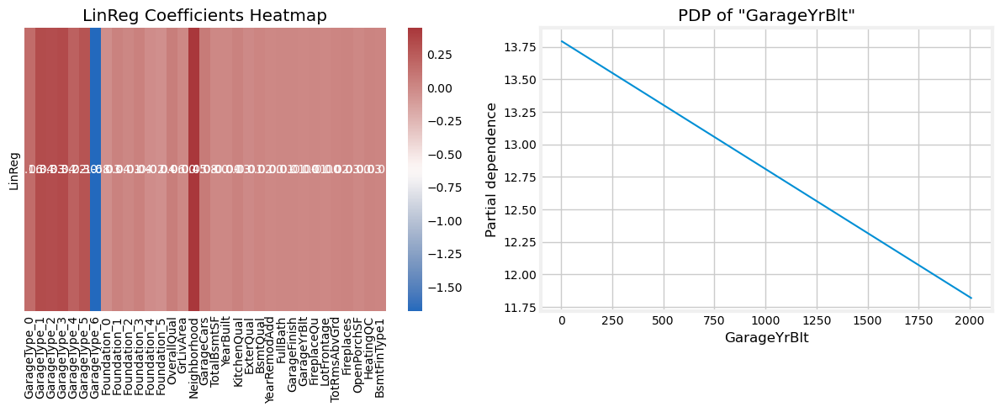

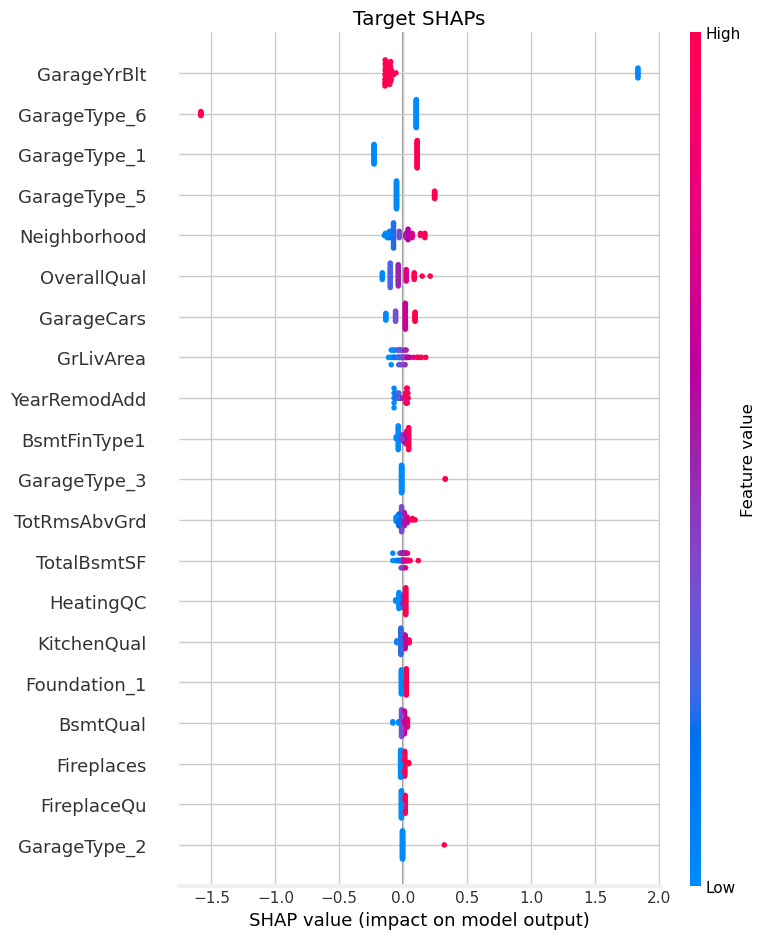

..................................................

Elapsed time: 14.56 minutes
..................................................



***************************************************************************
linreg_eng , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=linreg_eng with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.871949
R2,0.871949
MAE,0.100344
MSE,0.020022
RMSE,0.141500
MedAE,0.076520
MAPE,0.008376




Regression Report: Validation
..................................................


,Value
Explained Variance,0.893075
R2,0.892702
MAE,0.098512
MSE,0.017983
RMSE,0.134101
MedAE,0.075639
MAPE,0.008274



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


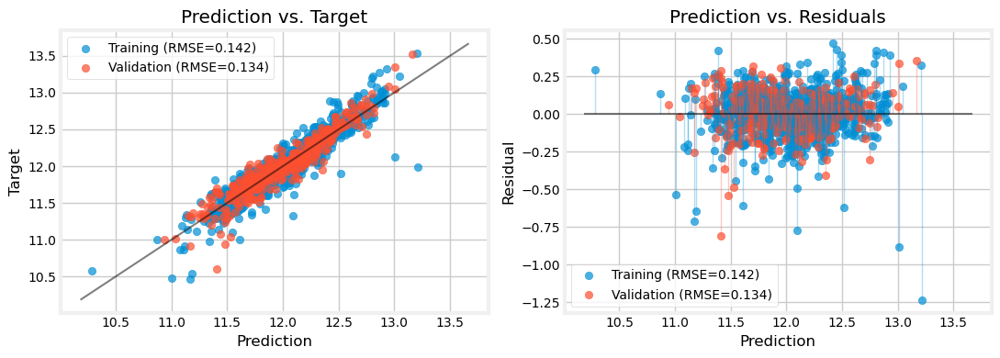



..................................................

Elapsed time: 0.03 minutes
..................................................



***************************************************************************
linreg_eng , 	CV: True 

***************************************************************************
We will evaluate linreg_eng with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.14322555400089157
		best params: {'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.12326467983816665, 'preprocessor__target_encoder__smoothing': 50.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.882974
R2,0.882974
MAE,0.093657
MSE,0.018298
RMSE,0.135272
MedAE,0.070429
MAPE,0.007814




Regression Report: Validation
..................................................


,Value
Explained Variance,0.900445
R2,0.900085
MAE,0.094291
MSE,0.016746
RMSE,0.129406
MedAE,0.070095
MAPE,0.007918



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


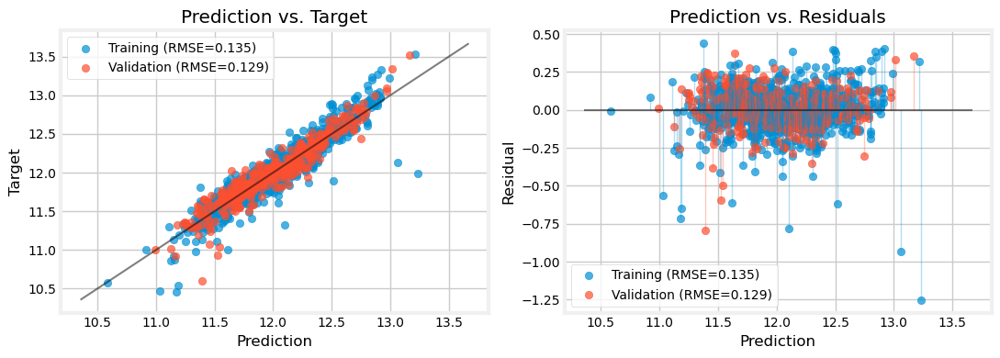



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['Has_2ndFlr', '2ndFlrSF', '1and2FlrSF', 'OverallQualCond', 'Has_Bsmt', 'Neighborhood', 'TotalBsmtSF', 'AllBaths', 'GarageCars', 'TotalSF', 'FullBath', 'FireplaceQu', 'BsmtQual', 'YearBuilt', 'KitchenQual', 'GarageType_1', 'GarageType_5', 'LotFrontage', 'GarageAge', 'GarageType_3', 'MSSubClass', 'BathsAbvGr', 'GarageFinish', 'GarageArea', 'GarageType_4', '1stFlrSF', 'YearRemodAdd', 'GarageType_0', 'GarageType_6', 'Has_Garage', 'AllRooms', 'OverallQual', 'ExterQual', 'HouseAge', 'GarageType_2']
The most important features are:

	Has_2ndFlr: 0.2092072700544497 +- 0.019150551876166676
	2ndFlrSF: 0.1832593029566736 +- 0.006417649303406833
	1and2FlrSF: 0.11492107384743003 +- 0.003933859994367557
	OverallQualCond: 0.08326147241203237 +- 0.004476713314075417
	Has_Bsmt: 0.075510054

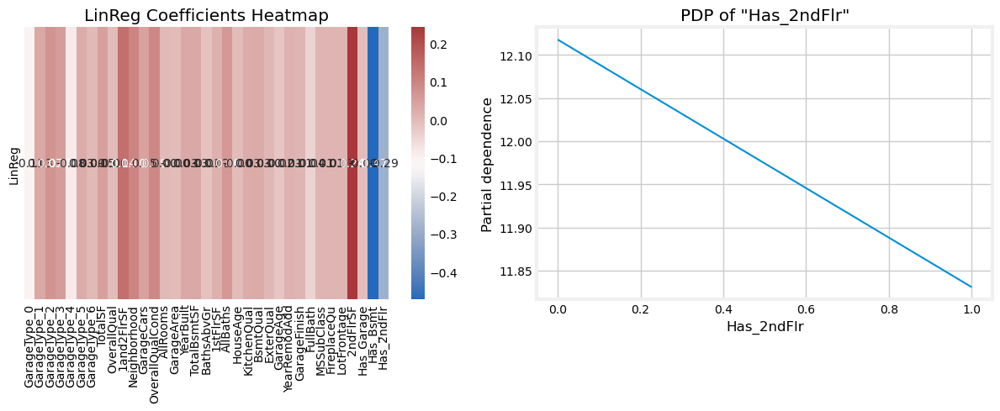

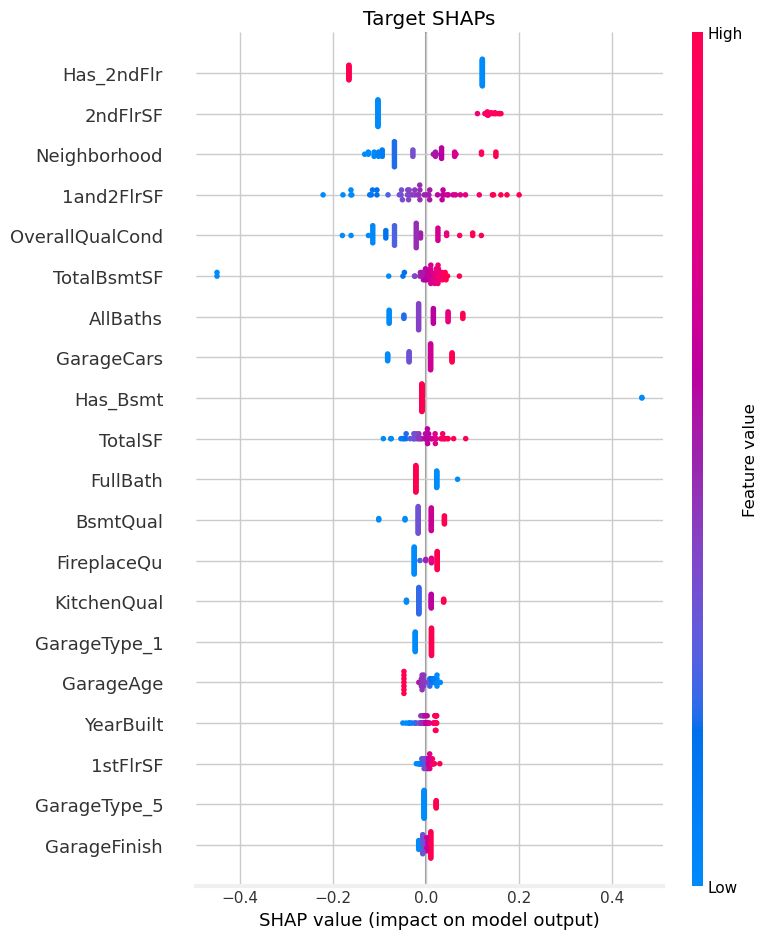

..................................................

Elapsed time: 16.88 minutes
..................................................



***************************************************************************
linreg_clus , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=linreg_clus with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.872249
R2,0.872249
MAE,0.100242
MSE,0.019975
RMSE,0.141334
MedAE,0.077024
MAPE,0.008368




Regression Report: Validation
..................................................


,Value
Explained Variance,0.893339
R2,0.892984
MAE,0.098478
MSE,0.017936
RMSE,0.133925
MedAE,0.076050
MAPE,0.008272



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


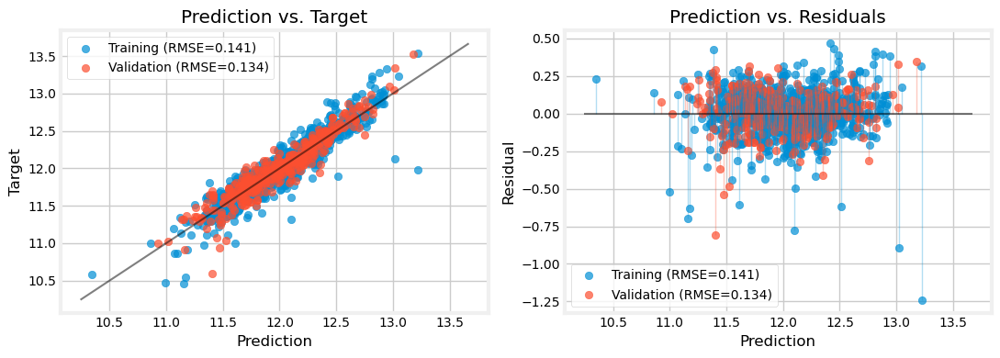



..................................................

Elapsed time: 0.04 minutes
..................................................



***************************************************************************
linreg_clus , 	CV: True 

***************************************************************************
We will evaluate linreg_clus with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.14334119523657857
		best params: {'preprocessor__cluster__n_clusters': 6, 'preprocessor__pca__fit_feat_subset': True, 'preprocessor__pca__keep_original_feats': False, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.11611300417471133, 'preprocessor__target_encoder__smoothing': 50.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
.......................

,Value
Explained Variance,0.883196
R2,0.883196
MAE,0.093605
MSE,0.018264
RMSE,0.135143
MedAE,0.070321
MAPE,0.007809




Regression Report: Validation
..................................................


,Value
Explained Variance,0.903316
R2,0.902885
MAE,0.092209
MSE,0.016276
RMSE,0.127579
MedAE,0.067438
MAPE,0.007740



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


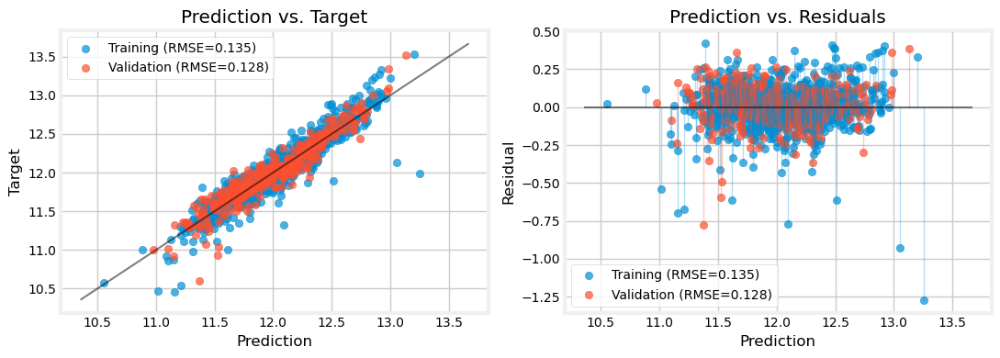



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['pca0', 'pca5', 'pca6', 'pca2', 'AllBaths', 'pca7', 'pca13', 'GarageCars', 'FireplaceQu', 'pca3', 'pca9', 'GarageType_5', 'FullBath', 'Has_Bsmt', 'BsmtQual', 'cluster_0', 'cluster_5', 'cluster_4', 'KitchenQual', 'pca11', 'BathsAbvGr', 'GarageFinish', 'GarageType_3', 'pca4', 'pca10', 'GarageType_6', 'Has_Garage', 'cluster_3', 'GarageType_1', 'cluster_2', 'GarageType_0', 'GarageType_4', 'pca1', 'pca8', 'OverallQual', 'cluster_1', 'pca12', 'ExterQual', 'GarageType_2']
The most important features are:

	pca0: 1.4936566577090409 +- 0.058133434605387606
	pca5: 0.08698254742455025 +- 0.006436198165470551
	pca6: 0.07253584465959864 +- 0.0069518980497477985
	pca2: 0.054392085664428304 +- 0.006512424859888544
	AllBaths: 0.03255204405948662 +- 0.0029541191247214023
	pca7: 0.026995819

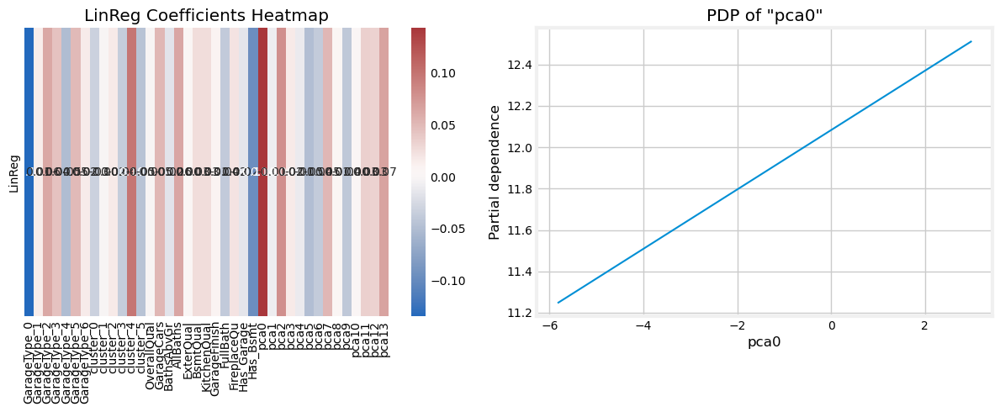

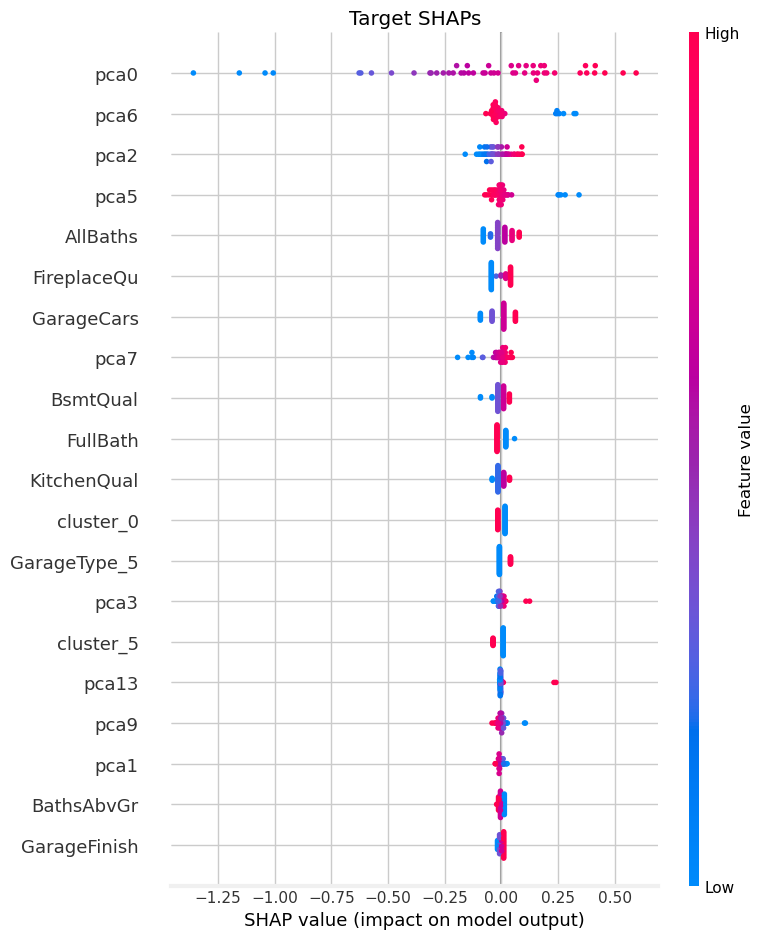

..................................................

Elapsed time: 18.27 minutes
..................................................





In [109]:
model = 'linreg'
redoQ = True

for pp in ['raw', 'eng', 'clus']:
    for cvQ in [False, True]:

        print(time.strftime("Time: %H:%M:%S"))
        start = time.time()

        model_name = model+'_'+pp # full model name

        if redoQ and (model_name in search.keys()):
            del search[model_name]

        print("*"*75)
        print(model_name, ", \tCV:", cvQ, "\n")
        print("*"*75)
        
        # # GridSearchCV
        # model_evaluation(model_name, (X_train, X_val, y_train, y_val),
        #                  perform_cv_randomized=(cvQ, False),
        #                  n_splits=5, n_repeats=3,
        #                  verbose=True, plots=True)

        # RandomizedSearchCV
        model_evaluation(model_name, (X_train, X_val, y_train, y_val),
                         perform_cv_randomized=(cvQ, True),
                         n_splits=5, n_repeats=3,
                         n_iter=1000,
                         verbose=True, plots=True)

        print("\n")

        if cvQ:
            explain_model(model_name, best_cv[model_name]['pipe'], (X_train, X_val, y_train, y_val), tree_idx=0, random_state=0)

        end = time.time()

        print("."*50)
        print(f"\nElapsed time: {(end-start)/60:.2f} minutes")
        print("."*50)

        print("\n\n")

In [110]:
scorecard

,rfr_base_no_cv,dtr_raw_no_cv,dtr_raw_cv,dtr_eng_no_cv,dtr_eng_cv,dtr_clus_no_cv,dtr_clus_cv,rfr_raw_no_cv,rfr_raw_cv,rfr_eng_no_cv,rfr_eng_cv,rfr_clus_no_cv,rfr_clus_cv,xgbr_raw_no_cv,xgbr_raw_cv,xgbr_eng_no_cv,xgbr_eng_cv,xgbr_clus_no_cv,xgbr_clus_cv,linreg_raw_no_cv,linreg_raw_cv,linreg_eng_no_cv,linreg_eng_cv,linreg_clus_no_cv,linreg_clus_cv
R2 Score Train,0.056091,9.297877e-17,0.201295,0.002394,0.186764,0.002394,0.174660,0.056091,0.059486,0.055042,0.059738,0.056760,0.066433,0.004774,0.094879,0.009846,0.088716,0.008072,0.087156,0.099541,0.150483,0.141500,0.135272,0.141334,0.135143
R2 Score Validation,0.891477,7.513521e-01,0.745161,0.756836,0.793272,0.783426,0.774561,0.891477,0.890179,0.888852,0.890617,0.881278,0.880512,0.894659,0.876820,0.876607,0.892419,0.861901,0.876020,0.895123,0.878597,0.892702,0.900085,0.892984,0.902885
RMSE Train,0.056091,9.297877e-17,0.201295,0.002394,0.186764,0.002394,0.174660,0.056091,0.059486,0.055042,0.059738,0.056760,0.066433,0.004774,0.094879,0.009846,0.088716,0.008072,0.087156,0.099541,0.150483,0.141500,0.135272,0.141334,0.135143
RMSE Validation,0.134864,2.041404e-01,0.206666,0.201877,0.186139,0.190520,0.194380,0.134864,0.135668,0.136486,0.135398,0.141059,0.141514,0.132873,0.143683,0.143808,0.134278,0.152136,0.144149,0.132579,0.142643,0.134101,0.129406,0.133925,0.127579


#### Engineered Cluster Model: exploration

In the cluster model, checking selected engineering features (from which PCA and clusters are built)

In [111]:
best_cv[model+'_clus']

{'pipe': Pipeline(steps=[('preprocessor',
                  Pipeline(steps=[('cleaning',
                                   Pipeline(steps=[('custom_imputer',
                                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                                             'BsmtQual'],
                                                                                'BsmtExposure': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtFinType2': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtQual': ['BsmtCond',
                                                                                   

In [112]:
best_cv[model+'_clus']['params']

{'preprocessor__cluster__n_clusters': 6,
 'preprocessor__pca__fit_feat_subset': True,
 'preprocessor__pca__keep_original_feats': False,
 'preprocessor__selector__best_k': 30,
 'preprocessor__selector__t_thr': 0.11611300417471133,
 'preprocessor__target_encoder__smoothing': 50.0}

In [113]:
best_cv[model+'_clus']['pipe'].steps

[('preprocessor',
  Pipeline(steps=[('cleaning',
                   Pipeline(steps=[('custom_imputer',
                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                             'BsmtQual'],
                                                                'BsmtExposure': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtFinType2': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtQual': ['BsmtCond',
                                                                             'BsmtExposure'],
                                                                'Exterior1st': 'Foundation',
                                                                

In [114]:
best_preproc = best_cv[model+'_clus']['pipe'].steps[0][1] # the best preprocessor
best_feats = best_preproc[:-3] # all the preprocessor steps, except for PCA, KMeans clustering, and OHE
best_feats.transform(X_train)

,TotalSF,OverallQual,1and2FlrSF,Neighborhood,OverallQualCond,AllRooms,GarageCars,GarageArea,TotalBsmtSF,YearBuilt,BathsAbvGr,AllBaths,1stFlrSF,HouseAge,ExterQual,BsmtQual,KitchenQual,GarageAge,GarageFinish,YearRemodAdd,FullBath,MSSubClass,FireplaceQu,GarageType,LotFrontage,Has_Garage,Has_Bsmt
6,0.742068,8,0.312092,0.472509,0.5,0.500000,2,0.502730,1.052674,0.659574,2.0,3.0,0.919677,-1.125091,4,5,4,-1.066979,2,0.305556,2,0.000000,4,1,0.239984,1,1
807,0.367177,5,0.156204,-1.069603,-0.5,0.333333,2,0.170238,0.569246,-1.063830,1.5,3.5,-0.048785,0.472309,3,3,4,0.537697,2,0.277778,1,-0.340399,3,1,2.518040,1,1
955,0.398207,6,0.624807,0.288295,0.1,0.500000,2,0.044102,-0.034421,-0.574468,2.0,2.0,-0.240817,0.296586,3,4,3,0.361174,1,-1.222222,2,-0.746899,0,1,0.550685,1,1
1040,0.398207,5,0.446734,-0.738474,-1.5,0.833333,2,0.014822,0.259462,-0.340426,2.0,3.0,1.051686,0.185008,3,3,3,0.249087,2,0.166667,2,0.073230,3,1,0.796813,1,1
701,-0.170534,7,-0.497959,0.108607,0.0,-0.333333,2,0.170238,0.311677,-0.085106,1.5,1.5,0.125459,0.042657,3,3,3,0.106088,1,-0.694444,1,0.023096,0,1,0.464671,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,-0.081754,6,-0.177958,0.108607,-0.5,0.166667,2,-0.007457,0.132054,0.021277,2.0,2.0,0.439205,0.014612,3,4,3,0.077916,2,-0.555556,2,0.023096,3,1,0.376507,1,1
905,-0.400741,5,-0.693872,-0.774909,-1.0,-0.166667,1,-0.961984,0.116963,-0.404255,1.0,2.0,-0.066626,0.252972,3,3,3,0.317361,2,-1.111111,1,0.073230,0,1,0.464671,1,1
1096,-0.494922,6,-0.169978,-1.399037,0.7,0.000000,0,-11.052923,-0.751207,-1.255319,1.5,1.5,-0.740655,0.512449,3,3,4,2.173310,0,0.333333,1,-0.182551,0,6,-0.535329,0,1
235,-1.295571,6,-0.853972,-1.118567,-1.7,-0.666667,1,-1.066905,-1.446378,-0.042553,1.5,1.5,-1.735090,0.042657,3,3,3,0.106088,1,-0.638889,1,-0.777253,0,5,-4.131663,1,1


In [115]:
best_preproc

Pipeline(steps=[('cleaning',
                 Pipeline(steps=[('custom_imputer',
                                  CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                           'BsmtQual'],
                                                              'BsmtExposure': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtFinType2': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtQual': ['BsmtCond',
                                                                           'BsmtExposure'],
                                                              'Exterior1st': 'Foundation',
                                                              'Exterior2nd': 'Foundation',
                                                              'GarageArea': ['GarageCars',
                                                                             'GarageQual'],
                                                              'GarageCa...
                 PCAFeature(fit_feat_subset=True, keep_original_feats=False)),
                ('cluster',
                 KMeansFeature(n_clusters=6, scaling_method='robust')),
                ('ohe',
                 Pipeline(steps=[('ohe',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('ohe',
                                                                   OneHotEncoder(dtype=<class 'int'>,
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False),
                                                                   <function ohe_from_subset.<locals>.selector at 0x7b1eeceb1f80>)],
                                                    verbose_feature_names_out=False))]))])

In [116]:
del best_preproc, best_feats

### Model 5: `Lasso`

In [117]:
model = 'lasso'

for pp in ['raw', 'eng', 'clus']:

    model_name = model+'_'+pp # full model name

    preproc_pipe = final_preproc[pp] # preprocessing  pipeline

    pipe[model_name] =\
        Pipeline(steps=[('preprocessor', preproc_pipe),
                        ('model', Lasso(max_iter=10_000,
                                        random_state=0))])

    pipe[model_name+'_no_cv'] =\
        Pipeline(steps=[('preprocessor', preproc_pipe),
                        ('model', Lasso(max_iter=10_000,
                                        random_state=0))])

    # defining the hyperparameter grid
    # basic:
    param_grid[model_name] = {'preprocessor__target_encoder__smoothing':
                                  list(np.arange(10., 60., 10.)),
                              'preprocessor__selector__best_k':
                                  list(range(10, 40, 10)),
                              'preprocessor__selector__t_thr':
                                  uniform(loc=0.1, scale=0.8)
                             }
    # if clustering:
    if pp == 'clus':
        param_grid[model_name]['preprocessor__pca__fit_feat_subset'] =\
                        [True]
        param_grid[model_name]['preprocessor__pca__keep_original_feats'] =\
            [False]
        param_grid[model_name]['preprocessor__cluster__n_clusters'] =\
            list(range(3,7))

    # proper to the model:
    param_grid[model_name]['model__alpha'] =\
        loguniform(1e-4, 10.)

Time: 23:28:52
***************************************************************************
lasso_raw , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=lasso_raw with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.755731
R2,0.755731
MAE,0.123339
MSE,0.038194
RMSE,0.195434
MedAE,0.080769
MAPE,0.010295




Regression Report: Validation
..................................................


,Value
Explained Variance,0.815155
R2,0.814858
MAE,0.124621
MSE,0.031030
RMSE,0.176152
MedAE,0.088828
MAPE,0.010464



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


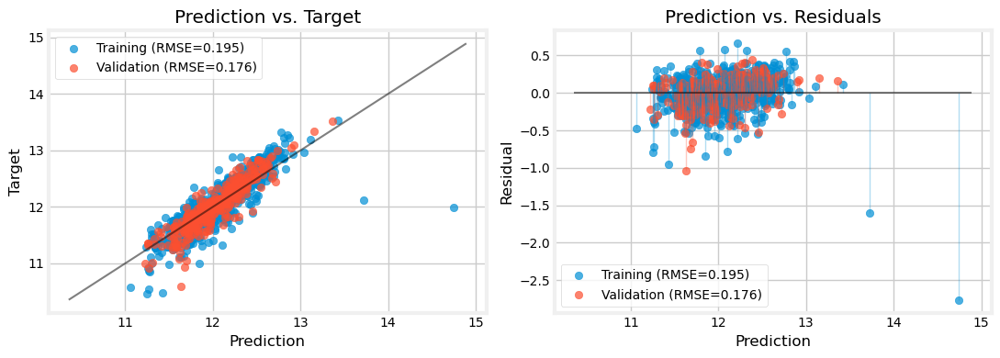



..................................................

Elapsed time: 0.03 minutes
..................................................



Time: 23:28:53
***************************************************************************
lasso_raw , 	CV: True 

***************************************************************************
We will evaluate lasso_raw with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model


/home/mbuenabad/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.285e-02, tolerance: 1.349e-02
  model = cd_fast.enet_coordinate_descent(
/home/mbuenabad/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.451e-02, tolerance: 1.398e-02
  model = cd_fast.enet_coordinate_descent(
/home/mbuenabad/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisati

......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.15651354417976365
		best params: {'model__alpha': 0.0013940776063327014, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.7226209338371551, 'preprocessor__target_encoder__smoothing': 50.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.851238
R2,0.851238
MAE,0.105689
MSE,0.023261
RMSE,0.152514
MedAE,0.080424
MAPE,0.008829




Regression Report: Validation
..................................................


,Value
Explained Variance,0.882998
R2,0.882886
MAE,0.100641
MSE,0.019628
RMSE,0.140101
MedAE,0.069396
MAPE,0.008467



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


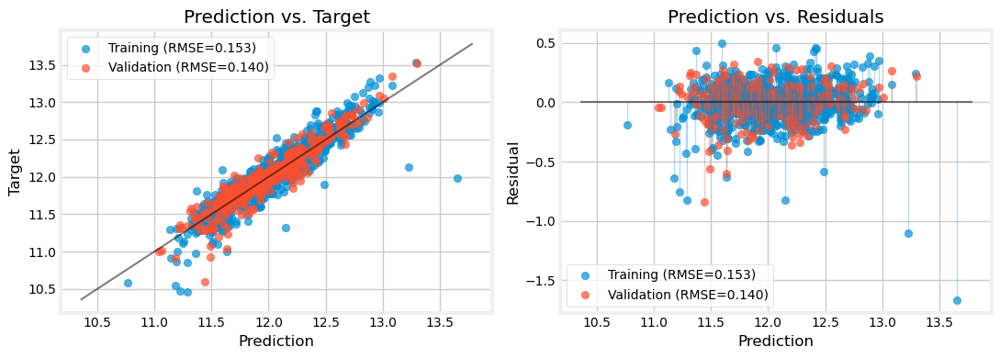



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['OverallQual', 'GrLivArea', 'Neighborhood', 'GarageCars', 'BsmtFinType1', 'YearRemodAdd', 'TotalBsmtSF', 'TotRmsAbvGrd', 'FireplaceQu', 'HeatingQC', 'KitchenQual', 'GarageYrBlt', 'Fireplaces', 'Foundation_1', 'GarageType_1', 'BsmtQual', 'GarageFinish', 'Foundation_0', 'LotFrontage', 'GarageType_5', 'OpenPorchSF', 'GarageType_0', 'GarageType_2', 'GarageType_3', 'GarageType_4', 'GarageType_6', 'Foundation_2', 'Foundation_3', 'Foundation_4', 'Foundation_5', 'ExterQual', 'FullBath', 'YearBuilt']
The most important features are:

	OverallQual: 0.10994781670500094 +- 0.004660056728619232
	GrLivArea: 0.09034598260222877 +- 0.0062356736913306435
	Neighborhood: 0.05711256342780422 +- 0.004624088926733151
	GarageCars: 0.025646800742579478 +- 0.0034875809175297745
	BsmtFinType1: 0.02

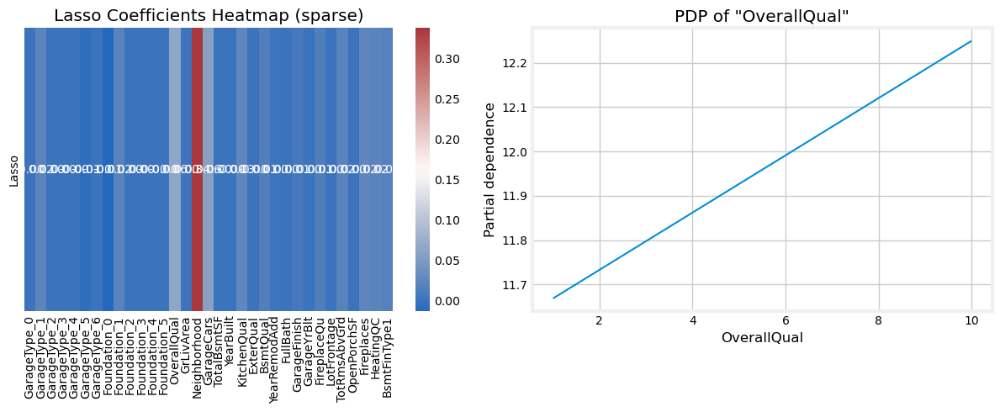

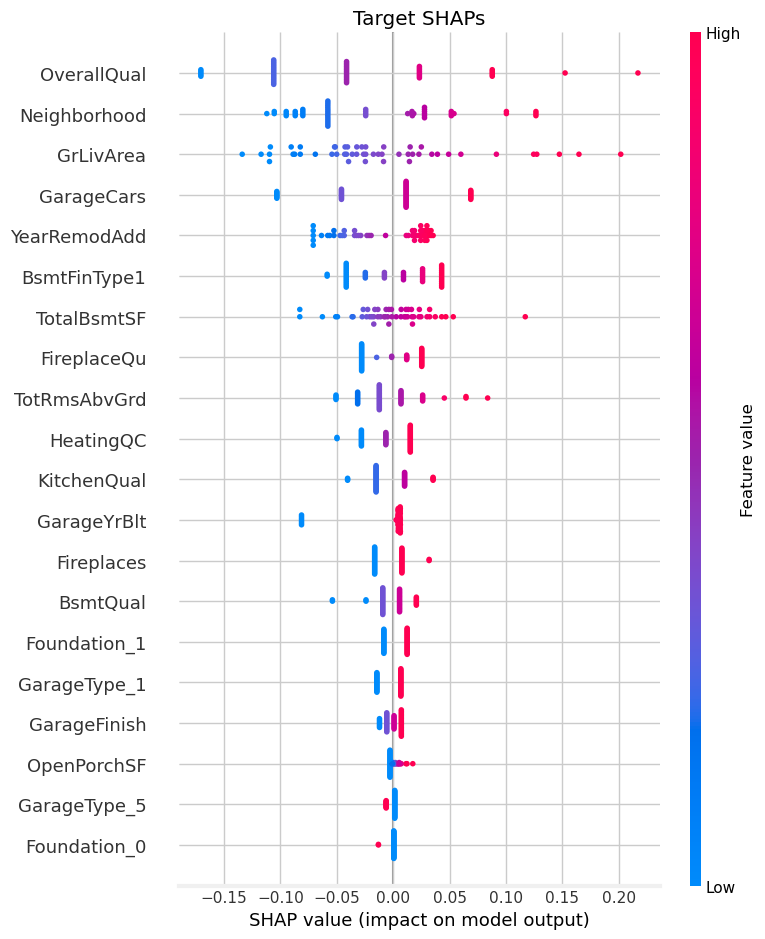

..................................................

Elapsed time: 14.83 minutes
..................................................



Time: 23:43:43
***************************************************************************
lasso_eng , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=lasso_eng with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.000000
R2,0.000000
MAE,0.307830
MSE,0.156362
RMSE,0.395426
MedAE,0.245592
MAPE,0.025594




Regression Report: Validation
..................................................


,Value
Explained Variance,0.000000
R2,-0.008946
MAE,0.317715
MSE,0.169099
RMSE,0.411216
MedAE,0.259211
MAPE,0.026554



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


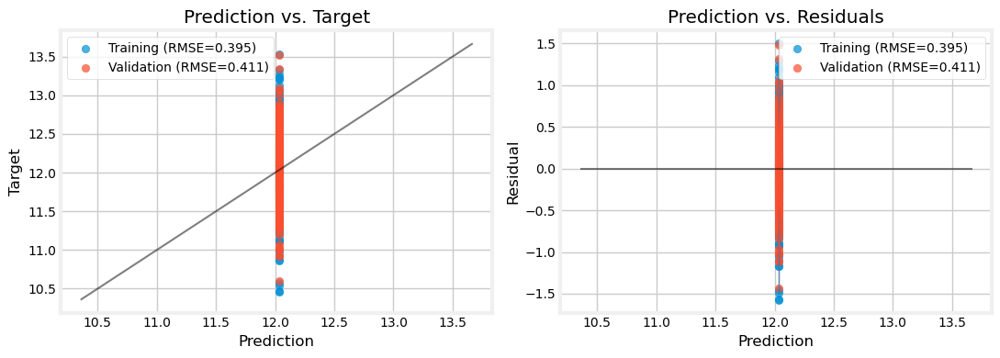



..................................................

Elapsed time: 0.03 minutes
..................................................



Time: 23:43:45
***************************************************************************
lasso_eng , 	CV: True 

***************************************************************************
We will evaluate lasso_eng with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.14406623810831845
		best params: {'model__alpha': 0.0001327616496460627, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.12347701353559809, 'preprocessor__target_encoder__smoothing': 10.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.880581
R2,0.880581
MAE,0.094308
MSE,0.018673
RMSE,0.136648
MedAE,0.072187
MAPE,0.007867




Regression Report: Validation
..................................................


,Value
Explained Variance,0.902097
R2,0.901947
MAE,0.093278
MSE,0.016434
RMSE,0.128194
MedAE,0.070393
MAPE,0.007833



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


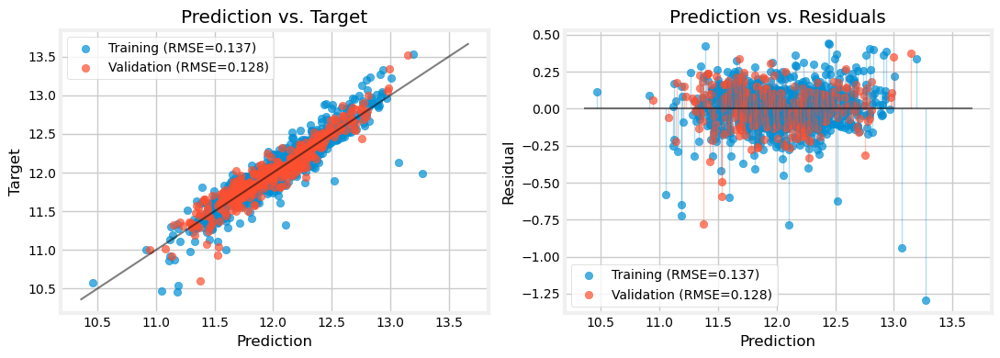



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['TotalSF', 'OverallQualCond', 'Neighborhood', 'AllBaths', 'GarageCars', '1and2FlrSF', '1stFlrSF', 'FullBath', 'TotalBsmtSF', 'FireplaceQu', 'BsmtQual', 'LotFrontage', 'KitchenQual', 'YearBuilt', 'MSSubClass', 'GarageFinish', 'Foundation_2', 'Foundation_0', 'GarageAge', 'GarageType_4', 'YearRemodAdd', 'BathsAbvGr', 'GarageType_0', 'GarageType_3', 'ExterQual', 'AllRooms', 'GarageType_5', 'GarageType_6', 'Foundation_1', 'Foundation_3', 'Foundation_4', 'Foundation_5', 'OverallQual', 'Has_Garage', 'Has_Bsmt', 'HouseAge', 'GarageType_1', 'GarageArea', 'GarageType_2']
The most important features are:

	TotalSF: 0.11306066487666142 +- 0.005543143757785154
	OverallQualCond: 0.08512084710470849 +- 0.004084473822054157
	Neighborhood: 0.058809770032064626 +- 0.002162245642364434
	AllB

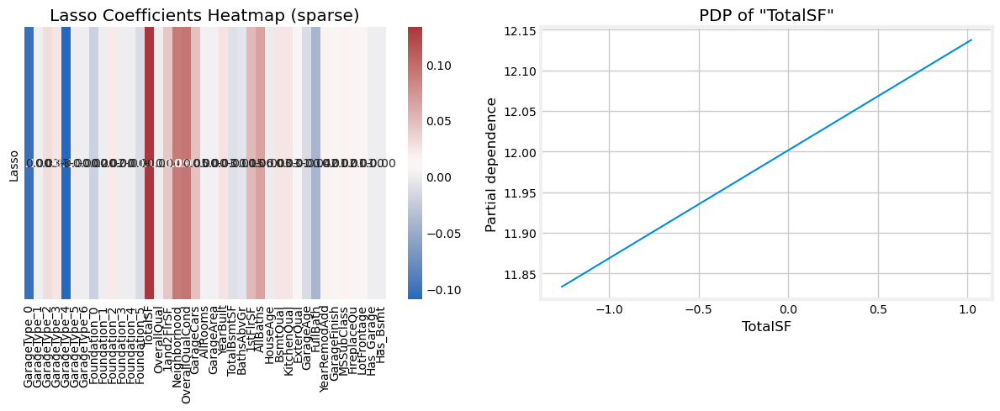

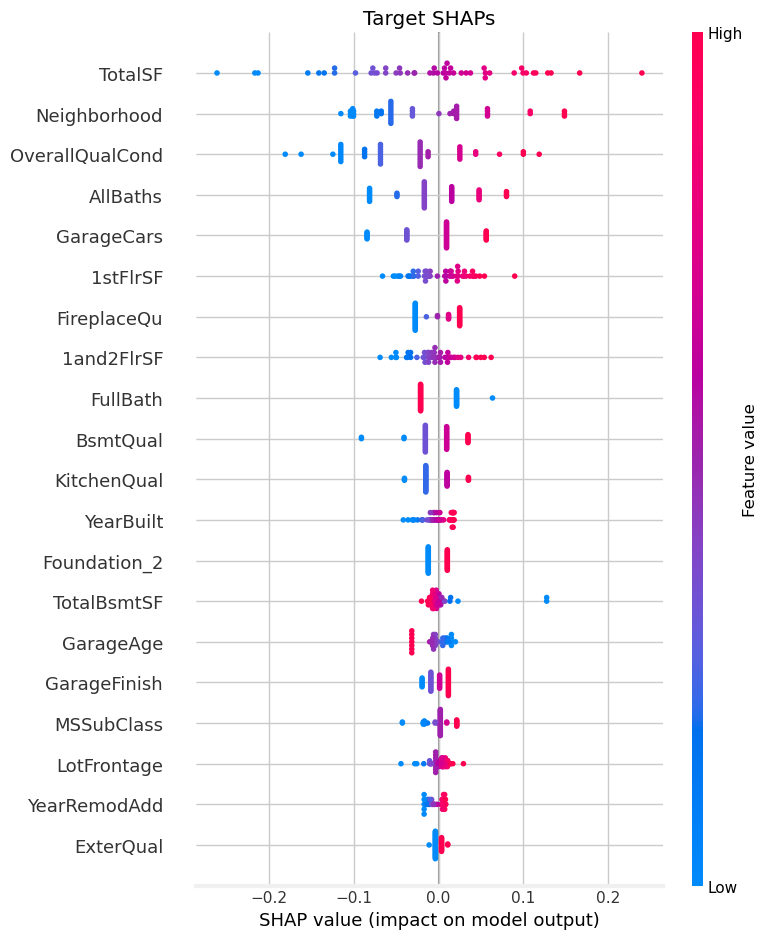

..................................................

Elapsed time: 16.82 minutes
..................................................



Time: 00:00:35
***************************************************************************
lasso_clus , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=lasso_clus with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.000000
R2,0.000000
MAE,0.307830
MSE,0.156362
RMSE,0.395426
MedAE,0.245592
MAPE,0.025594




Regression Report: Validation
..................................................


,Value
Explained Variance,0.000000
R2,-0.008946
MAE,0.317715
MSE,0.169099
RMSE,0.411216
MedAE,0.259211
MAPE,0.026554



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


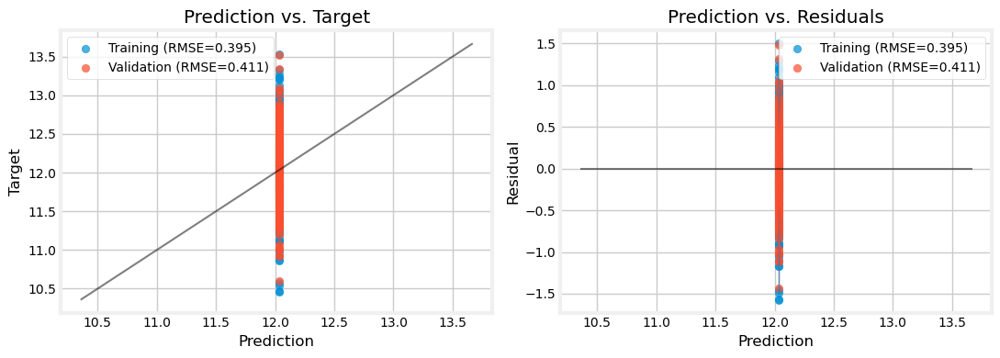



..................................................

Elapsed time: 0.03 minutes
..................................................



Time: 00:00:36
***************************************************************************
lasso_clus , 	CV: True 

***************************************************************************
We will evaluate lasso_clus with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.14367322593024567
		best params: {'model__alpha': 0.0010516440267413685, 'preprocessor__cluster__n_clusters': 5, 'preprocessor__pca__fit_feat_subset': True, 'preprocessor__pca__keep_original_feats': False, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.11611300417471133, 'preprocessor__target_encoder__smoothing': 50.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!



,Value
Explained Variance,0.880047
R2,0.880047
MAE,0.094628
MSE,0.018756
RMSE,0.136953
MedAE,0.070085
MAPE,0.007892




Regression Report: Validation
..................................................


,Value
Explained Variance,0.900517
R2,0.900118
MAE,0.093434
MSE,0.016740
RMSE,0.129384
MedAE,0.069434
MAPE,0.007844



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


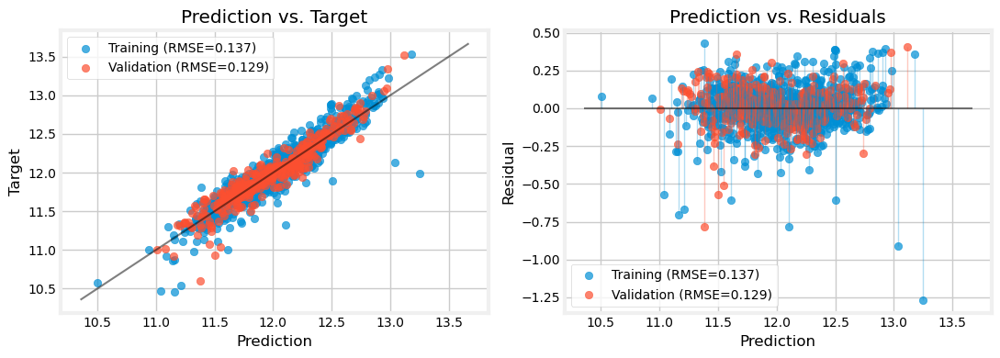



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['pca0', 'pca6', 'pca5', 'pca2', 'AllBaths', 'pca7', 'pca10', 'FireplaceQu', 'pca3', 'GarageCars', 'pca13', 'FullBath', 'pca9', 'KitchenQual', 'BsmtQual', 'GarageFinish', 'OverallQual', 'pca11', 'cluster_2', 'pca4', 'pca1', 'pca8', 'ExterQual', 'GarageType_0', 'GarageType_1', 'GarageType_2', 'GarageType_3', 'GarageType_4', 'GarageType_5', 'GarageType_6', 'cluster_0', 'cluster_1', 'cluster_3', 'cluster_4', 'BathsAbvGr', 'Has_Garage', 'Has_Bsmt', 'pca12']
The most important features are:

	pca0: 1.4440271107798097 +- 0.054982034935328855
	pca6: 0.06077923158154919 +- 0.005311573043111746
	pca5: 0.05279017830439967 +- 0.0050862720214989235
	pca2: 0.04703727275943639 +- 0.005383324792625924
	AllBaths: 0.023563568023842362 +- 0.0024077045033973022
	pca7: 0.02300787664507333 +- 0

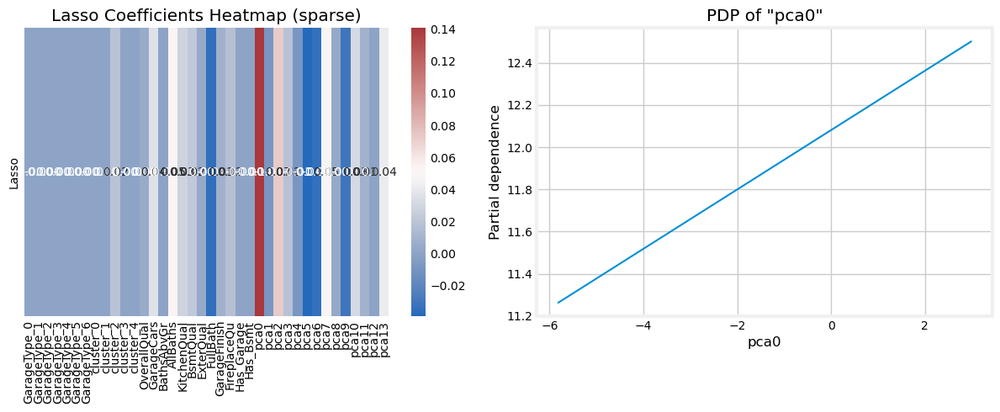

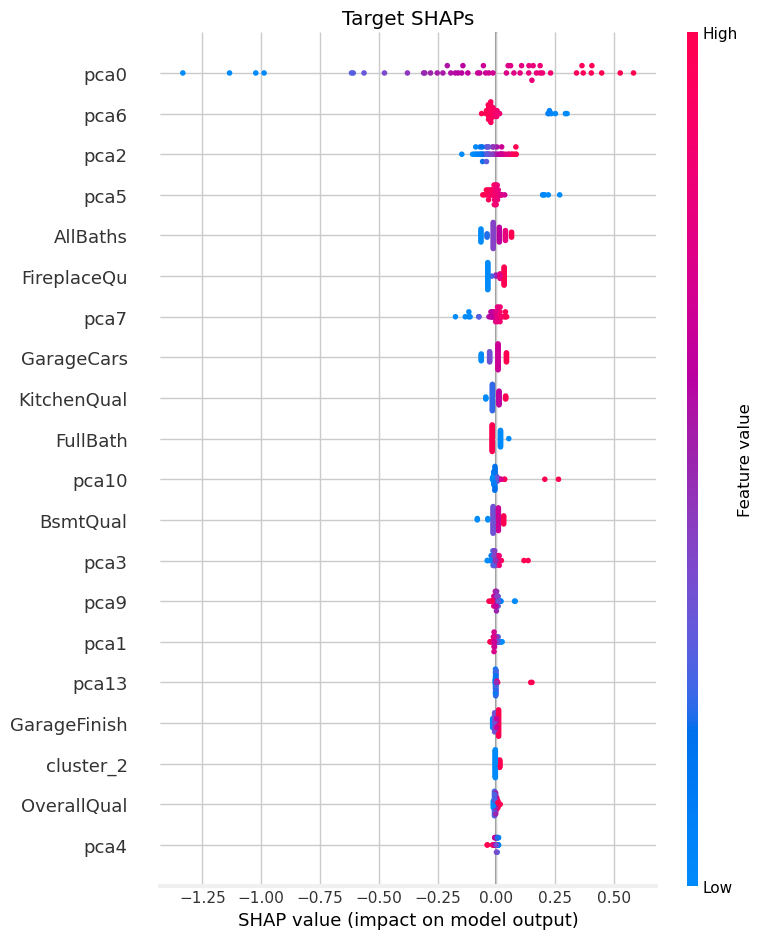

..................................................

Elapsed time: 18.04 minutes
..................................................





In [118]:
model = 'lasso'
redoQ = True

for pp in ['raw', 'eng', 'clus']:
    for cvQ in [False, True]:

        print(time.strftime("Time: %H:%M:%S"))
        start = time.time()

        model_name = model+'_'+pp # full model name

        if redoQ and (model_name in search.keys()):
            del search[model_name]

        print("*"*75)
        print(model_name, ", \tCV:", cvQ, "\n")
        print("*"*75)
        
        # # GridSearchCV
        # model_evaluation(model_name, (X_train, X_val, y_train, y_val),
        #                  perform_cv_randomized=(cvQ, False),
        #                  n_splits=5, n_repeats=3,
        #                  verbose=True, plots=True)

        # RandomizedSearchCV
        model_evaluation(model_name, (X_train, X_val, y_train, y_val),
                         perform_cv_randomized=(cvQ, True),
                         n_splits=5, n_repeats=3,
                         n_iter=1000,
                         verbose=True, plots=True)

        print("\n")

        if cvQ:
            explain_model(model_name, best_cv[model_name]['pipe'], (X_train, X_val, y_train, y_val), tree_idx=0, random_state=0)

        end = time.time()

        print("."*50)
        print(f"\nElapsed time: {(end-start)/60:.2f} minutes")
        print("."*50)

        print("\n\n")

In [119]:
scorecard

,rfr_base_no_cv,dtr_raw_no_cv,dtr_raw_cv,dtr_eng_no_cv,dtr_eng_cv,dtr_clus_no_cv,dtr_clus_cv,rfr_raw_no_cv,rfr_raw_cv,rfr_eng_no_cv,rfr_eng_cv,rfr_clus_no_cv,rfr_clus_cv,xgbr_raw_no_cv,xgbr_raw_cv,xgbr_eng_no_cv,xgbr_eng_cv,xgbr_clus_no_cv,xgbr_clus_cv,linreg_raw_no_cv,linreg_raw_cv,linreg_eng_no_cv,linreg_eng_cv,linreg_clus_no_cv,linreg_clus_cv,lasso_raw_no_cv,lasso_raw_cv,lasso_eng_no_cv,lasso_eng_cv,lasso_clus_no_cv,lasso_clus_cv
R2 Score Train,0.056091,9.297877e-17,0.201295,0.002394,0.186764,0.002394,0.174660,0.056091,0.059486,0.055042,0.059738,0.056760,0.066433,0.004774,0.094879,0.009846,0.088716,0.008072,0.087156,0.099541,0.150483,0.141500,0.135272,0.141334,0.135143,0.195434,0.152514,0.395426,0.136648,0.395426,0.136953
R2 Score Validation,0.891477,7.513521e-01,0.745161,0.756836,0.793272,0.783426,0.774561,0.891477,0.890179,0.888852,0.890617,0.881278,0.880512,0.894659,0.876820,0.876607,0.892419,0.861901,0.876020,0.895123,0.878597,0.892702,0.900085,0.892984,0.902885,0.814858,0.882886,-0.008946,0.901947,-0.008946,0.900118
RMSE Train,0.056091,9.297877e-17,0.201295,0.002394,0.186764,0.002394,0.174660,0.056091,0.059486,0.055042,0.059738,0.056760,0.066433,0.004774,0.094879,0.009846,0.088716,0.008072,0.087156,0.099541,0.150483,0.141500,0.135272,0.141334,0.135143,0.195434,0.152514,0.395426,0.136648,0.395426,0.136953
RMSE Validation,0.134864,2.041404e-01,0.206666,0.201877,0.186139,0.190520,0.194380,0.134864,0.135668,0.136486,0.135398,0.141059,0.141514,0.132873,0.143683,0.143808,0.134278,0.152136,0.144149,0.132579,0.142643,0.134101,0.129406,0.133925,0.127579,0.176152,0.140101,0.411216,0.128194,0.411216,0.129384


#### Engineered Cluster Model: exploration

In the cluster model, checking selected engineering features (from which PCA and clusters are built)

In [120]:
best_cv[model+'_clus']

{'pipe': Pipeline(steps=[('preprocessor',
                  Pipeline(steps=[('cleaning',
                                   Pipeline(steps=[('custom_imputer',
                                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                                             'BsmtQual'],
                                                                                'BsmtExposure': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtFinType2': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtQual': ['BsmtCond',
                                                                                   

In [121]:
best_cv[model+'_clus']['params']

{'model__alpha': 0.0010516440267413685,
 'preprocessor__cluster__n_clusters': 5,
 'preprocessor__pca__fit_feat_subset': True,
 'preprocessor__pca__keep_original_feats': False,
 'preprocessor__selector__best_k': 30,
 'preprocessor__selector__t_thr': 0.11611300417471133,
 'preprocessor__target_encoder__smoothing': 50.0}

In [122]:
best_cv[model+'_clus']['pipe'].steps

[('preprocessor',
  Pipeline(steps=[('cleaning',
                   Pipeline(steps=[('custom_imputer',
                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                             'BsmtQual'],
                                                                'BsmtExposure': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtFinType2': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtQual': ['BsmtCond',
                                                                             'BsmtExposure'],
                                                                'Exterior1st': 'Foundation',
                                                                

In [123]:
best_preproc = best_cv[model+'_clus']['pipe'].steps[0][1] # the best preprocessor
best_feats = best_preproc[:-3] # all the preprocessor steps, except for PCA, KMeans clustering, and OHE
best_feats.transform(X_train)

,TotalSF,OverallQual,1and2FlrSF,Neighborhood,OverallQualCond,AllRooms,GarageCars,GarageArea,TotalBsmtSF,BathsAbvGr,YearBuilt,1stFlrSF,AllBaths,HouseAge,KitchenQual,BsmtQual,ExterQual,GarageAge,YearRemodAdd,FullBath,GarageFinish,MSSubClass,FireplaceQu,LotFrontage,GarageType,Has_Garage,Has_Bsmt
6,0.742068,8,0.312092,0.472509,0.5,0.500000,2,0.502730,1.052674,2.0,0.659574,0.919677,3.0,-1.125091,4,5,4,-1.066979,0.305556,2,2,0.000000,4,0.239984,1,1,1
807,0.367177,5,0.156204,-1.069603,-0.5,0.333333,2,0.170238,0.569246,1.5,-1.063830,-0.048785,3.5,0.472309,4,3,3,0.537697,0.277778,1,2,-0.340399,3,2.518040,1,1,1
955,0.398207,6,0.624807,0.288295,0.1,0.500000,2,0.044102,-0.034421,2.0,-0.574468,-0.240817,2.0,0.296586,3,4,3,0.361174,-1.222222,2,1,-0.746899,0,0.550685,1,1,1
1040,0.398207,5,0.446734,-0.738474,-1.5,0.833333,2,0.014822,0.259462,2.0,-0.340426,1.051686,3.0,0.185008,3,3,3,0.249087,0.166667,2,2,0.073230,3,0.796813,1,1,1
701,-0.170534,7,-0.497959,0.108607,0.0,-0.333333,2,0.170238,0.311677,1.5,-0.085106,0.125459,1.5,0.042657,3,3,3,0.106088,-0.694444,1,1,0.023096,0,0.464671,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,-0.081754,6,-0.177958,0.108607,-0.5,0.166667,2,-0.007457,0.132054,2.0,0.021277,0.439205,2.0,0.014612,3,4,3,0.077916,-0.555556,2,2,0.023096,3,0.376507,1,1,1
905,-0.400741,5,-0.693872,-0.774909,-1.0,-0.166667,1,-0.961984,0.116963,1.0,-0.404255,-0.066626,2.0,0.252972,3,3,3,0.317361,-1.111111,1,2,0.073230,0,0.464671,1,1,1
1096,-0.494922,6,-0.169978,-1.399037,0.7,0.000000,0,-11.052923,-0.751207,1.5,-1.255319,-0.740655,1.5,0.512449,4,3,3,2.173310,0.333333,1,0,-0.182551,0,-0.535329,6,0,1
235,-1.295571,6,-0.853972,-1.118567,-1.7,-0.666667,1,-1.066905,-1.446378,1.5,-0.042553,-1.735090,1.5,0.042657,3,3,3,0.106088,-0.638889,1,1,-0.777253,0,-4.131663,5,1,1


In [124]:
best_preproc

Pipeline(steps=[('cleaning',
                 Pipeline(steps=[('custom_imputer',
                                  CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                           'BsmtQual'],
                                                              'BsmtExposure': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtFinType2': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtQual': ['BsmtCond',
                                                                           'BsmtExposure'],
                                                              'Exterior1st': 'Foundation',
                                                              'Exterior2nd': 'Foundation',
                                                              'GarageArea': ['GarageCars',
                                                                             'GarageQual'],
                                                              'GarageCa...
                 PCAFeature(fit_feat_subset=True, keep_original_feats=False)),
                ('cluster',
                 KMeansFeature(n_clusters=5, scaling_method='robust')),
                ('ohe',
                 Pipeline(steps=[('ohe',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('ohe',
                                                                   OneHotEncoder(dtype=<class 'int'>,
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False),
                                                                   <function ohe_from_subset.<locals>.selector at 0x7b1eeceb1f80>)],
                                                    verbose_feature_names_out=False))]))])

In [125]:
del best_preproc, best_feats

### Model 6: `Ridge`

In [126]:
model = 'ridge'

for pp in ['raw', 'eng', 'clus']:

    model_name = model+'_'+pp # full model name

    preproc_pipe = final_preproc[pp] # preprocessing  pipeline

    pipe[model_name] =\
        Pipeline(steps=[('preprocessor', preproc_pipe),
                        ('model', Ridge(max_iter=10_000,
                                        random_state=0))])

    pipe[model_name+'_no_cv'] =\
        Pipeline(steps=[('preprocessor', preproc_pipe),
                        ('model', Ridge(max_iter=10_000,
                                        random_state=0))])

    # defining the hyperparameter grid
    # basic:
    param_grid[model_name] = {'preprocessor__target_encoder__smoothing':
                                  list(np.arange(10., 60., 10.)),
                              'preprocessor__selector__best_k':
                                  list(range(10, 40, 10)),
                              'preprocessor__selector__t_thr':
                                  uniform(loc=0.1, scale=0.8)
                             }
    # if clustering:
    if pp == 'clus':
        param_grid[model_name]['preprocessor__pca__fit_feat_subset'] =\
                        [True]
        param_grid[model_name]['preprocessor__pca__keep_original_feats'] =\
            [False]
        param_grid[model_name]['preprocessor__cluster__n_clusters'] =\
            list(range(3,7))

    # proper to the model:
    param_grid[model_name]['model__alpha'] =\
        loguniform(1.e-2, 100.)

Time: 00:18:39
***************************************************************************
ridge_raw , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=ridge_raw with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.928087
R2,0.928087
MAE,0.075729
MSE,0.011245
RMSE,0.106040
MedAE,0.058273
MAPE,0.006317




Regression Report: Validation
..................................................


,Value
Explained Variance,0.892801
R2,0.892717
MAE,0.096955
MSE,0.017981
RMSE,0.134092
MedAE,0.068468
MAPE,0.008150



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


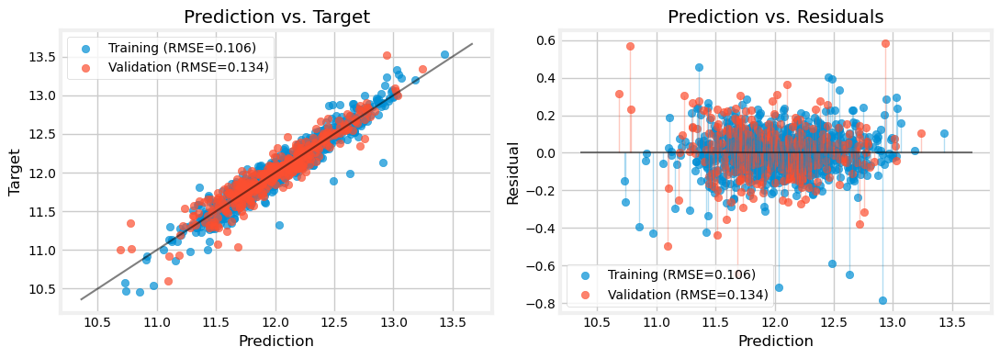



..................................................

Elapsed time: 0.04 minutes
..................................................



Time: 00:18:42
***************************************************************************
ridge_raw , 	CV: True 

***************************************************************************
We will evaluate ridge_raw with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.1565614964310221
		best params: {'model__alpha': 1.3699319674292496, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.6949141791018161, 'preprocessor__target_encoder__smoothing': 50.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.854040
R2,0.854040
MAE,0.105798
MSE,0.022823
RMSE,0.151072
MedAE,0.079330
MAPE,0.008840




Regression Report: Validation
..................................................


,Value
Explained Variance,0.880573
R2,0.880488
MAE,0.102463
MSE,0.020030
RMSE,0.141528
MedAE,0.075521
MAPE,0.008618



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


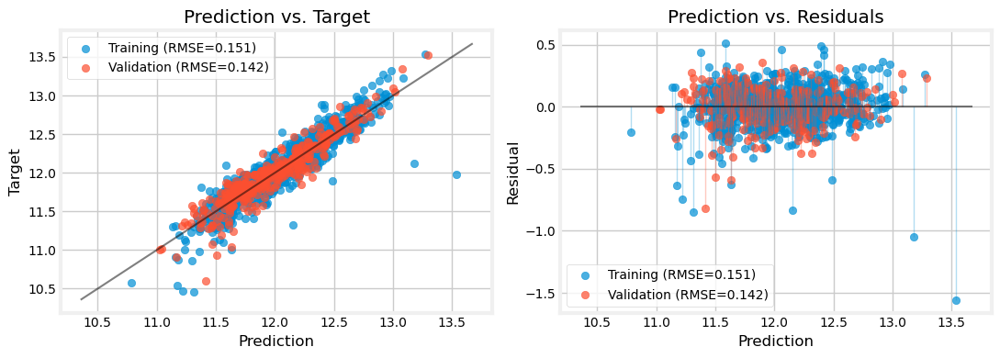



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['OverallQual', 'Neighborhood', 'GrLivArea', 'GarageCars', 'BsmtFinType1', 'TotalBsmtSF', 'YearRemodAdd', 'GarageType_1', 'TotRmsAbvGrd', 'HeatingQC', 'YearBuilt', 'KitchenQual', 'Foundation_1', 'Fireplaces', 'GarageType_3', 'BsmtQual', 'Foundation_0', 'FireplaceQu', 'GarageType_6', 'GarageType_5', 'GarageYrBlt', 'GarageFinish', 'Foundation_3', 'GarageType_4', 'ExterQual', 'GarageType_0', 'Foundation_4', 'Foundation_2', 'Foundation_5', 'OpenPorchSF', 'FullBath', 'LotFrontage', 'GarageType_2']
The most important features are:

	OverallQual: 0.10137171345918972 +- 0.004576639784431891
	Neighborhood: 0.07523352641977847 +- 0.005427671121852718
	GrLivArea: 0.06782786888186294 +- 0.005221134326887677
	GarageCars: 0.032423701067168034 +- 0.00420372817908637
	BsmtFinType1: 0.02020

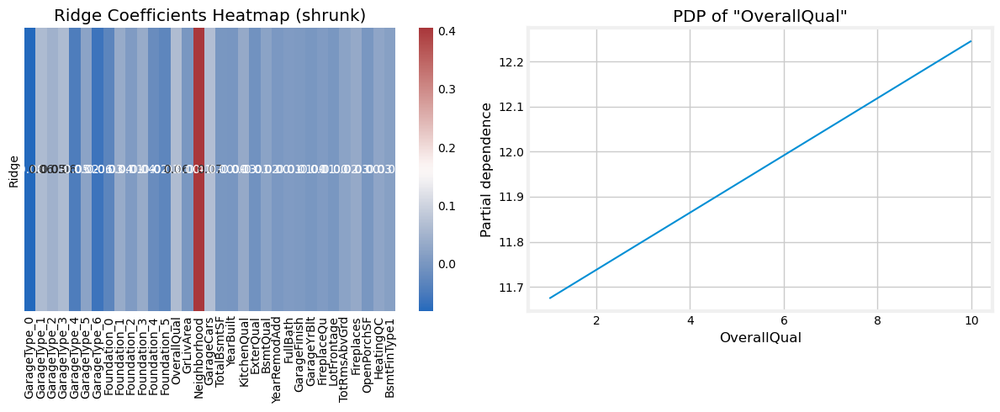

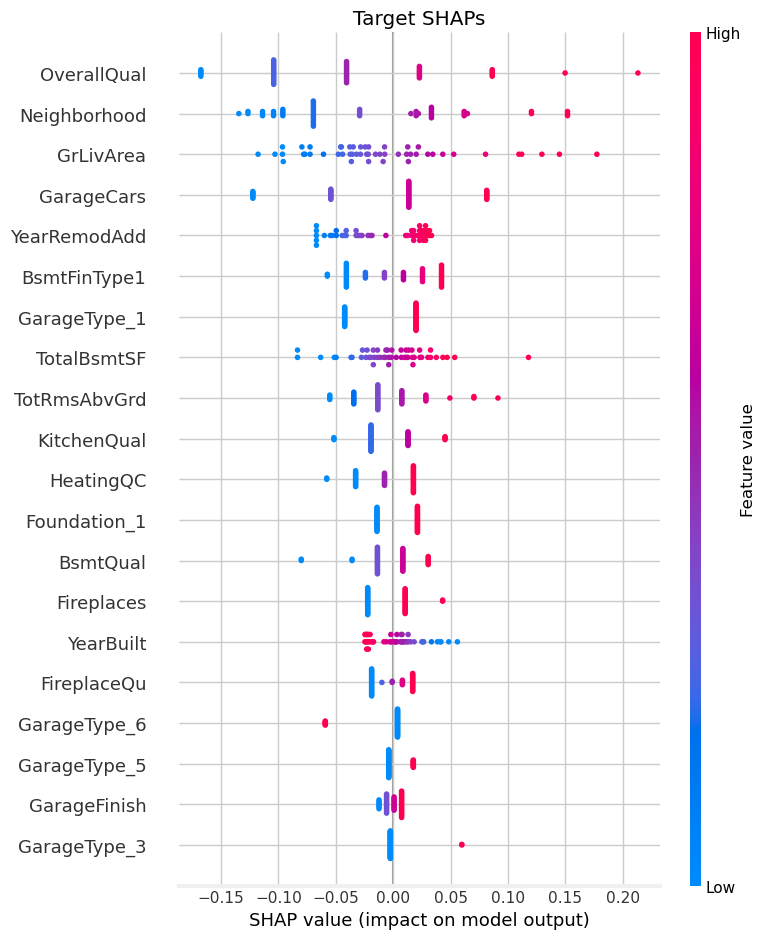

..................................................

Elapsed time: 15.00 minutes
..................................................



Time: 00:33:42
***************************************************************************
ridge_eng , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=ridge_eng with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.871734
R2,0.871734
MAE,0.100317
MSE,0.020056
RMSE,0.141619
MedAE,0.076660
MAPE,0.008373




Regression Report: Validation
..................................................


,Value
Explained Variance,0.893483
R2,0.893122
MAE,0.098435
MSE,0.017913
RMSE,0.133839
MedAE,0.075866
MAPE,0.008267



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


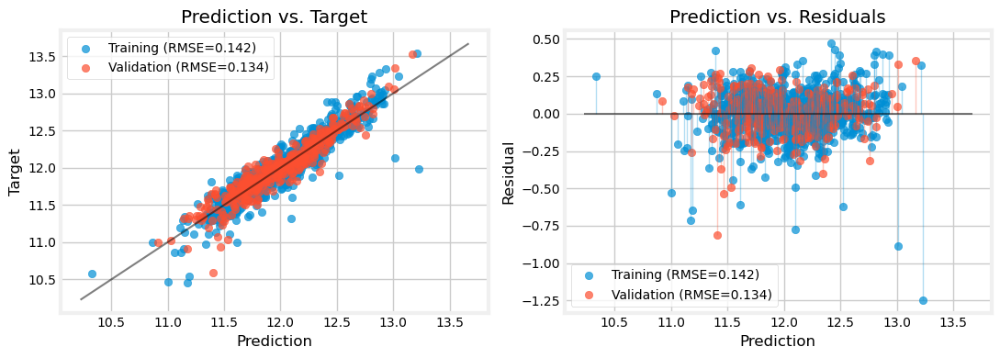



..................................................

Elapsed time: 0.03 minutes
..................................................



Time: 00:33:44
***************************************************************************
ridge_eng , 	CV: True 

***************************************************************************
We will evaluate ridge_eng with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.1435045816324432
		best params: {'model__alpha': 39.38228195938433, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.12326467983816665, 'preprocessor__target_encoder__smoothing': 50.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.880026
R2,0.880026
MAE,0.094724
MSE,0.018759
RMSE,0.136965
MedAE,0.070461
MAPE,0.007899




Regression Report: Validation
..................................................


,Value
Explained Variance,0.900703
R2,0.900468
MAE,0.093404
MSE,0.016682
RMSE,0.129157
MedAE,0.069200
MAPE,0.007842



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


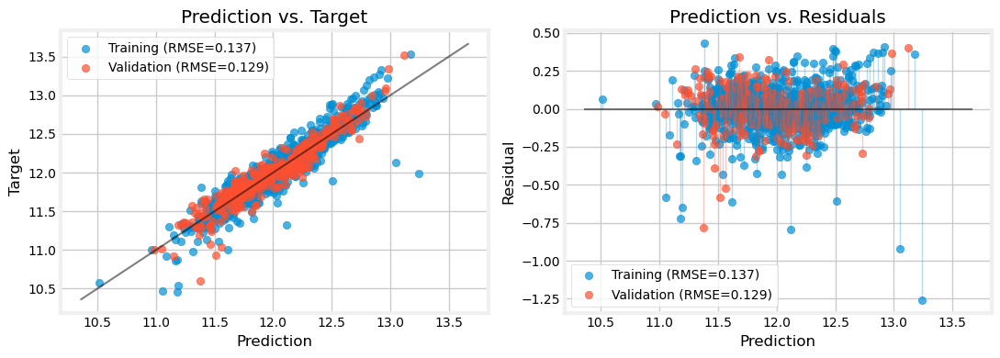



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['OverallQualCond', 'Neighborhood', 'TotalSF', 'AllBaths', '1and2FlrSF', '1stFlrSF', 'GarageCars', 'FireplaceQu', 'OverallQual', 'KitchenQual', 'BsmtQual', 'LotFrontage', 'MSSubClass', 'FullBath', 'AllRooms', 'GarageArea', 'YearBuilt', 'GarageFinish', 'YearRemodAdd', 'Foundation_0', 'Foundation_2', 'HouseAge', 'ExterQual', 'BathsAbvGr', 'Has_Bsmt', 'TotalBsmtSF', 'GarageType_3', 'Foundation_1', 'GarageType_4', 'Has_Garage', 'GarageType_6', 'Foundation_3', 'Foundation_4', 'Foundation_5', 'GarageType_0', 'GarageType_5', 'GarageType_1', 'GarageAge', 'GarageType_2']
The most important features are:

	OverallQualCond: 0.06717311630260019 +- 0.003726563450895962
	Neighborhood: 0.057709690910148395 +- 0.002880270234059464
	TotalSF: 0.04230720174430387 +- 0.002958629101060049
	AllB

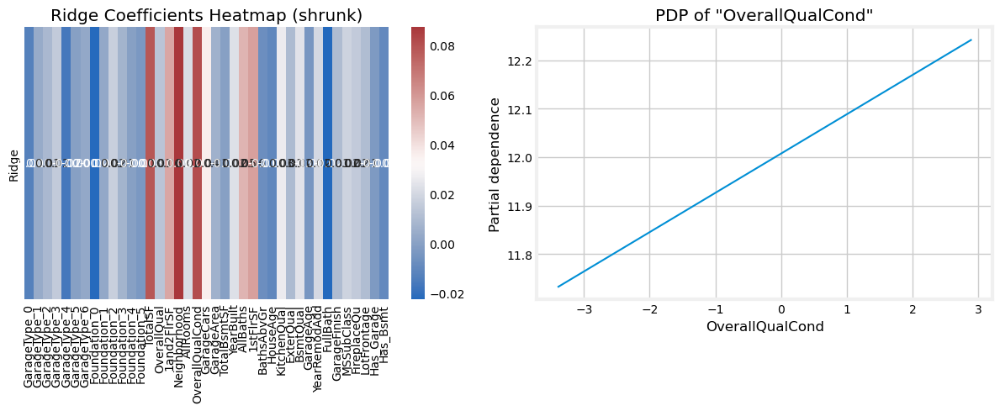

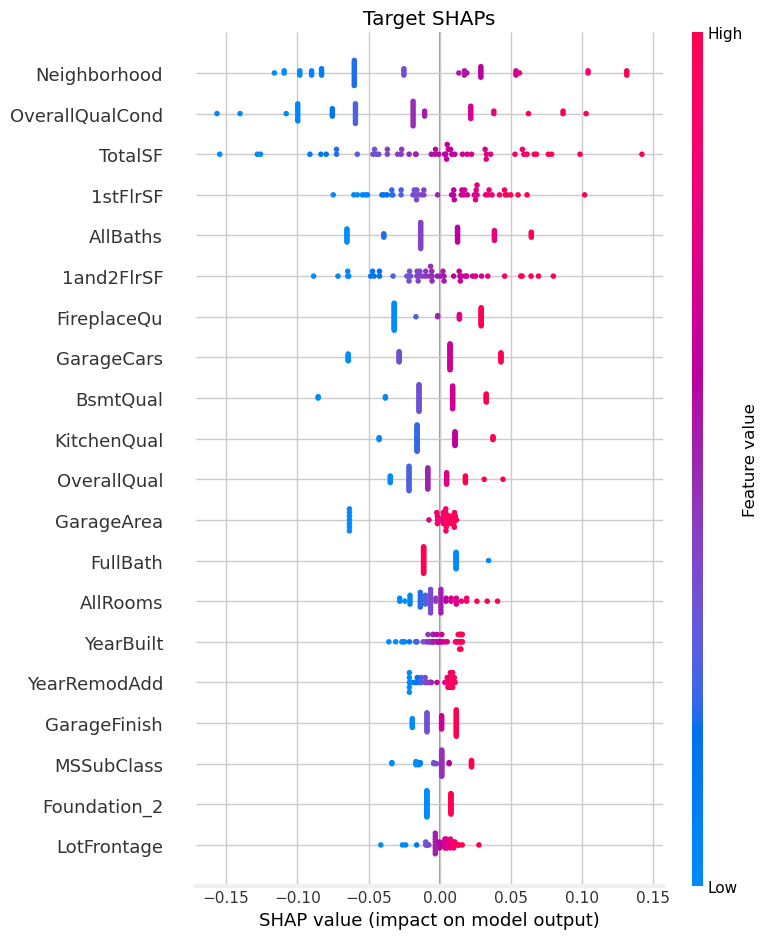

..................................................

Elapsed time: 17.41 minutes
..................................................



Time: 00:51:08
***************************************************************************
ridge_clus , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=ridge_clus with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.872145
R2,0.872145
MAE,0.100234
MSE,0.019992
RMSE,0.141392
MedAE,0.077445
MAPE,0.008367




Regression Report: Validation
..................................................


,Value
Explained Variance,0.893609
R2,0.893256
MAE,0.098514
MSE,0.017890
RMSE,0.133755
MedAE,0.075381
MAPE,0.008275



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


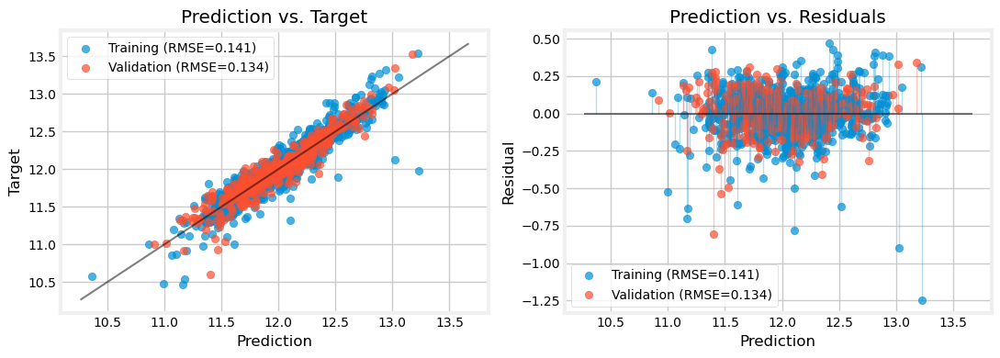



..................................................

Elapsed time: 0.03 minutes
..................................................



Time: 00:51:10
***************************************************************************
ridge_clus , 	CV: True 

***************************************************************************
We will evaluate ridge_clus with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.14357427165898468
		best params: {'model__alpha': 0.06568935650584284, 'preprocessor__cluster__n_clusters': 5, 'preprocessor__pca__fit_feat_subset': True, 'preprocessor__pca__keep_original_feats': False, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.11611300417471133, 'preprocessor__target_encoder__smoothing': 50.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


R

,Value
Explained Variance,0.883705
R2,0.883705
MAE,0.093327
MSE,0.018184
RMSE,0.134849
MedAE,0.069641
MAPE,0.007786




Regression Report: Validation
..................................................


,Value
Explained Variance,0.903879
R2,0.903510
MAE,0.092404
MSE,0.016172
RMSE,0.127168
MedAE,0.069172
MAPE,0.007757



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


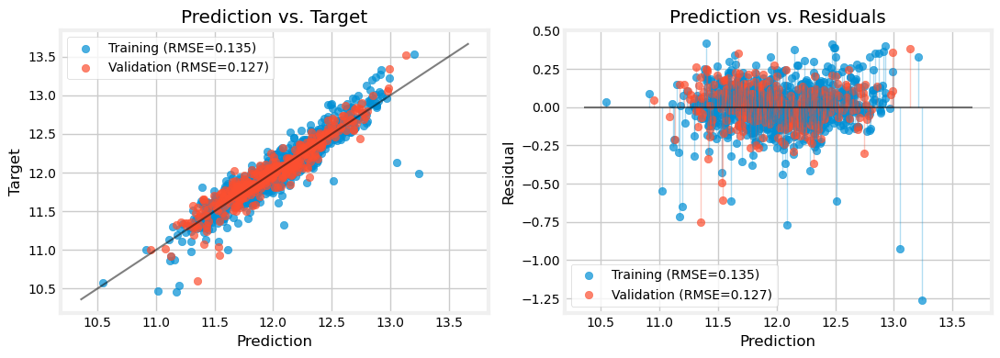



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['pca0', 'pca5', 'pca6', 'pca2', 'AllBaths', 'pca7', 'GarageCars', 'FireplaceQu', 'GarageType_5', 'cluster_0', 'pca9', 'Has_Bsmt', 'cluster_1', 'FullBath', 'pca3', 'cluster_2', 'BsmtQual', 'KitchenQual', 'Foundation_2', 'pca11', 'Foundation_1', 'GarageFinish', 'pca4', 'pca13', 'Foundation_0', 'BathsAbvGr', 'GarageType_3', 'Foundation_3', 'cluster_3', 'GarageType_6', 'Has_Garage', 'GarageType_0', 'pca10', 'pca8', 'GarageType_1', 'GarageType_4', 'Foundation_5', 'OverallQual', 'Foundation_4', 'cluster_4', 'ExterQual', 'pca12', 'pca1', 'GarageType_2']
The most important features are:

	pca0: 1.375005959312913 +- 0.05337862526300391
	pca5: 0.0776686920190175 +- 0.0062359600770243925
	pca6: 0.07283286376308014 +- 0.006981417259623469
	pca2: 0.057428507287540634 +- 0.0068024094064

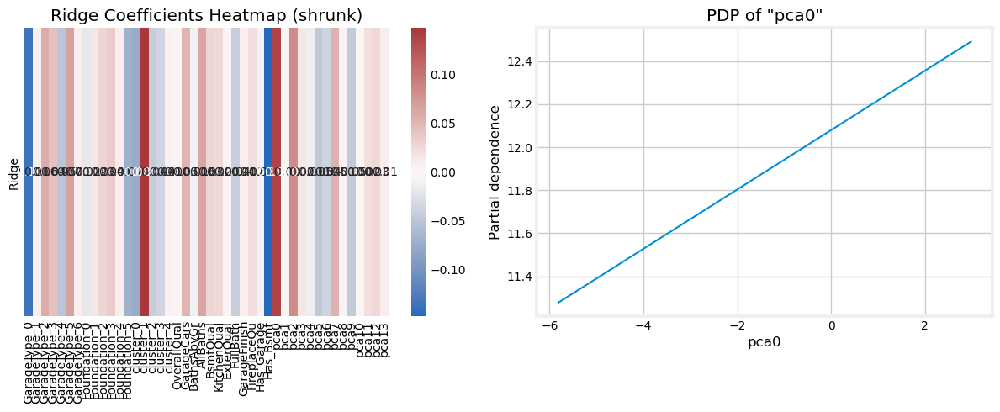

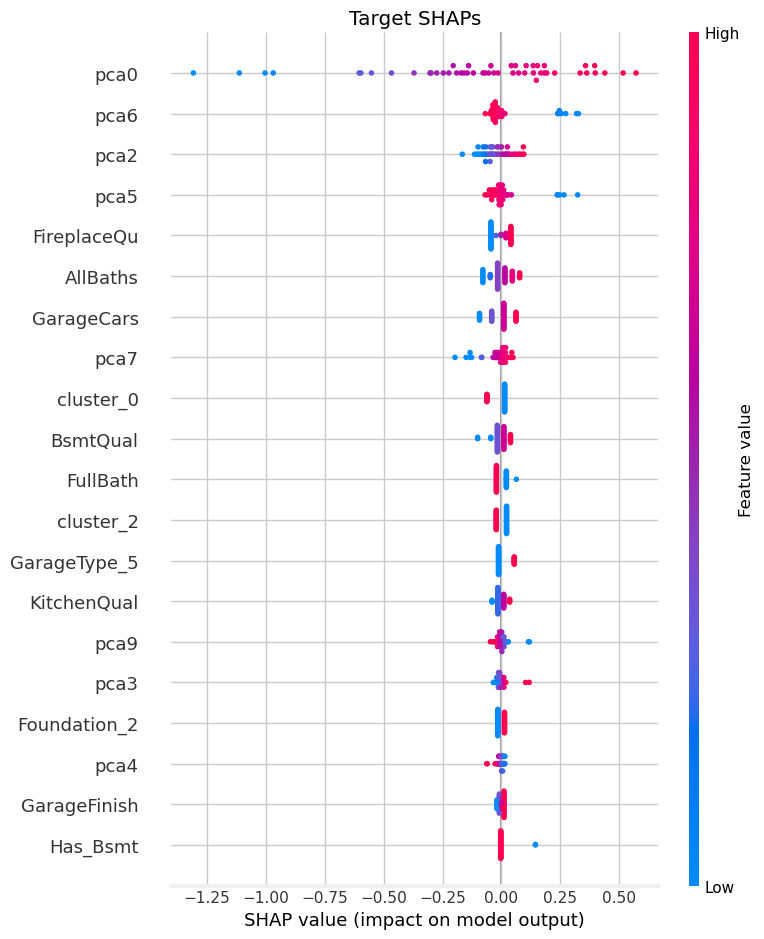

..................................................

Elapsed time: 18.06 minutes
..................................................





In [127]:
model = 'ridge'
redoQ = True

for pp in ['raw', 'eng', 'clus']:
    for cvQ in [False, True]:

        print(time.strftime("Time: %H:%M:%S"))
        start = time.time()

        model_name = model+'_'+pp # full model name

        if redoQ and (model_name in search.keys()):
            del search[model_name]

        print("*"*75)
        print(model_name, ", \tCV:", cvQ, "\n")
        print("*"*75)
        
        # # GridSearchCV
        # model_evaluation(model_name, (X_train, X_val, y_train, y_val),
        #                  perform_cv_randomized=(cvQ, False),
        #                  n_splits=5, n_repeats=3,
        #                  verbose=True, plots=True)

        # RandomizedSearchCV
        model_evaluation(model_name, (X_train, X_val, y_train, y_val),
                         perform_cv_randomized=(cvQ, True),
                         n_splits=5, n_repeats=3,
                         n_iter=1000,
                         verbose=True, plots=True)

        print("\n")

        if cvQ:
            explain_model(model_name, best_cv[model_name]['pipe'], (X_train, X_val, y_train, y_val), tree_idx=0, random_state=0)

        end = time.time()

        print("."*50)
        print(f"\nElapsed time: {(end-start)/60:.2f} minutes")
        print("."*50)

        print("\n\n")

In [128]:
scorecard

,rfr_base_no_cv,dtr_raw_no_cv,dtr_raw_cv,dtr_eng_no_cv,dtr_eng_cv,dtr_clus_no_cv,dtr_clus_cv,rfr_raw_no_cv,rfr_raw_cv,rfr_eng_no_cv,rfr_eng_cv,rfr_clus_no_cv,rfr_clus_cv,xgbr_raw_no_cv,xgbr_raw_cv,xgbr_eng_no_cv,xgbr_eng_cv,xgbr_clus_no_cv,xgbr_clus_cv,linreg_raw_no_cv,linreg_raw_cv,linreg_eng_no_cv,linreg_eng_cv,linreg_clus_no_cv,linreg_clus_cv,lasso_raw_no_cv,lasso_raw_cv,lasso_eng_no_cv,lasso_eng_cv,lasso_clus_no_cv,lasso_clus_cv,ridge_raw_no_cv,ridge_raw_cv,ridge_eng_no_cv,ridge_eng_cv,ridge_clus_no_cv,ridge_clus_cv
R2 Score Train,0.056091,9.297877e-17,0.201295,0.002394,0.186764,0.002394,0.174660,0.056091,0.059486,0.055042,0.059738,0.056760,0.066433,0.004774,0.094879,0.009846,0.088716,0.008072,0.087156,0.099541,0.150483,0.141500,0.135272,0.141334,0.135143,0.195434,0.152514,0.395426,0.136648,0.395426,0.136953,0.106040,0.151072,0.141619,0.136965,0.141392,0.134849
R2 Score Validation,0.891477,7.513521e-01,0.745161,0.756836,0.793272,0.783426,0.774561,0.891477,0.890179,0.888852,0.890617,0.881278,0.880512,0.894659,0.876820,0.876607,0.892419,0.861901,0.876020,0.895123,0.878597,0.892702,0.900085,0.892984,0.902885,0.814858,0.882886,-0.008946,0.901947,-0.008946,0.900118,0.892717,0.880488,0.893122,0.900468,0.893256,0.903510
RMSE Train,0.056091,9.297877e-17,0.201295,0.002394,0.186764,0.002394,0.174660,0.056091,0.059486,0.055042,0.059738,0.056760,0.066433,0.004774,0.094879,0.009846,0.088716,0.008072,0.087156,0.099541,0.150483,0.141500,0.135272,0.141334,0.135143,0.195434,0.152514,0.395426,0.136648,0.395426,0.136953,0.106040,0.151072,0.141619,0.136965,0.141392,0.134849
RMSE Validation,0.134864,2.041404e-01,0.206666,0.201877,0.186139,0.190520,0.194380,0.134864,0.135668,0.136486,0.135398,0.141059,0.141514,0.132873,0.143683,0.143808,0.134278,0.152136,0.144149,0.132579,0.142643,0.134101,0.129406,0.133925,0.127579,0.176152,0.140101,0.411216,0.128194,0.411216,0.129384,0.134092,0.141528,0.133839,0.129157,0.133755,0.127168


#### Engineered Cluster Model: exploration

In the cluster model, checking selected engineering features (from which PCA and clusters are built)

In [129]:
best_cv[model+'_clus']

{'pipe': Pipeline(steps=[('preprocessor',
                  Pipeline(steps=[('cleaning',
                                   Pipeline(steps=[('custom_imputer',
                                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                                             'BsmtQual'],
                                                                                'BsmtExposure': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtFinType2': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtQual': ['BsmtCond',
                                                                                   

In [130]:
best_cv[model+'_clus']['params']

{'model__alpha': 0.06568935650584284,
 'preprocessor__cluster__n_clusters': 5,
 'preprocessor__pca__fit_feat_subset': True,
 'preprocessor__pca__keep_original_feats': False,
 'preprocessor__selector__best_k': 30,
 'preprocessor__selector__t_thr': 0.11611300417471133,
 'preprocessor__target_encoder__smoothing': 50.0}

In [131]:
best_cv[model+'_clus']['pipe'].steps

[('preprocessor',
  Pipeline(steps=[('cleaning',
                   Pipeline(steps=[('custom_imputer',
                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                             'BsmtQual'],
                                                                'BsmtExposure': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtFinType2': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtQual': ['BsmtCond',
                                                                             'BsmtExposure'],
                                                                'Exterior1st': 'Foundation',
                                                                

In [132]:
best_preproc = best_cv[model+'_clus']['pipe'].steps[0][1] # the best preprocessor
best_feats = best_preproc[:-3] # all the preprocessor steps, except for PCA, KMeans clustering, and OHE
best_feats.transform(X_train)

,TotalSF,OverallQual,1and2FlrSF,Neighborhood,AllRooms,OverallQualCond,GarageCars,GarageArea,TotalBsmtSF,YearBuilt,BathsAbvGr,AllBaths,1stFlrSF,HouseAge,BsmtQual,KitchenQual,ExterQual,GarageAge,YearRemodAdd,FullBath,GarageFinish,MSSubClass,FireplaceQu,LotFrontage,GarageType,Foundation,Has_Garage,Has_Bsmt
6,0.742068,8,0.312092,0.472509,0.500000,0.5,2,0.502730,1.052674,0.659574,2.0,3.0,0.919677,-1.125091,5,4,4,-1.066979,0.305556,2,2,0.000000,4,0.239984,1,2,1,1
807,0.367177,5,0.156204,-1.069603,0.333333,-0.5,2,0.170238,0.569246,-1.063830,1.5,3.5,-0.048785,0.472309,3,4,3,0.537697,0.277778,1,2,-0.340399,3,2.518040,1,1,1,1
955,0.398207,6,0.624807,0.288295,0.500000,0.1,2,0.044102,-0.034421,-0.574468,2.0,2.0,-0.240817,0.296586,4,3,3,0.361174,-1.222222,2,1,-0.746899,0,0.550685,1,1,1,1
1040,0.398207,5,0.446734,-0.738474,0.833333,-1.5,2,0.014822,0.259462,-0.340426,2.0,3.0,1.051686,0.185008,3,3,3,0.249087,0.166667,2,2,0.073230,3,0.796813,1,1,1,1
701,-0.170534,7,-0.497959,0.108607,-0.333333,0.0,2,0.170238,0.311677,-0.085106,1.5,1.5,0.125459,0.042657,3,3,3,0.106088,-0.694444,1,1,0.023096,0,0.464671,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,-0.081754,6,-0.177958,0.108607,0.166667,-0.5,2,-0.007457,0.132054,0.021277,2.0,2.0,0.439205,0.014612,4,3,3,0.077916,-0.555556,2,2,0.023096,3,0.376507,1,1,1,1
905,-0.400741,5,-0.693872,-0.774909,-0.166667,-1.0,1,-0.961984,0.116963,-0.404255,1.0,2.0,-0.066626,0.252972,3,3,3,0.317361,-1.111111,1,2,0.073230,0,0.464671,1,1,1,1
1096,-0.494922,6,-0.169978,-1.399037,0.000000,0.7,0,-11.052923,-0.751207,-1.255319,1.5,1.5,-0.740655,0.512449,3,4,3,2.173310,0.333333,1,0,-0.182551,0,-0.535329,6,2,0,1
235,-1.295571,6,-0.853972,-1.118567,-0.666667,-1.7,1,-1.066905,-1.446378,-0.042553,1.5,1.5,-1.735090,0.042657,3,3,3,0.106088,-0.638889,1,1,-0.777253,0,-4.131663,5,1,1,1


In [133]:
best_preproc

Pipeline(steps=[('cleaning',
                 Pipeline(steps=[('custom_imputer',
                                  CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                           'BsmtQual'],
                                                              'BsmtExposure': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtFinType2': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtQual': ['BsmtCond',
                                                                           'BsmtExposure'],
                                                              'Exterior1st': 'Foundation',
                                                              'Exterior2nd': 'Foundation',
                                                              'GarageArea': ['GarageCars',
                                                                             'GarageQual'],
                                                              'GarageCa...
                 PCAFeature(fit_feat_subset=True, keep_original_feats=False)),
                ('cluster',
                 KMeansFeature(n_clusters=5, scaling_method='robust')),
                ('ohe',
                 Pipeline(steps=[('ohe',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('ohe',
                                                                   OneHotEncoder(dtype=<class 'int'>,
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False),
                                                                   <function ohe_from_subset.<locals>.selector at 0x7b1eeceb1f80>)],
                                                    verbose_feature_names_out=False))]))])

In [134]:
del best_preproc, best_feats

### Model 7: `KNeighborsRegressor`

In [135]:
model = 'knn'

for pp in ['raw', 'eng', 'clus']:

    model_name = model+'_'+pp # full model name

    preproc_pipe = final_preproc[pp] # preprocessing  pipeline

    pipe[model_name] = Pipeline(steps=[('preprocessor', preproc_pipe),
                                       ('model', KNeighborsRegressor())])

    pipe[model_name+'_no_cv'] = Pipeline(steps=[('preprocessor', preproc_pipe),
                                       ('model', KNeighborsRegressor())])

    # defining the hyperparameter grid
    # basic:
    param_grid[model_name] = {'preprocessor__target_encoder__smoothing':
                                  list(np.arange(10., 60., 10.)),
                              'preprocessor__selector__best_k':
                                  list(range(10, 40, 10)),
                              'preprocessor__selector__t_thr':
                                  uniform(loc=0.1, scale=0.8)
                             }
    # if clustering:
    if pp == 'clus':
        param_grid[model_name]['preprocessor__pca__fit_feat_subset'] =\
                        [True]
        param_grid[model_name]['preprocessor__pca__keep_original_feats'] =\
            [False]
        param_grid[model_name]['preprocessor__cluster__n_clusters'] =\
            list(range(3,7))

    # proper to the model:
    param_grid[model_name]['model__n_neighbors'] = list(range(3, 11))
    param_grid[model_name]['model__weights'] = ['uniform', 'distance']
    param_grid[model_name]['model__algorithm'] =\
        ['auto', 'ball_tree', 'kd_tree', 'brute']
    param_grid[model_name]['model__leaf_size'] =\
        [5*i for i in range(1, 4)]
    param_grid[model_name]['model__p'] = [1, 2]

Time: 01:09:14
***************************************************************************
knn_raw , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=knn_raw with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.778874
R2,0.778377
MAE,0.137909
MSE,0.034653
RMSE,0.186154
MedAE,0.102666
MAPE,0.011490




Regression Report: Validation
..................................................


,Value
Explained Variance,0.632904
R2,0.632831
MAE,0.176621
MSE,0.061537
RMSE,0.248067
MedAE,0.134285
MAPE,0.014799



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


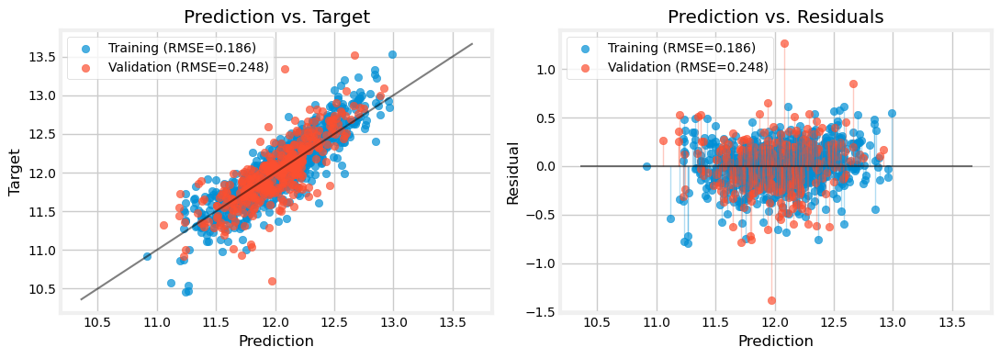



..................................................

Elapsed time: 0.03 minutes
..................................................



Time: 01:09:15
***************************************************************************
knn_raw , 	CV: True 

***************************************************************************
We will evaluate knn_raw with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.18854777197442943
		best params: {'model__algorithm': 'brute', 'model__leaf_size': 10, 'model__n_neighbors': 10, 'model__p': 1, 'model__weights': 'distance', 'preprocessor__selector__best_k': 20, 'preprocessor__selector__t_thr': 0.3113634113793382, 'preprocessor__target_encoder__smoothing': 30.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..........................

,Value
Explained Variance,0.999972
R2,0.999972
MAE,0.000151
MSE,0.000004
RMSE,0.002095
MedAE,0.000000
MAPE,0.000013




Regression Report: Validation
..................................................


,Value
Explained Variance,0.774922
R2,0.772192
MAE,0.137401
MSE,0.038180
RMSE,0.195398
MedAE,0.097266
MAPE,0.011564



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


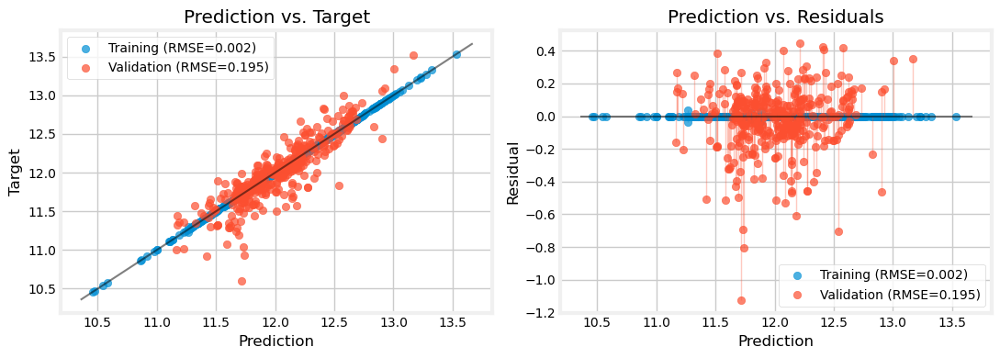



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['GrLivArea', 'TotalBsmtSF', 'GarageYrBlt', 'GarageArea', 'YearBuilt', 'YearRemodAdd', 'OverallQual', 'FireplaceQu', 'GarageFinish', 'Neighborhood', 'KitchenQual', 'BsmtQual', 'GarageCars', 'ExterQual', 'MSSubClass', 'GarageType_4', 'Foundation_5', 'GarageType_0', 'Foundation_4', 'GarageType_1', 'GarageType_2', 'Foundation_1', 'GarageType_3', 'Foundation_3', 'GarageType_6', 'Foundation_0', 'FullBath', 'Foundation_2', 'GarageType_5', 'TotRmsAbvGrd']
The most important features are:

	GrLivArea: 0.3804646290624813 +- 0.011936737706265311
	TotalBsmtSF: 0.16782168522459315 +- 0.010134379563871407
	GarageYrBlt: 0.10632878791489461 +- 0.015329394466639926
	GarageArea: 0.04259496415506618 +- 0.010218868354938715
	YearBuilt: 0.018455394609827435 +- 0.0024881544692259747
	YearRemodA

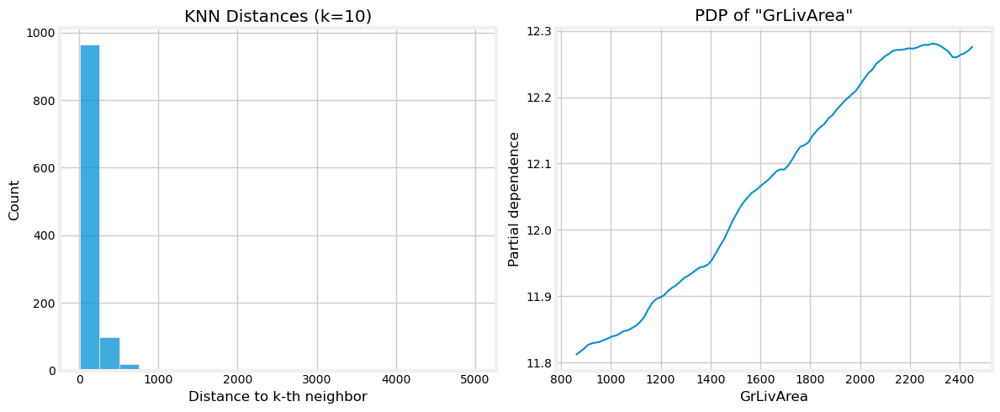

  0%|          | 0/50 [00:00<?, ?it/s]

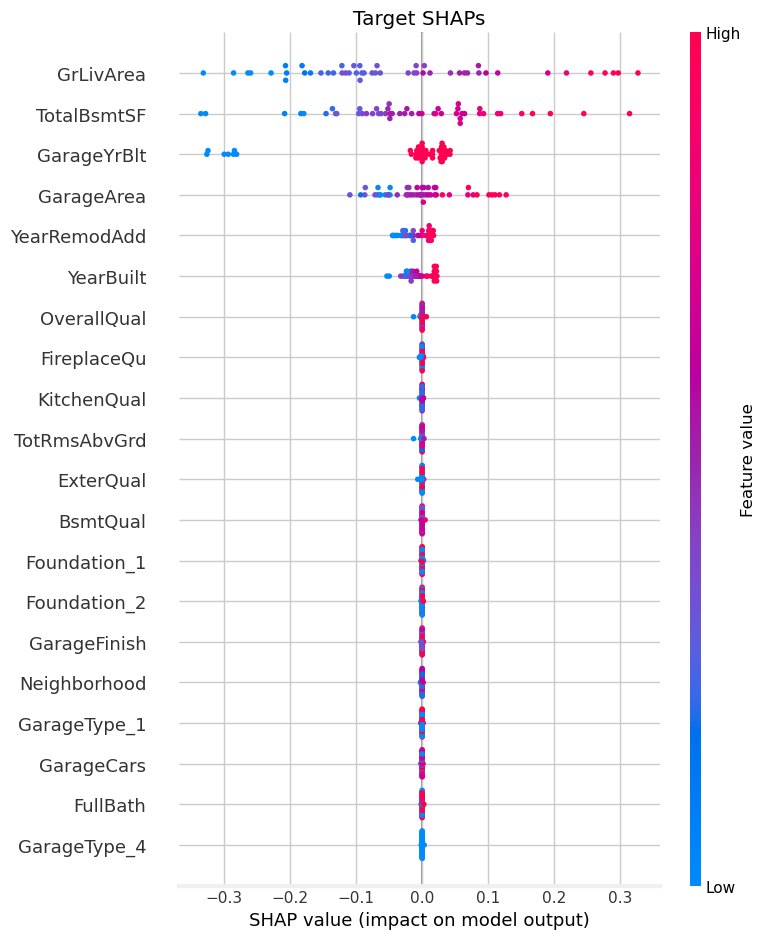

..................................................

Elapsed time: 14.87 minutes
..................................................



Time: 01:24:07
***************************************************************************
knn_eng , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=knn_eng with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.891635
R2,0.891385
MAE,0.091408
MSE,0.016983
RMSE,0.130320
MedAE,0.061615
MAPE,0.007622




Regression Report: Validation
..................................................


,Value
Explained Variance,0.855089
R2,0.855047
MAE,0.108727
MSE,0.024294
RMSE,0.155866
MedAE,0.073597
MAPE,0.009164



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


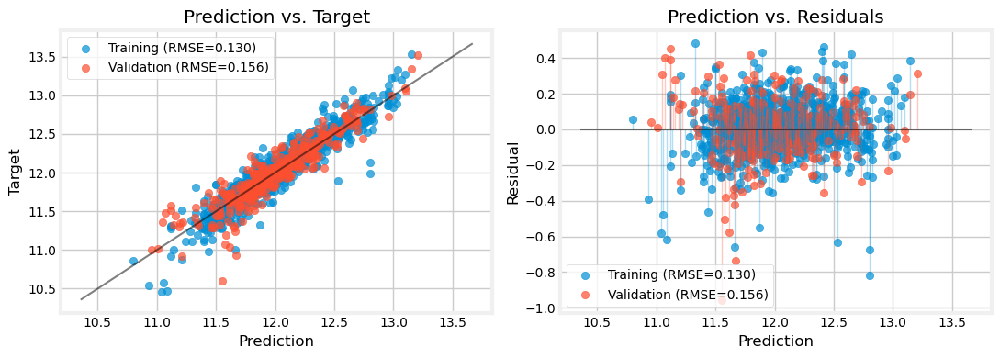



..................................................

Elapsed time: 0.05 minutes
..................................................



Time: 01:24:10
***************************************************************************
knn_eng , 	CV: True 

***************************************************************************
We will evaluate knn_eng with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.15576295628750195
		best params: {'model__algorithm': 'auto', 'model__leaf_size': 15, 'model__n_neighbors': 7, 'model__p': 2, 'model__weights': 'distance', 'preprocessor__selector__best_k': 20, 'preprocessor__selector__t_thr': 0.12581863056486375, 'preprocessor__target_encoder__smoothing': 20.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
...........................

,Value
Explained Variance,0.999988
R2,0.999988
MAE,0.000068
MSE,0.000002
RMSE,0.001387
MedAE,0.000000
MAPE,0.000006




Regression Report: Validation
..................................................


,Value
Explained Variance,0.863156
R2,0.863121
MAE,0.104683
MSE,0.022941
RMSE,0.151462
MedAE,0.067726
MAPE,0.008825



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


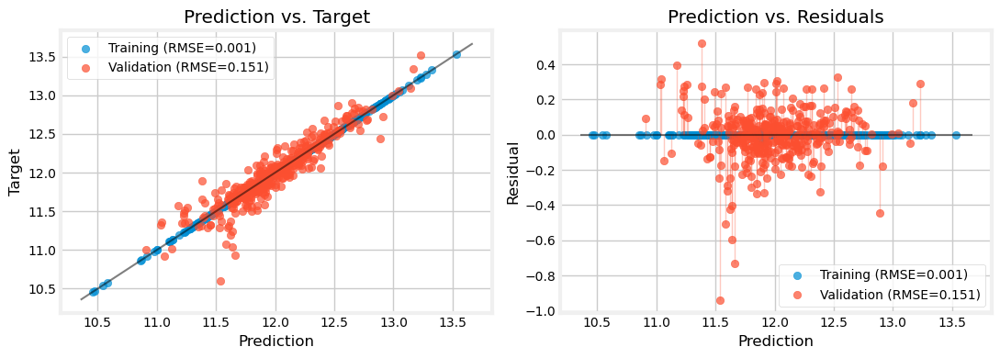



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['GarageArea', 'OverallQual', 'TotalBsmtSF', 'Neighborhood', 'OverallQualCond', 'TotalSF', 'AllBaths', '1and2FlrSF', 'BsmtQual', 'AllRooms', '1stFlrSF', 'YearBuilt', 'ExterQual', 'HouseAge', 'GarageCars', 'GarageAge', 'KitchenQual', 'Has_Bsmt', 'Has_Garage', 'BathsAbvGr']
The most important features are:

	GarageArea: 0.11393001170505035 +- 0.023915844629743457
	OverallQual: 0.07824737801567525 +- 0.004773174232398858
	TotalBsmtSF: 0.03621383757244716 +- 0.013434552994532983
	Neighborhood: 0.032282680577527124 +- 0.002955847218725276
	OverallQualCond: 0.028779434493555623 +- 0.0049420334727171035
	TotalSF: 0.025146750767702387 +- 0.004827068407133883
	AllBaths: 0.02384196770200144 +- 0.002396414280483646
	1and2FlrSF: 0.020229751298673125 +- 0.0030437993772335138
	BsmtQual: 

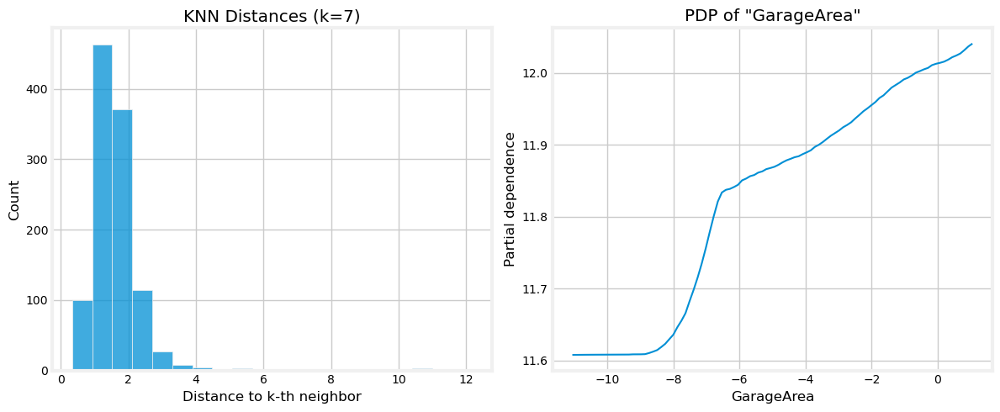

  0%|          | 0/50 [00:00<?, ?it/s]

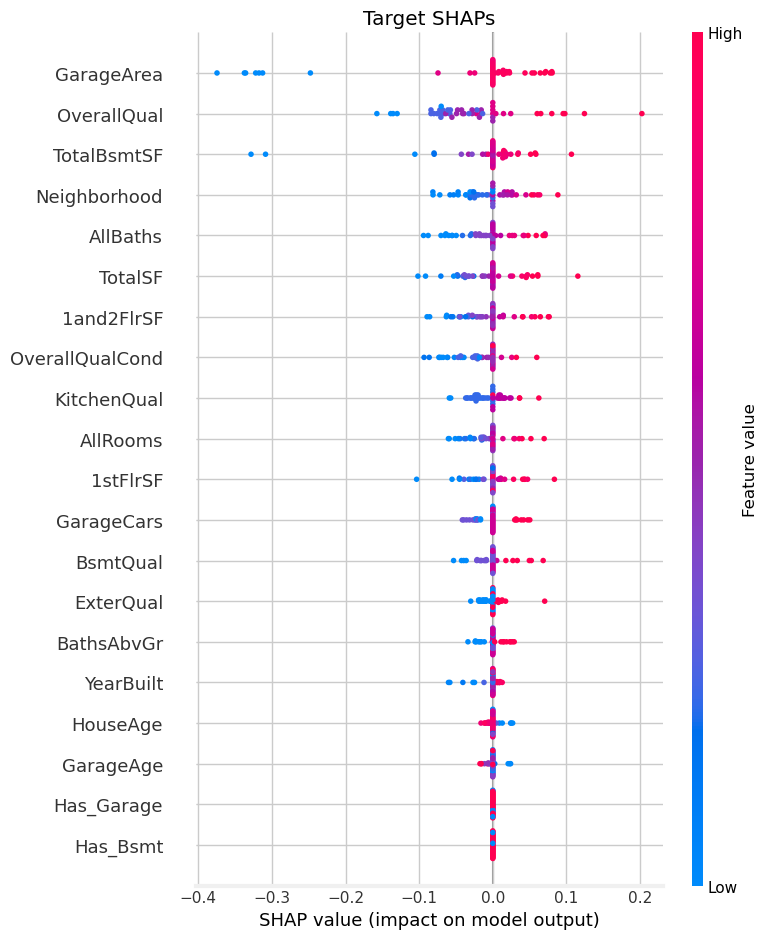

..................................................

Elapsed time: 16.99 minutes
..................................................



Time: 01:41:10
***************************************************************************
knn_clus , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=knn_clus with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.891018
R2,0.890773
MAE,0.091809
MSE,0.017079
RMSE,0.130686
MedAE,0.061749
MAPE,0.007655




Regression Report: Validation
..................................................


,Value
Explained Variance,0.853556
R2,0.853504
MAE,0.108468
MSE,0.024553
RMSE,0.156693
MedAE,0.073251
MAPE,0.009144



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


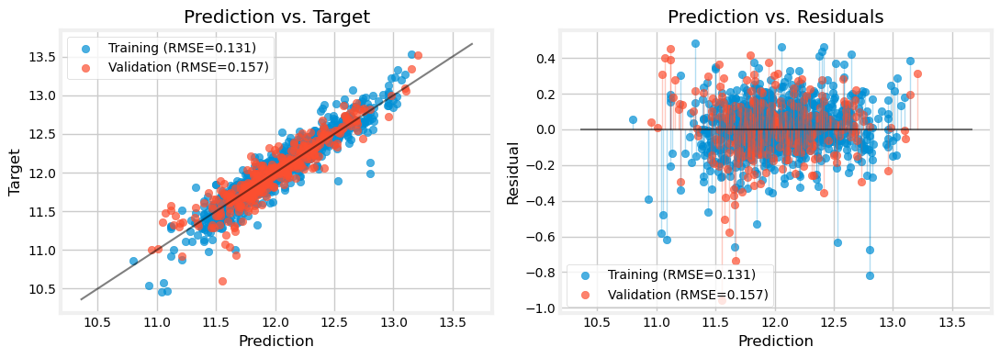



..................................................

Elapsed time: 0.05 minutes
..................................................



Time: 01:41:13
***************************************************************************
knn_clus , 	CV: True 

***************************************************************************
We will evaluate knn_clus with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.15795917457620187
		best params: {'model__algorithm': 'brute', 'model__leaf_size': 5, 'model__n_neighbors': 9, 'model__p': 2, 'model__weights': 'distance', 'preprocessor__cluster__n_clusters': 4, 'preprocessor__pca__fit_feat_subset': True, 'preprocessor__pca__keep_original_feats': False, 'preprocessor__selector__best_k': 20, 'preprocessor__selector__t_thr': 0.13201365963064537, 'preprocessor__target_encoder__smoothing': 40.0}
......Done!
 

,Value
Explained Variance,0.999988
R2,0.999988
MAE,0.000068
MSE,0.000002
RMSE,0.001387
MedAE,0.000000
MAPE,0.000006




Regression Report: Validation
..................................................


,Value
Explained Variance,0.866874
R2,0.866862
MAE,0.102434
MSE,0.022314
RMSE,0.149378
MedAE,0.069948
MAPE,0.008629



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


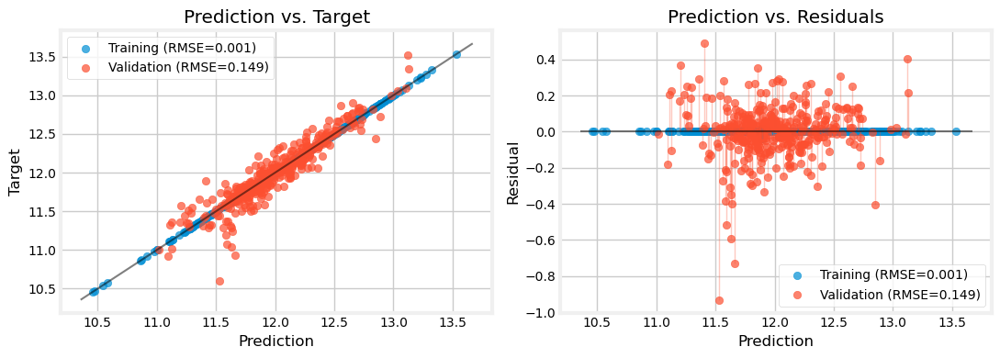



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['pca0', 'OverallQual', 'AllBaths', 'pca1', 'pca4', 'BsmtQual', 'pca5', 'pca2', 'pca8', 'ExterQual', 'GarageCars', 'pca3', 'KitchenQual', 'pca7', 'BathsAbvGr', 'pca6', 'cluster_1', 'Has_Bsmt', 'pca9', 'cluster_2', 'cluster_3', 'Has_Garage', 'cluster_0']
The most important features are:

	pca0: 0.6266460030020508 +- 0.02834140799237219
	OverallQual: 0.07649934969679706 +- 0.005131563283595108
	AllBaths: 0.02719690031493489 +- 0.0021331176722996217
	pca1: 0.018966625491650357 +- 0.004044968858718817
	pca4: 0.011524631441052025 +- 0.004463947380986586
	BsmtQual: 0.011107161498945195 +- 0.0027276042535786774
	pca5: 0.009764172486800837 +- 0.0021492189871622686
	pca2: 0.006633810749034352 +- 0.002521068659948473
	pca8: 0.005956085934783117 +- 0.0036239165889146475
	ExterQual: 0.

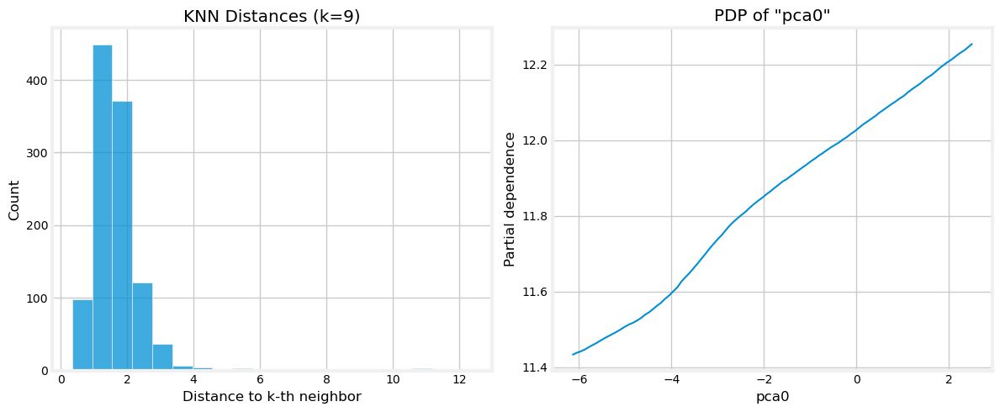

  0%|          | 0/50 [00:00<?, ?it/s]

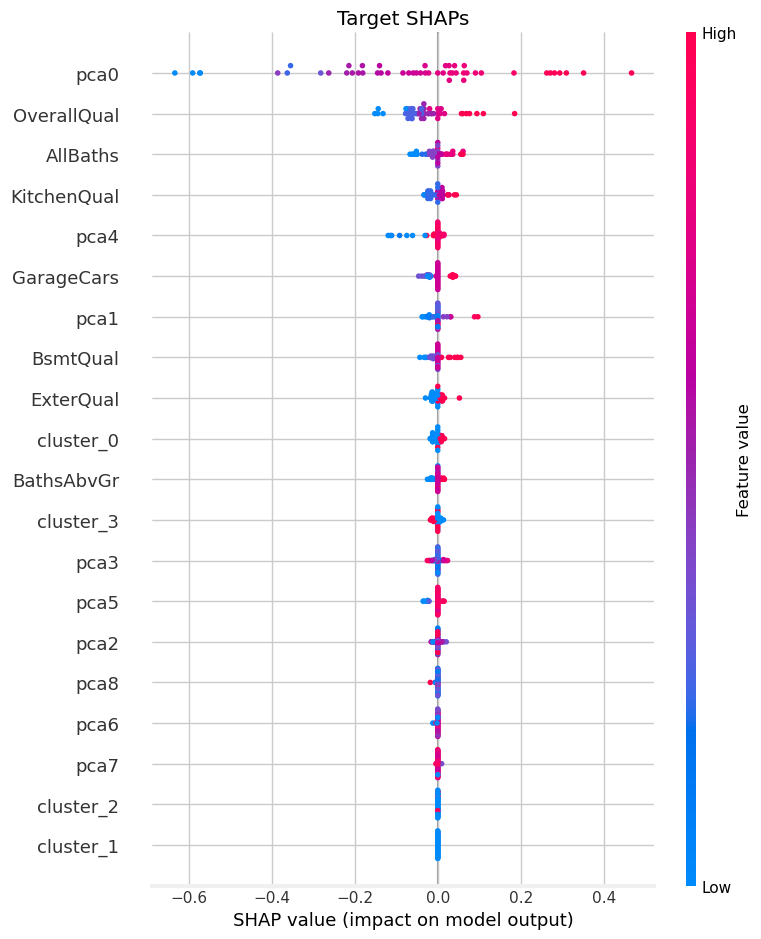

..................................................

Elapsed time: 18.12 minutes
..................................................





In [136]:
model = 'knn'
redoQ = False

for pp in ['raw', 'eng', 'clus']:
    for cvQ in [False, True]:

        print(time.strftime("Time: %H:%M:%S"))
        start = time.time()

        model_name = model+'_'+pp # full model name

        if redoQ and (model_name in search.keys()):
            del search[model_name]

        print("*"*75)
        print(model_name, ", \tCV:", cvQ, "\n")
        print("*"*75)
        
        # # GridSearchCV
        # model_evaluation(model_name, (X_train, X_val, y_train, y_val),
        #                  perform_cv_randomized=(cvQ, False),
        #                  n_splits=5, n_repeats=3,
        #                  verbose=True, plots=True)

        # RandomizedSearchCV
        model_evaluation(model_name, (X_train, X_val, y_train, y_val),
                         perform_cv_randomized=(cvQ, True),
                         n_splits=5, n_repeats=3,
                         n_iter=1000,
                         verbose=True, plots=True)

        print("\n")

        if cvQ:
            explain_model(model_name, best_cv[model_name]['pipe'], (X_train, X_val, y_train, y_val), tree_idx=0, random_state=0)

        end = time.time()

        print("."*50)
        print(f"\nElapsed time: {(end-start)/60:.2f} minutes")
        print("."*50)

        print("\n\n")

In [137]:
scorecard

,rfr_base_no_cv,dtr_raw_no_cv,dtr_raw_cv,dtr_eng_no_cv,dtr_eng_cv,dtr_clus_no_cv,dtr_clus_cv,rfr_raw_no_cv,rfr_raw_cv,rfr_eng_no_cv,rfr_eng_cv,rfr_clus_no_cv,rfr_clus_cv,xgbr_raw_no_cv,xgbr_raw_cv,xgbr_eng_no_cv,xgbr_eng_cv,xgbr_clus_no_cv,xgbr_clus_cv,linreg_raw_no_cv,linreg_raw_cv,linreg_eng_no_cv,linreg_eng_cv,linreg_clus_no_cv,linreg_clus_cv,lasso_raw_no_cv,lasso_raw_cv,lasso_eng_no_cv,lasso_eng_cv,lasso_clus_no_cv,lasso_clus_cv,ridge_raw_no_cv,ridge_raw_cv,ridge_eng_no_cv,ridge_eng_cv,ridge_clus_no_cv,ridge_clus_cv,knn_raw_no_cv,knn_raw_cv,knn_eng_no_cv,knn_eng_cv,knn_clus_no_cv,knn_clus_cv
R2 Score Train,0.056091,9.297877e-17,0.201295,0.002394,0.186764,0.002394,0.174660,0.056091,0.059486,0.055042,0.059738,0.056760,0.066433,0.004774,0.094879,0.009846,0.088716,0.008072,0.087156,0.099541,0.150483,0.141500,0.135272,0.141334,0.135143,0.195434,0.152514,0.395426,0.136648,0.395426,0.136953,0.106040,0.151072,0.141619,0.136965,0.141392,0.134849,0.186154,0.002095,0.130320,0.001387,0.130686,0.001387
R2 Score Validation,0.891477,7.513521e-01,0.745161,0.756836,0.793272,0.783426,0.774561,0.891477,0.890179,0.888852,0.890617,0.881278,0.880512,0.894659,0.876820,0.876607,0.892419,0.861901,0.876020,0.895123,0.878597,0.892702,0.900085,0.892984,0.902885,0.814858,0.882886,-0.008946,0.901947,-0.008946,0.900118,0.892717,0.880488,0.893122,0.900468,0.893256,0.903510,0.632831,0.772192,0.855047,0.863121,0.853504,0.866862
RMSE Train,0.056091,9.297877e-17,0.201295,0.002394,0.186764,0.002394,0.174660,0.056091,0.059486,0.055042,0.059738,0.056760,0.066433,0.004774,0.094879,0.009846,0.088716,0.008072,0.087156,0.099541,0.150483,0.141500,0.135272,0.141334,0.135143,0.195434,0.152514,0.395426,0.136648,0.395426,0.136953,0.106040,0.151072,0.141619,0.136965,0.141392,0.134849,0.186154,0.002095,0.130320,0.001387,0.130686,0.001387
RMSE Validation,0.134864,2.041404e-01,0.206666,0.201877,0.186139,0.190520,0.194380,0.134864,0.135668,0.136486,0.135398,0.141059,0.141514,0.132873,0.143683,0.143808,0.134278,0.152136,0.144149,0.132579,0.142643,0.134101,0.129406,0.133925,0.127579,0.176152,0.140101,0.411216,0.128194,0.411216,0.129384,0.134092,0.141528,0.133839,0.129157,0.133755,0.127168,0.248067,0.195398,0.155866,0.151462,0.156693,0.149378


#### Engineered Cluster Model: exploration

In the cluster model, checking selected engineering features (from which PCA and clusters are built)

In [138]:
best_cv[model+'_clus']

{'pipe': Pipeline(steps=[('preprocessor',
                  Pipeline(steps=[('cleaning',
                                   Pipeline(steps=[('custom_imputer',
                                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                                             'BsmtQual'],
                                                                                'BsmtExposure': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtFinType2': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtQual': ['BsmtCond',
                                                                                   

In [139]:
best_cv[model+'_clus']['params']

{'model__algorithm': 'brute',
 'model__leaf_size': 5,
 'model__n_neighbors': 9,
 'model__p': 2,
 'model__weights': 'distance',
 'preprocessor__cluster__n_clusters': 4,
 'preprocessor__pca__fit_feat_subset': True,
 'preprocessor__pca__keep_original_feats': False,
 'preprocessor__selector__best_k': 20,
 'preprocessor__selector__t_thr': 0.13201365963064537,
 'preprocessor__target_encoder__smoothing': 40.0}

In [140]:
best_cv[model+'_clus']['pipe'].steps

[('preprocessor',
  Pipeline(steps=[('cleaning',
                   Pipeline(steps=[('custom_imputer',
                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                             'BsmtQual'],
                                                                'BsmtExposure': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtFinType2': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtQual': ['BsmtCond',
                                                                             'BsmtExposure'],
                                                                'Exterior1st': 'Foundation',
                                                                

In [141]:
best_preproc = best_cv[model+'_clus']['pipe'].steps[0][1] # the best preprocessor
best_feats = best_preproc[:-3] # all the preprocessor steps, except for PCA, KMeans clustering, and OHE
best_feats.transform(X_train)

,TotalSF,OverallQual,1and2FlrSF,Neighborhood,AllRooms,OverallQualCond,GarageCars,GarageArea,YearBuilt,TotalBsmtSF,BathsAbvGr,1stFlrSF,AllBaths,KitchenQual,ExterQual,BsmtQual,GarageAge,Has_Garage,Has_Bsmt
6,0.742068,8,0.312092,0.483664,0.500000,0.5,2,0.502730,0.659574,1.052674,2.0,0.919677,3.0,4,4,5,-1.066979,1,1
807,0.367177,5,0.156204,-1.057006,0.333333,-0.5,2,0.170238,-1.063830,0.569246,1.5,-0.048785,3.5,4,3,3,0.537697,1,1
955,0.398207,6,0.624807,0.287491,0.500000,0.1,2,0.044102,-0.574468,-0.034421,2.0,-0.240817,2.0,3,3,4,0.361174,1,1
1040,0.398207,5,0.446734,-0.736242,0.833333,-1.5,2,0.014822,-0.340426,0.259462,2.0,1.051686,3.0,3,3,3,0.249087,1,1
701,-0.170534,7,-0.497959,0.115169,-0.333333,0.0,2,0.170238,-0.085106,0.311677,1.5,0.125459,1.5,3,3,3,0.106088,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,-0.081754,6,-0.177958,0.115169,0.166667,-0.5,2,-0.007457,0.021277,0.132054,2.0,0.439205,2.0,3,3,4,0.077916,1,1
905,-0.400741,5,-0.693872,-0.772132,-0.166667,-1.0,1,-0.961984,-0.404255,0.116963,1.0,-0.066626,2.0,3,3,3,0.317361,1,1
1096,-0.494922,6,-0.169978,-1.341701,0.000000,0.7,0,-11.052923,-1.255319,-0.751207,1.5,-0.740655,1.5,4,3,3,2.173310,0,1
235,-1.295571,6,-0.853972,-1.044408,-0.666667,-1.7,1,-1.066905,-0.042553,-1.446378,1.5,-1.735090,1.5,3,3,3,0.106088,1,1


In [142]:
best_preproc

Pipeline(steps=[('cleaning',
                 Pipeline(steps=[('custom_imputer',
                                  CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                           'BsmtQual'],
                                                              'BsmtExposure': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtFinType2': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtQual': ['BsmtCond',
                                                                           'BsmtExposure'],
                                                              'Exterior1st': 'Foundation',
                                                              'Exterior2nd': 'Foundation',
                                                              'GarageArea': ['GarageCars',
                                                                             'GarageQual'],
                                                              'GarageCa...
                 PCAFeature(fit_feat_subset=True, keep_original_feats=False)),
                ('cluster',
                 KMeansFeature(n_clusters=4, scaling_method='robust')),
                ('ohe',
                 Pipeline(steps=[('ohe',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('ohe',
                                                                   OneHotEncoder(dtype=<class 'int'>,
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False),
                                                                   <function ohe_from_subset.<locals>.selector at 0x7b1eeceb1f80>)],
                                                    verbose_feature_names_out=False))]))])

In [143]:
del best_preproc, best_feats

### Model 8: `MLPRegressor`

In [144]:
model = 'mlp'

for pp in ['raw', 'eng', 'clus']:

    model_name = model+'_'+pp # full model name

    preproc_pipe = final_preproc[pp] # preprocessing  pipeline

    pipe[model_name] =\
        Pipeline(steps=[('preprocessor', preproc_pipe),
                        ('model', MLPRegressor(max_iter=10_000,
                                               random_state=0))])

    pipe[model_name+'_no_cv'] =\
        Pipeline(steps=[('preprocessor', preproc_pipe),
                        ('model', MLPRegressor(max_iter=10_000,
                                               random_state=0))])

    # defining the hyperparameter grid
    # basic:
    param_grid[model_name] = {'preprocessor__target_encoder__smoothing':
                                  list(np.arange(10., 60., 10.)),
                              'preprocessor__selector__best_k':
                                  list(range(10, 40, 10)),
                              'preprocessor__selector__t_thr':
                                  uniform(loc=0.1, scale=0.8)
                             }
    # if clustering:
    if pp == 'clus':
        param_grid[model_name]['preprocessor__pca__fit_feat_subset'] =\
                        [True]
        param_grid[model_name]['preprocessor__pca__keep_original_feats'] =\
            [False]
        param_grid[model_name]['preprocessor__cluster__n_clusters'] =\
            list(range(3,7))

    # proper to the model:
    param_grid[model_name]['model__hidden_layer_sizes'] =\
        np.arange(10, 100, 10)
    param_grid[model_name]['model__alpha'] =\
        loguniform(1.e-6, 0.1)
    param_grid[model_name]['model__learning_rate_init'] =\
        loguniform(1.e-4, 0.1)

Time: 01:59:20
***************************************************************************
mlp_raw , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=mlp_raw with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,-733.525561
R2,-1089.394514
MAE,8.319315
MSE,170.496212
RMSE,13.057420
MedAE,7.139932
MAPE,0.687289




Regression Report: Validation
..................................................


,Value
Explained Variance,-851.980651
R2,-1183.886659
MAE,9.407019
MSE,198.586654
RMSE,14.092078
MedAE,7.614053
MAPE,0.781830



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


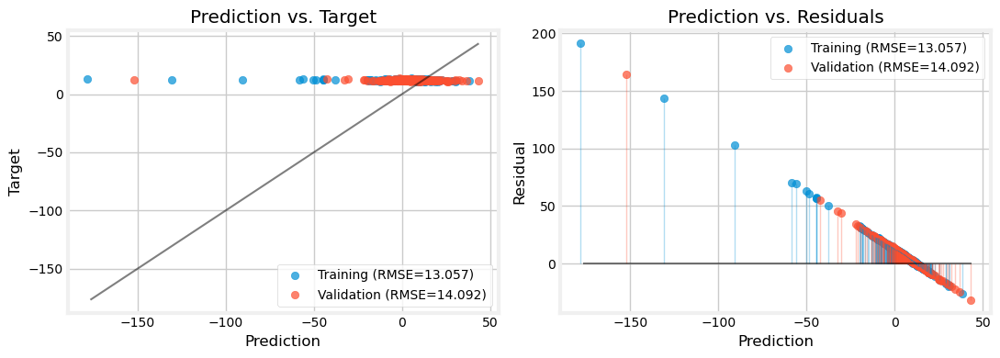



..................................................

Elapsed time: 0.03 minutes
..................................................



Time: 01:59:22
***************************************************************************
mlp_raw , 	CV: True 

***************************************************************************
We will evaluate mlp_raw with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.25086105198517444
		best params: {'model__alpha': 2.8889340918565568e-05, 'model__hidden_layer_sizes': 70, 'model__learning_rate_init': 0.06145934824126919, 'preprocessor__selector__best_k': 10, 'preprocessor__selector__t_thr': 0.7664304780075127, 'preprocessor__target_encoder__smoothing': 10.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
...........................

,Value
Explained Variance,0.701528
R2,0.656978
MAE,0.167364
MSE,0.053636
RMSE,0.231594
MedAE,0.135222
MAPE,0.013893




Regression Report: Validation
..................................................


,Value
Explained Variance,0.776249
R2,0.749738
MAE,0.158263
MSE,0.041944
RMSE,0.204802
MedAE,0.126986
MAPE,0.013200



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


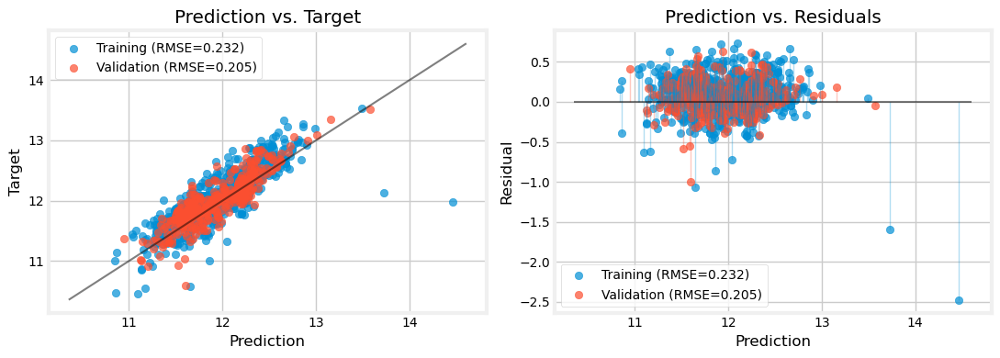



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['GrLivArea', 'YearBuilt', 'OverallQual', 'GarageCars', 'KitchenQual', 'BsmtQual']
The most important features are:

	GrLivArea: 0.4707813678294005 +- 0.02502700703626654
	YearBuilt: 0.30089083402637745 +- 0.03276468828504923
	OverallQual: 0.04587176448099624 +- 0.0036828100651727347
	GarageCars: 0.018557885286375364 +- 0.002705953882594329
	KitchenQual: 0.01030697568784542 +- 0.0016796984272359585
	BsmtQual: 0.00961424899175658 +- 0.002067997177639514

****************************************************************************************************



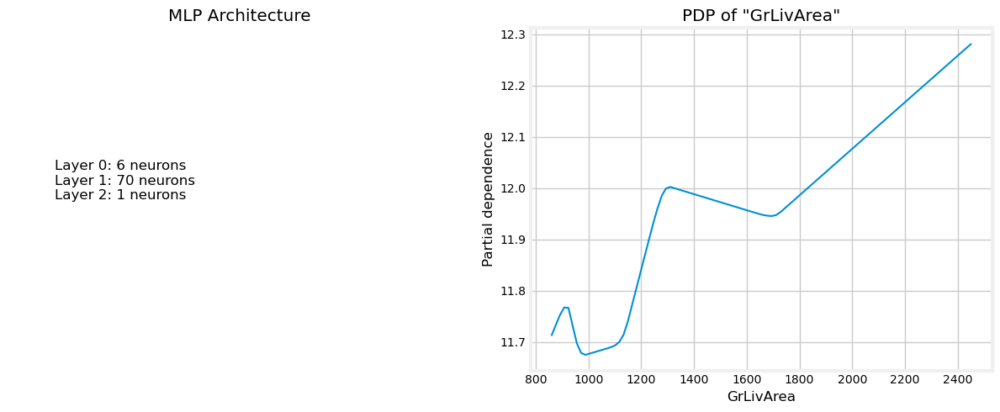

  0%|          | 0/50 [00:00<?, ?it/s]

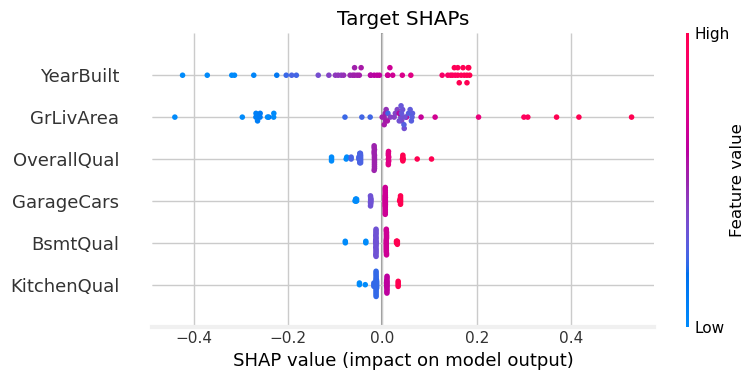

..................................................

Elapsed time: 29.68 minutes
..................................................



Time: 02:29:03
***************************************************************************
mlp_eng , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=mlp_eng with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.862084
R2,0.860595
MAE,0.109638
MSE,0.021798
RMSE,0.147640
MedAE,0.080999
MAPE,0.009136




Regression Report: Validation
..................................................


,Value
Explained Variance,0.828002
R2,0.826766
MAE,0.128113
MSE,0.029034
RMSE,0.170394
MedAE,0.098258
MAPE,0.010784



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


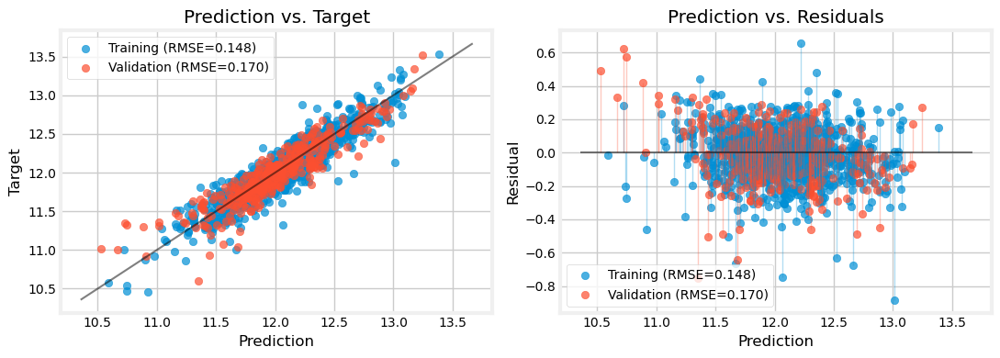



..................................................

Elapsed time: 0.07 minutes
..................................................



Time: 02:29:07
***************************************************************************
mlp_eng , 	CV: True 

***************************************************************************
We will evaluate mlp_eng with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.15985375306822117
		best params: {'model__alpha': 1.4156759896557033e-06, 'model__hidden_layer_sizes': 80, 'model__learning_rate_init': 0.0019667989797839376, 'preprocessor__selector__best_k': 20, 'preprocessor__selector__t_thr': 0.5019146351256809, 'preprocessor__target_encoder__smoothing': 50.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
.........................

,Value
Explained Variance,0.869260
R2,0.861662
MAE,0.108241
MSE,0.021631
RMSE,0.147074
MedAE,0.083311
MAPE,0.009056




Regression Report: Validation
..................................................


,Value
Explained Variance,0.864656
R2,0.859467
MAE,0.109417
MSE,0.023553
RMSE,0.153471
MedAE,0.080331
MAPE,0.009232



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


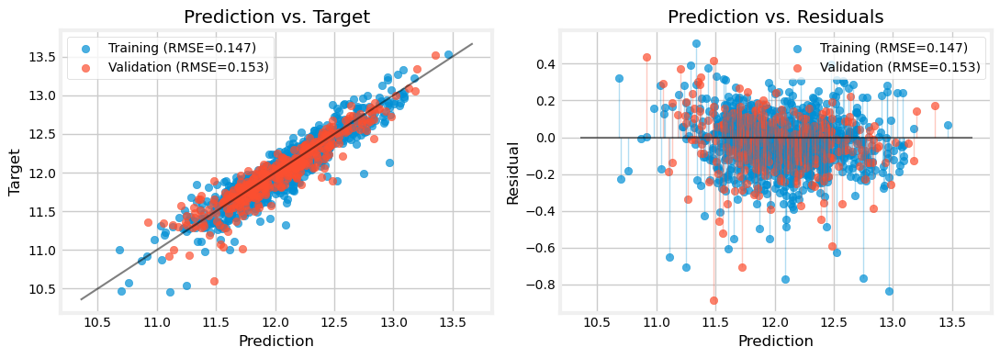



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['GarageArea', 'Has_Garage', 'TotalBsmtSF', 'Has_Bsmt', 'TotalSF', 'GarageCars', 'BsmtQual', 'Neighborhood', 'OverallQualCond', 'AllBaths', 'OverallQual', 'BathsAbvGr', 'KitchenQual', 'ExterQual']
The most important features are:

	GarageArea: 13.185064687414362 +- 0.8198008566897771
	Has_Garage: 10.875533242222037 +- 0.698256597828206
	TotalBsmtSF: 2.8327320515754972 +- 0.077279682404008
	Has_Bsmt: 2.7452514668111028 +- 0.10108258707547972
	TotalSF: 0.2858381257051579 +- 0.01589738625275037
	GarageCars: 0.1600525621646013 +- 0.01967262604482655
	BsmtQual: 0.09526288052667706 +- 0.016004202028365732
	Neighborhood: 0.08234561002855403 +- 0.005566097839459685
	OverallQualCond: 0.06649268243645283 +- 0.008021725389059426
	AllBaths: 0.0584433142697071 +- 0.0065158348534808085
	

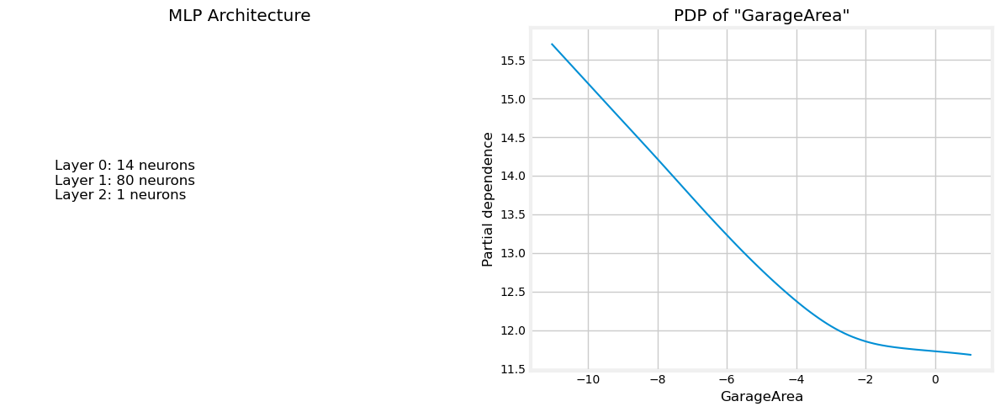

  0%|          | 0/50 [00:00<?, ?it/s]

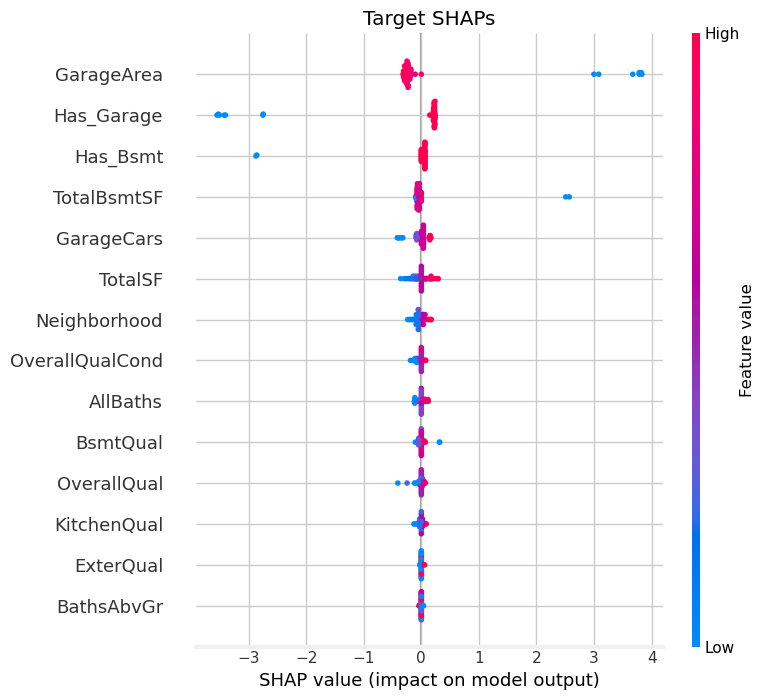

..................................................

Elapsed time: 33.60 minutes
..................................................



Time: 03:02:43
***************************************************************************
mlp_clus , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=mlp_clus with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.876943
R2,0.876941
MAE,0.105980
MSE,0.019242
RMSE,0.138715
MedAE,0.080574
MAPE,0.008840




Regression Report: Validation
..................................................


,Value
Explained Variance,0.849529
R2,0.848764
MAE,0.116376
MSE,0.025347
RMSE,0.159208
MedAE,0.087335
MAPE,0.009820



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


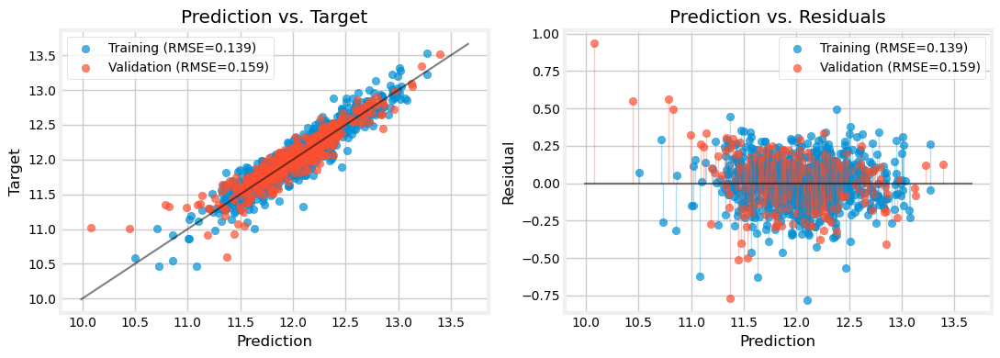



..................................................

Elapsed time: 0.04 minutes
..................................................



Time: 03:02:45
***************************************************************************
mlp_clus , 	CV: True 

***************************************************************************
We will evaluate mlp_clus with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.1628595786517089
		best params: {'model__alpha': 0.0003220752515819791, 'model__hidden_layer_sizes': 10, 'model__learning_rate_init': 0.014100365639524458, 'preprocessor__cluster__n_clusters': 5, 'preprocessor__pca__fit_feat_subset': True, 'preprocessor__pca__keep_original_feats': False, 'preprocessor__selector__best_k': 20, 'preprocessor__selector__t_thr': 0.49956040522187883, 'preprocessor__target_encoder__smoothing': 50.0}
......Done!
 

,Value
Explained Variance,0.863664
R2,0.858329
MAE,0.106256
MSE,0.022152
RMSE,0.148835
MedAE,0.080277
MAPE,0.008897




Regression Report: Validation
..................................................


,Value
Explained Variance,0.845502
R2,0.843734
MAE,0.110522
MSE,0.026190
RMSE,0.161834
MedAE,0.077452
MAPE,0.009349



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


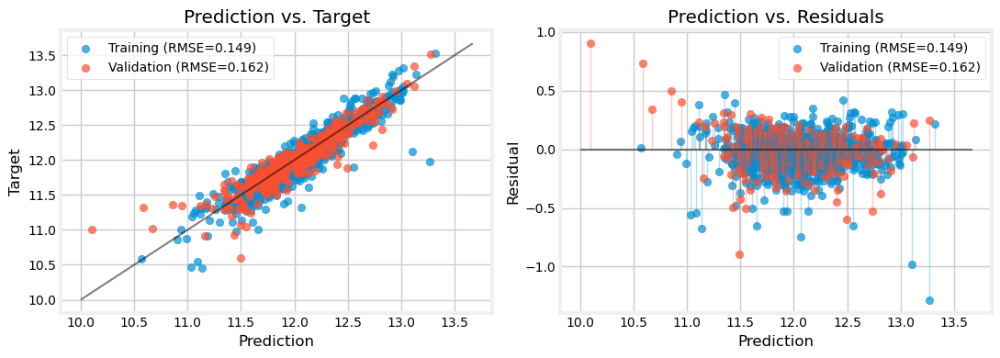



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['cluster_3', 'cluster_0', 'pca3', 'Has_Garage', 'pca0', 'Has_Bsmt', 'pca4', 'pca2', 'pca1', 'BsmtQual', 'GarageCars', 'cluster_1', 'cluster_2', 'AllBaths', 'OverallQual', 'BathsAbvGr', 'ExterQual', 'cluster_4', 'KitchenQual']
The most important features are:

	cluster_3: 25.362167187939587 +- 0.9896725624737354
	cluster_0: 23.142248236521375 +- 0.9423844267544279
	pca3: 10.038283199963212 +- 0.5605826413347623
	Has_Garage: 2.893527530484357 +- 0.17320881960696355
	pca0: 1.5411868457254116 +- 0.06113323428643682
	Has_Bsmt: 1.2480977083205507 +- 0.034557531885939255
	pca4: 1.1664177707554146 +- 0.019732647289351563
	pca2: 0.7346909059892732 +- 0.07040109076975758
	pca1: 0.3640924787094604 +- 0.025658822362474527
	BsmtQual: 0.26361857251681664 +- 0.019493543601358562
	GarageC

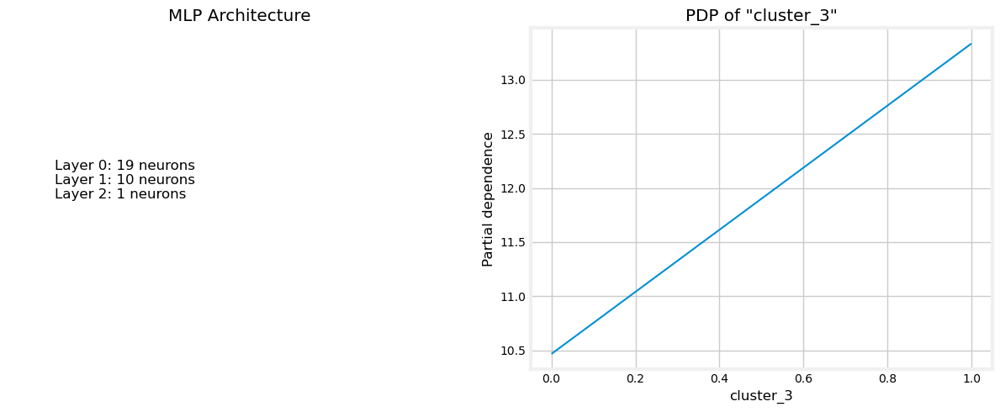

  0%|          | 0/50 [00:00<?, ?it/s]

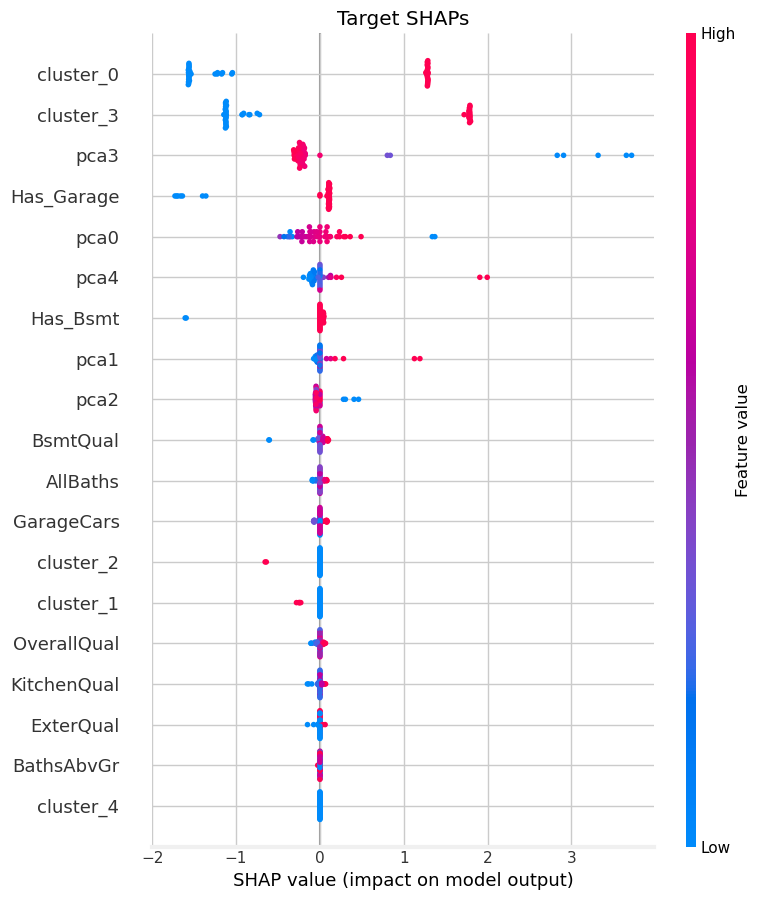

..................................................

Elapsed time: 34.10 minutes
..................................................





In [145]:
model = 'mlp'
redoQ = False

for pp in ['raw', 'eng', 'clus']:
    for cvQ in [False, True]:

        print(time.strftime("Time: %H:%M:%S"))
        start = time.time()

        model_name = model+'_'+pp # full model name

        if redoQ and (model_name in search.keys()):
            del search[model_name]

        print("*"*75)
        print(model_name, ", \tCV:", cvQ, "\n")
        print("*"*75)
        
        # # GridSearchCV
        # model_evaluation(model_name, (X_train, X_val, y_train, y_val),
        #                  perform_cv_randomized=(cvQ, False),
        #                  n_splits=5, n_repeats=3,
        #                  verbose=True, plots=True)

        # RandomizedSearchCV
        model_evaluation(model_name, (X_train, X_val, y_train, y_val),
                         perform_cv_randomized=(cvQ, True),
                         n_splits=5, n_repeats=3,
                         n_iter=1000,
                         verbose=True, plots=True)

        print("\n")

        if cvQ:
            explain_model(model_name, best_cv[model_name]['pipe'], (X_train, X_val, y_train, y_val), tree_idx=0, random_state=0)

        end = time.time()

        print("."*50)
        print(f"\nElapsed time: {(end-start)/60:.2f} minutes")
        print("."*50)

        print("\n\n")

In [146]:
scorecard

,rfr_base_no_cv,dtr_raw_no_cv,dtr_raw_cv,dtr_eng_no_cv,dtr_eng_cv,dtr_clus_no_cv,dtr_clus_cv,rfr_raw_no_cv,rfr_raw_cv,rfr_eng_no_cv,rfr_eng_cv,rfr_clus_no_cv,rfr_clus_cv,xgbr_raw_no_cv,xgbr_raw_cv,xgbr_eng_no_cv,xgbr_eng_cv,xgbr_clus_no_cv,xgbr_clus_cv,linreg_raw_no_cv,linreg_raw_cv,linreg_eng_no_cv,linreg_eng_cv,linreg_clus_no_cv,linreg_clus_cv,lasso_raw_no_cv,lasso_raw_cv,lasso_eng_no_cv,lasso_eng_cv,lasso_clus_no_cv,lasso_clus_cv,ridge_raw_no_cv,ridge_raw_cv,ridge_eng_no_cv,ridge_eng_cv,ridge_clus_no_cv,ridge_clus_cv,knn_raw_no_cv,knn_raw_cv,knn_eng_no_cv,knn_eng_cv,knn_clus_no_cv,knn_clus_cv,mlp_raw_no_cv,mlp_raw_cv,mlp_eng_no_cv,mlp_eng_cv,mlp_clus_no_cv,mlp_clus_cv
R2 Score Train,0.056091,9.297877e-17,0.201295,0.002394,0.186764,0.002394,0.174660,0.056091,0.059486,0.055042,0.059738,0.056760,0.066433,0.004774,0.094879,0.009846,0.088716,0.008072,0.087156,0.099541,0.150483,0.141500,0.135272,0.141334,0.135143,0.195434,0.152514,0.395426,0.136648,0.395426,0.136953,0.106040,0.151072,0.141619,0.136965,0.141392,0.134849,0.186154,0.002095,0.130320,0.001387,0.130686,0.001387,13.057420,0.231594,0.147640,0.147074,0.138715,0.148835
R2 Score Validation,0.891477,7.513521e-01,0.745161,0.756836,0.793272,0.783426,0.774561,0.891477,0.890179,0.888852,0.890617,0.881278,0.880512,0.894659,0.876820,0.876607,0.892419,0.861901,0.876020,0.895123,0.878597,0.892702,0.900085,0.892984,0.902885,0.814858,0.882886,-0.008946,0.901947,-0.008946,0.900118,0.892717,0.880488,0.893122,0.900468,0.893256,0.903510,0.632831,0.772192,0.855047,0.863121,0.853504,0.866862,-1183.886659,0.749738,0.826766,0.859467,0.848764,0.843734
RMSE Train,0.056091,9.297877e-17,0.201295,0.002394,0.186764,0.002394,0.174660,0.056091,0.059486,0.055042,0.059738,0.056760,0.066433,0.004774,0.094879,0.009846,0.088716,0.008072,0.087156,0.099541,0.150483,0.141500,0.135272,0.141334,0.135143,0.195434,0.152514,0.395426,0.136648,0.395426,0.136953,0.106040,0.151072,0.141619,0.136965,0.141392,0.134849,0.186154,0.002095,0.130320,0.001387,0.130686,0.001387,13.057420,0.231594,0.147640,0.147074,0.138715,0.148835
RMSE Validation,0.134864,2.041404e-01,0.206666,0.201877,0.186139,0.190520,0.194380,0.134864,0.135668,0.136486,0.135398,0.141059,0.141514,0.132873,0.143683,0.143808,0.134278,0.152136,0.144149,0.132579,0.142643,0.134101,0.129406,0.133925,0.127579,0.176152,0.140101,0.411216,0.128194,0.411216,0.129384,0.134092,0.141528,0.133839,0.129157,0.133755,0.127168,0.248067,0.195398,0.155866,0.151462,0.156693,0.149378,14.092078,0.204802,0.170394,0.153471,0.159208,0.161834


#### Engineered Cluster Model: exploration

In the cluster model, checking selected engineering features (from which PCA and clusters are built)

In [147]:
best_cv[model+'_clus']

{'pipe': Pipeline(steps=[('preprocessor',
                  Pipeline(steps=[('cleaning',
                                   Pipeline(steps=[('custom_imputer',
                                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                                             'BsmtQual'],
                                                                                'BsmtExposure': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtFinType2': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtQual': ['BsmtCond',
                                                                                   

In [148]:
best_cv[model+'_clus']['params']

{'model__alpha': 0.0003220752515819791,
 'model__hidden_layer_sizes': 10,
 'model__learning_rate_init': 0.014100365639524458,
 'preprocessor__cluster__n_clusters': 5,
 'preprocessor__pca__fit_feat_subset': True,
 'preprocessor__pca__keep_original_feats': False,
 'preprocessor__selector__best_k': 20,
 'preprocessor__selector__t_thr': 0.49956040522187883,
 'preprocessor__target_encoder__smoothing': 50.0}

In [149]:
best_cv[model+'_clus']['pipe'].steps

[('preprocessor',
  Pipeline(steps=[('cleaning',
                   Pipeline(steps=[('custom_imputer',
                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                             'BsmtQual'],
                                                                'BsmtExposure': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtFinType2': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtQual': ['BsmtCond',
                                                                             'BsmtExposure'],
                                                                'Exterior1st': 'Foundation',
                                                                

In [150]:
best_preproc = best_cv[model+'_clus']['pipe'].steps[0][1] # the best preprocessor
best_feats = best_preproc[:-3] # all the preprocessor steps, except for PCA, KMeans clustering, and OHE
best_feats.transform(X_train)

,TotalSF,OverallQual,Neighborhood,GarageCars,OverallQualCond,GarageArea,TotalBsmtSF,BathsAbvGr,AllBaths,BsmtQual,ExterQual,KitchenQual,Has_Garage,Has_Bsmt
6,0.742068,8,0.472509,2,0.5,0.502730,1.052674,2.0,3.0,5,4,4,1,1
807,0.367177,5,-1.069603,2,-0.5,0.170238,0.569246,1.5,3.5,3,3,4,1,1
955,0.398207,6,0.288295,2,0.1,0.044102,-0.034421,2.0,2.0,4,3,3,1,1
1040,0.398207,5,-0.738474,2,-1.5,0.014822,0.259462,2.0,3.0,3,3,3,1,1
701,-0.170534,7,0.108607,2,0.0,0.170238,0.311677,1.5,1.5,3,3,3,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,-0.081754,6,0.108607,2,-0.5,-0.007457,0.132054,2.0,2.0,4,3,3,1,1
905,-0.400741,5,-0.774909,1,-1.0,-0.961984,0.116963,1.0,2.0,3,3,3,1,1
1096,-0.494922,6,-1.399037,0,0.7,-11.052923,-0.751207,1.5,1.5,3,3,4,0,1
235,-1.295571,6,-1.118567,1,-1.7,-1.066905,-1.446378,1.5,1.5,3,3,3,1,1


In [151]:
best_preproc

Pipeline(steps=[('cleaning',
                 Pipeline(steps=[('custom_imputer',
                                  CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                           'BsmtQual'],
                                                              'BsmtExposure': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtFinType2': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtQual': ['BsmtCond',
                                                                           'BsmtExposure'],
                                                              'Exterior1st': 'Foundation',
                                                              'Exterior2nd': 'Foundation',
                                                              'GarageArea': ['GarageCars',
                                                                             'GarageQual'],
                                                              'GarageCa...
                 PCAFeature(fit_feat_subset=True, keep_original_feats=False)),
                ('cluster',
                 KMeansFeature(n_clusters=5, scaling_method='robust')),
                ('ohe',
                 Pipeline(steps=[('ohe',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('ohe',
                                                                   OneHotEncoder(dtype=<class 'int'>,
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False),
                                                                   <function ohe_from_subset.<locals>.selector at 0x7b1eeceb1f80>)],
                                                    verbose_feature_names_out=False))]))])

In [152]:
del best_preproc, best_feats

### Model 9: `SVR`/`LinearSVR`

In [153]:
model = 'svr'

for pp in ['raw', 'eng', 'clus']:

    model_name = model+'_'+pp # full model name

    preproc_pipe = final_preproc[pp] # preprocessing  pipeline

    pipe[model_name] =\
        Pipeline(steps=[('preprocessor', preproc_pipe),
                        # ('model', LinearSVR(max_iter=100_000,
                                            # tol=1.e-2,
                                            # random_state=0))])
                        ('model', SVR(tol=0.005))])

    pipe[model_name+'_no_cv'] =\
        Pipeline(steps=[('preprocessor', preproc_pipe),
                        # ('model', LinearSVR(max_iter=100_000,
                        #                     tol=1.e-2,
                        #                     random_state=0))])
                        ('model', SVR(tol=0.005))])

    # defining the hyperparameter grid
    # basic:
    param_grid[model_name] = {'preprocessor__target_encoder__smoothing':
                                  list(np.arange(10., 60., 10.)),
                              'preprocessor__selector__best_k':
                                  list(range(10, 40, 10)),
                              'preprocessor__selector__t_thr':
                                  uniform(loc=0.1, scale=0.8)
                             }
    # if clustering:
    if pp == 'clus':
        param_grid[model_name]['preprocessor__pca__fit_feat_subset'] =\
                        [True]
        param_grid[model_name]['preprocessor__pca__keep_original_feats'] =\
            [False]
        param_grid[model_name]['preprocessor__cluster__n_clusters'] =\
            list(range(3,7))

    # proper to the model:
    param_grid[model_name]['model__C'] =\
        loguniform(1e-3, 1e2)
    param_grid[model_name]['model__epsilon'] =\
        loguniform(1e-3, 1e2)

    if isinstance(pipe[model_name].steps[-1][1], SVR):
        # param_grid[model_name]['model__gamma'] = ['scale', 'auto']
        param_grid[model_name]['model__gamma'] = loguniform(1e-3, 1e2)

Time: 03:36:52
***************************************************************************
svr_raw , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=svr_raw with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.754952
R2,0.753701
MAE,0.143077
MSE,0.038512
RMSE,0.196244
MedAE,0.105692
MAPE,0.011965




Regression Report: Validation
..................................................


,Value
Explained Variance,0.737948
R2,0.734438
MAE,0.150570
MSE,0.044508
RMSE,0.210970
MedAE,0.117660
MAPE,0.012654



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


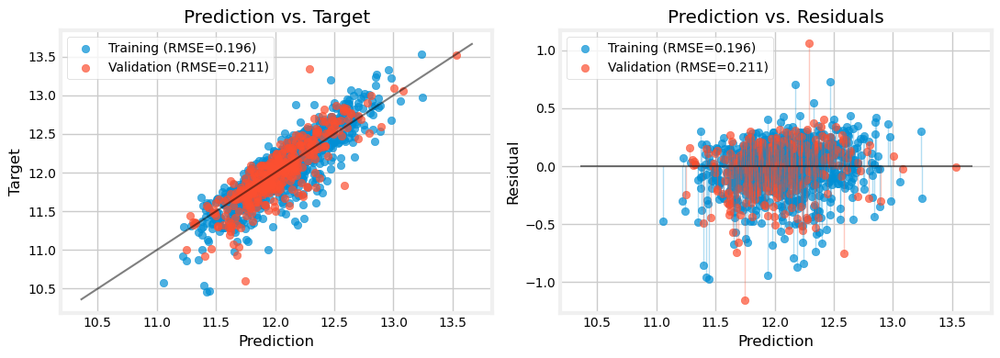



..................................................

Elapsed time: 0.03 minutes
..................................................



Time: 03:36:54
***************************************************************************
svr_raw , 	CV: True 

***************************************************************************
We will evaluate svr_raw with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.23207940797494095
		best params: {'model__C': 5.325573696016447, 'model__epsilon': 0.05473419033628662, 'model__gamma': 0.006989029348768765, 'preprocessor__selector__best_k': 10, 'preprocessor__selector__t_thr': 0.6916300476505092, 'preprocessor__target_encoder__smoothing': 50.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..........................................

,Value
Explained Variance,0.974973
R2,0.974969
MAE,0.053662
MSE,0.003914
RMSE,0.062561
MedAE,0.054759
MAPE,0.004462




Regression Report: Validation
..................................................


,Value
Explained Variance,0.498506
R2,0.495519
MAE,0.206244
MSE,0.084551
RMSE,0.290776
MedAE,0.149114
MAPE,0.017227



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


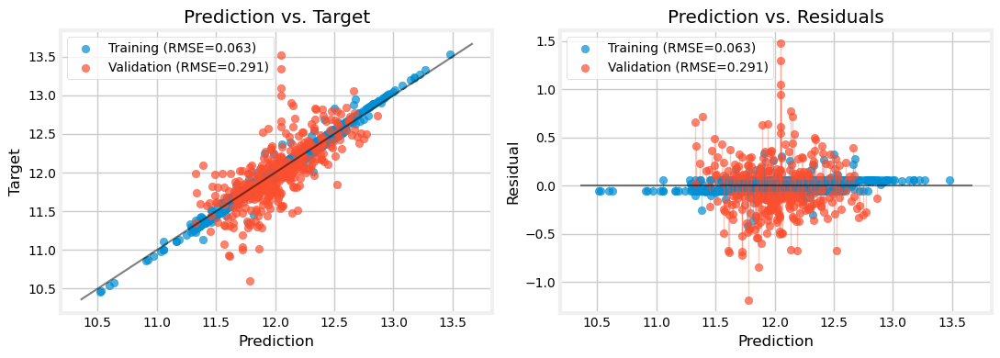



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['YearBuilt', 'GrLivArea', 'OverallQual', 'BsmtQual', 'GarageCars', 'KitchenQual']
The most important features are:

	YearBuilt: 0.3697882884619158 +- 0.021473195443158427
	GrLivArea: 0.34607944631874465 +- 0.03850719048728938
	OverallQual: 0.051280663166865414 +- 0.004392991443444358
	BsmtQual: 0.02351929832715638 +- 0.00586659405808907
	GarageCars: 0.010939537161362112 +- 0.0030716667782053984
	KitchenQual: 0.005672970700392521 +- 0.0008461293830804254

****************************************************************************************************



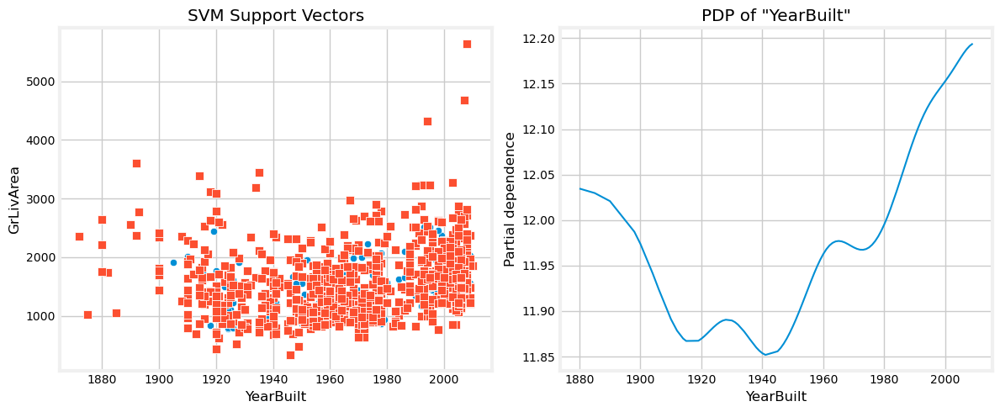

  0%|          | 0/50 [00:00<?, ?it/s]

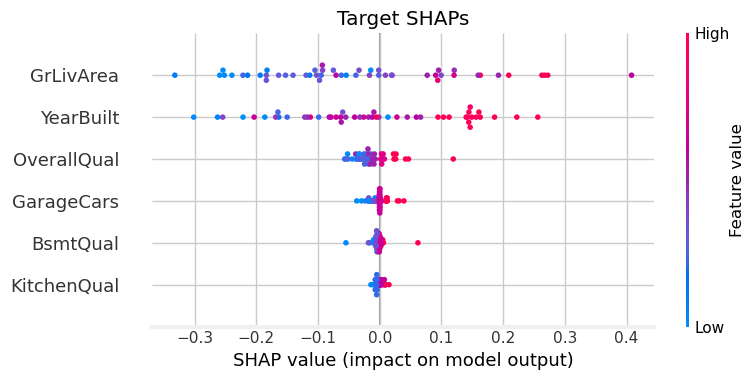

..................................................

Elapsed time: 15.29 minutes
..................................................



Time: 03:52:11
***************************************************************************
svr_eng , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=svr_eng with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.892797
R2,0.892761
MAE,0.091035
MSE,0.016768
RMSE,0.129491
MedAE,0.069824
MAPE,0.007600




Regression Report: Validation
..................................................


,Value
Explained Variance,0.896025
R2,0.895977
MAE,0.094142
MSE,0.017434
RMSE,0.132039
MedAE,0.071803
MAPE,0.007929



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


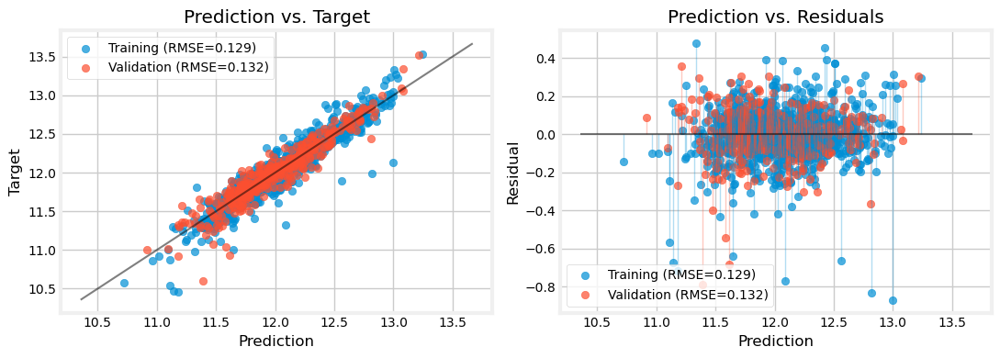



..................................................

Elapsed time: 0.05 minutes
..................................................



Time: 03:52:14
***************************************************************************
svr_eng , 	CV: True 

***************************************************************************
We will evaluate svr_eng with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.13667415376984535
		best params: {'model__C': 7.181346912598424, 'model__epsilon': 0.0246401890247287, 'model__gamma': 0.004962110409882798, 'preprocessor__selector__best_k': 20, 'preprocessor__selector__t_thr': 0.1037238694697468, 'preprocessor__target_encoder__smoothing': 40.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
...........................................

,Value
Explained Variance,0.896134
R2,0.896050
MAE,0.082377
MSE,0.016254
RMSE,0.127491
MedAE,0.053002
MAPE,0.006876




Regression Report: Validation
..................................................


,Value
Explained Variance,0.899211
R2,0.899202
MAE,0.090886
MSE,0.016894
RMSE,0.129976
MedAE,0.061807
MAPE,0.007672



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


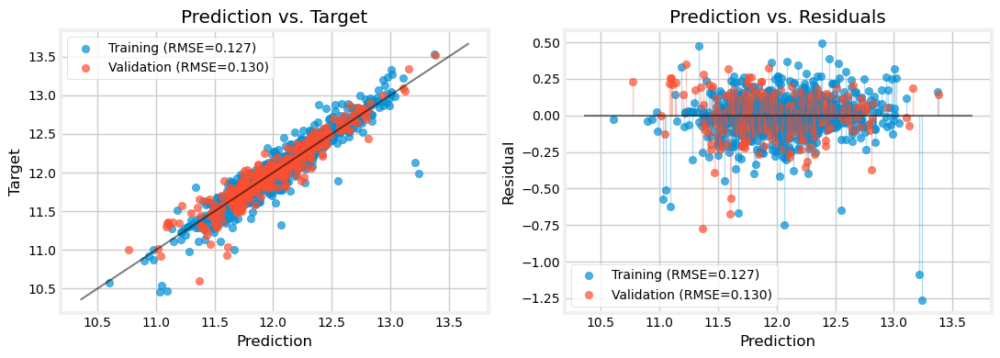



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['TotalSF', '1and2FlrSF', 'OverallQualCond', 'Neighborhood', 'AllBaths', 'GarageArea', 'YearBuilt', 'OverallQual', 'GarageCars', 'BathsAbvGr', 'BsmtQual', '1stFlrSF', 'GarageAge', 'KitchenQual', 'TotalBsmtSF', 'HouseAge', 'ExterQual', 'Has_Bsmt', 'Has_Garage', 'AllRooms']
The most important features are:

	TotalSF: 0.10563539572531613 +- 0.004721481479867658
	1and2FlrSF: 0.08615807778655829 +- 0.0015601139327551248
	OverallQualCond: 0.08423880805020041 +- 0.0023202130608627994
	Neighborhood: 0.054909705335723036 +- 0.0025085283824221928
	AllBaths: 0.03697106131576762 +- 0.0021776706241720166
	GarageArea: 0.033264905631267584 +- 0.007778310179867526
	YearBuilt: 0.03160827783070537 +- 0.0036307337687920215
	OverallQual: 0.014211323140306797 +- 0.0021350713925244996
	GarageCar

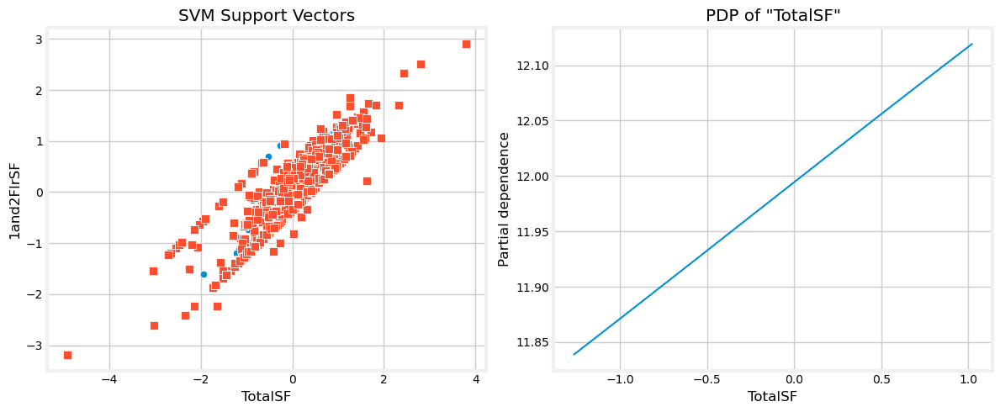

  0%|          | 0/50 [00:00<?, ?it/s]

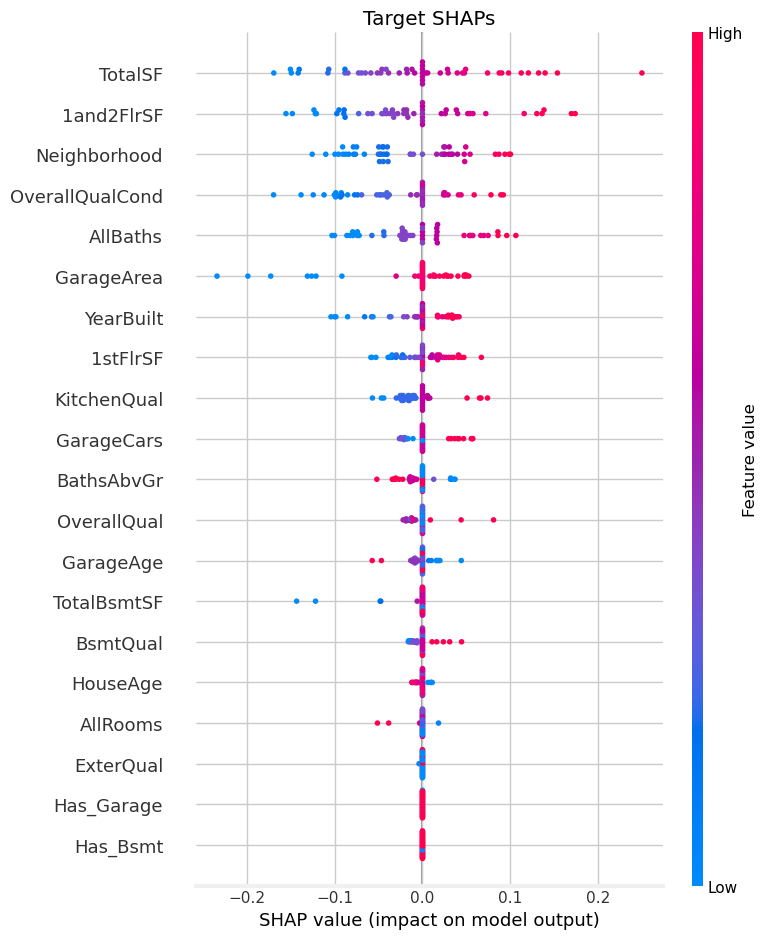

..................................................

Elapsed time: 20.01 minutes
..................................................



Time: 04:12:14
***************************************************************************
svr_clus , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=svr_clus with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.892283
R2,0.892226
MAE,0.091132
MSE,0.016852
RMSE,0.129814
MedAE,0.069667
MAPE,0.007609




Regression Report: Validation
..................................................


,Value
Explained Variance,0.895952
R2,0.895908
MAE,0.094222
MSE,0.017446
RMSE,0.132082
MedAE,0.072797
MAPE,0.007936



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


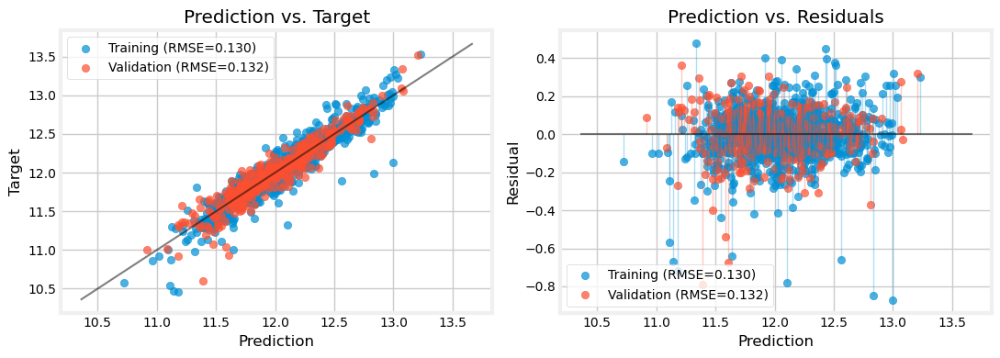



..................................................

Elapsed time: 0.05 minutes
..................................................



Time: 04:12:17
***************************************************************************
svr_clus , 	CV: True 

***************************************************************************
We will evaluate svr_clus with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.13649115334083967
		best params: {'model__C': 5.142684596798999, 'model__epsilon': 0.03427127641664456, 'model__gamma': 0.003970605551769272, 'preprocessor__cluster__n_clusters': 4, 'preprocessor__pca__fit_feat_subset': True, 'preprocessor__pca__keep_original_feats': False, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.4134194553871662, 'preprocessor__target_encoder__smoothing': 40.0}
......Done!
 -> Making predi

,Value
Explained Variance,0.901200
R2,0.901142
MAE,0.082153
MSE,0.015458
RMSE,0.124329
MedAE,0.054987
MAPE,0.006858




Regression Report: Validation
..................................................


,Value
Explained Variance,0.897400
R2,0.897400
MAE,0.091262
MSE,0.017196
RMSE,0.131132
MedAE,0.067605
MAPE,0.007686



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


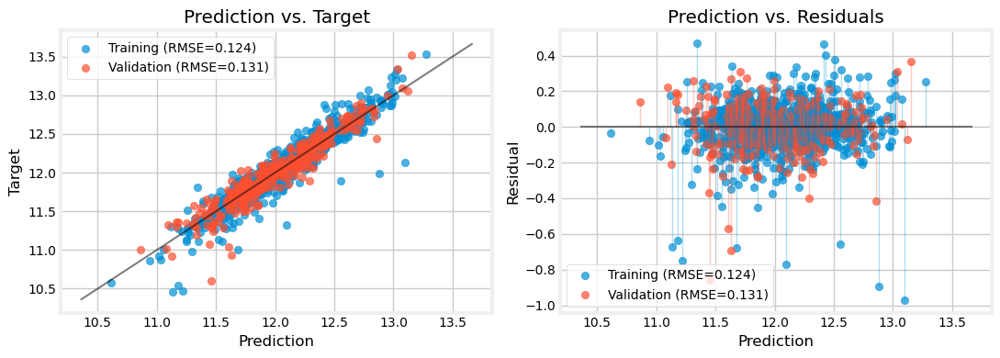



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['pca0', 'pca6', 'pca1', 'pca4', 'AllBaths', 'pca2', 'pca7', 'GarageCars', 'BsmtQual', 'pca5', 'OverallQual', 'KitchenQual', 'FullBath', 'FireplaceQu', 'pca3', 'BathsAbvGr', 'GarageFinish', 'ExterQual', 'GarageType_1', 'GarageType_3', 'cluster_0', 'GarageType_4', 'GarageType_5', 'GarageType_0', 'cluster_1', 'Has_Bsmt', 'GarageType_6', 'Has_Garage', 'cluster_2', 'cluster_3', 'GarageType_2']
The most important features are:

	pca0: 1.112224115507749 +- 0.04143080151573769
	pca6: 0.15384493802602914 +- 0.005305057708056092
	pca1: 0.15079231263522366 +- 0.0046548092839375985
	pca4: 0.08864754902910292 +- 0.003915134556896506
	AllBaths: 0.028931243450351873 +- 0.002221826617518524
	pca2: 0.024940197953449594 +- 0.006158197153073783
	pca7: 0.017164036562728156 +- 0.00477412430519

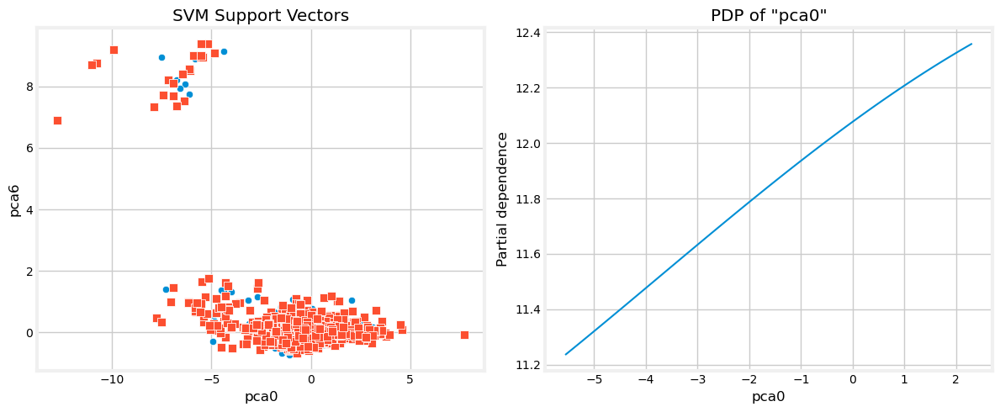

  0%|          | 0/50 [00:00<?, ?it/s]

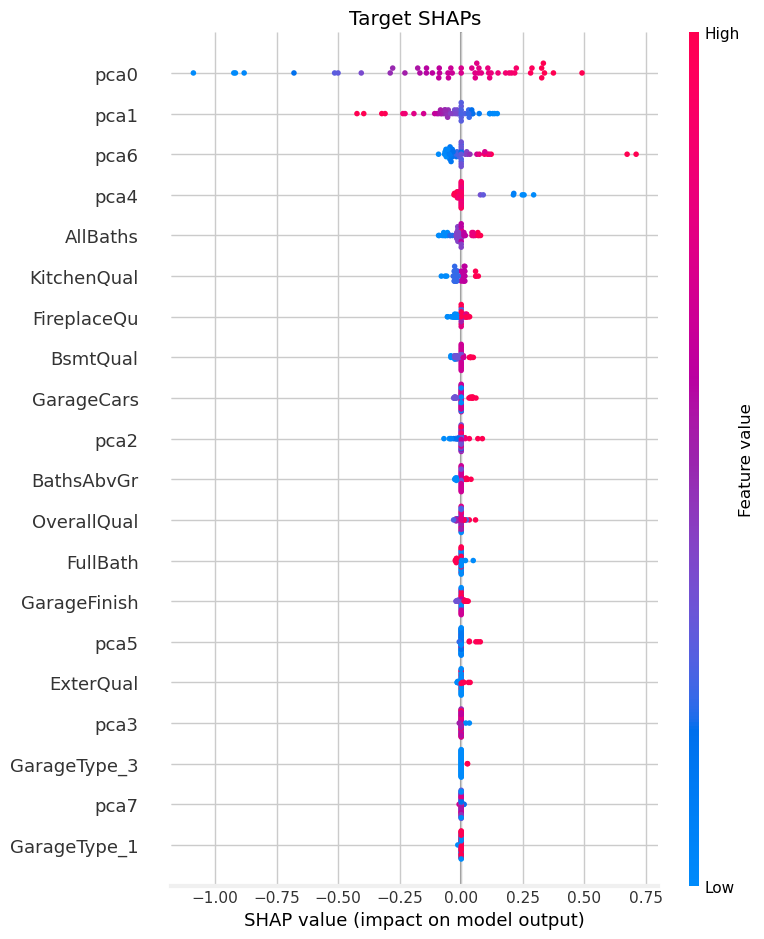

..................................................

Elapsed time: 21.20 minutes
..................................................





In [154]:
model = 'svr'
redoQ = False

for pp in ['raw', 'eng', 'clus']:
    for cvQ in [False, True]:

        print(time.strftime("Time: %H:%M:%S"))
        start = time.time()

        model_name = model+'_'+pp # full model name

        if redoQ and (model_name in search.keys()):
            del search[model_name]

        print("*"*75)
        print(model_name, ", \tCV:", cvQ, "\n")
        print("*"*75)
        
        # # GridSearchCV
        # model_evaluation(model_name, (X_train, X_val, y_train, y_val),
        #                  perform_cv_randomized=(cvQ, False),
        #                  n_splits=5, n_repeats=3,
        #                  verbose=True, plots=True)

        # RandomizedSearchCV
        model_evaluation(model_name, (X_train, X_val, y_train, y_val),
                         perform_cv_randomized=(cvQ, True),
                         n_splits=5, n_repeats=3,
                         n_iter=1000,
                         verbose=True, plots=True)

        print("\n")

        if cvQ:
            explain_model(model_name, best_cv[model_name]['pipe'], (X_train, X_val, y_train, y_val), tree_idx=0, random_state=0)

        end = time.time()

        print("."*50)
        print(f"\nElapsed time: {(end-start)/60:.2f} minutes")
        print("."*50)

        print("\n\n")

In [155]:
scorecard

,rfr_base_no_cv,dtr_raw_no_cv,dtr_raw_cv,dtr_eng_no_cv,dtr_eng_cv,dtr_clus_no_cv,dtr_clus_cv,rfr_raw_no_cv,rfr_raw_cv,rfr_eng_no_cv,rfr_eng_cv,rfr_clus_no_cv,rfr_clus_cv,xgbr_raw_no_cv,xgbr_raw_cv,xgbr_eng_no_cv,xgbr_eng_cv,xgbr_clus_no_cv,xgbr_clus_cv,linreg_raw_no_cv,linreg_raw_cv,linreg_eng_no_cv,linreg_eng_cv,linreg_clus_no_cv,linreg_clus_cv,lasso_raw_no_cv,lasso_raw_cv,lasso_eng_no_cv,lasso_eng_cv,lasso_clus_no_cv,lasso_clus_cv,ridge_raw_no_cv,ridge_raw_cv,ridge_eng_no_cv,ridge_eng_cv,ridge_clus_no_cv,ridge_clus_cv,knn_raw_no_cv,knn_raw_cv,knn_eng_no_cv,knn_eng_cv,knn_clus_no_cv,knn_clus_cv,mlp_raw_no_cv,mlp_raw_cv,mlp_eng_no_cv,mlp_eng_cv,mlp_clus_no_cv,mlp_clus_cv,svr_raw_no_cv,svr_raw_cv,svr_eng_no_cv,svr_eng_cv,svr_clus_no_cv,svr_clus_cv
R2 Score Train,0.056091,9.297877e-17,0.201295,0.002394,0.186764,0.002394,0.174660,0.056091,0.059486,0.055042,0.059738,0.056760,0.066433,0.004774,0.094879,0.009846,0.088716,0.008072,0.087156,0.099541,0.150483,0.141500,0.135272,0.141334,0.135143,0.195434,0.152514,0.395426,0.136648,0.395426,0.136953,0.106040,0.151072,0.141619,0.136965,0.141392,0.134849,0.186154,0.002095,0.130320,0.001387,0.130686,0.001387,13.057420,0.231594,0.147640,0.147074,0.138715,0.148835,0.196244,0.062561,0.129491,0.127491,0.129814,0.124329
R2 Score Validation,0.891477,7.513521e-01,0.745161,0.756836,0.793272,0.783426,0.774561,0.891477,0.890179,0.888852,0.890617,0.881278,0.880512,0.894659,0.876820,0.876607,0.892419,0.861901,0.876020,0.895123,0.878597,0.892702,0.900085,0.892984,0.902885,0.814858,0.882886,-0.008946,0.901947,-0.008946,0.900118,0.892717,0.880488,0.893122,0.900468,0.893256,0.903510,0.632831,0.772192,0.855047,0.863121,0.853504,0.866862,-1183.886659,0.749738,0.826766,0.859467,0.848764,0.843734,0.734438,0.495519,0.895977,0.899202,0.895908,0.897400
RMSE Train,0.056091,9.297877e-17,0.201295,0.002394,0.186764,0.002394,0.174660,0.056091,0.059486,0.055042,0.059738,0.056760,0.066433,0.004774,0.094879,0.009846,0.088716,0.008072,0.087156,0.099541,0.150483,0.141500,0.135272,0.141334,0.135143,0.195434,0.152514,0.395426,0.136648,0.395426,0.136953,0.106040,0.151072,0.141619,0.136965,0.141392,0.134849,0.186154,0.002095,0.130320,0.001387,0.130686,0.001387,13.057420,0.231594,0.147640,0.147074,0.138715,0.148835,0.196244,0.062561,0.129491,0.127491,0.129814,0.124329
RMSE Validation,0.134864,2.041404e-01,0.206666,0.201877,0.186139,0.190520,0.194380,0.134864,0.135668,0.136486,0.135398,0.141059,0.141514,0.132873,0.143683,0.143808,0.134278,0.152136,0.144149,0.132579,0.142643,0.134101,0.129406,0.133925,0.127579,0.176152,0.140101,0.411216,0.128194,0.411216,0.129384,0.134092,0.141528,0.133839,0.129157,0.133755,0.127168,0.248067,0.195398,0.155866,0.151462,0.156693,0.149378,14.092078,0.204802,0.170394,0.153471,0.159208,0.161834,0.210970,0.290776,0.132039,0.129976,0.132082,0.131132


#### Engineered Cluster Model: exploration

In the cluster model, checking selected engineering features (from which PCA and clusters are built)

In [156]:
best_cv[model+'_clus']

{'pipe': Pipeline(steps=[('preprocessor',
                  Pipeline(steps=[('cleaning',
                                   Pipeline(steps=[('custom_imputer',
                                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                                             'BsmtQual'],
                                                                                'BsmtExposure': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtFinType2': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtQual': ['BsmtCond',
                                                                                   

In [157]:
best_cv[model+'_clus']['params']

{'model__C': 5.142684596798999,
 'model__epsilon': 0.03427127641664456,
 'model__gamma': 0.003970605551769272,
 'preprocessor__cluster__n_clusters': 4,
 'preprocessor__pca__fit_feat_subset': True,
 'preprocessor__pca__keep_original_feats': False,
 'preprocessor__selector__best_k': 30,
 'preprocessor__selector__t_thr': 0.4134194553871662,
 'preprocessor__target_encoder__smoothing': 40.0}

In [158]:
best_cv[model+'_clus']['pipe'].steps

[('preprocessor',
  Pipeline(steps=[('cleaning',
                   Pipeline(steps=[('custom_imputer',
                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                             'BsmtQual'],
                                                                'BsmtExposure': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtFinType2': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtQual': ['BsmtCond',
                                                                             'BsmtExposure'],
                                                                'Exterior1st': 'Foundation',
                                                                

In [159]:
best_preproc = best_cv[model+'_clus']['pipe'].steps[0][1] # the best preprocessor
best_feats = best_preproc[:-3] # all the preprocessor steps, except for PCA, KMeans clustering, and OHE
best_feats.transform(X_train)

,TotalSF,OverallQual,Neighborhood,GarageCars,OverallQualCond,GarageArea,TotalBsmtSF,BathsAbvGr,1stFlrSF,AllBaths,KitchenQual,ExterQual,BsmtQual,GarageFinish,FullBath,MSSubClass,GarageType,FireplaceQu,LotFrontage,Has_Garage,Has_Bsmt
6,0.742068,8,0.483664,2,0.5,0.502730,1.052674,2.0,0.919677,3.0,4,4,5,2,2,0.000000,1,4,0.239984,1,1
807,0.367177,5,-1.057006,2,-0.5,0.170238,0.569246,1.5,-0.048785,3.5,4,3,3,2,1,-0.336738,1,3,2.518040,1,1
955,0.398207,6,0.287491,2,0.1,0.044102,-0.034421,2.0,-0.240817,2.0,3,3,4,1,2,-0.733724,1,0,0.550685,1,1
1040,0.398207,5,-0.736242,2,-1.5,0.014822,0.259462,2.0,1.051686,3.0,3,3,3,2,2,0.071203,1,3,0.796813,1,1
701,-0.170534,7,0.115169,2,0.0,0.170238,0.311677,1.5,0.125459,1.5,3,3,3,1,1,0.022534,1,0,0.464671,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,-0.081754,6,0.115169,2,-0.5,-0.007457,0.132054,2.0,0.439205,2.0,3,3,4,2,2,0.022534,1,3,0.376507,1,1
905,-0.400741,5,-0.772132,1,-1.0,-0.961984,0.116963,1.0,-0.066626,2.0,3,3,3,2,1,0.071203,1,0,0.464671,1,1
1096,-0.494922,6,-1.341701,0,0.7,-11.052923,-0.751207,1.5,-0.740655,1.5,4,3,3,0,1,-0.180167,6,0,-0.535329,0,1
235,-1.295571,6,-1.044408,1,-1.7,-1.066905,-1.446378,1.5,-1.735090,1.5,3,3,3,1,1,-0.773353,5,0,-4.131663,1,1


In [160]:
best_preproc

Pipeline(steps=[('cleaning',
                 Pipeline(steps=[('custom_imputer',
                                  CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                           'BsmtQual'],
                                                              'BsmtExposure': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtFinType2': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtQual': ['BsmtCond',
                                                                           'BsmtExposure'],
                                                              'Exterior1st': 'Foundation',
                                                              'Exterior2nd': 'Foundation',
                                                              'GarageArea': ['GarageCars',
                                                                             'GarageQual'],
                                                              'GarageCa...
                 PCAFeature(fit_feat_subset=True, keep_original_feats=False)),
                ('cluster',
                 KMeansFeature(n_clusters=4, scaling_method='robust')),
                ('ohe',
                 Pipeline(steps=[('ohe',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('ohe',
                                                                   OneHotEncoder(dtype=<class 'int'>,
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False),
                                                                   <function ohe_from_subset.<locals>.selector at 0x7b1eeceb1f80>)],
                                                    verbose_feature_names_out=False))]))])

In [161]:
del best_preproc, best_feats

### Cleanup

In [162]:
Out.clear()

for name in dir():
    if name.startswith('_') and name[1:].isdigit():
        del globals()[name]

## 8. Exporting Best Model

In [163]:
import pickle
import dill

We begin by selecting only those models with CV, and focusing only on the validation scores:

In [164]:
best_scores = scorecard.loc[[idx for idx in scorecard.index if 'Val' in idx], [col for col in scorecard.columns if '_no_cv' not in col]]
best_scores.head()

,dtr_raw_cv,dtr_eng_cv,dtr_clus_cv,rfr_raw_cv,rfr_eng_cv,rfr_clus_cv,xgbr_raw_cv,xgbr_eng_cv,xgbr_clus_cv,linreg_raw_cv,linreg_eng_cv,linreg_clus_cv,lasso_raw_cv,lasso_eng_cv,lasso_clus_cv,ridge_raw_cv,ridge_eng_cv,ridge_clus_cv,knn_raw_cv,knn_eng_cv,knn_clus_cv,mlp_raw_cv,mlp_eng_cv,mlp_clus_cv,svr_raw_cv,svr_eng_cv,svr_clus_cv
R2 Score Validation,0.745161,0.793272,0.774561,0.890179,0.890617,0.880512,0.876820,0.892419,0.876020,0.878597,0.900085,0.902885,0.882886,0.901947,0.900118,0.880488,0.900468,0.903510,0.772192,0.863121,0.866862,0.749738,0.859467,0.843734,0.495519,0.899202,0.897400
RMSE Validation,0.206666,0.186139,0.194380,0.135668,0.135398,0.141514,0.143683,0.134278,0.144149,0.142643,0.129406,0.127579,0.140101,0.128194,0.129384,0.141528,0.129157,0.127168,0.195398,0.151462,0.149378,0.204802,0.153471,0.161834,0.290776,0.129976,0.131132


In [165]:
best_scores_T = best_scores.transpose()
best_scores_T

,R2 Score Validation,RMSE Validation
dtr_raw_cv,0.745161,0.206666
dtr_eng_cv,0.793272,0.186139
dtr_clus_cv,0.774561,0.194380
rfr_raw_cv,0.890179,0.135668
rfr_eng_cv,0.890617,0.135398
rfr_clus_cv,0.880512,0.141514
xgbr_raw_cv,0.876820,0.143683
xgbr_eng_cv,0.892419,0.134278
xgbr_clus_cv,0.876020,0.144149
linreg_raw_cv,0.878597,0.142643


Let us select the models that performed the best in F1 validation:

In [166]:
best_models = list(best_scores_T[best_scores_T['RMSE Validation'].abs() < 0.14].index)

best_models = best_scores_T.loc[best_models, 'RMSE Validation'].sort_values().index.to_list()

display(best_scores_T.loc[best_models, 'RMSE Validation'])

ridge_clus_cv     0.127168
linreg_clus_cv    0.127579
lasso_eng_cv      0.128194
ridge_eng_cv      0.129157
lasso_clus_cv     0.129384
linreg_eng_cv     0.129406
svr_eng_cv        0.129976
svr_clus_cv       0.131132
xgbr_eng_cv       0.134278
rfr_eng_cv        0.135398
rfr_raw_cv        0.135668
Name: RMSE Validation, dtype: float64

Which one to pick? Well, let's look at their mean CV test scores, and their standard deviations:

In [167]:
stds = {}
for model_name in best_models:
    model_name = model_name.removesuffix('_cv')
    print(model_name)
    idx_largest_score = search[model_name].cv_results_['mean_test_score'].argmax()
    print("found best score?", search[model_name].cv_results_['mean_test_score'][idx_largest_score] == best_cv[model_name]['score'])
    print("best score:", best_cv[model_name]['score'], "+-", search[model_name].cv_results_['std_test_score'][idx_largest_score], "\n")

    stds[model_name] = search[model_name].cv_results_['std_test_score'][idx_largest_score]

ridge_clus
found best score? True
best score: -0.14357427165898468 +- 0.01975088874604634 

linreg_clus
found best score? True
best score: -0.14334119523657857 +- 0.019728933483196667 

lasso_eng
found best score? True
best score: -0.14406623810831845 +- 0.021001243301414906 

ridge_eng
found best score? True
best score: -0.1435045816324432 +- 0.02205893613636893 

lasso_clus
found best score? True
best score: -0.14367322593024567 +- 0.02258945819359722 

linreg_eng
found best score? True
best score: -0.14322555400089157 +- 0.019751247702149945 

svr_eng
found best score? True
best score: -0.13667415376984535 +- 0.016078348030486786 

svr_clus
found best score? True
best score: -0.13649115334083967 +- 0.013610801917994825 

xgbr_eng
found best score? True
best score: -0.13544715910728125 +- 0.012542404803105827 

rfr_eng
found best score? True
best score: -0.14260006168484132 +- 0.014414145033528928 

rfr_raw
found best score? True
best score: -0.14856509071370053 +- 0.0171316192215331

Since their best mean CV scores are all within each others standard deviations, they are all functionally equivalent in the CV. Thus, what matters is precisely the standard deviation, which is evidence of their stability. Selecting the models with the smallest standard deviations:

In [168]:
list_overall_best_models = [k+'_cv' for k,v in stds.items() if v == stds[min(stds, key=stds.get)]]

print("models:", list_overall_best_models)
print("scores:", [best_cv[k.removesuffix('_cv')]['score'] for k in list_overall_best_models])
print("stds:", [stds[k.removesuffix('_cv')] for k in list_overall_best_models])

best_scores_T.loc[list_overall_best_models]

models: ['xgbr_eng_cv']
scores: [-0.13544715910728125]
stds: [0.012542404803105827]


,R2 Score Validation,RMSE Validation
xgbr_eng_cv,0.892419,0.134278


And that with the smallest RMSE:

In [169]:
best_scores_T.loc[[best_models[0]]]

,R2 Score Validation,RMSE Validation
ridge_clus_cv,0.90351,0.127168


Updating the list:

In [170]:
list_overall_best_models.append(best_models[0])

To save them, we pickle/dill them:

In [171]:
for overall_best_model in list_overall_best_models:
    
    overall_best_model = overall_best_model.removesuffix('_cv')

    model_path = "./models/"+overall_best_model+".pkl"

    with open(model_path, "wb") as f:
        try:
            pickle.dump(best_cv[overall_best_model]['pipe'], f)
            pickle_or_dill = 'pickle'
        except:
            dill.dump(best_cv[overall_best_model]['pipe'], f)
            pickle_or_dill = 'dill'

To load the models, run the cell below:

In [172]:
models_directory = "./models/"

my_best_models = {}

for filename in os.listdir(models_directory):
    model_path = os.path.join(models_directory, filename)

    model = model_path.removesuffix('.pkl').removeprefix('./models/')

    with open(model_path, "rb") as f:
        if pickle_or_dill == 'pickle':
            my_best_models[model] = pickle.load(f)
        else:
            my_best_models[model] = dill.load(f)

## 9. Preparing Submission

Now, the final step: preparing the submission files!

In [173]:
y_preds = {}

for model_name, model in my_best_models.items():

    y_preds[model_name] = pd.DataFrame(1461 + np.arange(0, len(data_test)), columns=['Id'])
    
    y_preds[model_name]['SalePrice'] = np.exp(model.predict(data_test))

    y_preds[model_name].to_csv(data_path+f"prediction_{model_name}.csv", index=False)

In [174]:
for model_name, yp in y_preds.items():
    print(model_name)
    display(yp)
    print("\n")

xgbr_eng


,Id,SalePrice
0,1461,119304.007812
1,1462,147569.265625
2,1463,176900.468750
3,1464,183028.703125
4,1465,194164.156250
...,...,...
1454,2915,88608.835938
1455,2916,86228.382812
1456,2917,157625.843750
1457,2918,121709.523438




lasso_clus


,Id,SalePrice
0,1461,110183.331748
1,1462,149178.867194
2,1463,173127.500002
3,1464,196395.097614
4,1465,200431.603388
...,...,...
1454,2915,85192.644985
1455,2916,82699.867591
1456,2917,170130.317540
1457,2918,110376.806092




ridge_clus


,Id,SalePrice
0,1461,109285.306049
1,1462,149166.448443
2,1463,173075.725154
3,1464,195188.309825
4,1465,202544.025975
...,...,...
1454,2915,85263.979735
1455,2916,77446.273688
1456,2917,170661.793888
1457,2918,110018.438177




svr_clus


,Id,SalePrice
0,1461,123469.057796
1,1462,149268.987859
2,1463,177262.963223
3,1464,187647.006580
4,1465,197244.079131
...,...,...
1454,2915,82392.837232
1455,2916,87534.344772
1456,2917,172003.176471
1457,2918,110891.589341


**TODO**:

1. Rescale new features (e.g. PCs? May be necessary for distance-based models)?
2. Re-do model selection